# Top Mass DCTR 1D - $m_{bl\nu}$

This notebook attempts to train and validate a DCTR model paramterized by the top mass only using reconstructed hadronic mass $m_{bl\nu}$ for each event.

In [1]:
import os
os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"] = "0"

In [2]:
# standard library imports
from __future__ import absolute_import, division, print_function
from IPython.display import display, clear_output

import tensorflow as tf
import numpy as np
from matplotlib import pyplot as plt
import cv2

from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_auc_score

from keras.utils import to_categorical
from keras import Sequential
from keras.layers import Lambda, Dense, Input, Layer, Dropout
from keras.models import Model
from keras.utils import to_categorical
from keras.callbacks import LambdaCallback, EarlyStopping
import keras.backend as K
import keras

import inspect

# standard numerical library imports
import numpy as np
import scipy as sp

# energyflow imports
import energyflow as ef
from energyflow.archs import PFN
from energyflow.utils import data_split, remap_pids, to_categorical

import matplotlib.pyplot as plt

Using TensorFlow backend.


## Process Data

In [3]:
# Path to downloaded data from Zenodo
data_dir = '/data1/users/asuresh/DCTRFitting/TopQuarkFitting/'

In [4]:
# fetch m_T vals from default dataset
train_dataset_0_mT_x4 = np.load(data_dir + 'part_172_5_6j_x4.npy')[:, :1, 5]
train_dataset_0_mT = train_dataset_0_mT_x4

print(np.shape(train_dataset_0_mT))

# fetch m_jjj vals from default dataset
train_dataset_0_obs_x4 = np.load(data_dir + 'part_172_5_6j_obs_x4.npy')[:, 1:2]
train_dataset_0_obs = train_dataset_0_obs_x4

print(np.shape(train_dataset_0_obs))

# fetch m_T vals from varied dataset
train_dataset_1_mT_x4 = np.load(data_dir + 'part_varmass_6j_x4.npy')[:, :1, 5]
train_dataset_1_mT = train_dataset_1_mT_x4

print(np.shape(train_dataset_1_mT))

# fetch m_jjj vals from varied dataset
train_dataset_1_obs_x4 = np.load(data_dir +
                                 'part_varmass_6j_obs_x4.npy')[:, 1:2]
train_dataset_1_obs = train_dataset_1_obs_x4  #[:len(train_dataset_0_mjjj)]

print(np.shape(train_dataset_1_obs))

(883443, 1)
(883443, 1)
(3362263, 1)
(3362263, 1)


In [5]:
X0 = np.concatenate((train_dataset_0_obs, train_dataset_0_mT), axis=1)
X1 = np.concatenate((train_dataset_1_obs, train_dataset_1_mT), axis=1)

print(np.shape(X0))
print(np.shape(X1))

print(len(X1) / len(X0))  # different sizes if != 1

(883443, 2)
(3362263, 2)
3.805862970219924


In [6]:
Y0 = np.zeros_like(X0[:, 0])
Y1 = np.ones_like(X1[:, 0])

In [7]:
X = np.concatenate((X0, X1), axis=0)
X /= 1000.  # preprocessing data

mask = np.ones((len(X)))
mask *= np.logical_not(np.isnan(X[:,0]))

X = np.delete(X, np.where(mask == False), 0)

Y = np.concatenate((Y0, Y1), axis=0)
Y = to_categorical(Y, num_classes=2)
Y = np.delete(Y, np.where(mask == False), 0)

In [8]:
X_train, X_val, Y_train, Y_val = data_split(X, Y, test=0.2, shuffle=True)

In [9]:
print(X_train.shape)
print(Y_train.shape)

print(X_val.shape)
print(Y_val.shape)

(3396564, 2)
(3396564, 2)
(849141, 2)
(849141, 2)


## Build Model

In [138]:
# Get predicted probabilities
def reweight(default_dataset, mT):
    #creating tensor with same length as inputs, with theta_prime in every entry
    concat_input_and_params = K.ones(shape = (default_dataset.shape[0],1)) * mT
    #combining and reshaping into correct format:
    model_inputs = K.concatenate((default_dataset, concat_input_and_params), axis=-1)

    f = dctr(model_inputs)
    
    # liklihood_ratio = len(X0)/len(X1)
    
    weights = (f[:, 1]) / (f[:, 0])
    weights = K.expand_dims(weights, axis=1)
    return weights

In [11]:
test_dataset_0_obs = np.load(data_dir + 'part_172_5_6j_obs.npy')[:,1:2]
test_dataset_1_obs = np.load(data_dir + 'part_175_0_6j_obs.npy')[:,1:2]

print(np.shape(test_dataset_0_obs))
print(np.shape(test_dataset_1_obs))

(221723, 1)
(224595, 1)


In [12]:
# Define default plot styles
plot_style_0 = {'histtype':'step', 'color':'black', 'linewidth':2, 'linestyle':'--', 'density':True}
plot_style_1 = {'alpha':0.5, 'density':True}

In [13]:
label_0 = r'$m_T=172.5$'

label_1 = r'$m_T=175.0$'

def make_legend():
    ax = plt.gca()
    leg = ax.legend(frameon=False)
    leg._legend_box.align = "left"
    plt.tight_layout()

In [14]:
def plt_hist_to_cv(plt_histogram_output):
    counts, bin_edges, _ = plt_histogram_output
    return counts.ravel().astype('float32')

Iteration:  1







Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where



Train on 3396564 samples, validate on 849141 samples
Epoch 1/1000





 - 21s - loss: 0.5124 - acc: 0.7921 - val_loss: 0.5127 - val_acc: 0.7913
Epoch 2/1000
 - 20s - loss: 0.5113 - acc: 0.7921 - val_loss: 0.5122 - val_acc: 0.7913
Epoch 3/1000
 - 20s - loss: 0.5113 - acc: 0.7921 - val_loss: 0.5122 - val_acc: 0.7913
Epoch 4/1000
 - 19s - loss: 0.5112 - acc: 0.7921 - val_loss: 0.5124 - val_acc: 0.7913
Epoch 5/1000
 - 19s - loss: 0.5112 - acc: 0.7921 - val_loss: 0.5121 - val_acc: 0.7913
Epoch 6/1000
 - 19s - loss: 0.5112 - acc: 0.7921 - val_loss: 0.5123 - val_acc: 0.7913
Epoch 7/1000
 - 20s - loss: 0.5112 - acc: 0.7921 - val_loss: 0.5122 - val_acc: 0.7913
Epoch 8/1000
 - 21s - loss: 0.5112 - acc: 0.7921 - val_loss: 0.5121 - val_acc: 0.7913
Epoch 9/1000
 - 20s - loss: 0.5112 - acc: 0.7921 - val_loss: 0.5122 - val_acc: 0.7913
Epoch 10/1000
 - 20s - loss: 0.5111 - acc: 0.7921 

Epoch 56/1000
 - 19s - loss: 0.5109 - acc: 0.7921 - val_loss: 0.5118 - val_acc: 0.7913
Epoch 57/1000
 - 20s - loss: 0.5109 - acc: 0.7921 - val_loss: 0.5119 - val_acc: 0.7913
Epoch 58/1000
 - 20s - loss: 0.5109 - acc: 0.7921 - val_loss: 0.5119 - val_acc: 0.7913
Epoch 59/1000
 - 20s - loss: 0.5109 - acc: 0.7921 - val_loss: 0.5118 - val_acc: 0.7913
Epoch 60/1000
 - 20s - loss: 0.5109 - acc: 0.7921 - val_loss: 0.5123 - val_acc: 0.7913
Epoch 61/1000
 - 20s - loss: 0.5109 - acc: 0.7921 - val_loss: 0.5118 - val_acc: 0.7913
Epoch 62/1000
 - 19s - loss: 0.5109 - acc: 0.7921 - val_loss: 0.5118 - val_acc: 0.7913
Epoch 63/1000
 - 19s - loss: 0.5109 - acc: 0.7921 - val_loss: 0.5119 - val_acc: 0.7913
Epoch 64/1000
 - 19s - loss: 0.5109 - acc: 0.7921 - val_loss: 0.5119 - val_acc: 0.7913
Epoch 65/1000
 - 20s - loss: 0.5109 - acc: 0.7921 - val_loss: 0.5119 - val_acc: 0.7913
Epoch 66/1000
 - 20s - loss: 0.5109 - acc: 0.7921 - val_loss: 0.5119 - val_acc: 0.7913
Epoch 67/1000
 - 20s - loss: 0.5109 - acc: 

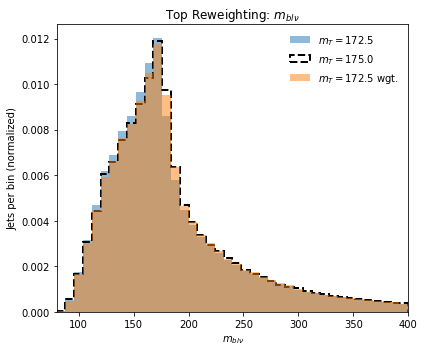

0.9997768381129074
Success. Saving weights.
(8,)
Iteration:  2
Train on 3396564 samples, validate on 849141 samples
Epoch 1/1000
 - 20s - loss: 0.5124 - acc: 0.7917 - val_loss: 0.5118 - val_acc: 0.7916
Epoch 2/1000
 - 19s - loss: 0.5114 - acc: 0.7920 - val_loss: 0.5119 - val_acc: 0.7916
Epoch 3/1000
 - 19s - loss: 0.5113 - acc: 0.7920 - val_loss: 0.5118 - val_acc: 0.7916
Epoch 4/1000
 - 19s - loss: 0.5113 - acc: 0.7920 - val_loss: 0.5118 - val_acc: 0.7916
Epoch 5/1000
 - 20s - loss: 0.5113 - acc: 0.7920 - val_loss: 0.5118 - val_acc: 0.7916
Epoch 6/1000
 - 20s - loss: 0.5113 - acc: 0.7920 - val_loss: 0.5118 - val_acc: 0.7916
Epoch 7/1000
 - 20s - loss: 0.5113 - acc: 0.7920 - val_loss: 0.5117 - val_acc: 0.7916
Epoch 8/1000
 - 20s - loss: 0.5113 - acc: 0.7920 - val_loss: 0.5117 - val_acc: 0.7916
Epoch 9/1000
 - 18s - loss: 0.5112 - acc: 0.7920 - val_loss: 0.5117 - val_acc: 0.7916
Epoch 10/1000
 - 19s - loss: 0.5112 - acc: 0.7920 - val_loss: 0.5117 - val_acc: 0.7916
Epoch 11/1000
 - 19s - 

 - 20s - loss: 0.5111 - acc: 0.7921 - val_loss: 0.5120 - val_acc: 0.7914
Epoch 10/1000
 - 20s - loss: 0.5111 - acc: 0.7921 - val_loss: 0.5120 - val_acc: 0.7914
Epoch 11/1000
 - 20s - loss: 0.5111 - acc: 0.7921 - val_loss: 0.5120 - val_acc: 0.7914
Epoch 12/1000
 - 19s - loss: 0.5111 - acc: 0.7921 - val_loss: 0.5121 - val_acc: 0.7914
Epoch 13/1000
 - 19s - loss: 0.5111 - acc: 0.7921 - val_loss: 0.5120 - val_acc: 0.7914
Epoch 14/1000
 - 19s - loss: 0.5111 - acc: 0.7921 - val_loss: 0.5120 - val_acc: 0.7914
Epoch 15/1000
 - 20s - loss: 0.5111 - acc: 0.7921 - val_loss: 0.5120 - val_acc: 0.7914
Epoch 16/1000
 - 20s - loss: 0.5111 - acc: 0.7921 - val_loss: 0.5120 - val_acc: 0.7914
Epoch 17/1000
 - 20s - loss: 0.5111 - acc: 0.7921 - val_loss: 0.5120 - val_acc: 0.7914
Epoch 18/1000
 - 20s - loss: 0.5111 - acc: 0.7921 - val_loss: 0.5120 - val_acc: 0.7914
Epoch 19/1000
 - 20s - loss: 0.5111 - acc: 0.7921 - val_loss: 0.5120 - val_acc: 0.7914
Epoch 20/1000
 - 19s - loss: 0.5111 - acc: 0.7921 - val_l

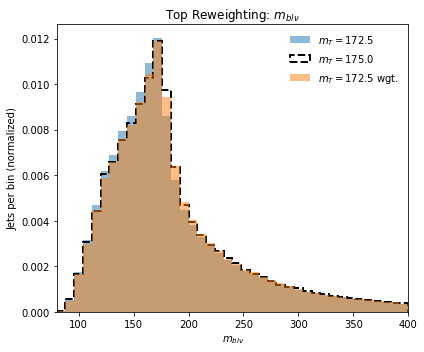

0.9997326340414525
Success. Saving weights.
(8,)
Iteration:  4
Train on 3396564 samples, validate on 849141 samples
Epoch 1/1000
 - 19s - loss: 0.5123 - acc: 0.7919 - val_loss: 0.5112 - val_acc: 0.7920
Epoch 2/1000
 - 19s - loss: 0.5115 - acc: 0.7919 - val_loss: 0.5112 - val_acc: 0.7920
Epoch 3/1000
 - 19s - loss: 0.5115 - acc: 0.7919 - val_loss: 0.5112 - val_acc: 0.7920
Epoch 4/1000
 - 20s - loss: 0.5115 - acc: 0.7919 - val_loss: 0.5112 - val_acc: 0.7920
Epoch 5/1000
 - 20s - loss: 0.5115 - acc: 0.7919 - val_loss: 0.5112 - val_acc: 0.7920
Epoch 6/1000
 - 20s - loss: 0.5114 - acc: 0.7919 - val_loss: 0.5112 - val_acc: 0.7920
Epoch 7/1000
 - 20s - loss: 0.5114 - acc: 0.7919 - val_loss: 0.5112 - val_acc: 0.7920
Epoch 8/1000
 - 19s - loss: 0.5114 - acc: 0.7919 - val_loss: 0.5113 - val_acc: 0.7920
Epoch 9/1000
 - 19s - loss: 0.5114 - acc: 0.7919 - val_loss: 0.5112 - val_acc: 0.7920
Epoch 10/1000
 - 19s - loss: 0.5114 - acc: 0.7919 - val_loss: 0.5111 - val_acc: 0.7920
Epoch 11/1000
 - 20s - 

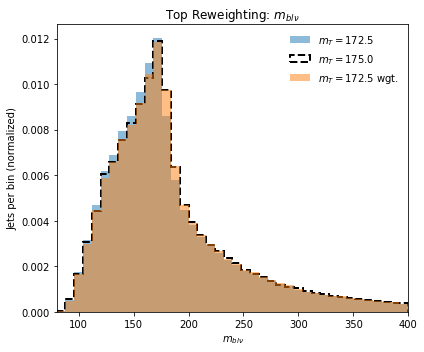

0.9998765809270537
Success. Saving weights.
(8,)
Iteration:  5
Train on 3396564 samples, validate on 849141 samples
Epoch 1/1000
 - 20s - loss: 0.5126 - acc: 0.7918 - val_loss: 0.5111 - val_acc: 0.7922
Epoch 2/1000
 - 20s - loss: 0.5116 - acc: 0.7919 - val_loss: 0.5110 - val_acc: 0.7922
Epoch 3/1000
 - 20s - loss: 0.5115 - acc: 0.7919 - val_loss: 0.5111 - val_acc: 0.7922
Epoch 4/1000
 - 20s - loss: 0.5115 - acc: 0.7919 - val_loss: 0.5110 - val_acc: 0.7922
Epoch 5/1000
 - 20s - loss: 0.5115 - acc: 0.7919 - val_loss: 0.5110 - val_acc: 0.7922
Epoch 6/1000
 - 21s - loss: 0.5114 - acc: 0.7919 - val_loss: 0.5110 - val_acc: 0.7922
Epoch 7/1000
 - 20s - loss: 0.5114 - acc: 0.7919 - val_loss: 0.5112 - val_acc: 0.7922
Epoch 8/1000
 - 19s - loss: 0.5114 - acc: 0.7919 - val_loss: 0.5110 - val_acc: 0.7922
Epoch 9/1000
 - 19s - loss: 0.5114 - acc: 0.7919 - val_loss: 0.5110 - val_acc: 0.7922
Epoch 10/1000
 - 19s - loss: 0.5114 - acc: 0.7919 - val_loss: 0.5110 - val_acc: 0.7922
Epoch 11/1000
 - 20s - 

Epoch 94/1000
 - 19s - loss: 0.5112 - acc: 0.7919 - val_loss: 0.5108 - val_acc: 0.7922
Epoch 95/1000
 - 19s - loss: 0.5112 - acc: 0.7919 - val_loss: 0.5109 - val_acc: 0.7922
Epoch 96/1000
 - 19s - loss: 0.5112 - acc: 0.7919 - val_loss: 0.5109 - val_acc: 0.7922
Epoch 97/1000
 - 20s - loss: 0.5112 - acc: 0.7919 - val_loss: 0.5107 - val_acc: 0.7922
Epoch 98/1000
 - 21s - loss: 0.5111 - acc: 0.7919 - val_loss: 0.5107 - val_acc: 0.7922
Epoch 99/1000
 - 20s - loss: 0.5112 - acc: 0.7919 - val_loss: 0.5107 - val_acc: 0.7922
Epoch 100/1000
 - 20s - loss: 0.5111 - acc: 0.7919 - val_loss: 0.5107 - val_acc: 0.7922
Epoch 101/1000
 - 19s - loss: 0.5111 - acc: 0.7919 - val_loss: 0.5107 - val_acc: 0.7922
Epoch 102/1000
 - 19s - loss: 0.5111 - acc: 0.7919 - val_loss: 0.5107 - val_acc: 0.7922
Epoch 103/1000
 - 20s - loss: 0.5111 - acc: 0.7919 - val_loss: 0.5107 - val_acc: 0.7922
Epoch 104/1000
 - 20s - loss: 0.5111 - acc: 0.7919 - val_loss: 0.5107 - val_acc: 0.7922
Epoch 105/1000
 - 20s - loss: 0.5111 -

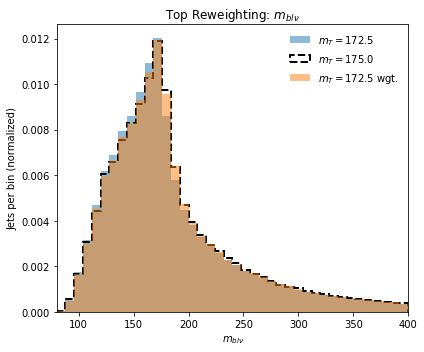

0.9998008633007814
Success. Saving weights.
(8,)
Iteration:  6
Train on 3396564 samples, validate on 849141 samples
Epoch 1/1000
 - 20s - loss: 0.5126 - acc: 0.7919 - val_loss: 0.5113 - val_acc: 0.7920
Epoch 2/1000
 - 19s - loss: 0.5115 - acc: 0.7919 - val_loss: 0.5114 - val_acc: 0.7920
Epoch 3/1000
 - 19s - loss: 0.5115 - acc: 0.7919 - val_loss: 0.5113 - val_acc: 0.7920
Epoch 4/1000
 - 20s - loss: 0.5114 - acc: 0.7919 - val_loss: 0.5113 - val_acc: 0.7920
Epoch 5/1000
 - 20s - loss: 0.5114 - acc: 0.7919 - val_loss: 0.5112 - val_acc: 0.7920
Epoch 6/1000
 - 20s - loss: 0.5114 - acc: 0.7919 - val_loss: 0.5112 - val_acc: 0.7920
Epoch 7/1000
 - 20s - loss: 0.5114 - acc: 0.7919 - val_loss: 0.5112 - val_acc: 0.7920
Epoch 8/1000
 - 20s - loss: 0.5114 - acc: 0.7919 - val_loss: 0.5113 - val_acc: 0.7920
Epoch 9/1000
 - 19s - loss: 0.5114 - acc: 0.7919 - val_loss: 0.5111 - val_acc: 0.7920
Epoch 10/1000
 - 19s - loss: 0.5113 - acc: 0.7919 - val_loss: 0.5112 - val_acc: 0.7920
Epoch 11/1000
 - 19s - 

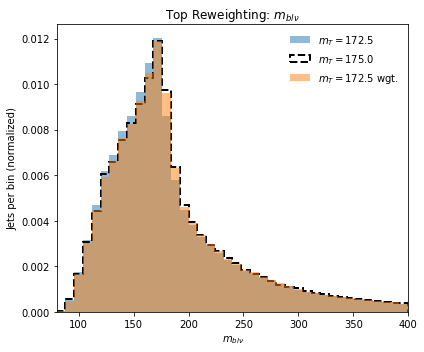

0.9998227178574218
Success. Saving weights.
(8,)
Iteration:  7
Train on 3396564 samples, validate on 849141 samples
Epoch 1/1000
 - 20s - loss: 0.5126 - acc: 0.7918 - val_loss: 0.5111 - val_acc: 0.7922
Epoch 2/1000
 - 20s - loss: 0.5116 - acc: 0.7918 - val_loss: 0.5109 - val_acc: 0.7922
Epoch 3/1000
 - 20s - loss: 0.5115 - acc: 0.7919 - val_loss: 0.5110 - val_acc: 0.7922
Epoch 4/1000
 - 20s - loss: 0.5115 - acc: 0.7919 - val_loss: 0.5111 - val_acc: 0.7922
Epoch 5/1000
 - 20s - loss: 0.5115 - acc: 0.7919 - val_loss: 0.5110 - val_acc: 0.7922
Epoch 6/1000
 - 19s - loss: 0.5115 - acc: 0.7919 - val_loss: 0.5110 - val_acc: 0.7922
Epoch 7/1000
 - 19s - loss: 0.5115 - acc: 0.7919 - val_loss: 0.5110 - val_acc: 0.7922
Epoch 8/1000
 - 19s - loss: 0.5114 - acc: 0.7919 - val_loss: 0.5110 - val_acc: 0.7922
Epoch 9/1000
 - 20s - loss: 0.5114 - acc: 0.7919 - val_loss: 0.5109 - val_acc: 0.7922
Epoch 10/1000
 - 20s - loss: 0.5114 - acc: 0.7919 - val_loss: 0.5109 - val_acc: 0.7922
Epoch 11/1000
 - 20s - 

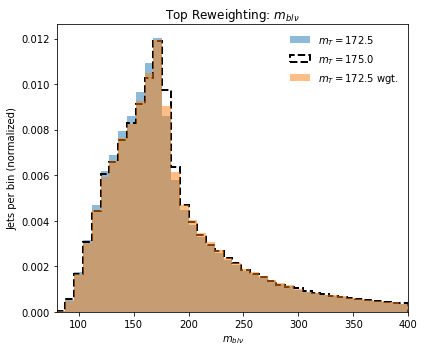

0.9990972804838746
Success. Saving weights.
(8,)
Iteration:  8
Train on 3396564 samples, validate on 849141 samples
Epoch 1/1000
 - 21s - loss: 0.5123 - acc: 0.7920 - val_loss: 0.5118 - val_acc: 0.7916
Epoch 2/1000
 - 20s - loss: 0.5114 - acc: 0.7920 - val_loss: 0.5119 - val_acc: 0.7916
Epoch 3/1000
 - 20s - loss: 0.5113 - acc: 0.7920 - val_loss: 0.5121 - val_acc: 0.7916
Epoch 4/1000
 - 19s - loss: 0.5113 - acc: 0.7920 - val_loss: 0.5119 - val_acc: 0.7916
Epoch 5/1000
 - 18s - loss: 0.5113 - acc: 0.7920 - val_loss: 0.5120 - val_acc: 0.7916
Epoch 6/1000
 - 18s - loss: 0.5112 - acc: 0.7920 - val_loss: 0.5117 - val_acc: 0.7916
Epoch 7/1000
 - 18s - loss: 0.5112 - acc: 0.7920 - val_loss: 0.5118 - val_acc: 0.7916
Epoch 8/1000
 - 20s - loss: 0.5112 - acc: 0.7920 - val_loss: 0.5117 - val_acc: 0.7916
Epoch 9/1000
 - 20s - loss: 0.5112 - acc: 0.7920 - val_loss: 0.5117 - val_acc: 0.7916
Epoch 10/1000
 - 20s - loss: 0.5112 - acc: 0.7920 - val_loss: 0.5117 - val_acc: 0.7916
Epoch 11/1000
 - 20s - 

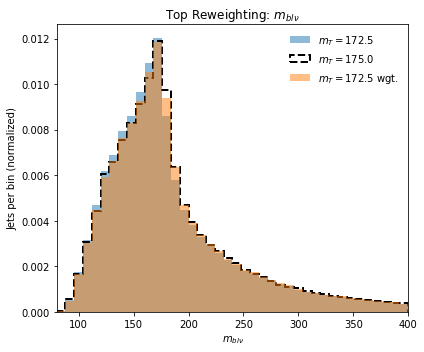

0.9996932999848478
Success. Saving weights.
(8,)
Iteration:  9
Train on 3396564 samples, validate on 849141 samples
Epoch 1/1000
 - 21s - loss: 0.5125 - acc: 0.7919 - val_loss: 0.5117 - val_acc: 0.7917
Epoch 2/1000
 - 21s - loss: 0.5114 - acc: 0.7920 - val_loss: 0.5117 - val_acc: 0.7917
Epoch 3/1000
 - 20s - loss: 0.5114 - acc: 0.7920 - val_loss: 0.5116 - val_acc: 0.7917
Epoch 4/1000
 - 19s - loss: 0.5113 - acc: 0.7920 - val_loss: 0.5117 - val_acc: 0.7917
Epoch 5/1000
 - 19s - loss: 0.5113 - acc: 0.7920 - val_loss: 0.5118 - val_acc: 0.7917
Epoch 6/1000
 - 19s - loss: 0.5113 - acc: 0.7920 - val_loss: 0.5116 - val_acc: 0.7917
Epoch 7/1000
 - 21s - loss: 0.5113 - acc: 0.7920 - val_loss: 0.5116 - val_acc: 0.7917
Epoch 8/1000
 - 20s - loss: 0.5113 - acc: 0.7920 - val_loss: 0.5116 - val_acc: 0.7917
Epoch 9/1000
 - 21s - loss: 0.5112 - acc: 0.7920 - val_loss: 0.5116 - val_acc: 0.7917
Epoch 10/1000
 - 21s - loss: 0.5112 - acc: 0.7920 - val_loss: 0.5116 - val_acc: 0.7917
Epoch 11/1000
 - 19s - 

Epoch 94/1000
 - 20s - loss: 0.5110 - acc: 0.7920 - val_loss: 0.5113 - val_acc: 0.7917
Epoch 95/1000
 - 21s - loss: 0.5110 - acc: 0.7920 - val_loss: 0.5113 - val_acc: 0.7917
Epoch 96/1000
 - 19s - loss: 0.5110 - acc: 0.7920 - val_loss: 0.5115 - val_acc: 0.7917
Epoch 97/1000
 - 19s - loss: 0.5110 - acc: 0.7920 - val_loss: 0.5114 - val_acc: 0.7917
Epoch 98/1000
 - 19s - loss: 0.5110 - acc: 0.7920 - val_loss: 0.5113 - val_acc: 0.7917
Epoch 99/1000
 - 20s - loss: 0.5110 - acc: 0.7920 - val_loss: 0.5114 - val_acc: 0.7917
Epoch 100/1000
 - 20s - loss: 0.5110 - acc: 0.7920 - val_loss: 0.5113 - val_acc: 0.7917


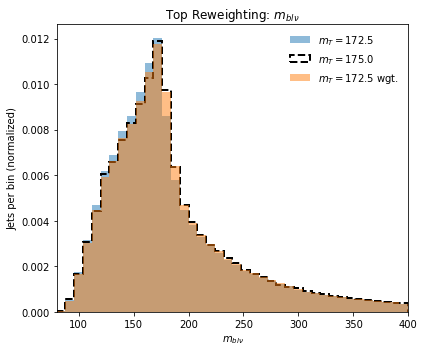

0.9998008187758766
Success. Saving weights.
(8,)
Iteration:  10
Train on 3396564 samples, validate on 849141 samples
Epoch 1/1000
 - 21s - loss: 0.5129 - acc: 0.7914 - val_loss: 0.5112 - val_acc: 0.7921
Epoch 2/1000
 - 20s - loss: 0.5115 - acc: 0.7919 - val_loss: 0.5112 - val_acc: 0.7921
Epoch 3/1000
 - 19s - loss: 0.5115 - acc: 0.7919 - val_loss: 0.5112 - val_acc: 0.7921
Epoch 4/1000
 - 19s - loss: 0.5115 - acc: 0.7919 - val_loss: 0.5114 - val_acc: 0.7921
Epoch 5/1000
 - 19s - loss: 0.5115 - acc: 0.7919 - val_loss: 0.5111 - val_acc: 0.7921
Epoch 6/1000
 - 21s - loss: 0.5114 - acc: 0.7919 - val_loss: 0.5111 - val_acc: 0.7921
Epoch 7/1000
 - 20s - loss: 0.5114 - acc: 0.7919 - val_loss: 0.5111 - val_acc: 0.7921
Epoch 8/1000
 - 20s - loss: 0.5114 - acc: 0.7919 - val_loss: 0.5110 - val_acc: 0.7921
Epoch 9/1000
 - 20s - loss: 0.5114 - acc: 0.7919 - val_loss: 0.5112 - val_acc: 0.7921
Epoch 10/1000
 - 19s - loss: 0.5114 - acc: 0.7919 - val_loss: 0.5110 - val_acc: 0.7921
Epoch 11/1000
 - 19s -

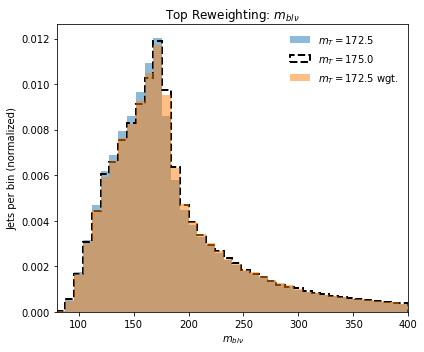

0.9997521870282874
Success. Saving weights.
(8,)
Iteration:  11
Train on 3396564 samples, validate on 849141 samples
Epoch 1/1000
 - 21s - loss: 0.5127 - acc: 0.7916 - val_loss: 0.5113 - val_acc: 0.7920
Epoch 2/1000
 - 20s - loss: 0.5115 - acc: 0.7919 - val_loss: 0.5113 - val_acc: 0.7920
Epoch 3/1000
 - 19s - loss: 0.5115 - acc: 0.7919 - val_loss: 0.5112 - val_acc: 0.7920
Epoch 4/1000
 - 18s - loss: 0.5114 - acc: 0.7919 - val_loss: 0.5113 - val_acc: 0.7920
Epoch 5/1000
 - 19s - loss: 0.5114 - acc: 0.7919 - val_loss: 0.5113 - val_acc: 0.7920
Epoch 6/1000
 - 21s - loss: 0.5114 - acc: 0.7919 - val_loss: 0.5114 - val_acc: 0.7920
Epoch 7/1000
 - 21s - loss: 0.5114 - acc: 0.7919 - val_loss: 0.5114 - val_acc: 0.7920
Epoch 8/1000
 - 20s - loss: 0.5114 - acc: 0.7919 - val_loss: 0.5113 - val_acc: 0.7920
Epoch 9/1000
 - 21s - loss: 0.5114 - acc: 0.7919 - val_loss: 0.5113 - val_acc: 0.7920
Epoch 10/1000
 - 19s - loss: 0.5114 - acc: 0.7919 - val_loss: 0.5112 - val_acc: 0.7920
Epoch 11/1000
 - 19s -

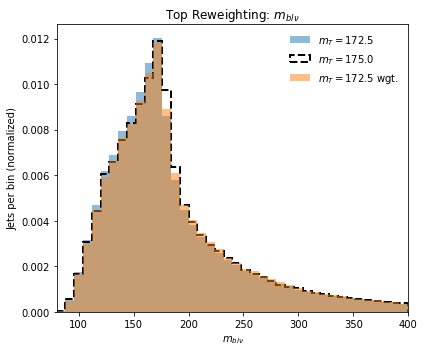

0.9988912702764625
Iteration:  12
Train on 3396564 samples, validate on 849141 samples
Epoch 1/1000
 - 22s - loss: 0.5120 - acc: 0.7922 - val_loss: 0.5132 - val_acc: 0.7909
Epoch 2/1000
 - 20s - loss: 0.5111 - acc: 0.7922 - val_loss: 0.5129 - val_acc: 0.7909
Epoch 3/1000
 - 19s - loss: 0.5111 - acc: 0.7922 - val_loss: 0.5128 - val_acc: 0.7909
Epoch 4/1000
 - 19s - loss: 0.5111 - acc: 0.7922 - val_loss: 0.5128 - val_acc: 0.7909
Epoch 5/1000
 - 19s - loss: 0.5110 - acc: 0.7922 - val_loss: 0.5128 - val_acc: 0.7909
Epoch 6/1000
 - 21s - loss: 0.5110 - acc: 0.7922 - val_loss: 0.5127 - val_acc: 0.7909
Epoch 7/1000
 - 21s - loss: 0.5110 - acc: 0.7922 - val_loss: 0.5127 - val_acc: 0.7909
Epoch 8/1000
 - 20s - loss: 0.5110 - acc: 0.7922 - val_loss: 0.5127 - val_acc: 0.7909
Epoch 9/1000
 - 21s - loss: 0.5110 - acc: 0.7922 - val_loss: 0.5129 - val_acc: 0.7909
Epoch 10/1000
 - 19s - loss: 0.5110 - acc: 0.7922 - val_loss: 0.5127 - val_acc: 0.7909
Epoch 11/1000
 - 19s - loss: 0.5110 - acc: 0.7922 - 

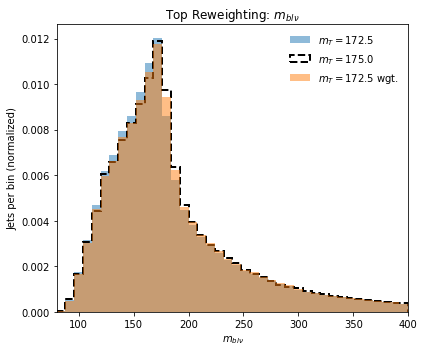

0.9996484275221914
Success. Saving weights.
(8,)
Iteration:  13
Train on 3396564 samples, validate on 849141 samples
Epoch 1/1000
 - 21s - loss: 0.5122 - acc: 0.7920 - val_loss: 0.5124 - val_acc: 0.7912
Epoch 2/1000
 - 21s - loss: 0.5112 - acc: 0.7921 - val_loss: 0.5123 - val_acc: 0.7912
Epoch 3/1000
 - 21s - loss: 0.5112 - acc: 0.7921 - val_loss: 0.5126 - val_acc: 0.7912
Epoch 4/1000
 - 21s - loss: 0.5112 - acc: 0.7921 - val_loss: 0.5123 - val_acc: 0.7912
Epoch 5/1000
 - 20s - loss: 0.5112 - acc: 0.7921 - val_loss: 0.5123 - val_acc: 0.7912
Epoch 6/1000
 - 19s - loss: 0.5111 - acc: 0.7921 - val_loss: 0.5122 - val_acc: 0.7912
Epoch 7/1000
 - 19s - loss: 0.5111 - acc: 0.7921 - val_loss: 0.5123 - val_acc: 0.7912
Epoch 8/1000
 - 20s - loss: 0.5111 - acc: 0.7921 - val_loss: 0.5123 - val_acc: 0.7912
Epoch 9/1000
 - 21s - loss: 0.5111 - acc: 0.7921 - val_loss: 0.5123 - val_acc: 0.7912
Epoch 10/1000
 - 21s - loss: 0.5111 - acc: 0.7921 - val_loss: 0.5122 - val_acc: 0.7912
Epoch 11/1000
 - 20s -

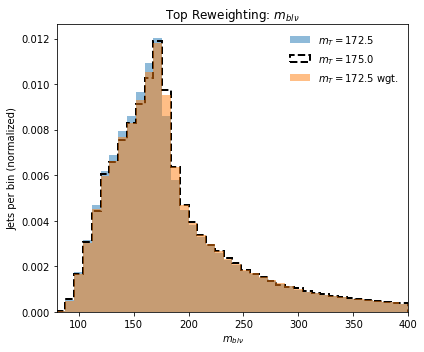

0.9997459637590559
Success. Saving weights.
(8,)
Iteration:  14
Train on 3396564 samples, validate on 849141 samples
Epoch 1/1000
 - 20s - loss: 0.5130 - acc: 0.7914 - val_loss: 0.5111 - val_acc: 0.7922
Epoch 2/1000
 - 20s - loss: 0.5116 - acc: 0.7918 - val_loss: 0.5111 - val_acc: 0.7922
Epoch 3/1000
 - 21s - loss: 0.5116 - acc: 0.7918 - val_loss: 0.5109 - val_acc: 0.7922
Epoch 4/1000
 - 21s - loss: 0.5115 - acc: 0.7918 - val_loss: 0.5109 - val_acc: 0.7922
Epoch 5/1000
 - 21s - loss: 0.5115 - acc: 0.7918 - val_loss: 0.5109 - val_acc: 0.7922
Epoch 6/1000
 - 20s - loss: 0.5115 - acc: 0.7918 - val_loss: 0.5109 - val_acc: 0.7922
Epoch 7/1000
 - 19s - loss: 0.5115 - acc: 0.7918 - val_loss: 0.5109 - val_acc: 0.7922
Epoch 8/1000
 - 19s - loss: 0.5115 - acc: 0.7918 - val_loss: 0.5109 - val_acc: 0.7922
Epoch 9/1000
 - 20s - loss: 0.5115 - acc: 0.7918 - val_loss: 0.5109 - val_acc: 0.7922
Epoch 10/1000
 - 21s - loss: 0.5114 - acc: 0.7918 - val_loss: 0.5108 - val_acc: 0.7922
Epoch 11/1000
 - 21s -

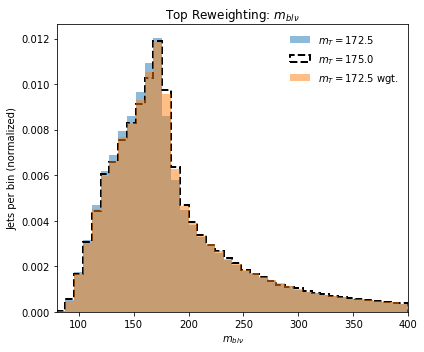

0.9997618937398303
Success. Saving weights.
(8,)
Iteration:  15
Train on 3396564 samples, validate on 849141 samples
Epoch 1/1000
 - 20s - loss: 0.5126 - acc: 0.7919 - val_loss: 0.5119 - val_acc: 0.7917
Epoch 2/1000
 - 20s - loss: 0.5114 - acc: 0.7920 - val_loss: 0.5118 - val_acc: 0.7917
Epoch 3/1000
 - 21s - loss: 0.5113 - acc: 0.7920 - val_loss: 0.5117 - val_acc: 0.7917
Epoch 4/1000
 - 21s - loss: 0.5113 - acc: 0.7920 - val_loss: 0.5118 - val_acc: 0.7917
Epoch 5/1000
 - 21s - loss: 0.5113 - acc: 0.7920 - val_loss: 0.5117 - val_acc: 0.7917
Epoch 6/1000
 - 21s - loss: 0.5113 - acc: 0.7920 - val_loss: 0.5119 - val_acc: 0.7917
Epoch 7/1000
 - 19s - loss: 0.5113 - acc: 0.7920 - val_loss: 0.5116 - val_acc: 0.7917
Epoch 8/1000
 - 19s - loss: 0.5113 - acc: 0.7920 - val_loss: 0.5116 - val_acc: 0.7917
Epoch 9/1000
 - 19s - loss: 0.5112 - acc: 0.7920 - val_loss: 0.5118 - val_acc: 0.7917
Epoch 10/1000
 - 21s - loss: 0.5112 - acc: 0.7920 - val_loss: 0.5116 - val_acc: 0.7917
Epoch 11/1000
 - 21s -

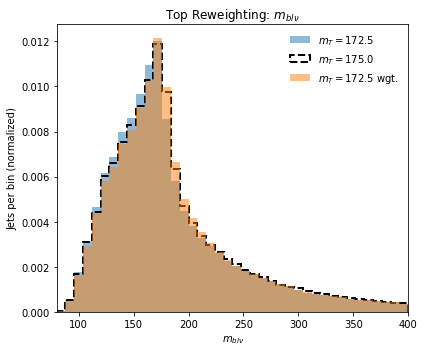

0.9992752786728509
Success. Saving weights.
(8,)


In [15]:
iterations = 15

dctr_weights = []
earlystopping = EarlyStopping(patience=15, restore_best_weights=True)

for iteration in range(iterations):
    print("Iteration: ", iteration + 1)

    X_train, X_val, Y_train, Y_val = data_split(X, Y, test=0.2, shuffle=True)

    K.clear_session()
    inputs = Input((2, ))
    hidden_layer_1 = Dense(50, activation='relu')(inputs)
    hidden_layer_2 = Dense(50, activation='relu')(hidden_layer_1)
    hidden_layer_3 = Dense(50, activation='relu')(hidden_layer_2)

    outputs = Dense(2, activation='softmax')(hidden_layer_3)

    dctr = Model(inputs=inputs, outputs=outputs)
    dctr.compile(loss='categorical_crossentropy',
                 optimizer='Adam',
                 metrics=['accuracy'])

    history = dctr.fit(X_train,
                       Y_train,
                       epochs=1000,
                       batch_size=1000,
                       validation_data=(X_val, Y_val),
                       verbose=2,
                       callbacks=[earlystopping])

    weights_1 = reweight(default_dataset=tf.convert_to_tensor(test_dataset_0_obs/1000.,dtype=tf.float32), mT=((175.0/1000)))
    weights_1 = K.eval(weights_1)



    plt.figure(figsize=(6, 5))
    plt.title(r"Top Reweighting: $m_{bl\nu}$")
    bins = np.linspace(80, 400, 41)
    hist0_mlbv = plt.hist(test_dataset_0_obs,
                        bins=bins,
                        label=label_0,
                        **plot_style_1)
    hist1_mlbv = plt.hist(test_dataset_1_obs,
                        bins=bins,
                        label=label_1,
                        **plot_style_0)
    hist2_mlbv = plt.hist(test_dataset_0_obs,
                        bins=bins,
                        label=label_0 + ' wgt.',
                        weights=weights_1,
                        **plot_style_1)

    plt.xlabel(r'$m_{bl\nu}$')
    plt.ylabel('Jets per bin (normalized)')
    plt.xlim([80, 400])
    make_legend()
    plt.show()
    
    correlation = cv2.compareHist(plt_hist_to_cv(hist1_mlbv),
                        plt_hist_to_cv(hist2_mlbv),
                        method=0)
    print(correlation)
    
    if correlation > 0.999:
        print("Success. Saving weights.")
        trial_weights = dctr.get_weights()
        print(np.shape(trial_weights))
        dctr_weights += [trial_weights]

## Train DCTR Model

### Define reweighting function

## Correlation over original sized datasets

In [132]:
test_dataset_0_obs = np.load(data_dir + 'part_172_5_6j_obs.npy')[:, 1:2]
test_dataset_1_obs = np.load(data_dir + 'part_175_0_6j_obs.npy')[:, 1:2]

test_dataset_0_obs_det = np.load(data_dir + 'det_172_5_6j_obs.npy')[:, 1:2]
test_dataset_1_obs_det = np.load(data_dir + 'det_175_0_6j_obs.npy')[:, 1:2]

print(np.shape(test_dataset_0_obs))
print(np.shape(test_dataset_1_obs))

(221723, 1)
(224595, 1)


Weight Iteration:  0
theta:  170.0


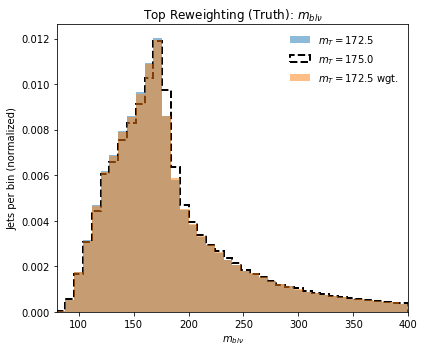

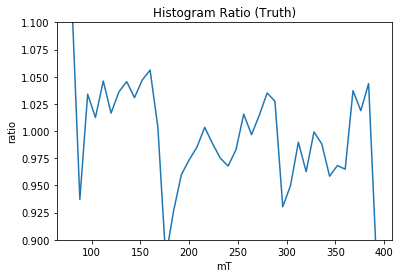

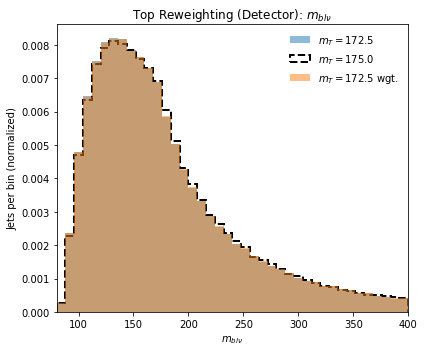

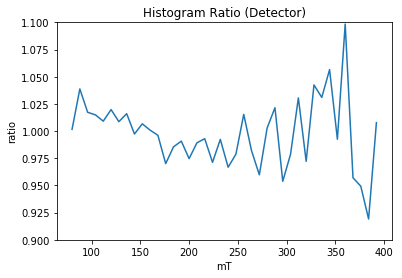

Truth Cor  0.9971010020075639
Det Cor  0.9997570558201747
theta:  170.5


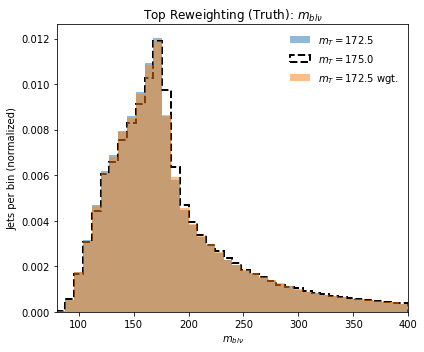

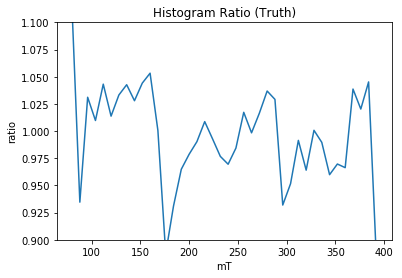

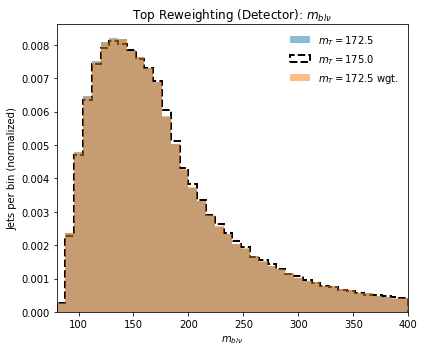

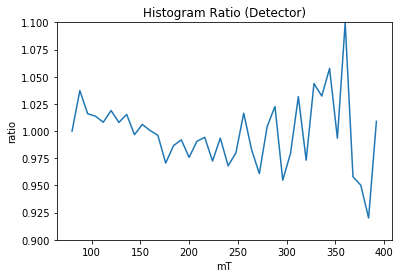

Truth Cor  0.9973706609298827
Det Cor  0.9997739034742028
theta:  171.0


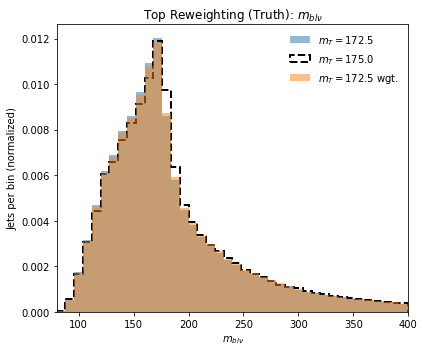

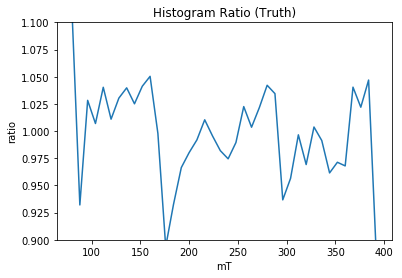

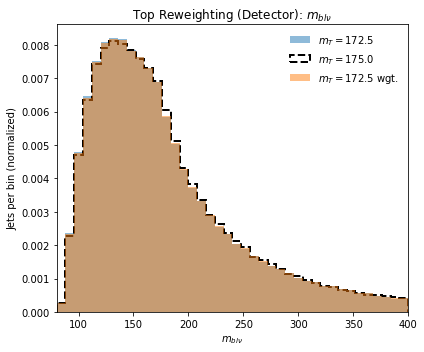

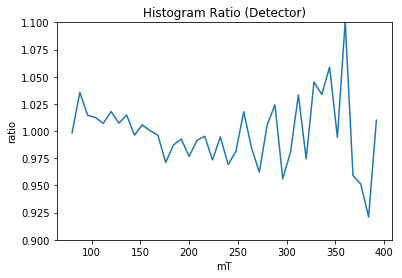

Truth Cor  0.9976436793391544
Det Cor  0.9997894567915796
theta:  171.5


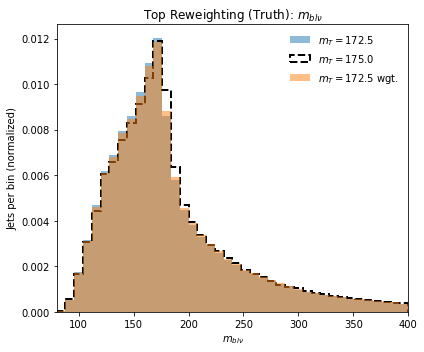

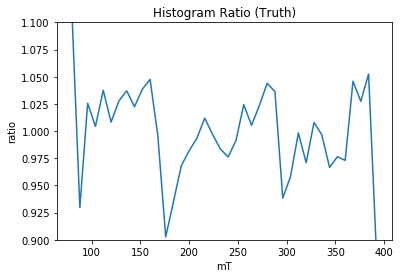

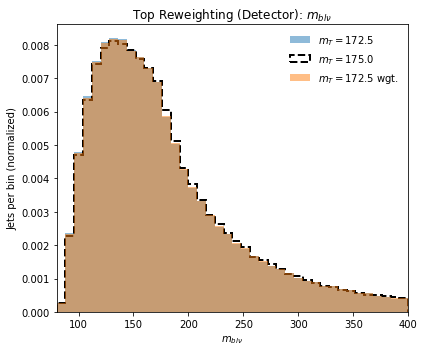

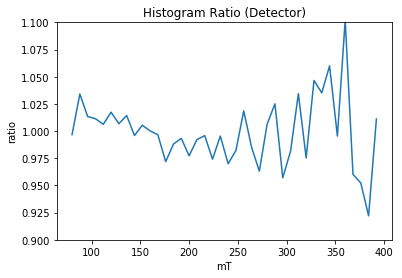

Truth Cor  0.9979670768551056
Det Cor  0.9998020864787215
theta:  172.0


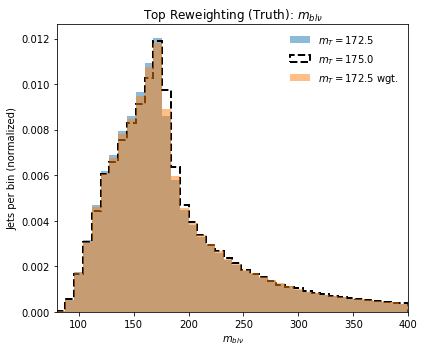

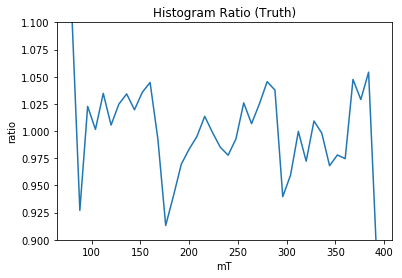

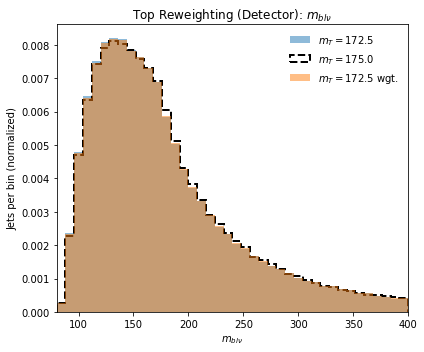

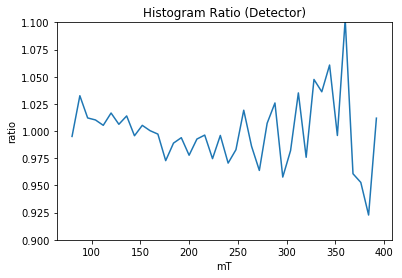

Truth Cor  0.9983138630947913
Det Cor  0.9998158236643828
theta:  172.5


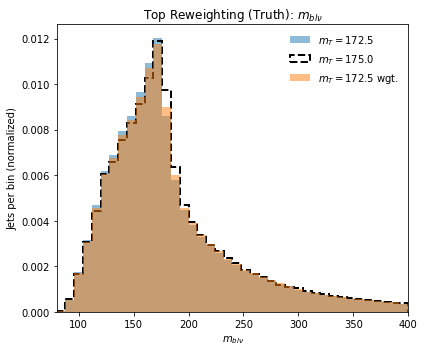

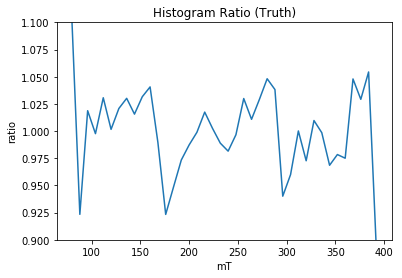

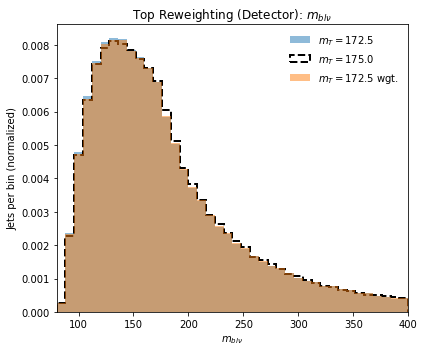

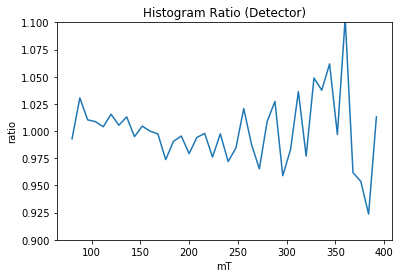

Truth Cor  0.9986643697425337
Det Cor  0.9998345434209173
theta:  173.0


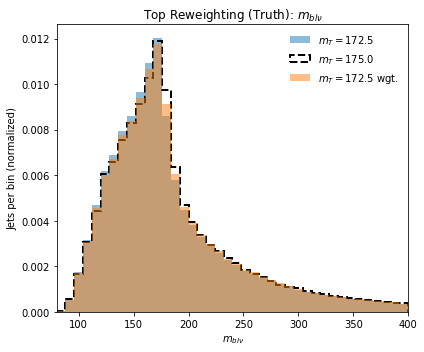

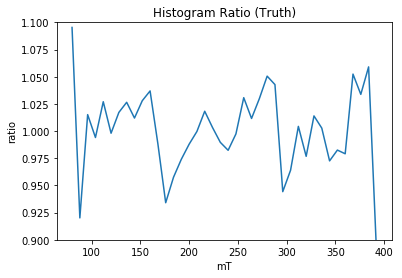

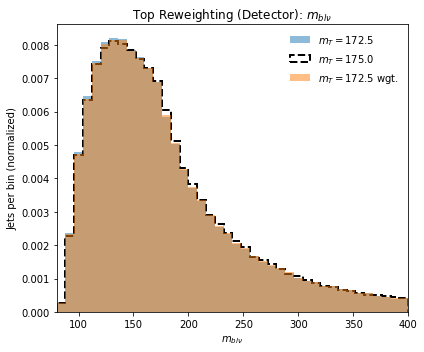

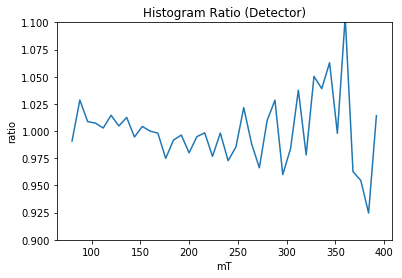

Truth Cor  0.998973525666082
Det Cor  0.9998486696379106
theta:  173.5


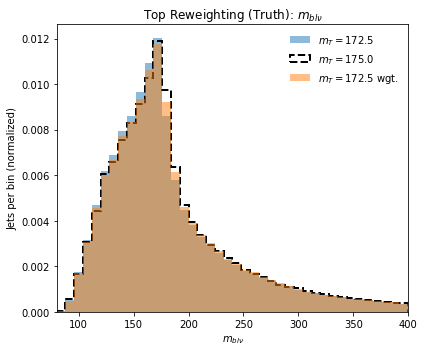

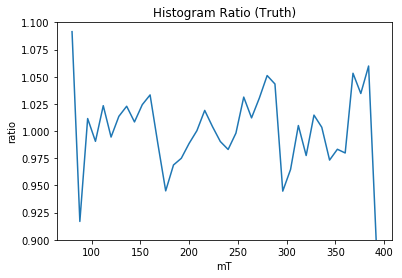

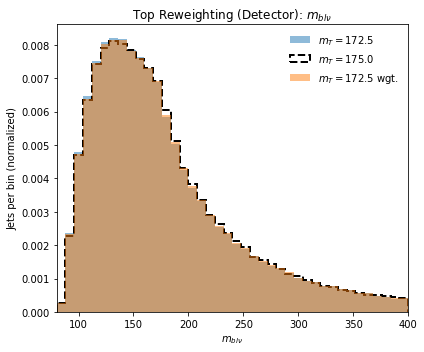

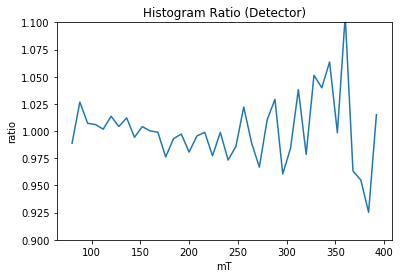

Truth Cor  0.9992502463329481
Det Cor  0.9998614354159402
theta:  174.0


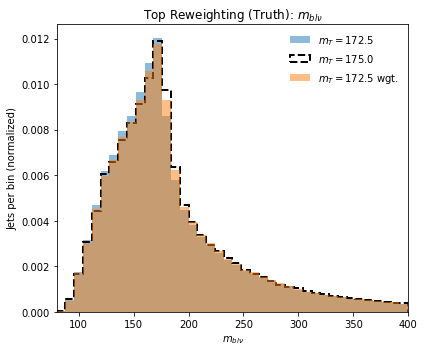

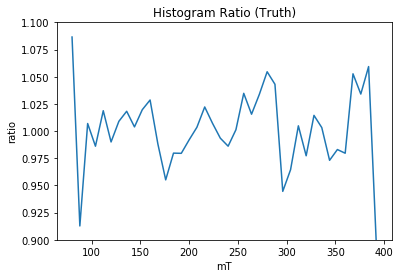

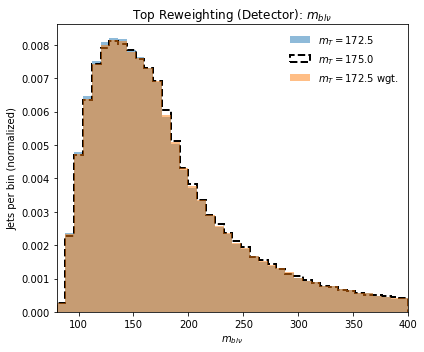

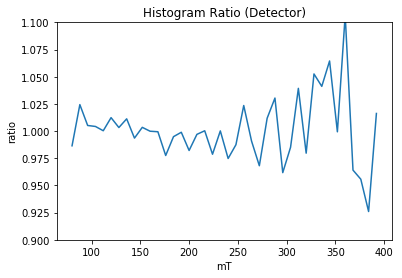

Truth Cor  0.9994815728085225
Det Cor  0.9998771070263189
theta:  174.5


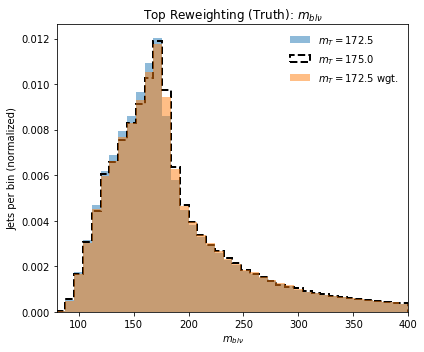

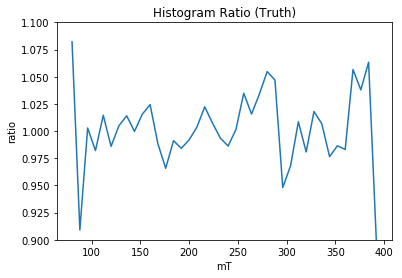

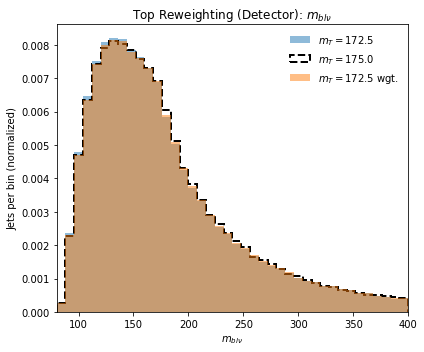

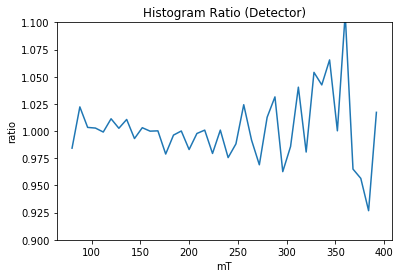

Truth Cor  0.9996577981660612
Det Cor  0.9998878779222987
theta:  175.0


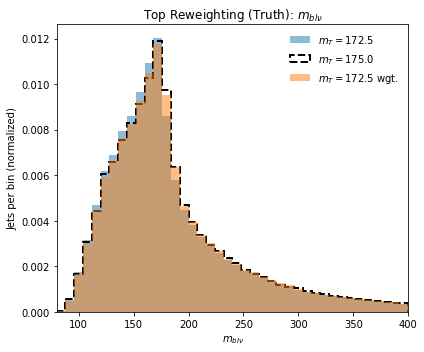

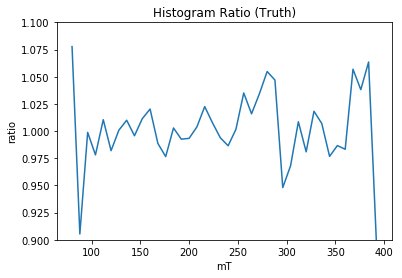

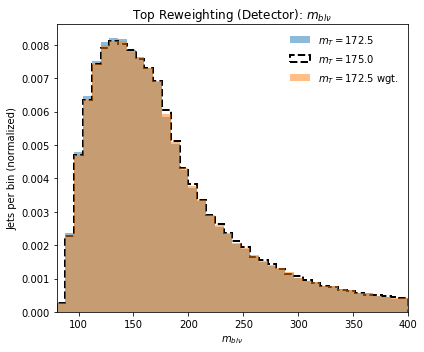

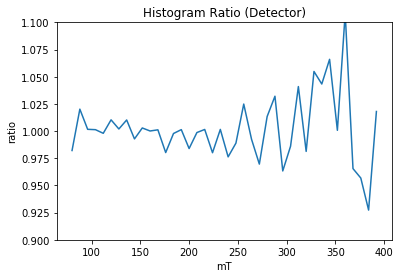

Truth Cor  0.9997768381129074
Det Cor  0.9998968398252084
theta:  175.5


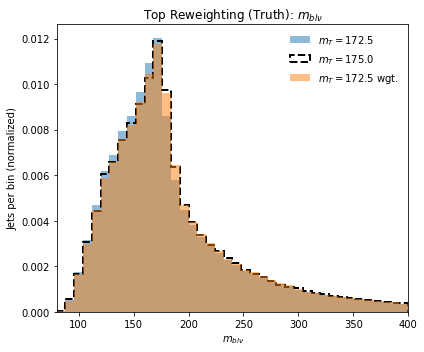

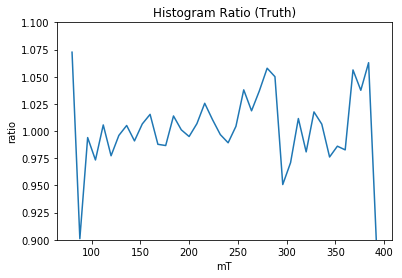

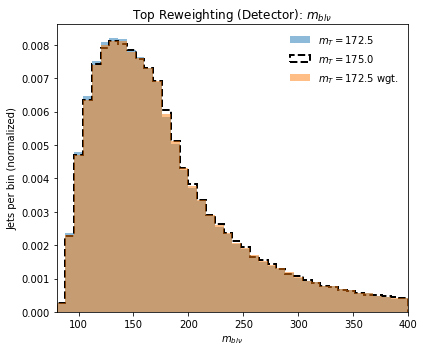

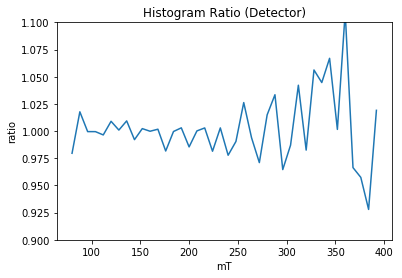

Truth Cor  0.9998290418550344
Det Cor  0.9999060805586318
theta:  176.0


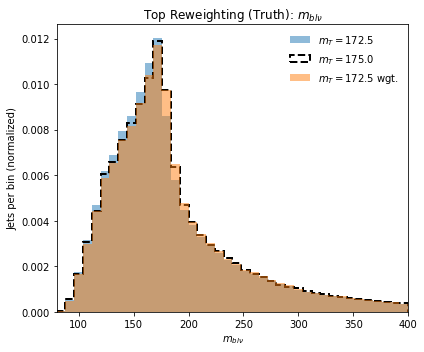

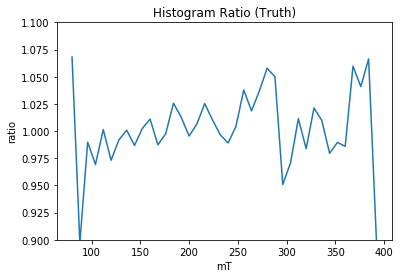

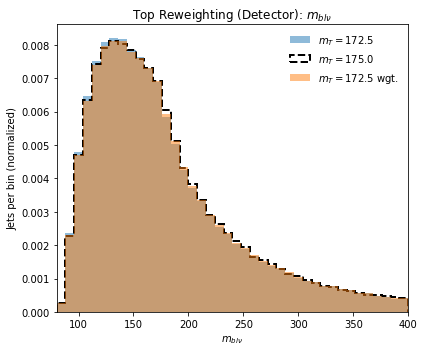

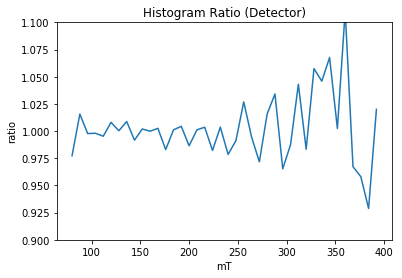

Truth Cor  0.9998192332004066
Det Cor  0.9999109901119139
theta:  176.5


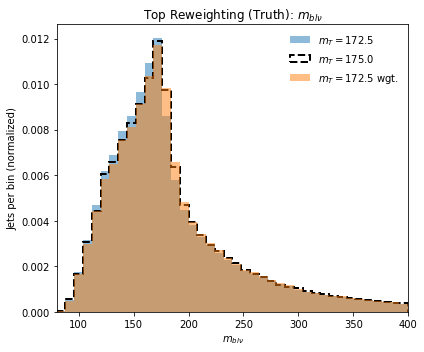

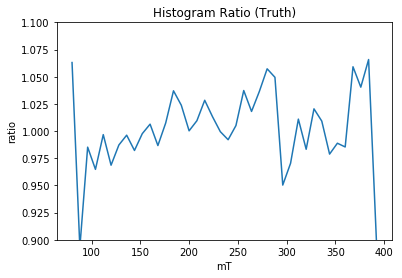

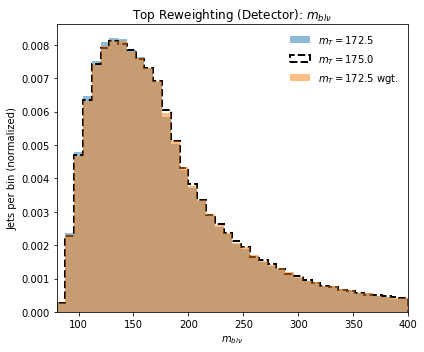

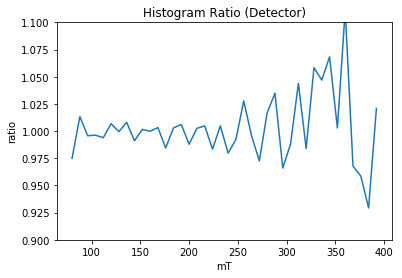

Truth Cor  0.9997396179349132
Det Cor  0.9999149655562647
theta:  177.0


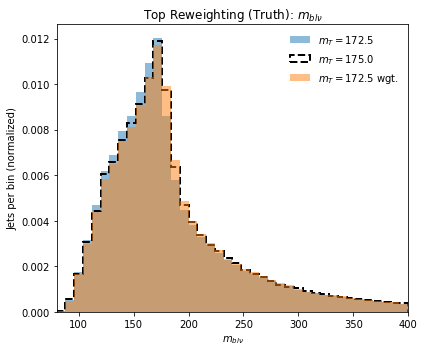

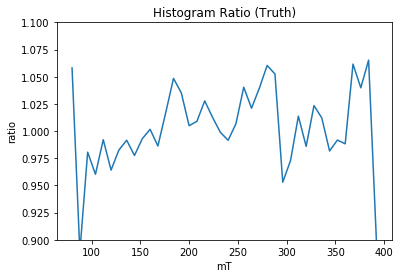

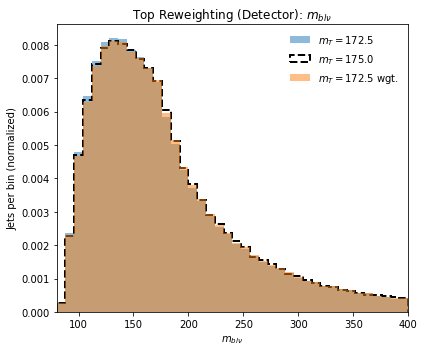

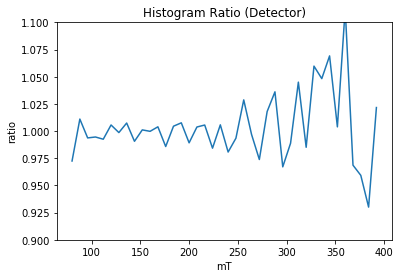

Truth Cor  0.9995975786101376
Det Cor  0.9999160423528637
theta:  177.5


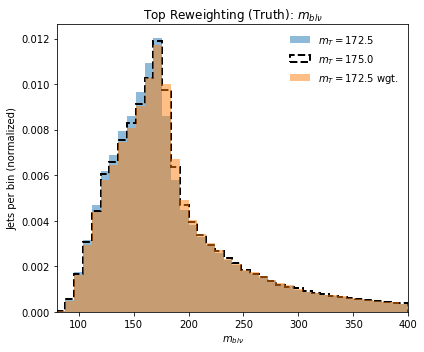

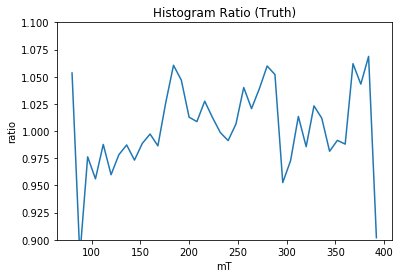

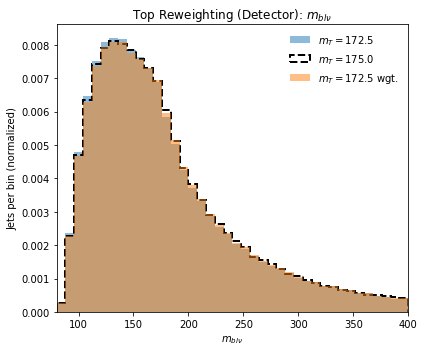

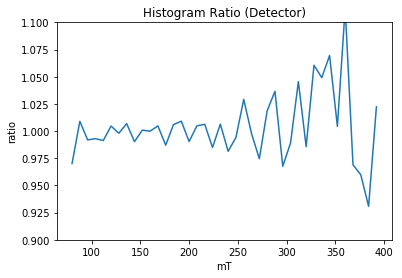

Truth Cor  0.9993957566568668
Det Cor  0.9999146992390386
theta:  178.0


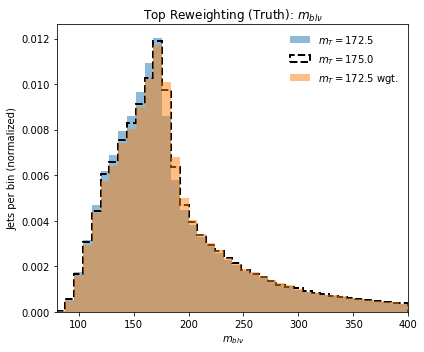

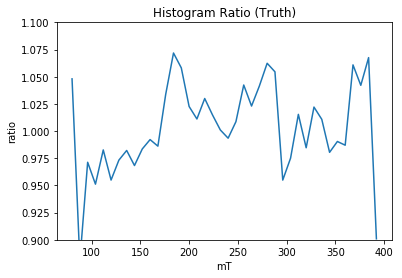

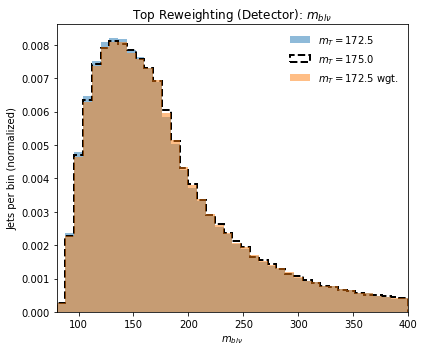

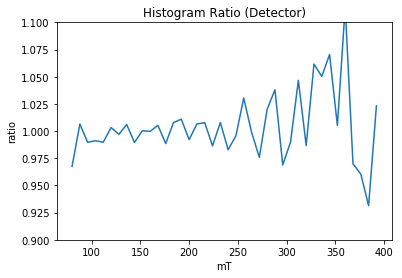

Truth Cor  0.9991265655926477
Det Cor  0.9999112482712951
theta:  178.5


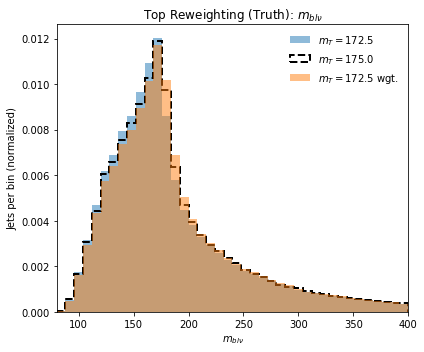

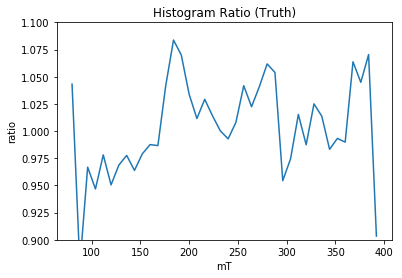

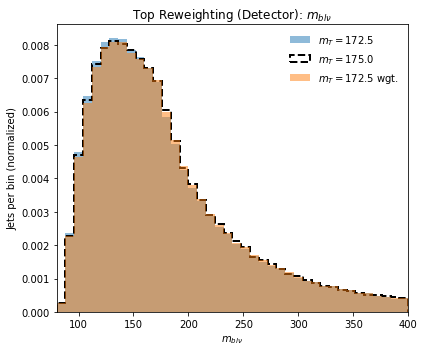

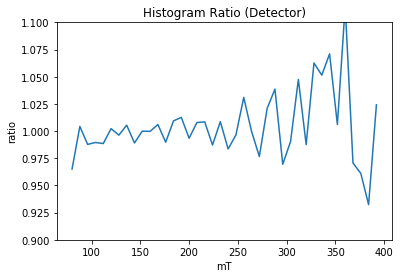

Truth Cor  0.9988038581071584
Det Cor  0.9999052169273126
theta:  179.0


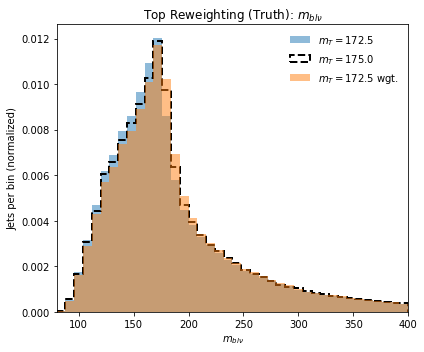

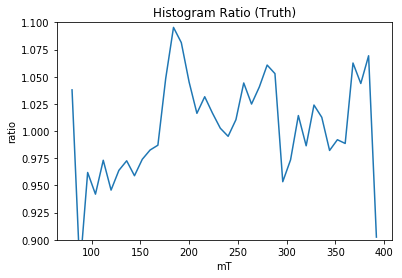

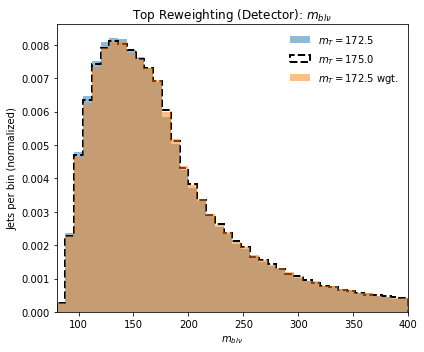

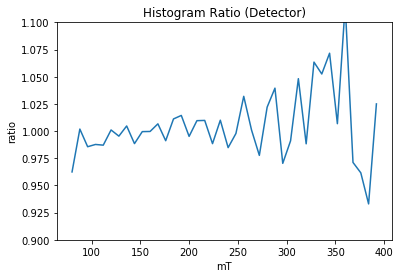

Truth Cor  0.9984178145557854
Det Cor  0.999896257231103
theta:  179.5


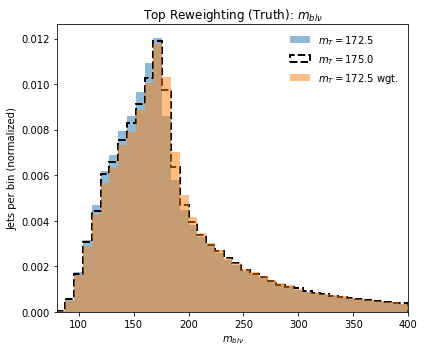

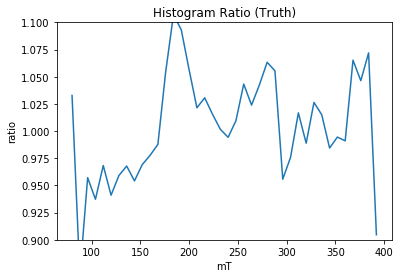

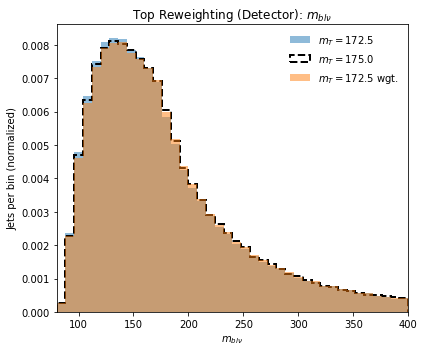

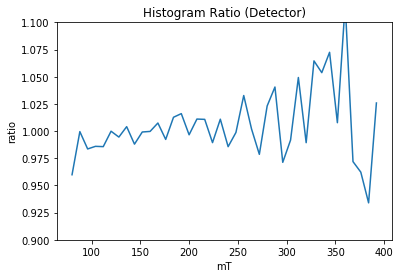

Truth Cor  0.9979807475509938
Det Cor  0.9998850107940797
theta:  180.0


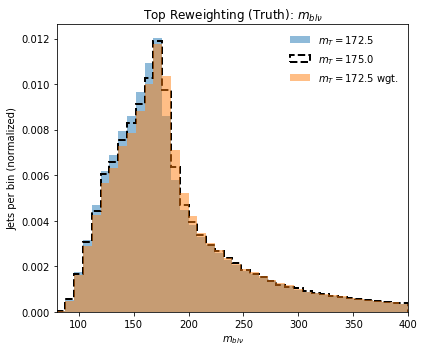

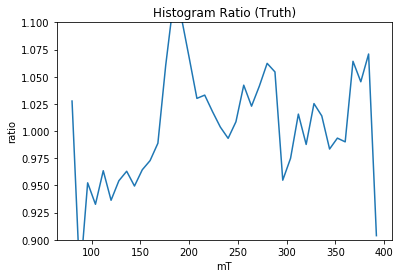

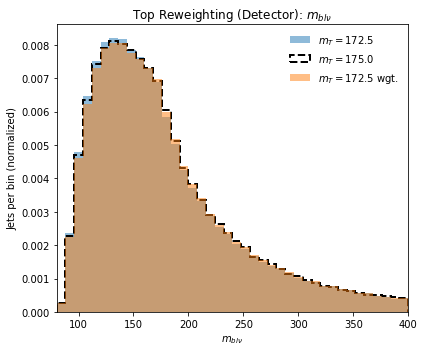

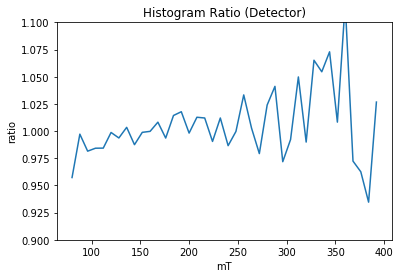

Truth Cor  0.9974822010137782
Det Cor  0.9998710746514703


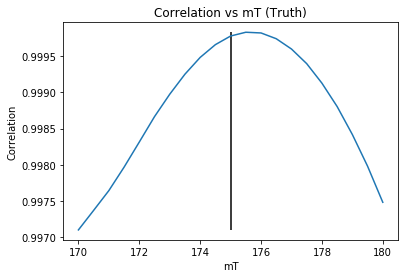

175.5


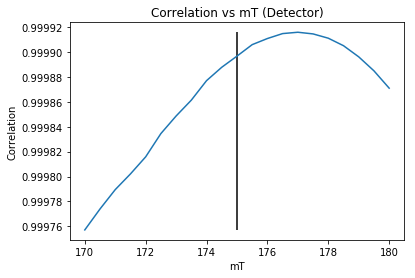

177.0
Weight Iteration:  1
theta:  170.0


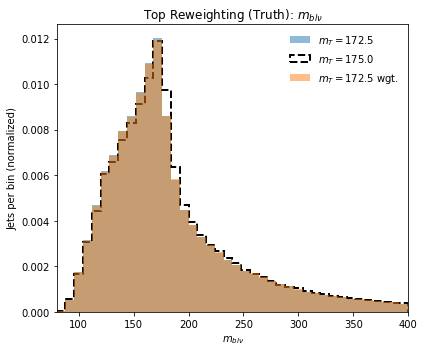

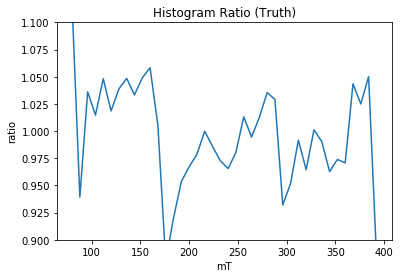

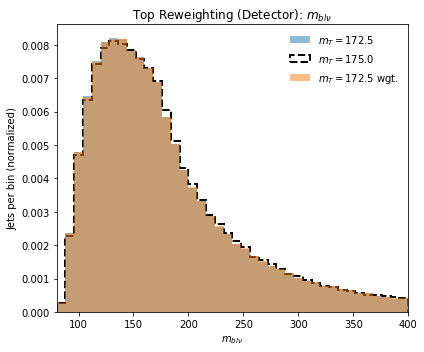

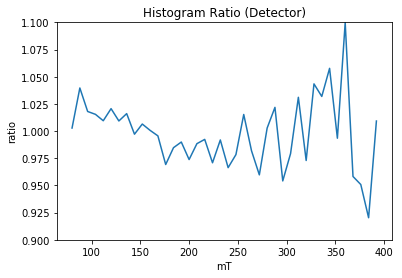

Truth Cor  0.9968549704953905
Det Cor  0.9997419985928212
theta:  170.5


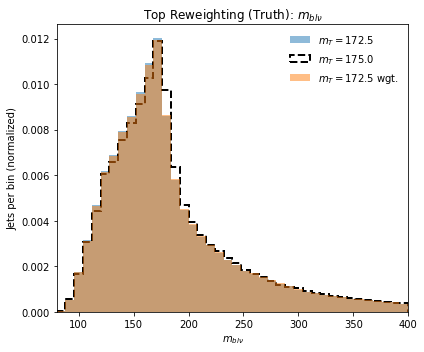

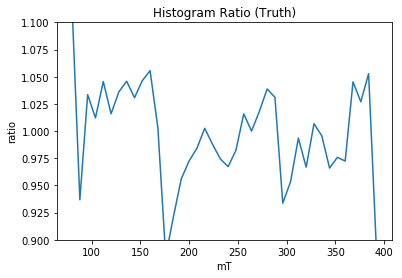

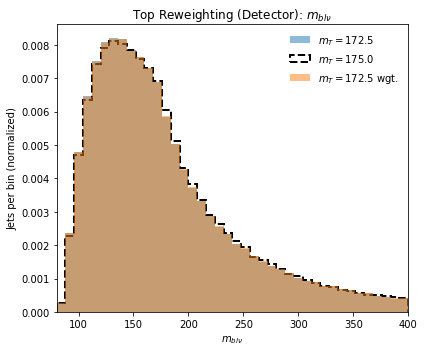

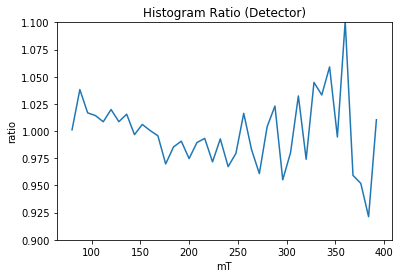

Truth Cor  0.997105261364014
Det Cor  0.9997576555775144
theta:  171.0


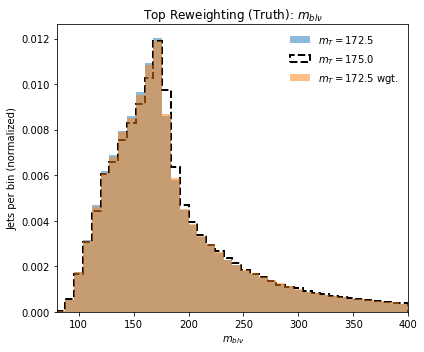

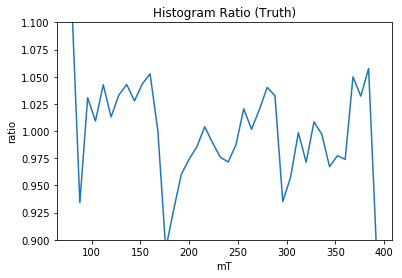

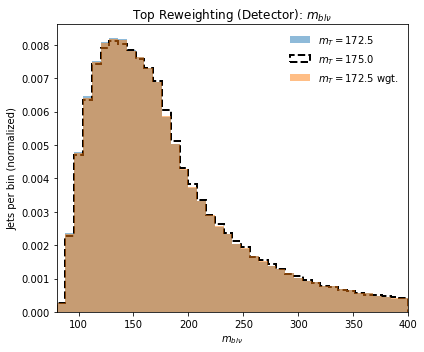

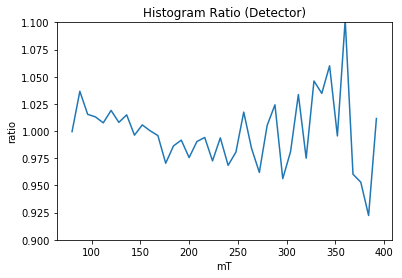

Truth Cor  0.9974445076351658
Det Cor  0.9997743061313624
theta:  171.5


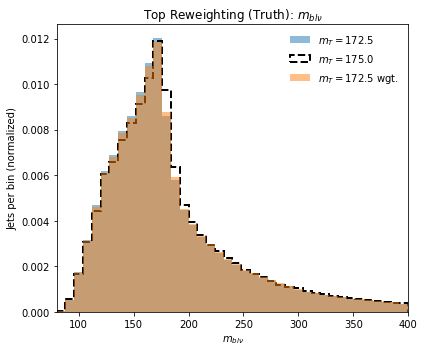

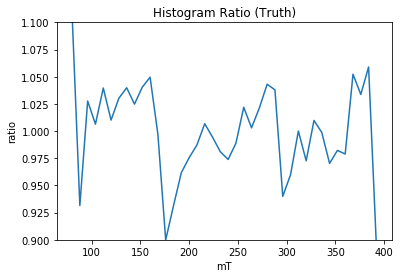

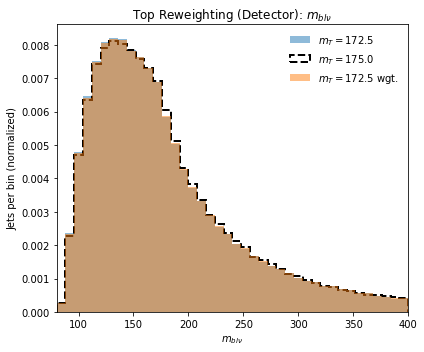

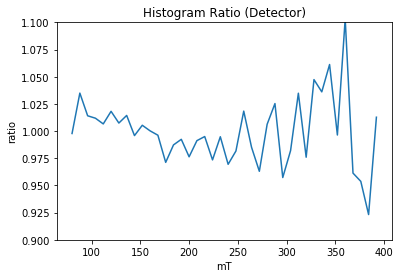

Truth Cor  0.9977874073141625
Det Cor  0.9997900954548473
theta:  172.0


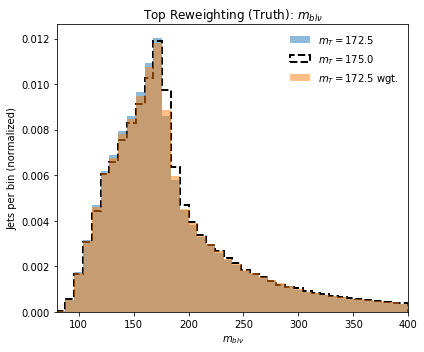

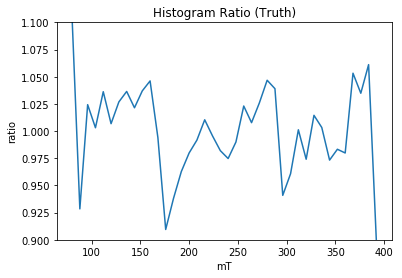

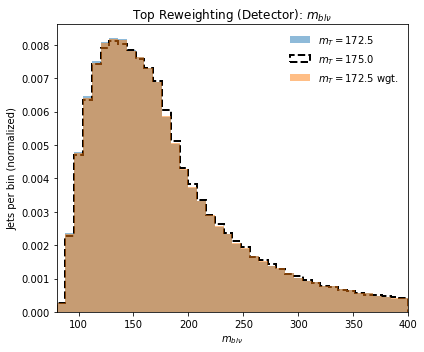

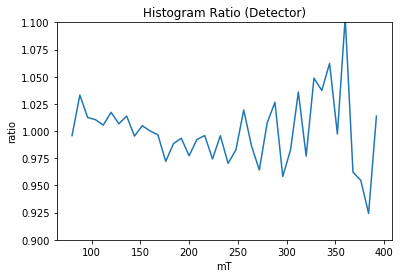

Truth Cor  0.9981589816766976
Det Cor  0.9998072481430137
theta:  172.5


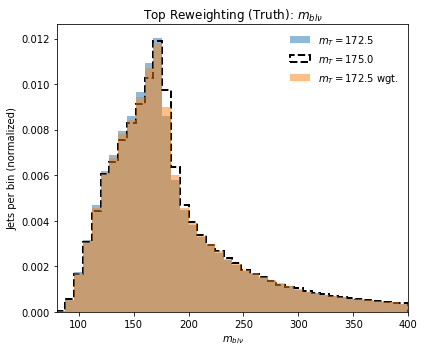

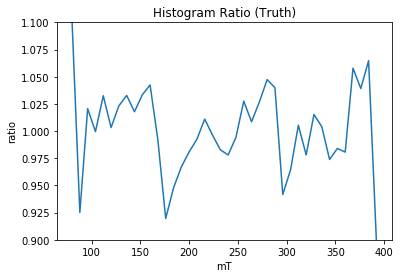

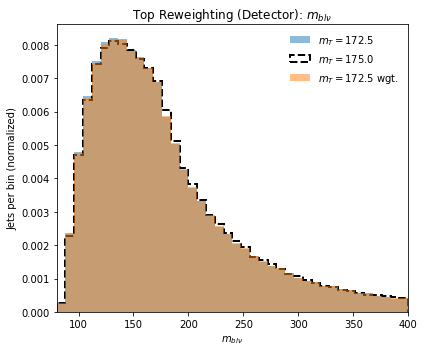

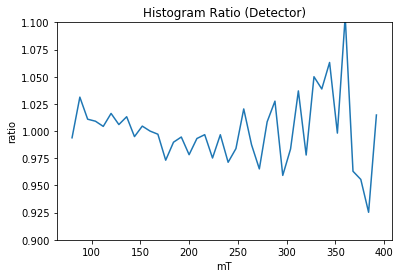

Truth Cor  0.9985294424067297
Det Cor  0.9998242837082745
theta:  173.0


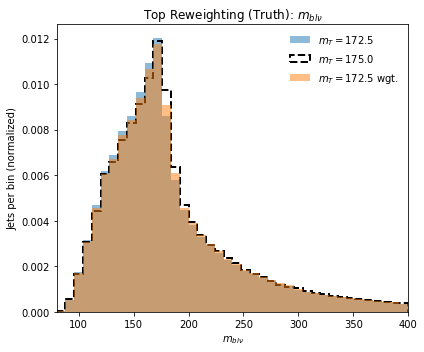

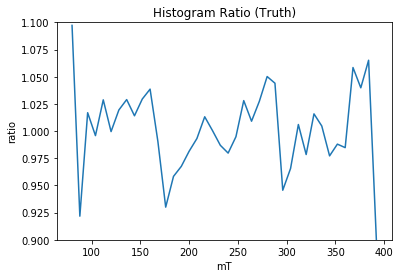

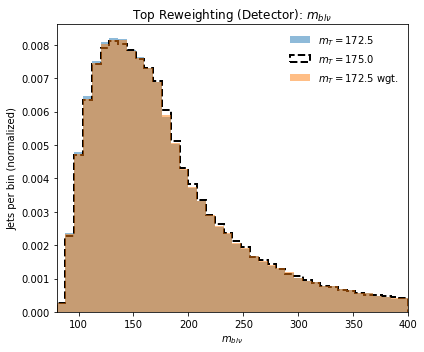

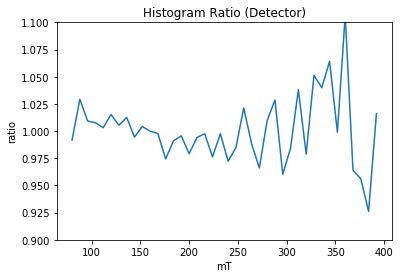

Truth Cor  0.998863565362455
Det Cor  0.9998403323317051
theta:  173.5


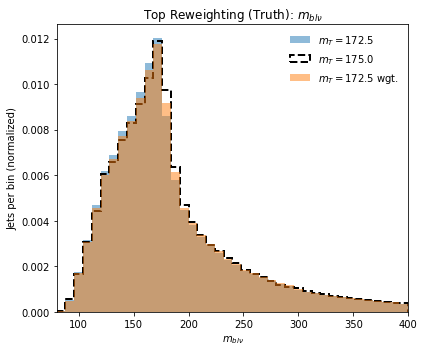

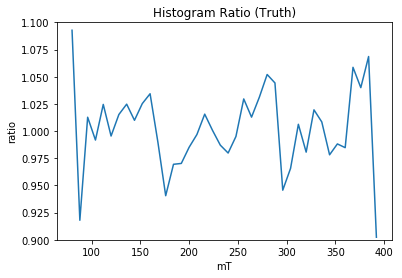

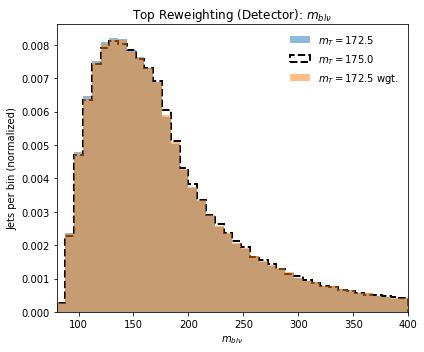

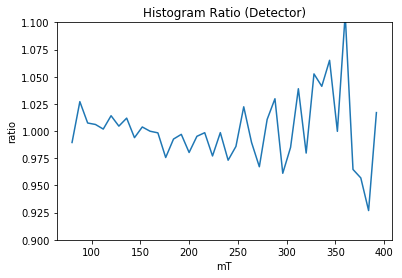

Truth Cor  0.9991638812656384
Det Cor  0.999856481322126
theta:  174.0


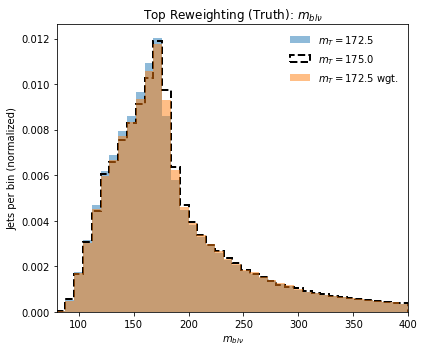

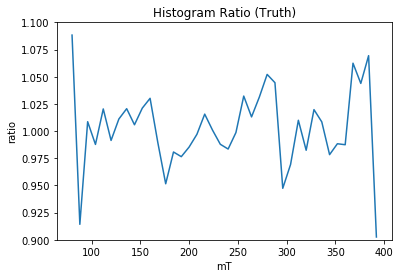

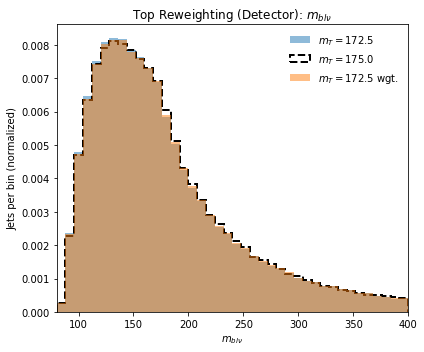

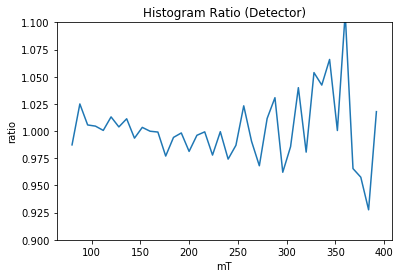

Truth Cor  0.9994175502394287
Det Cor  0.999870440720579
theta:  174.5


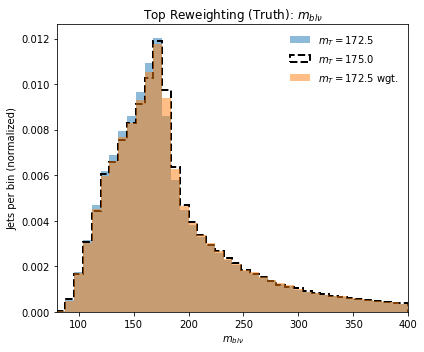

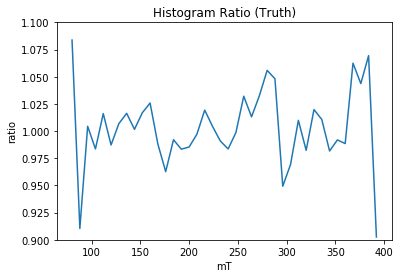

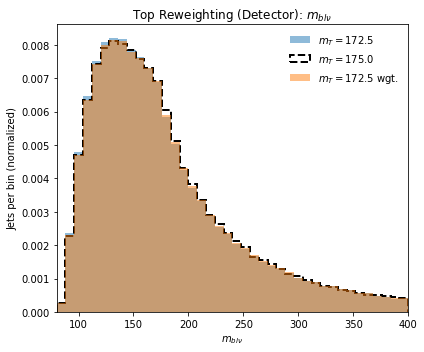

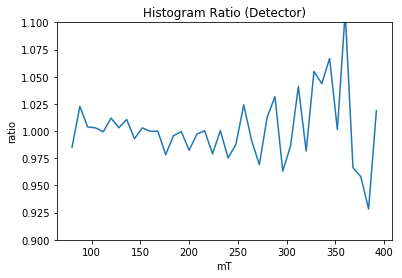

Truth Cor  0.9996101673713821
Det Cor  0.9998828495355346
theta:  175.0


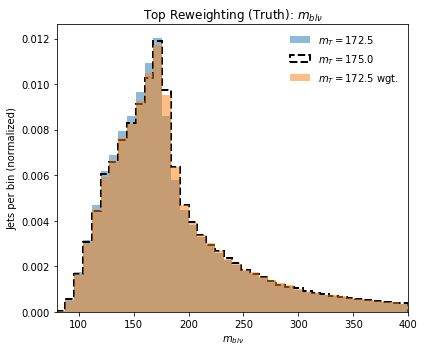

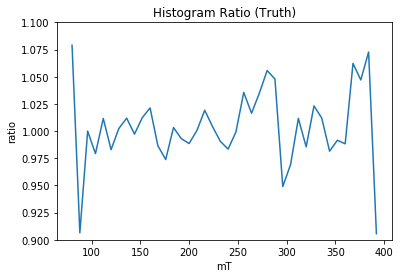

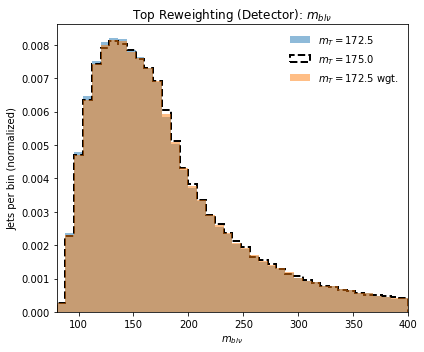

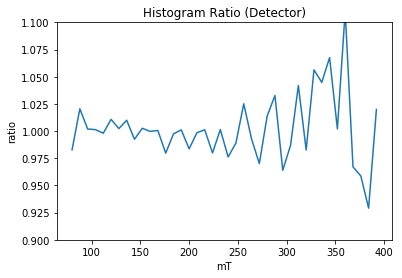

Truth Cor  0.9997429485344885
Det Cor  0.9998937159365676
theta:  175.5


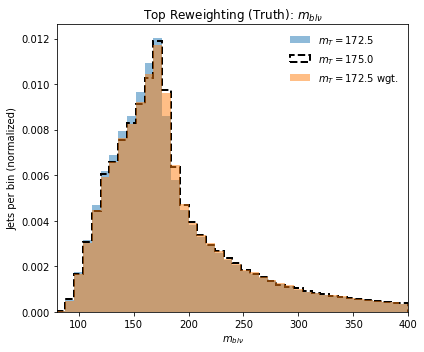

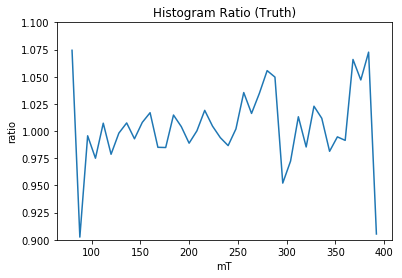

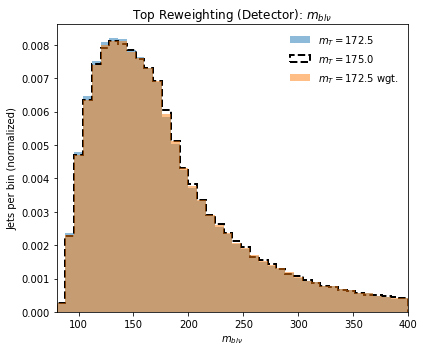

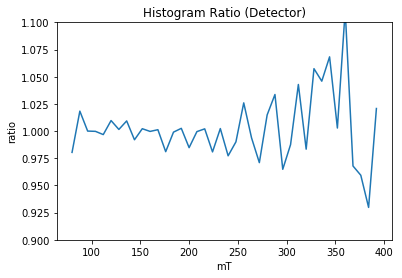

Truth Cor  0.999808455898114
Det Cor  0.9999020492344669
theta:  176.0


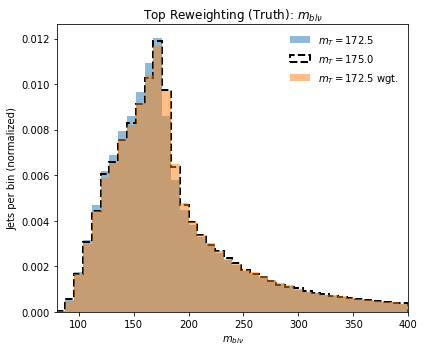

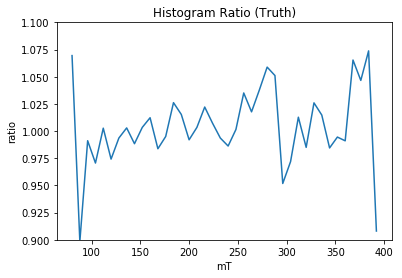

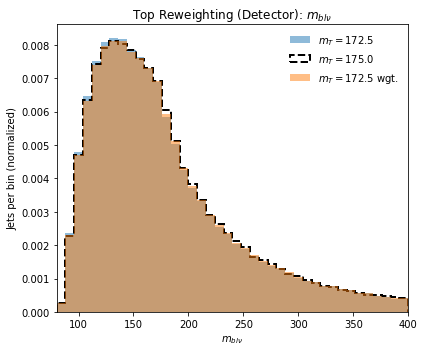

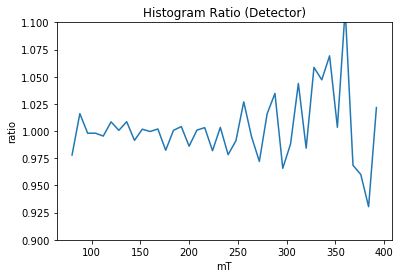

Truth Cor  0.9998017914978564
Det Cor  0.9999086555296927
theta:  176.5


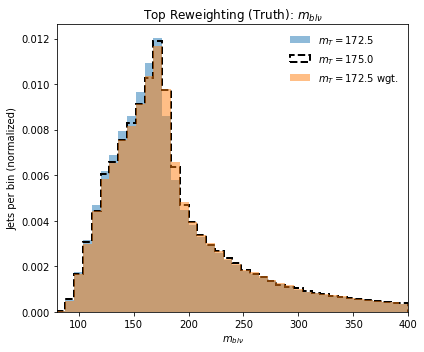

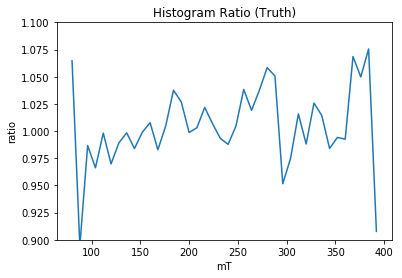

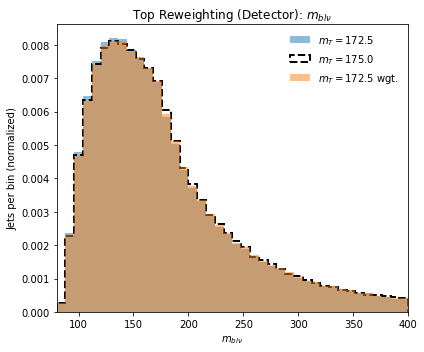

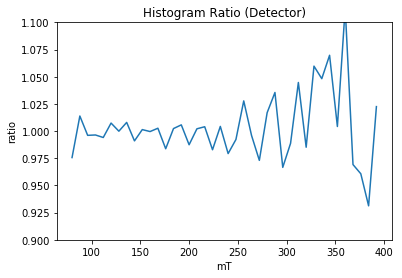

Truth Cor  0.9997344576503089
Det Cor  0.999912872839902
theta:  177.0


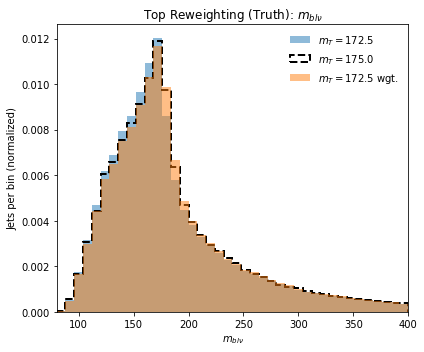

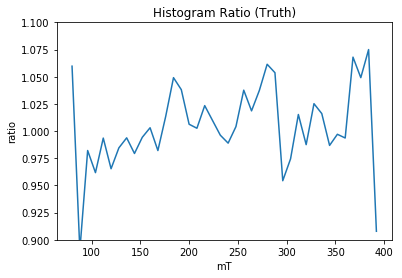

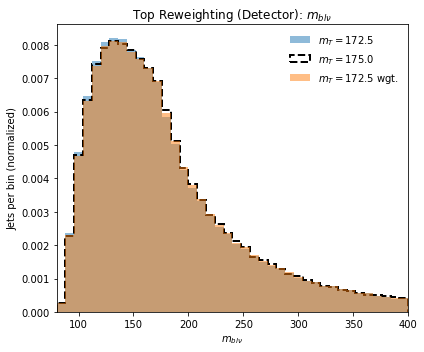

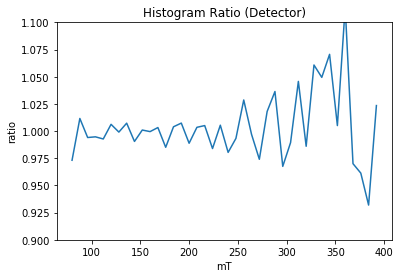

Truth Cor  0.999604117936125
Det Cor  0.9999148797090566
theta:  177.5


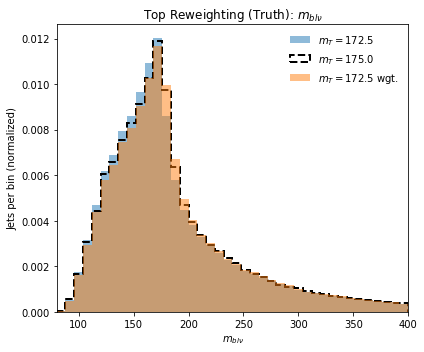

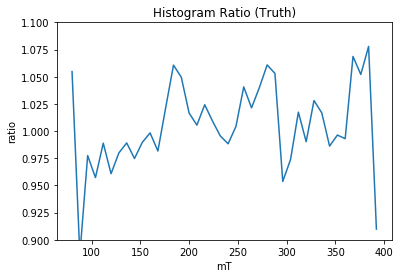

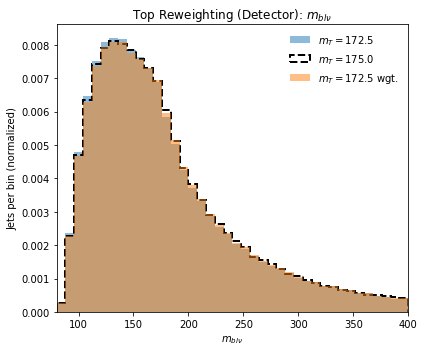

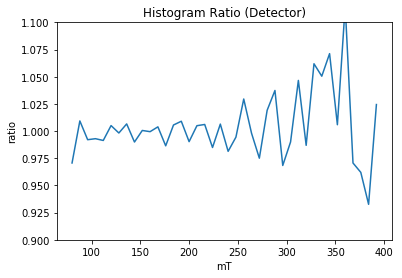

Truth Cor  0.9994121846105262
Det Cor  0.999914411583088
theta:  178.0


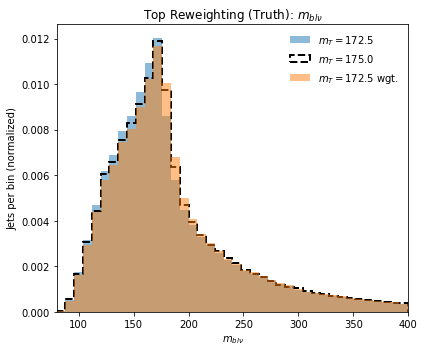

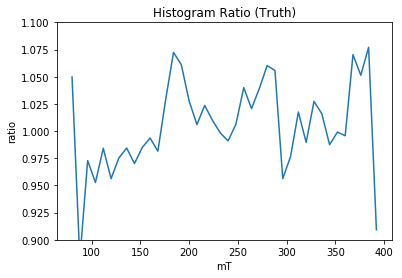

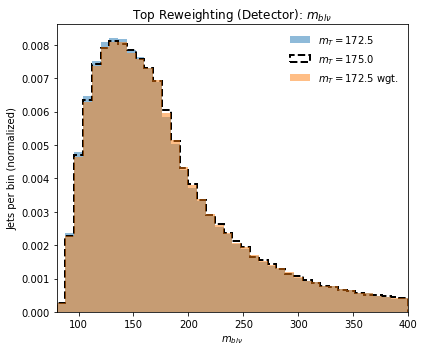

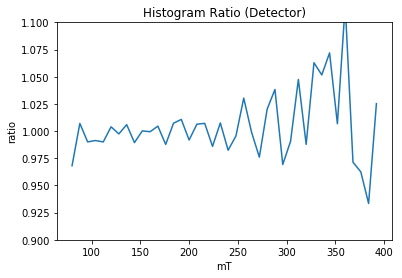

Truth Cor  0.99916475189342
Det Cor  0.999911500362008
theta:  178.5


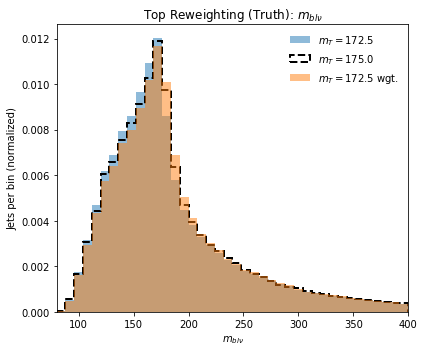

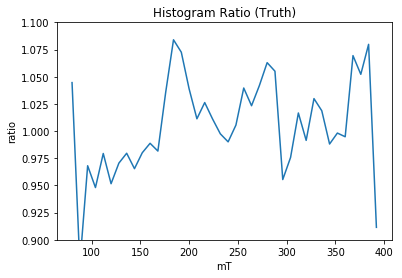

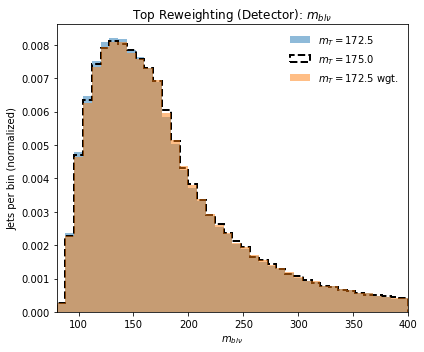

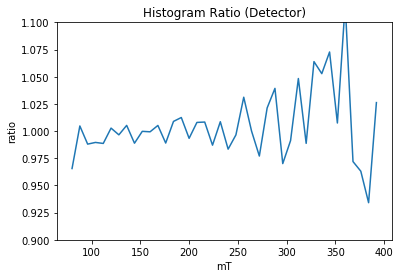

Truth Cor  0.9988575889976842
Det Cor  0.9999059596092735
theta:  179.0


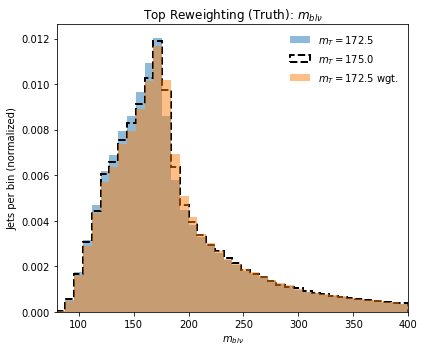

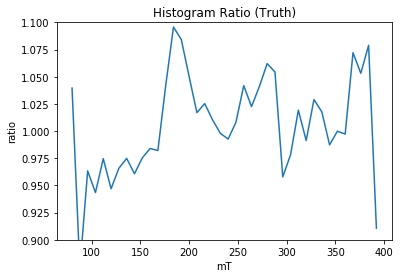

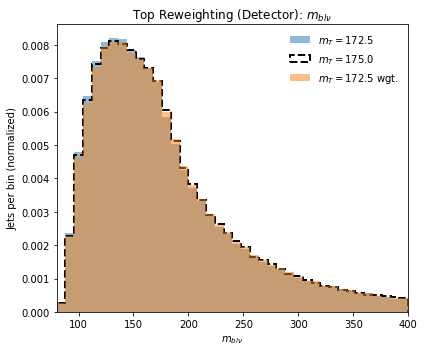

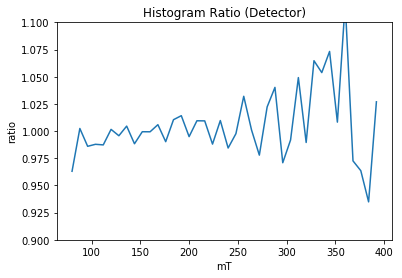

Truth Cor  0.9984994884946685
Det Cor  0.9998981630866641
theta:  179.5


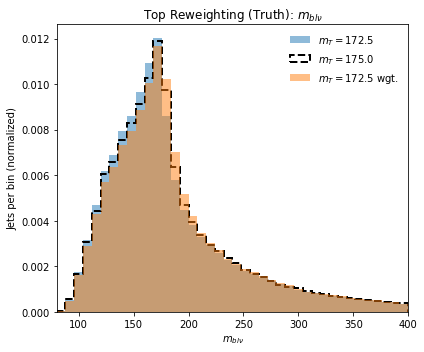

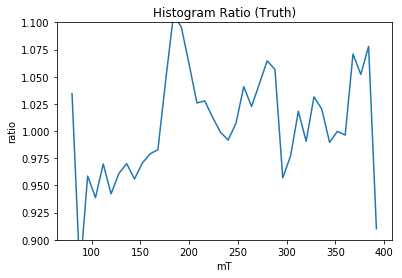

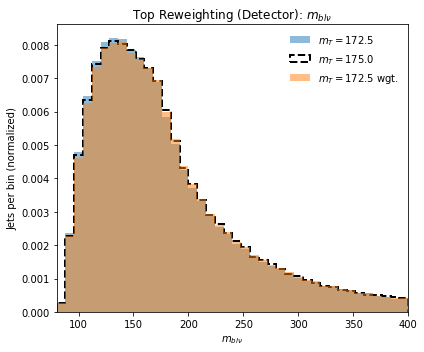

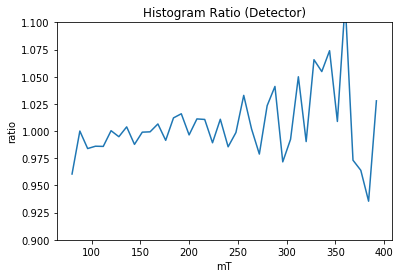

Truth Cor  0.9980922301162051
Det Cor  0.9998875177463297
theta:  180.0


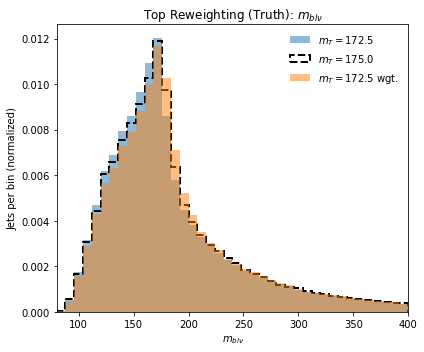

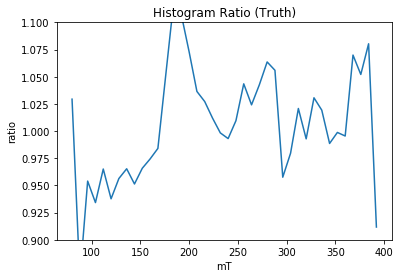

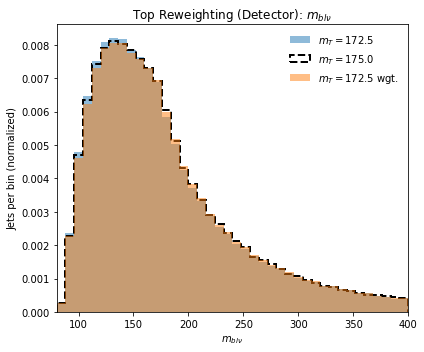

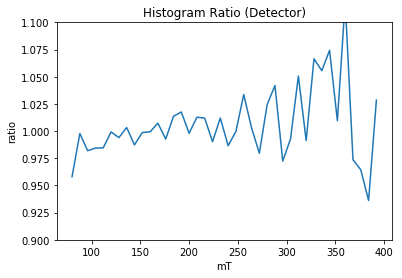

Truth Cor  0.9976561103443503
Det Cor  0.9998749809739225


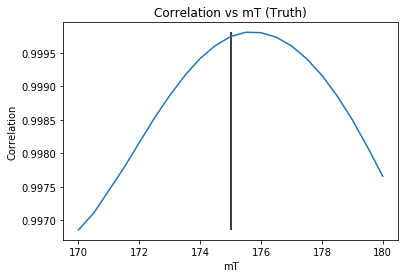

175.5


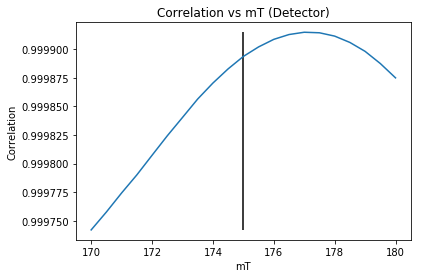

177.0
Weight Iteration:  2
theta:  170.0


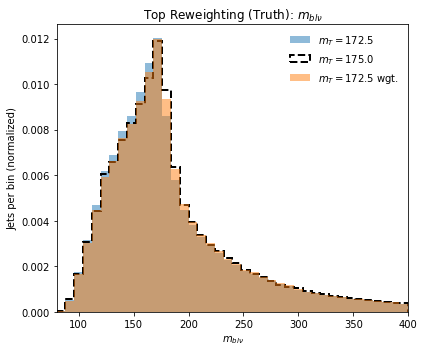

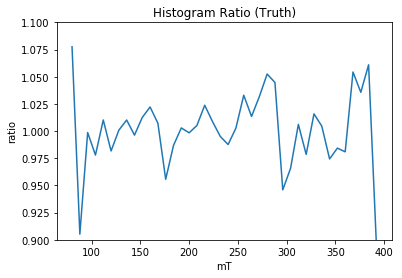

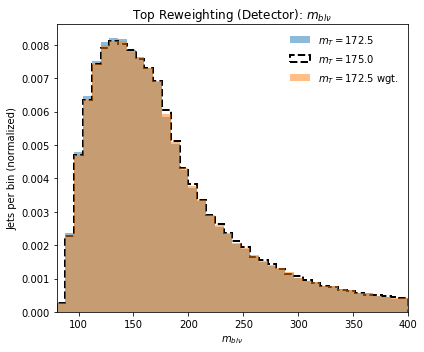

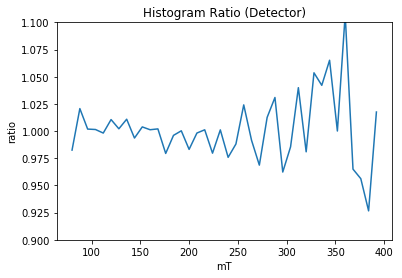

Truth Cor  0.9996049264051659
Det Cor  0.9998919402964477
theta:  170.5


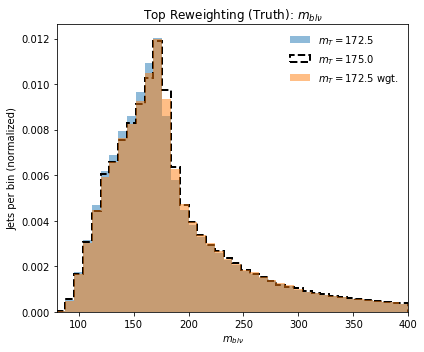

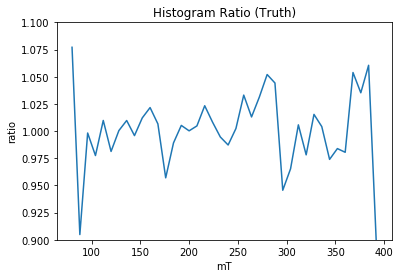

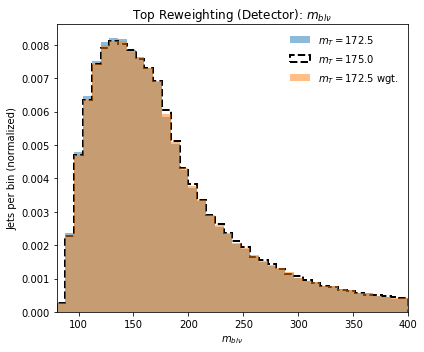

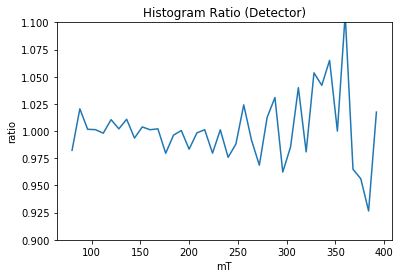

Truth Cor  0.9996263888900042
Det Cor  0.9998928675507429
theta:  171.0


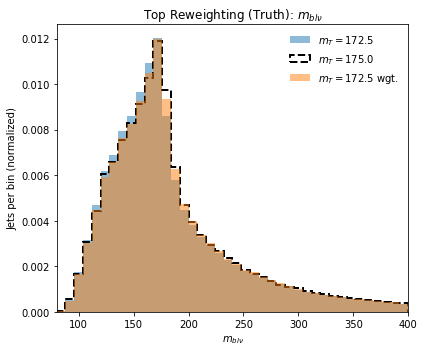

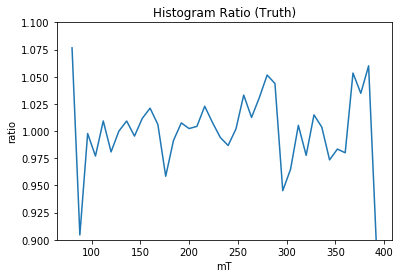

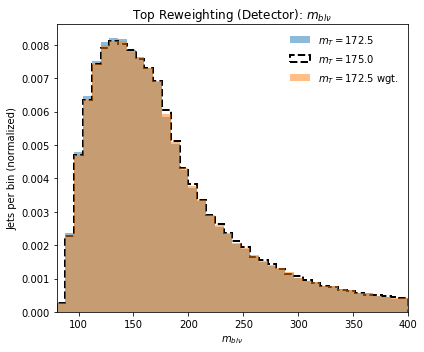

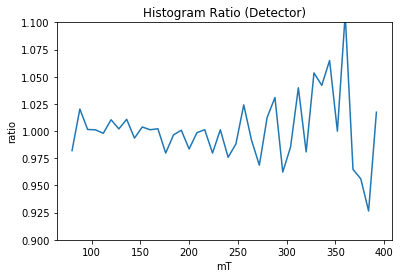

Truth Cor  0.9996474444115157
Det Cor  0.9998940018677317
theta:  171.5


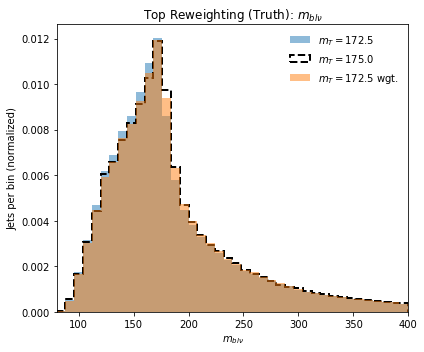

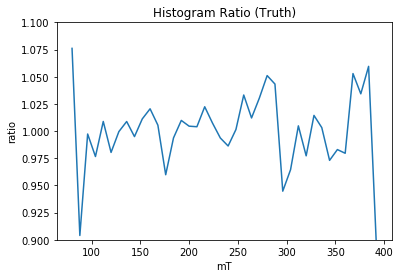

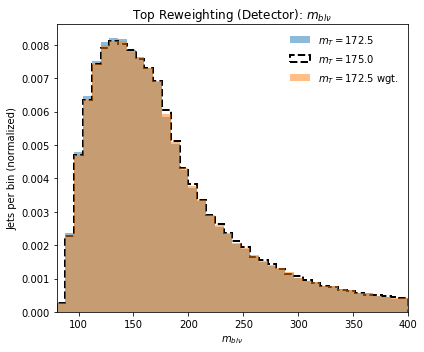

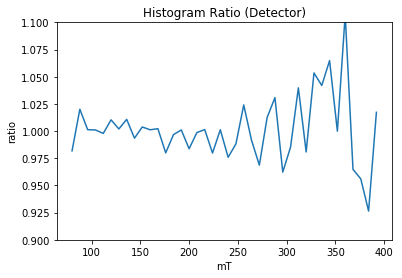

Truth Cor  0.9996660377433456
Det Cor  0.9998950026748487
theta:  172.0


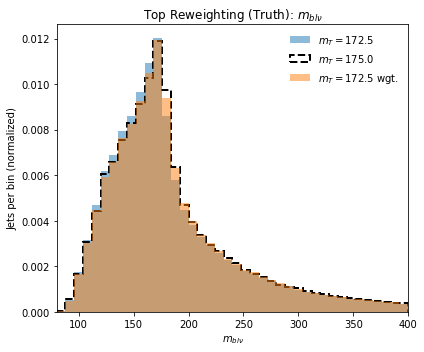

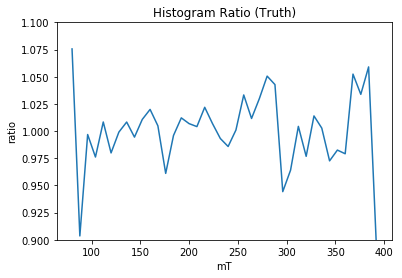

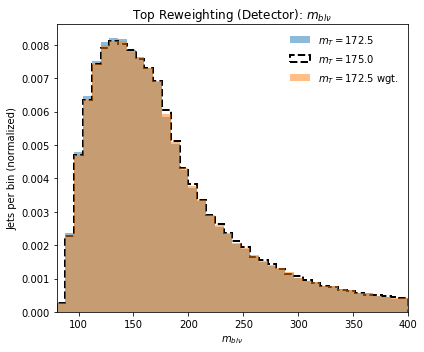

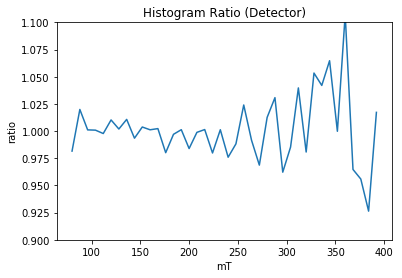

Truth Cor  0.9996812424294567
Det Cor  0.9998959601546766
theta:  172.5


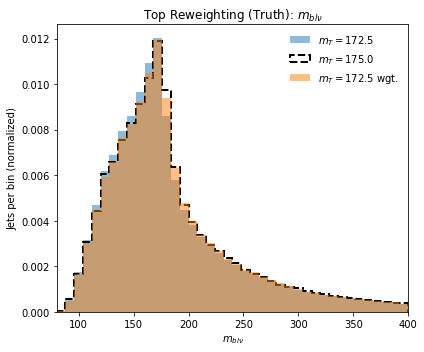

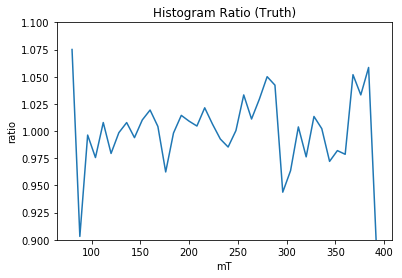

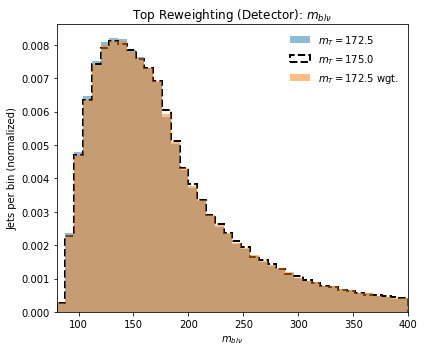

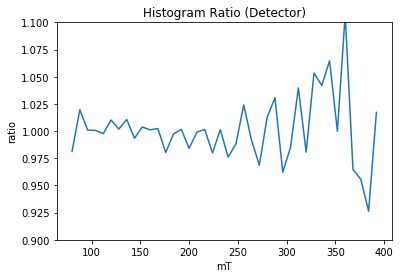

Truth Cor  0.9996954548558639
Det Cor  0.9998970044740333
theta:  173.0


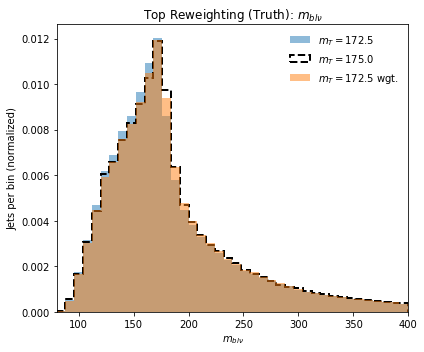

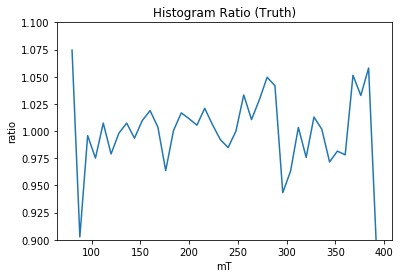

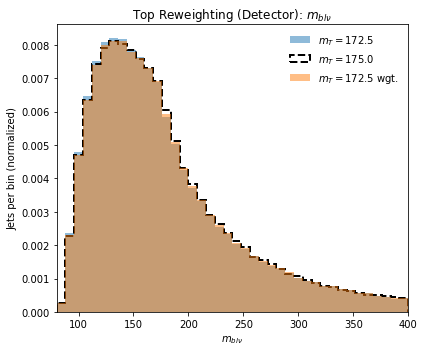

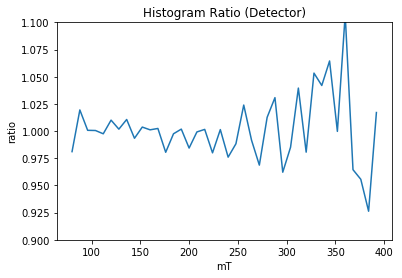

Truth Cor  0.9997072364062809
Det Cor  0.9998979883648327
theta:  173.5


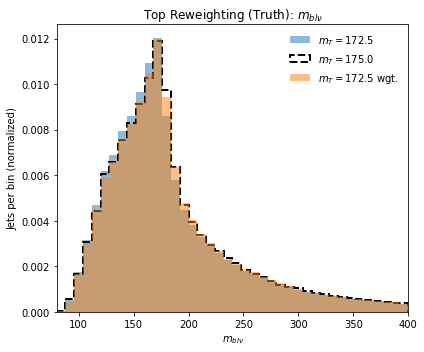

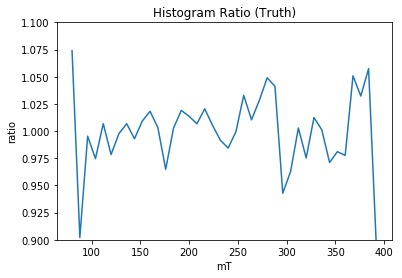

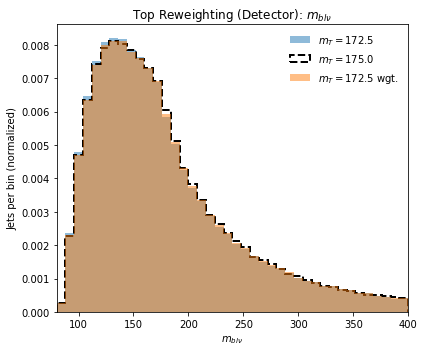

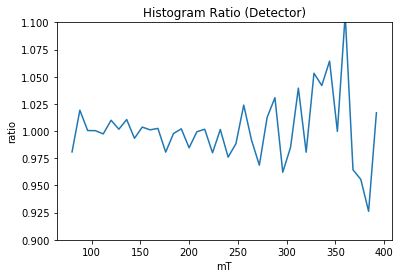

Truth Cor  0.9997167660042711
Det Cor  0.9998989341312252
theta:  174.0


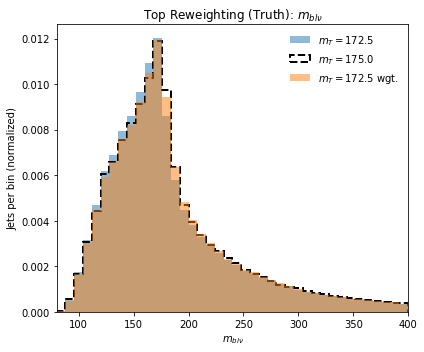

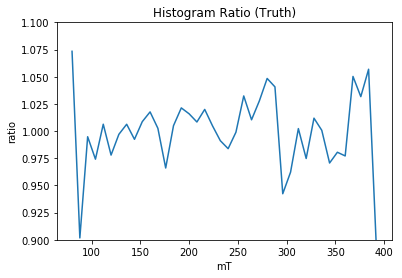

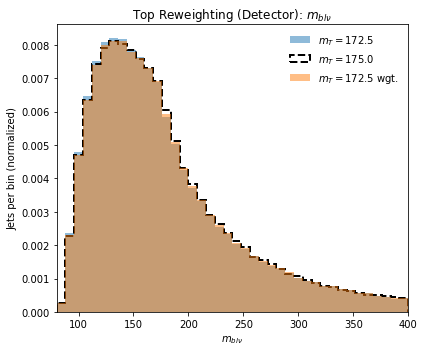

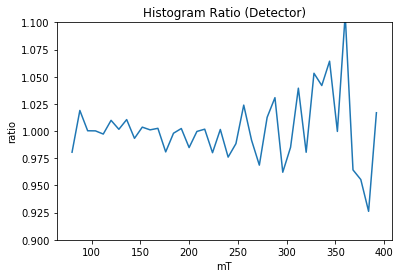

Truth Cor  0.9997244466312146
Det Cor  0.9998998717559053
theta:  174.5


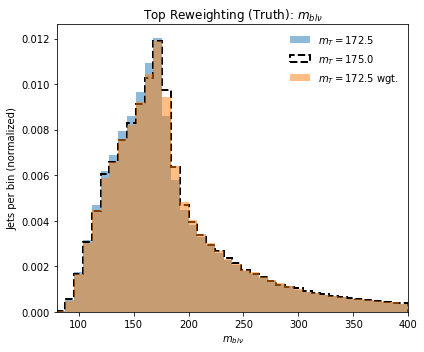

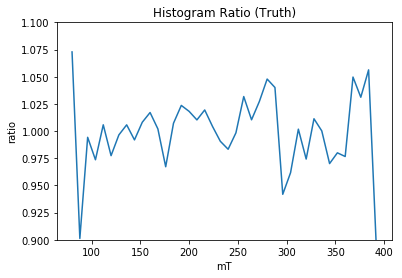

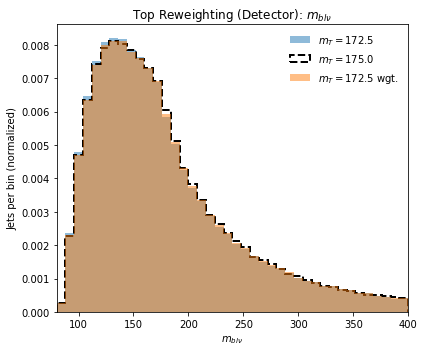

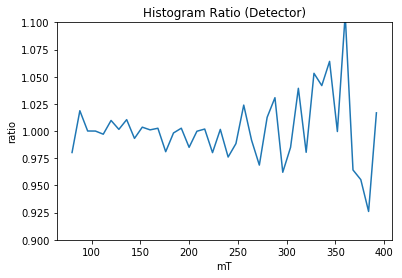

Truth Cor  0.9997298424387225
Det Cor  0.9999007994899444
theta:  175.0


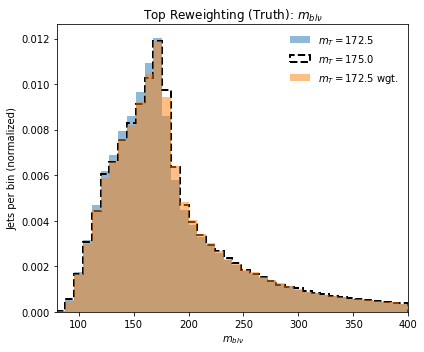

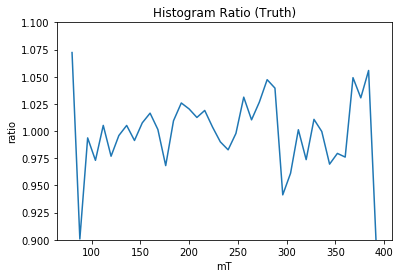

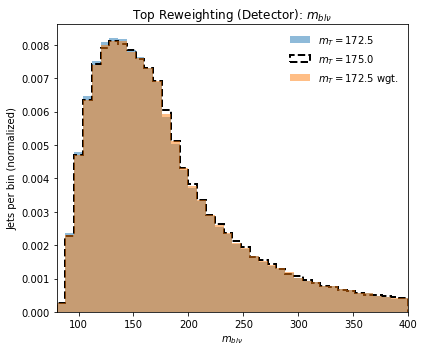

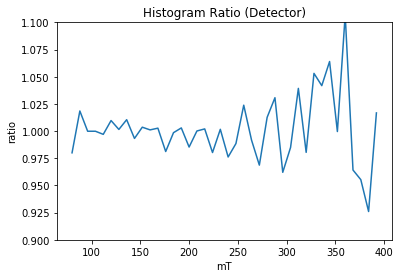

Truth Cor  0.9997326340414525
Det Cor  0.9999017103165047
theta:  175.5


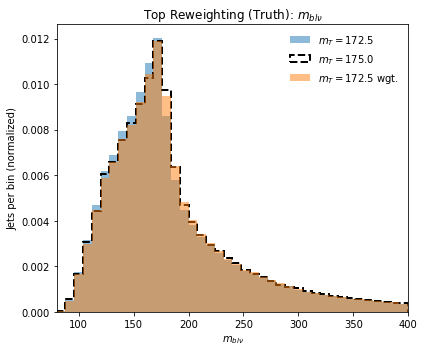

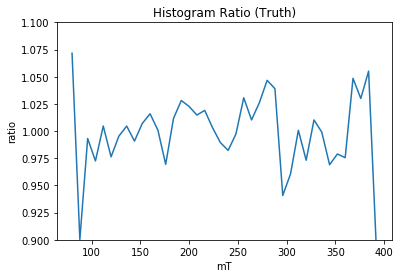

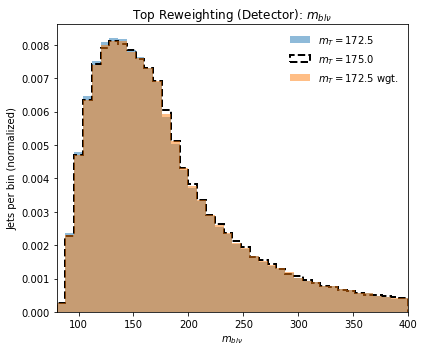

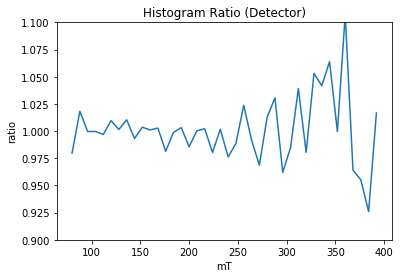

Truth Cor  0.9997341381870204
Det Cor  0.9999025811745159
theta:  176.0


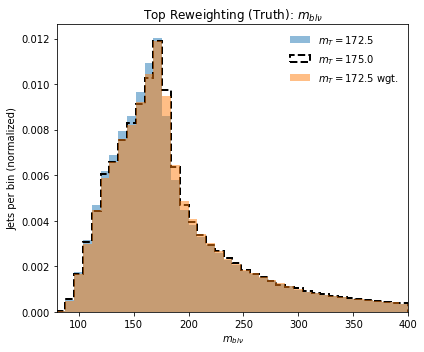

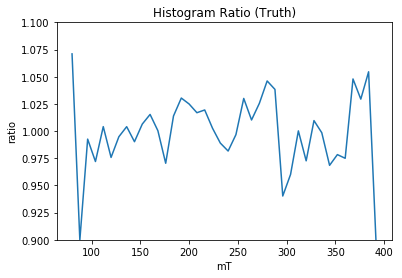

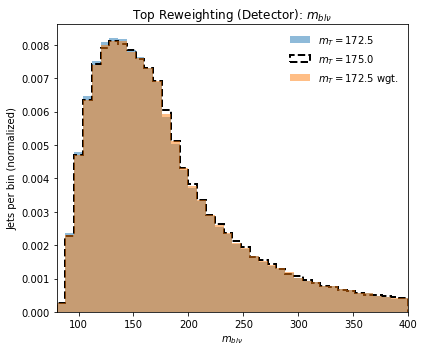

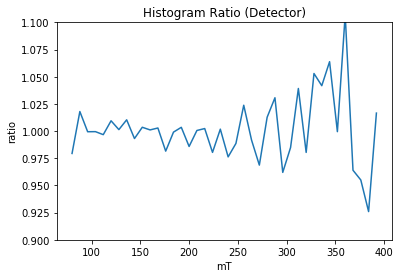

Truth Cor  0.9997326407441333
Det Cor  0.9999034436557799
theta:  176.5


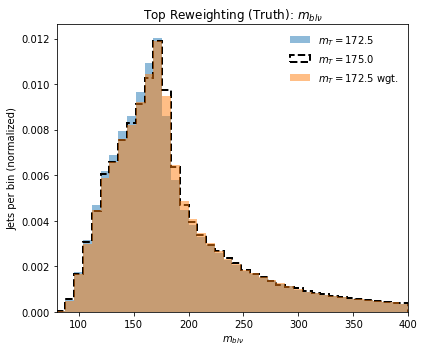

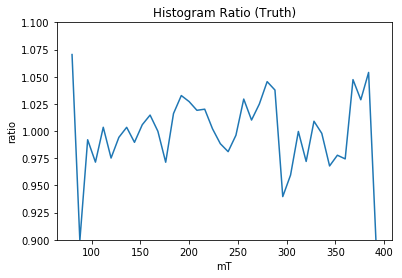

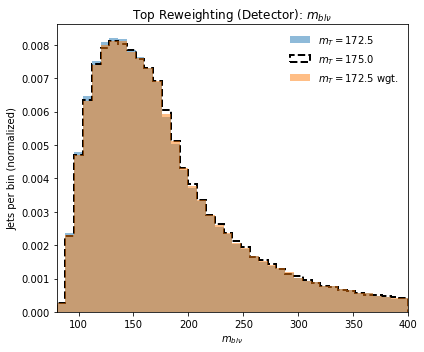

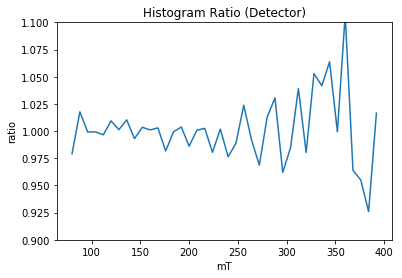

Truth Cor  0.9997286930004206
Det Cor  0.999904206314393
theta:  177.0


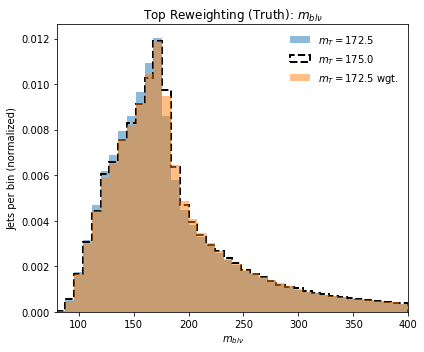

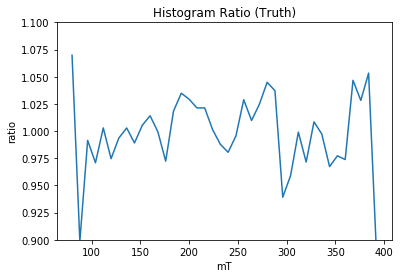

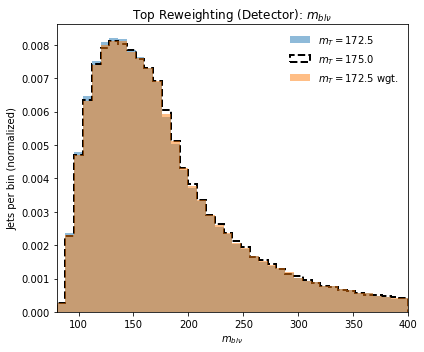

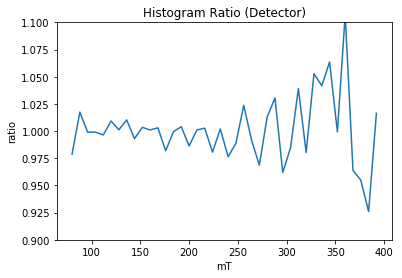

Truth Cor  0.999723120191048
Det Cor  0.9999049654006257
theta:  177.5


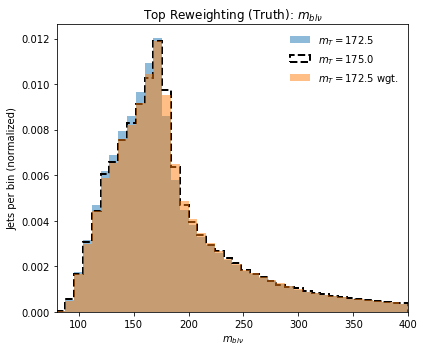

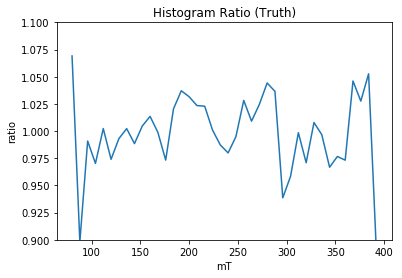

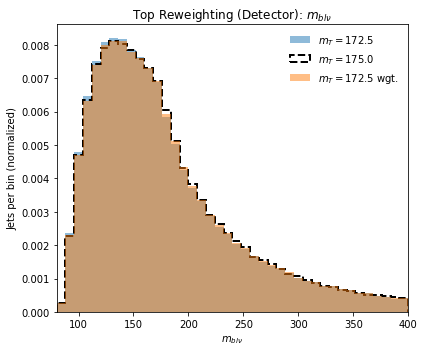

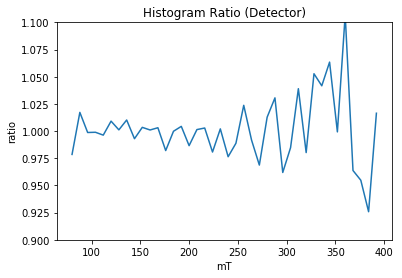

Truth Cor  0.9997157795328224
Det Cor  0.9999057237115222
theta:  178.0


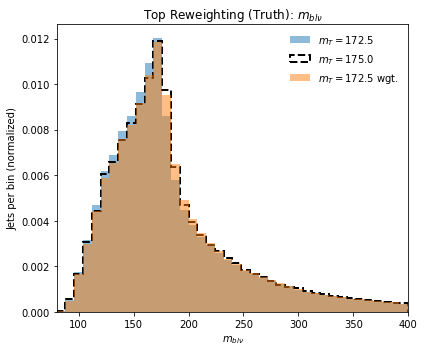

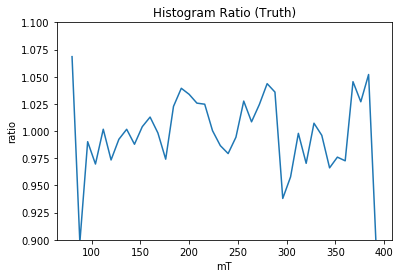

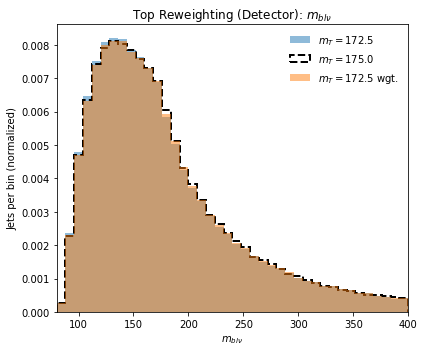

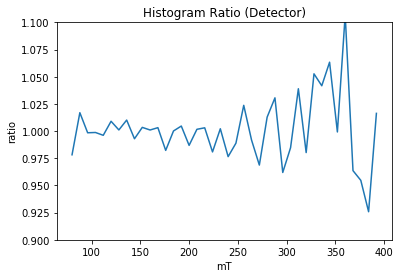

Truth Cor  0.9997052268690051
Det Cor  0.9999064086441161
theta:  178.5


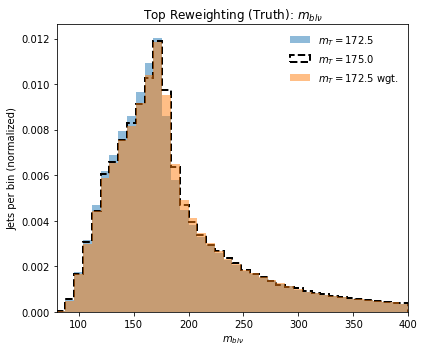

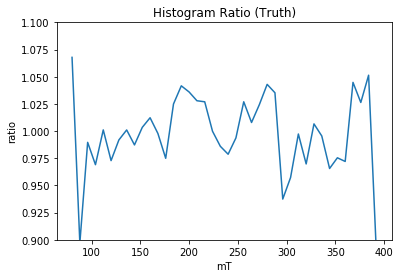

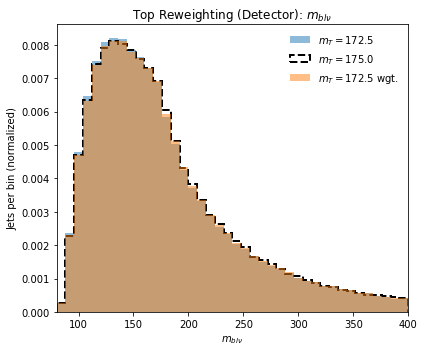

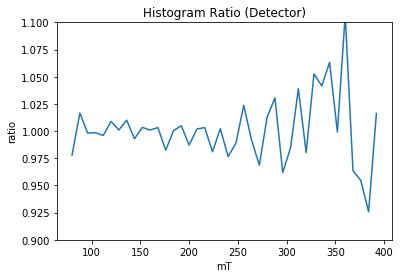

Truth Cor  0.9996926612456318
Det Cor  0.9999070216261292
theta:  179.0


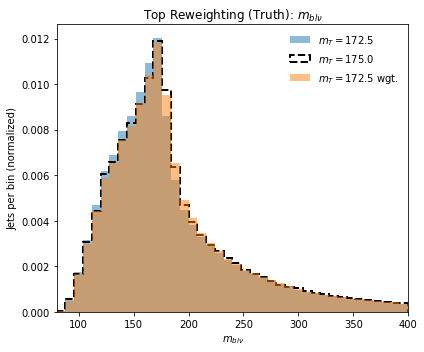

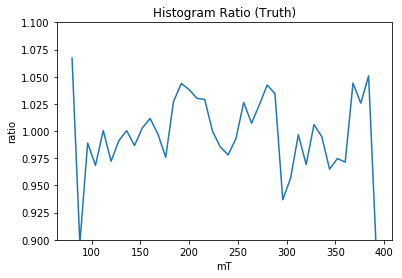

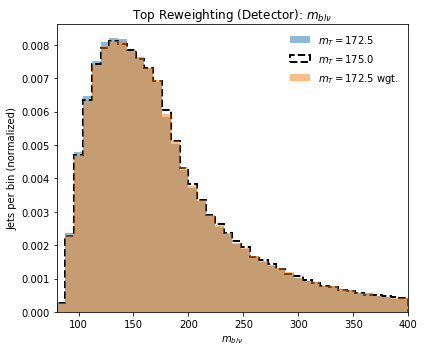

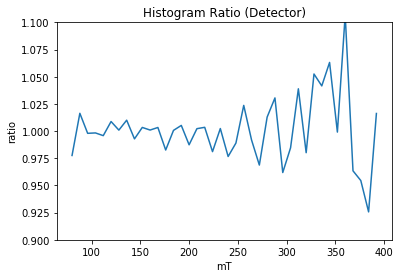

Truth Cor  0.9996788073537581
Det Cor  0.9999076334227306
theta:  179.5


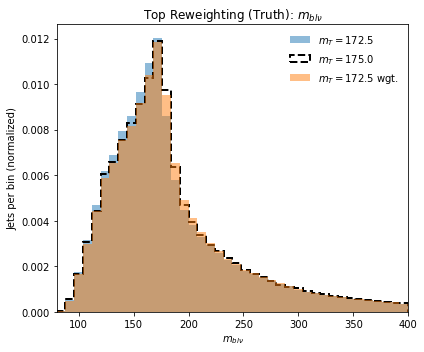

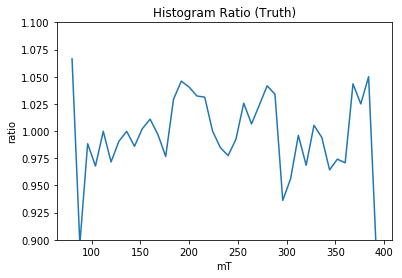

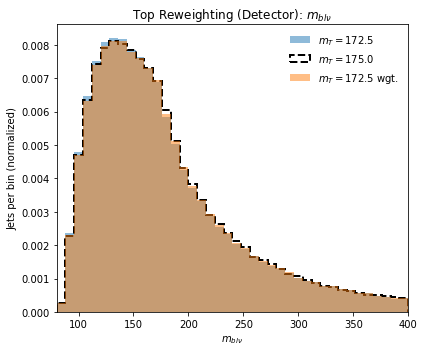

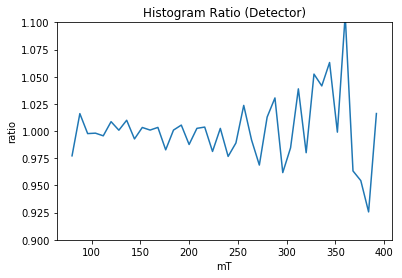

Truth Cor  0.9996628039405708
Det Cor  0.9999082196585088
theta:  180.0


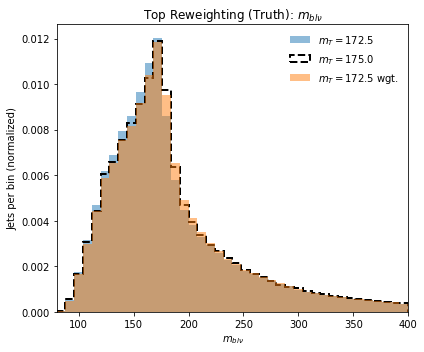

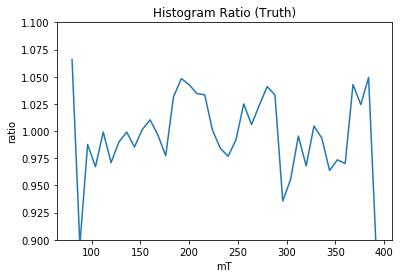

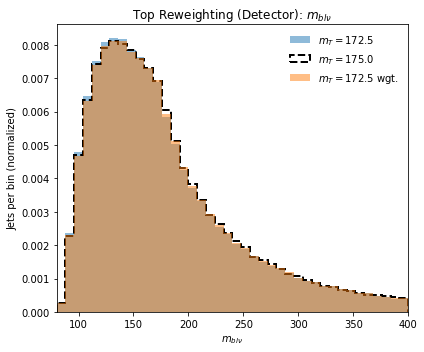

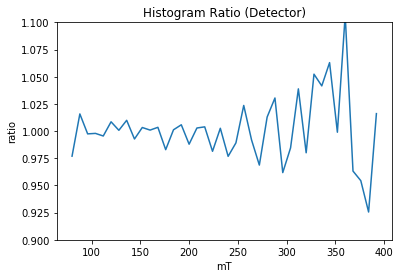

Truth Cor  0.9996440165771533
Det Cor  0.9999087220688883


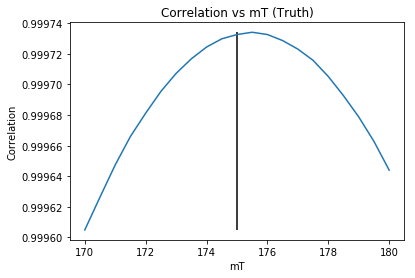

175.5


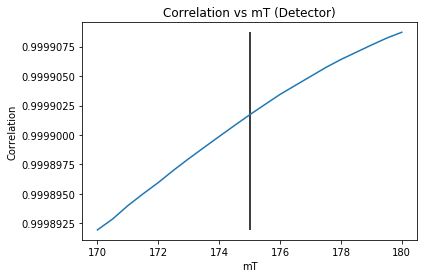

180.0
Weight Iteration:  3
theta:  170.0


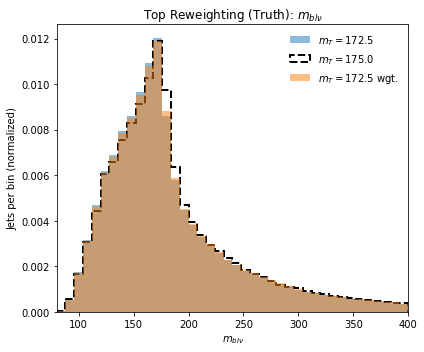

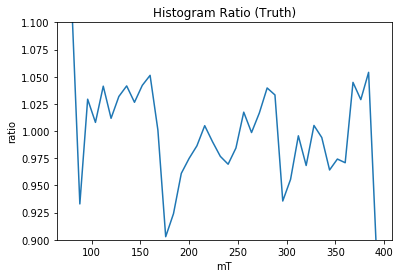

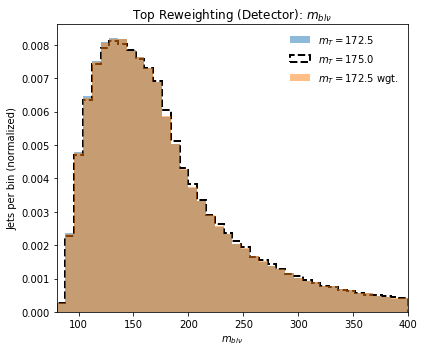

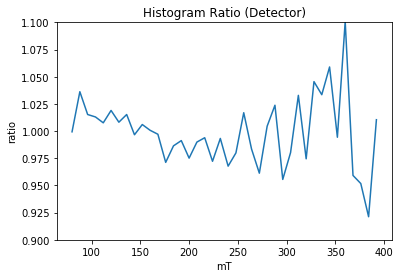

Truth Cor  0.9977593541729541
Det Cor  0.9997774561891831
theta:  170.5


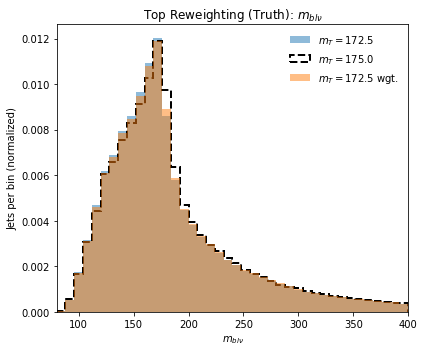

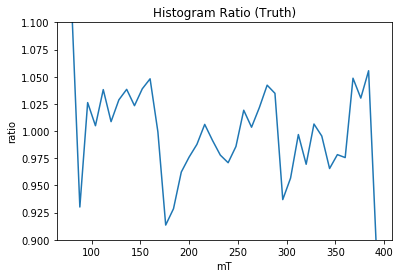

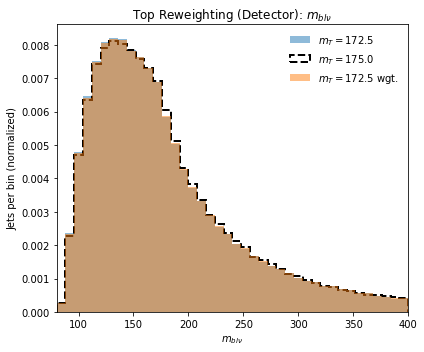

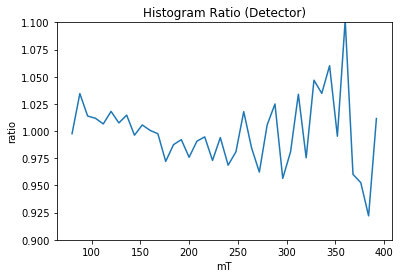

Truth Cor  0.9981335324940311
Det Cor  0.9997941807091864
theta:  171.0


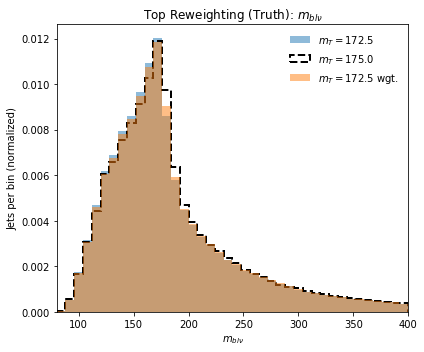

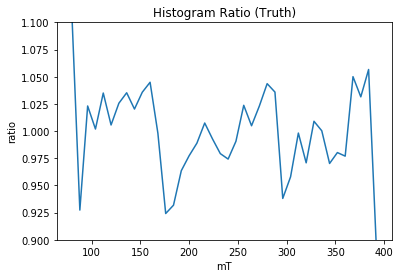

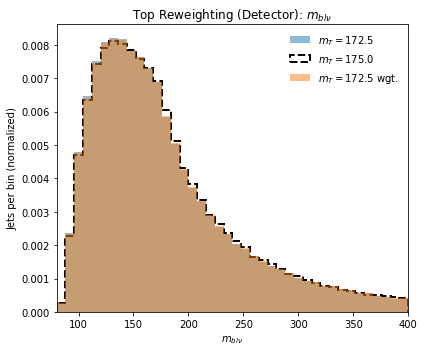

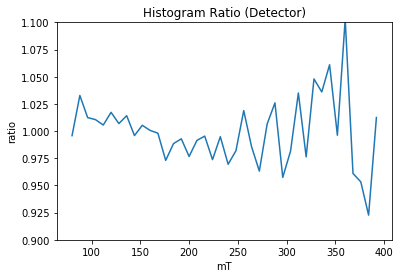

Truth Cor  0.9984603008645049
Det Cor  0.9998096412725488
theta:  171.5


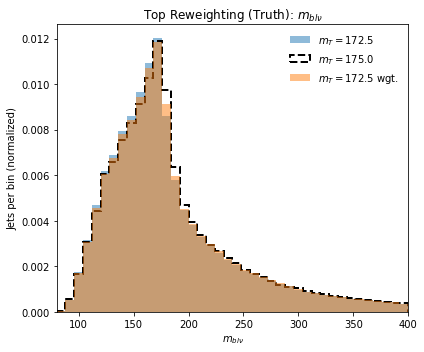

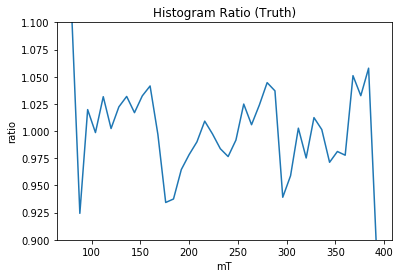

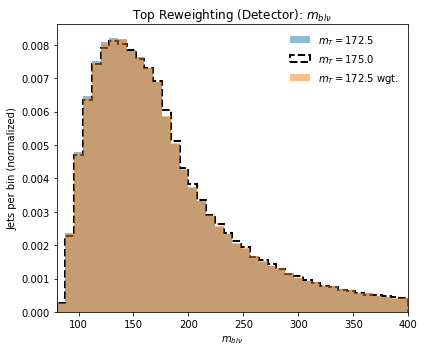

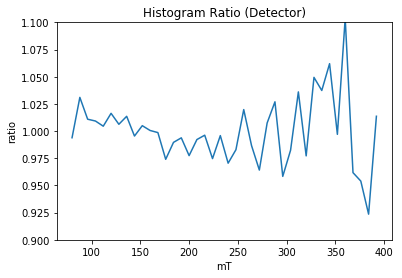

Truth Cor  0.9987651745931685
Det Cor  0.9998251343676864
theta:  172.0


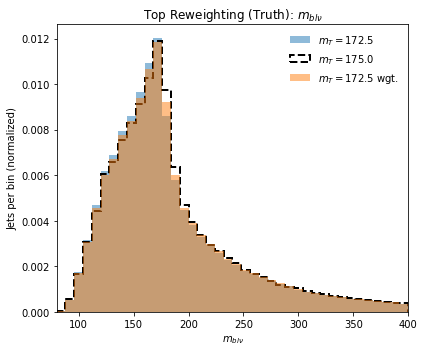

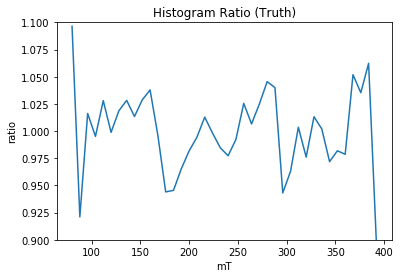

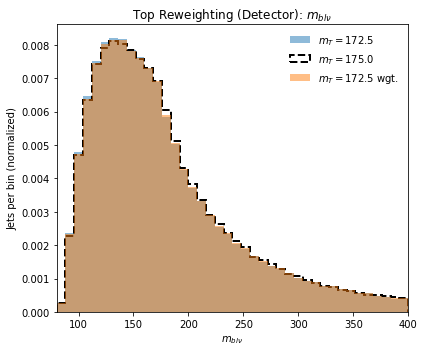

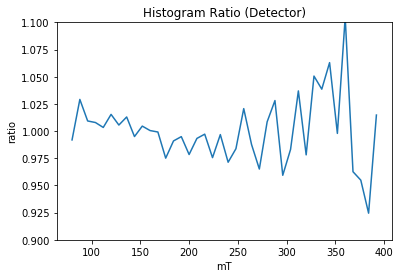

Truth Cor  0.9990452622832007
Det Cor  0.9998406340815363
theta:  172.5


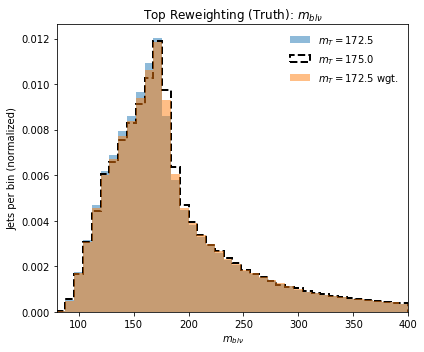

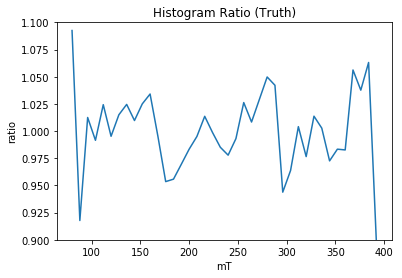

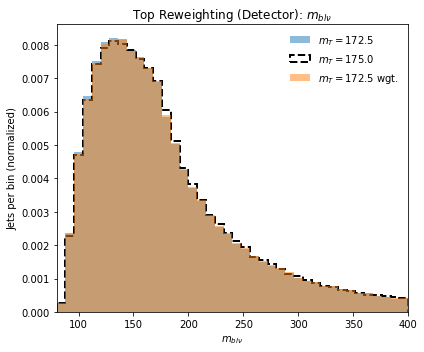

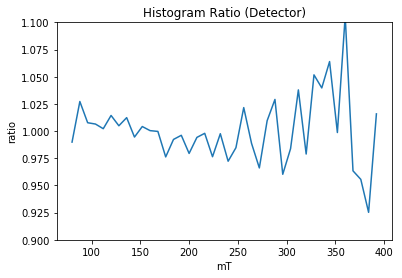

Truth Cor  0.9992973601278395
Det Cor  0.9998549650494182
theta:  173.0


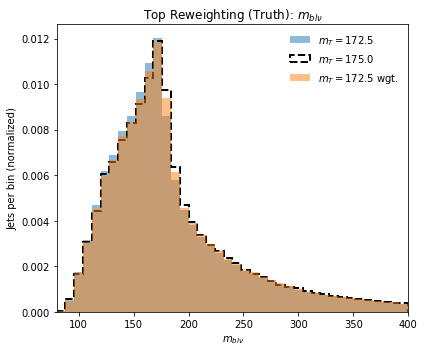

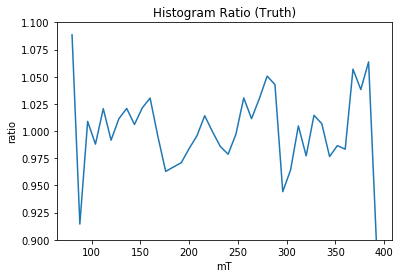

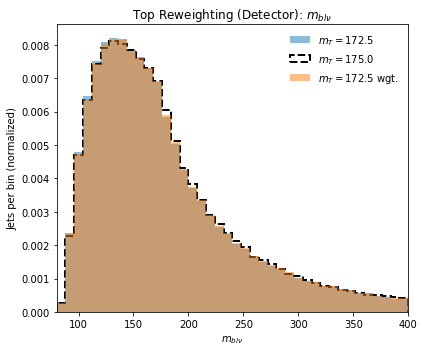

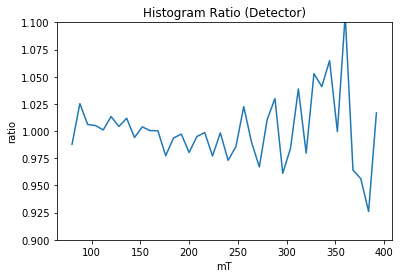

Truth Cor  0.9995022695239498
Det Cor  0.9998672988555001
theta:  173.5


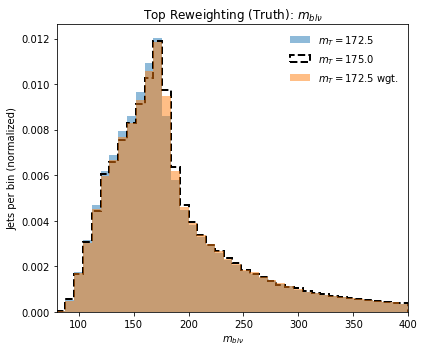

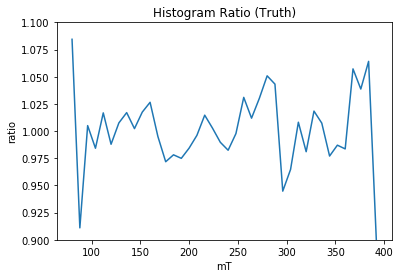

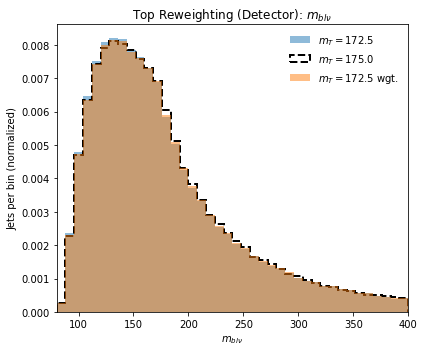

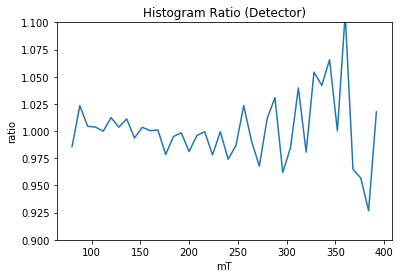

Truth Cor  0.9996656202133058
Det Cor  0.9998789127936071
theta:  174.0


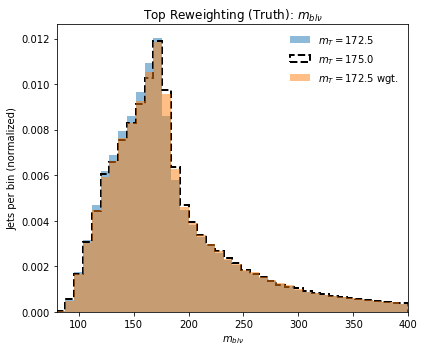

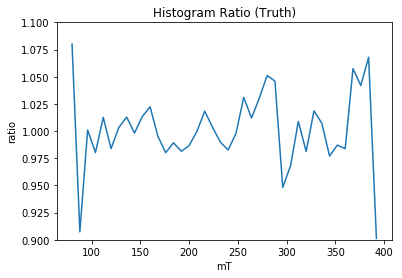

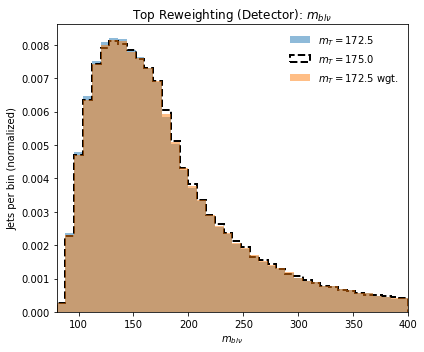

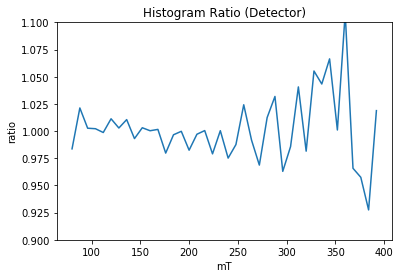

Truth Cor  0.9997838015217402
Det Cor  0.9998895655885863
theta:  174.5


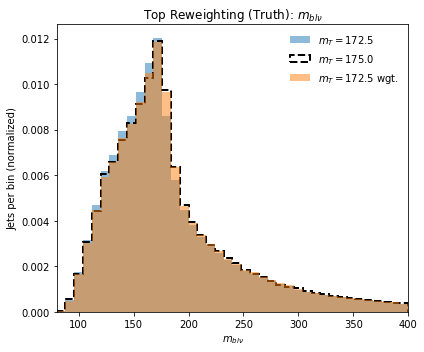

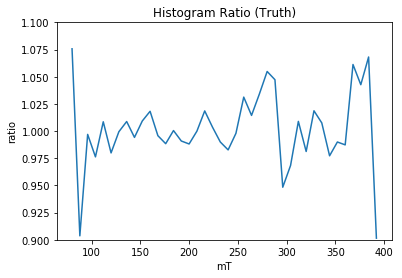

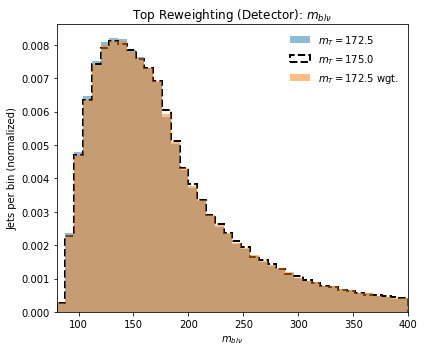

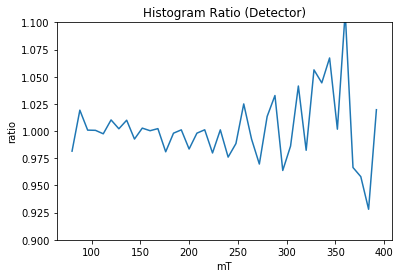

Truth Cor  0.999855166258094
Det Cor  0.9998979717055873
theta:  175.0


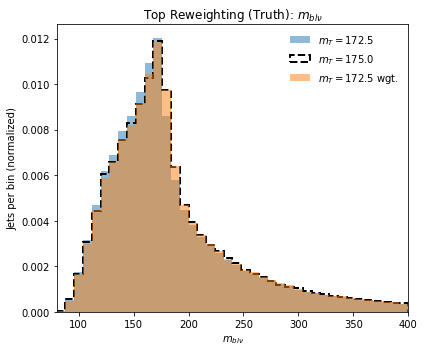

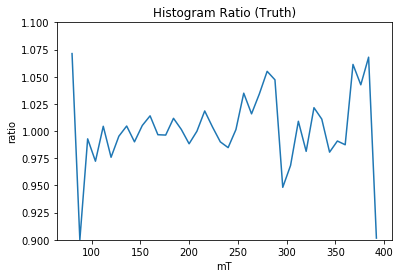

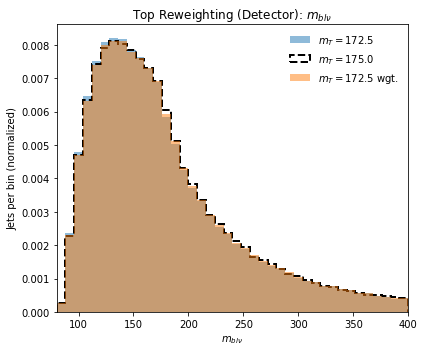

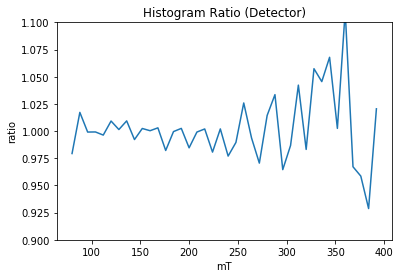

Truth Cor  0.9998765809270537
Det Cor  0.9999046713617069
theta:  175.5


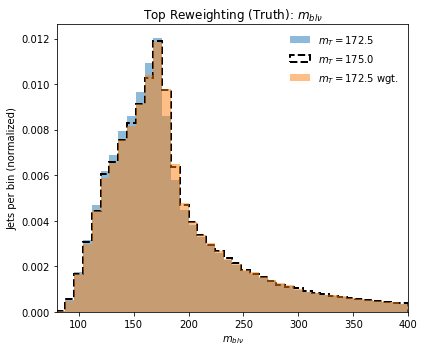

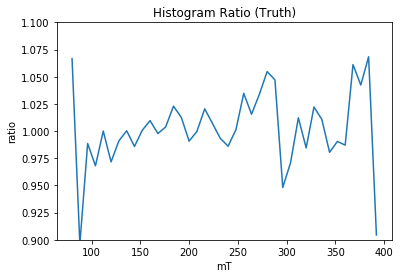

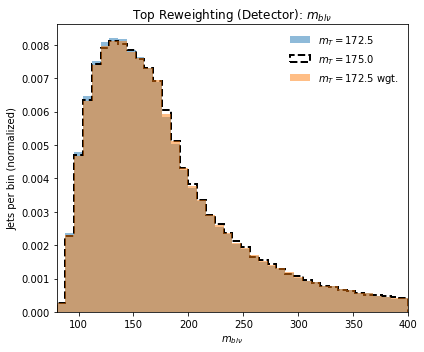

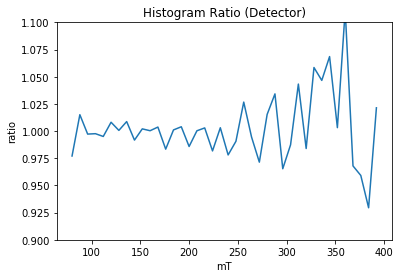

Truth Cor  0.9998477836168663
Det Cor  0.9999098934283126
theta:  176.0


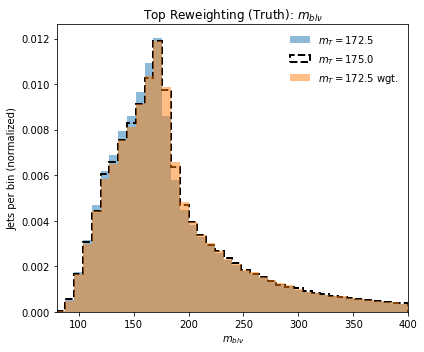

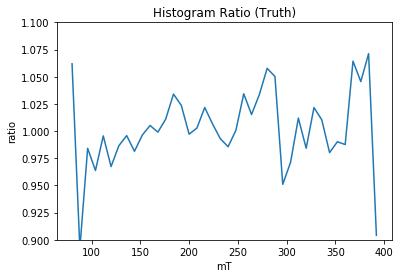

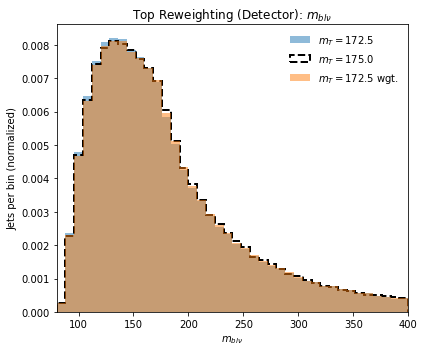

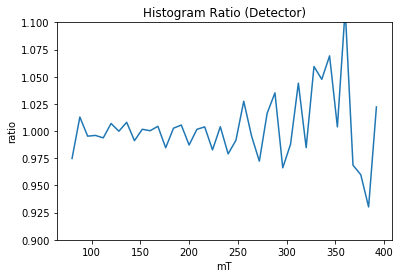

Truth Cor  0.9997663716702659
Det Cor  0.9999131297630535
theta:  176.5


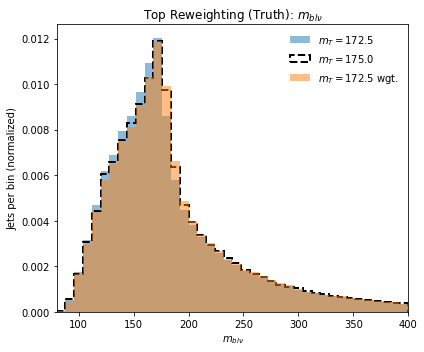

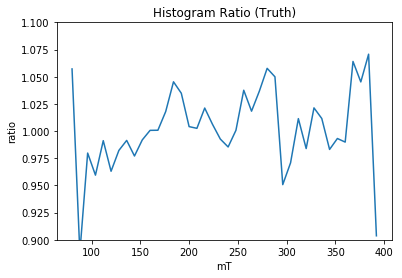

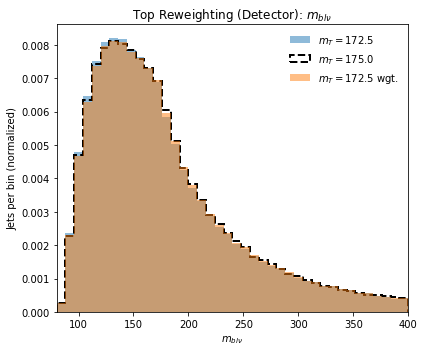

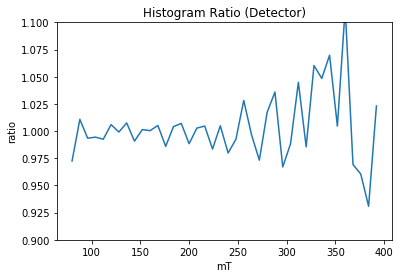

Truth Cor  0.9996316353657587
Det Cor  0.9999139918050997
theta:  177.0


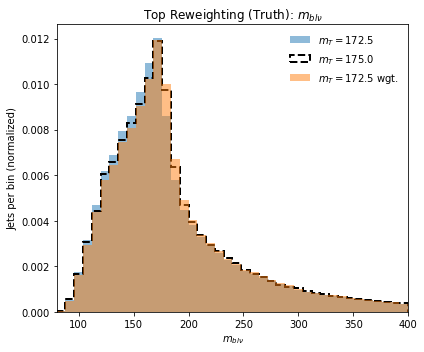

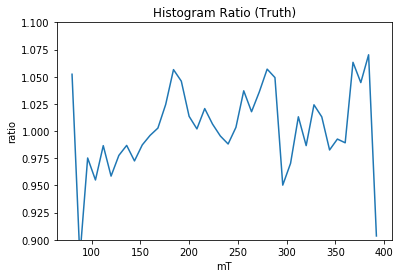

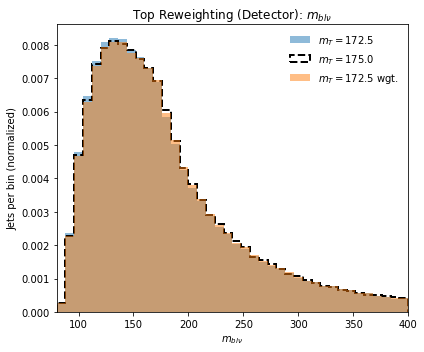

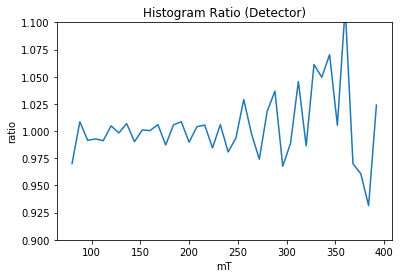

Truth Cor  0.9994438991193586
Det Cor  0.9999127562048833
theta:  177.5


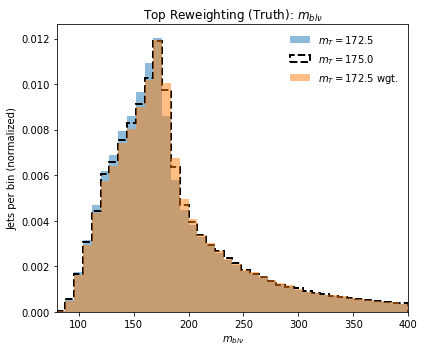

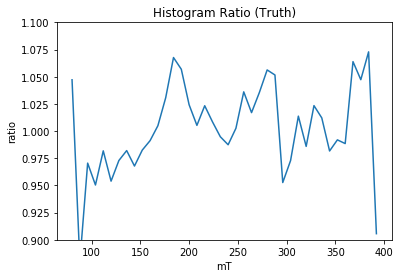

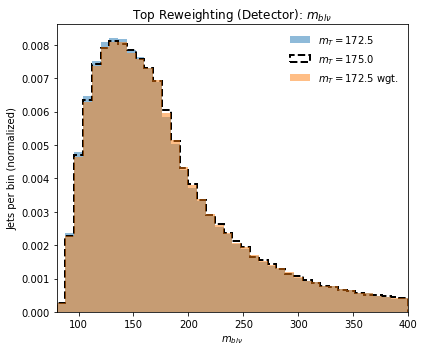

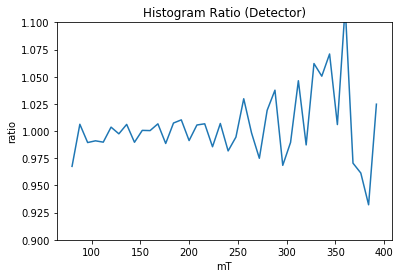

Truth Cor  0.999196042476106
Det Cor  0.9999092162215849
theta:  178.0


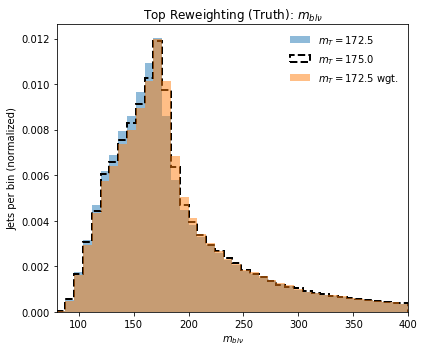

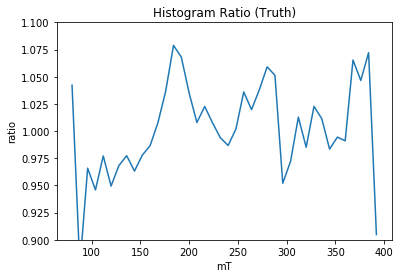

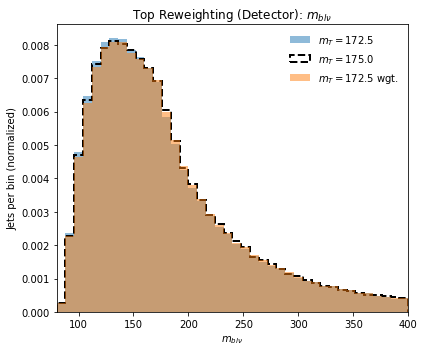

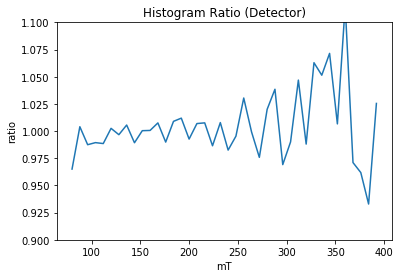

Truth Cor  0.9988907675695535
Det Cor  0.9999031659895155
theta:  178.5


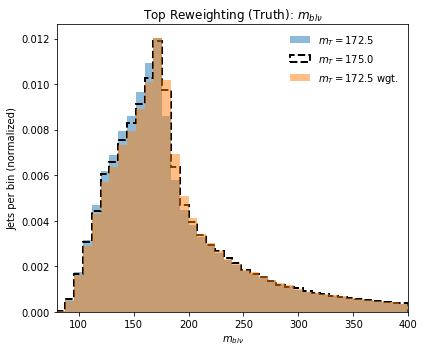

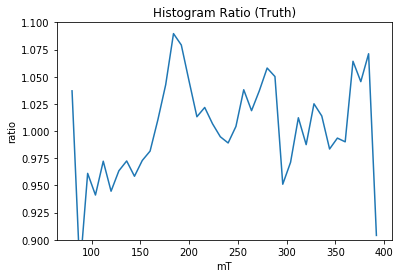

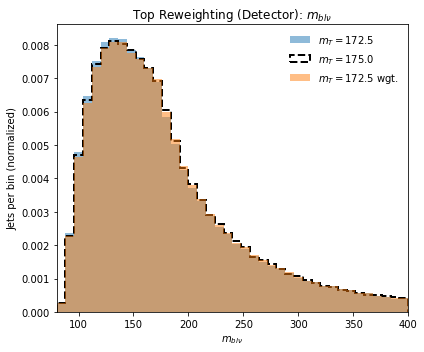

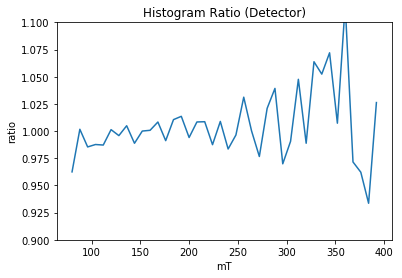

Truth Cor  0.998527845518087
Det Cor  0.999894524517013
theta:  179.0


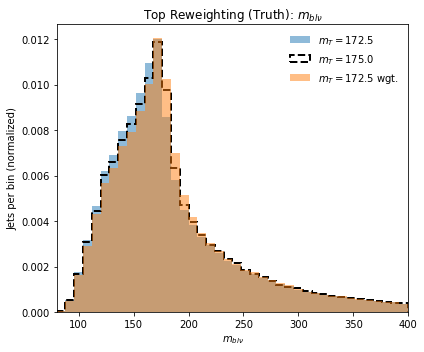

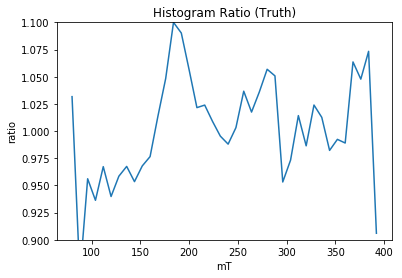

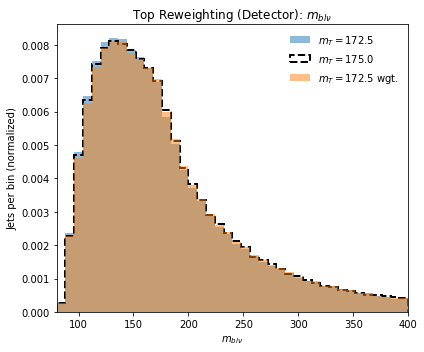

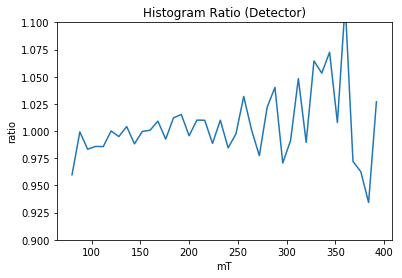

Truth Cor  0.9981034707813229
Det Cor  0.9998831871681231
theta:  179.5


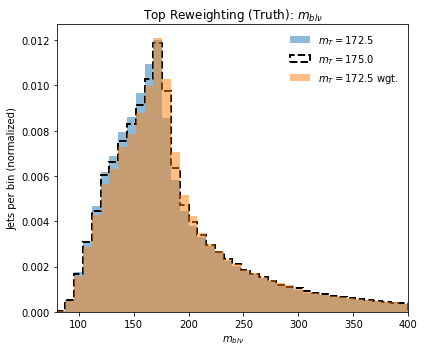

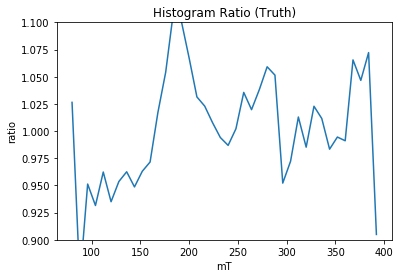

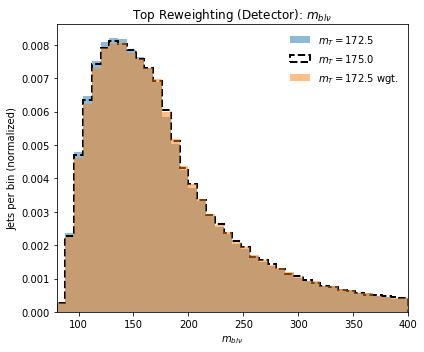

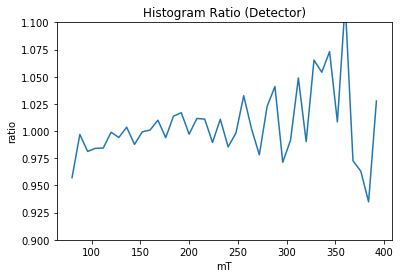

Truth Cor  0.997618169390169
Det Cor  0.9998692800213486
theta:  180.0


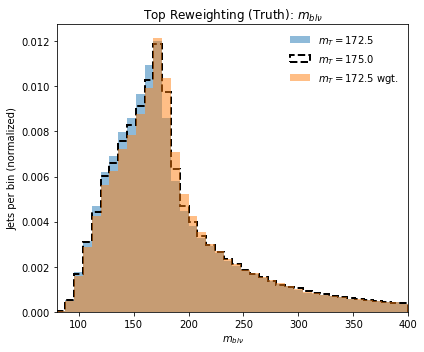

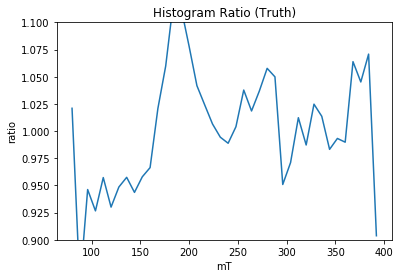

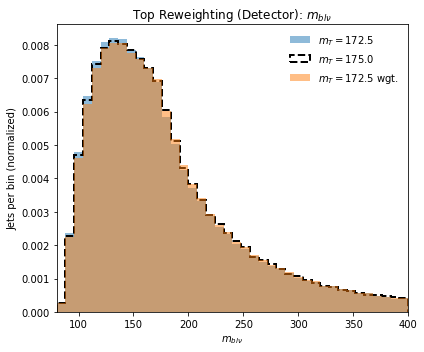

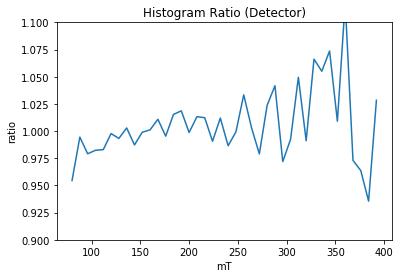

Truth Cor  0.9970697690798549
Det Cor  0.9998521417848536


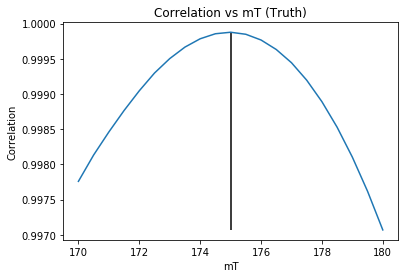

175.0


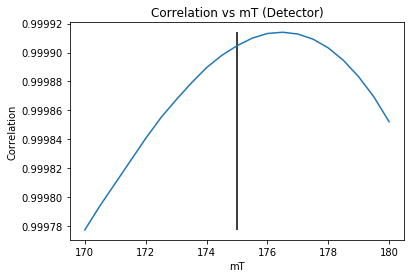

176.5
Weight Iteration:  4
theta:  170.0


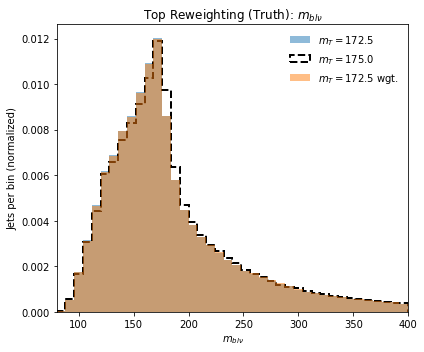

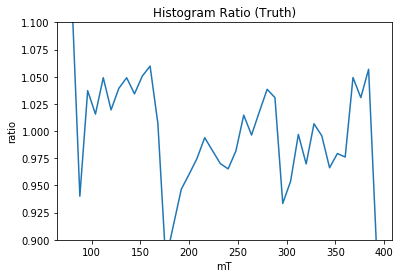

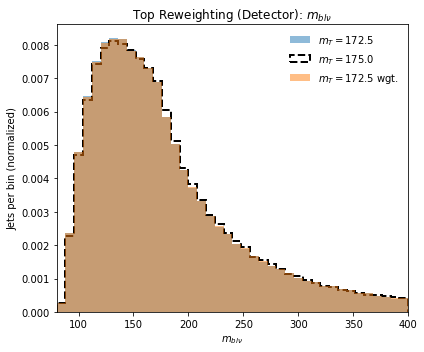

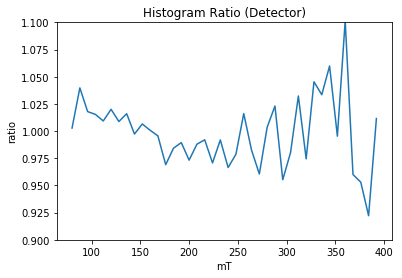

Truth Cor  0.9967369243582084
Det Cor  0.9997416546643434
theta:  170.5


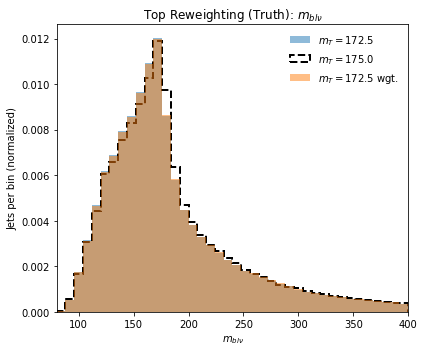

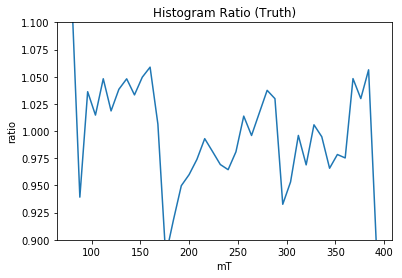

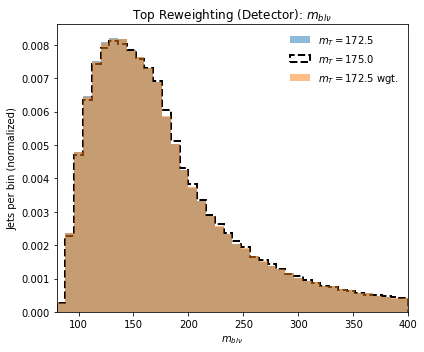

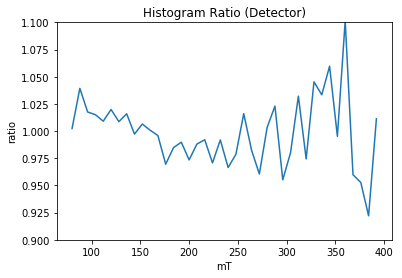

Truth Cor  0.9969477319758626
Det Cor  0.999747635944136
theta:  171.0


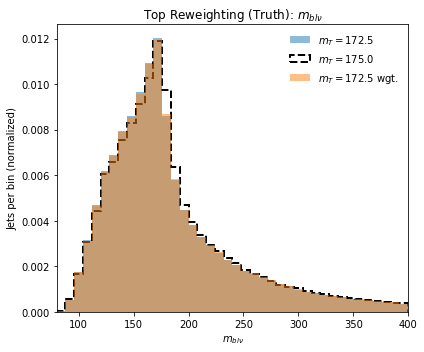

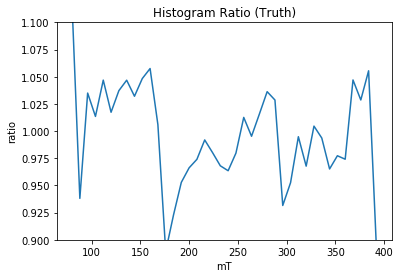

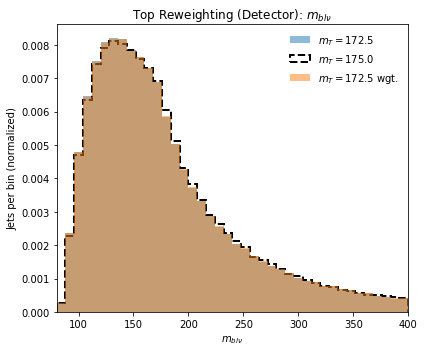

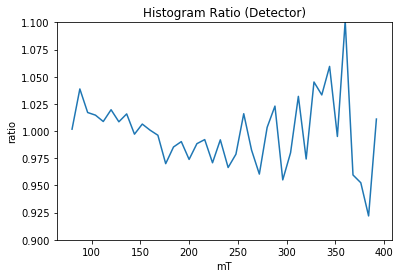

Truth Cor  0.9971647232576708
Det Cor  0.9997549914784466
theta:  171.5


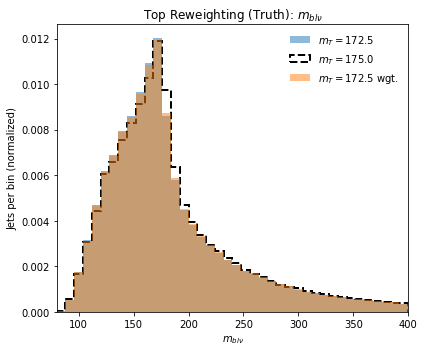

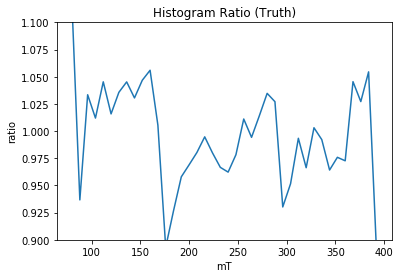

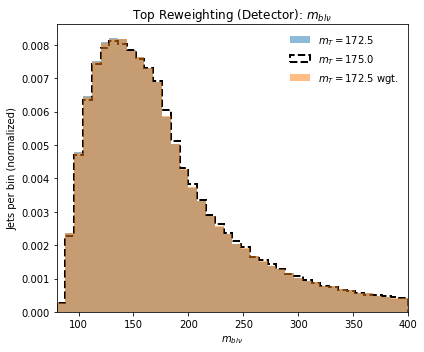

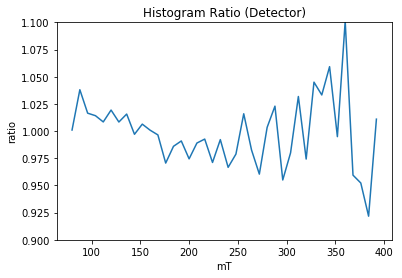

Truth Cor  0.997372612536711
Det Cor  0.9997639871022834
theta:  172.0


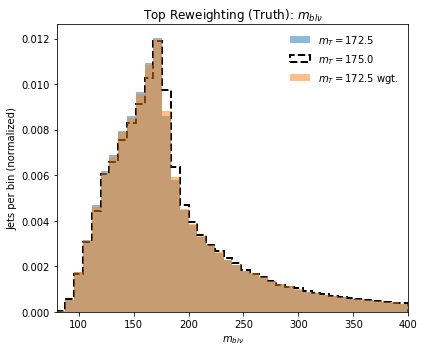

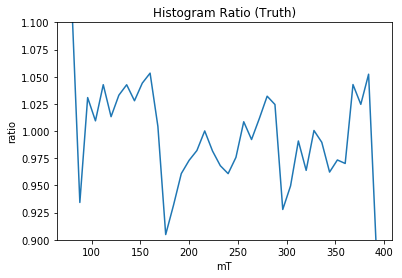

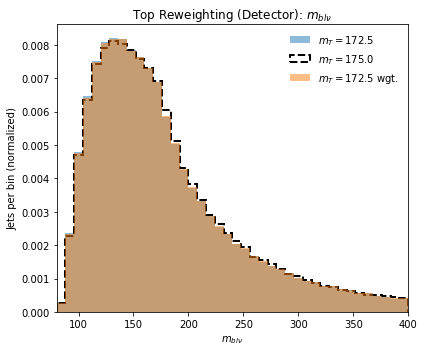

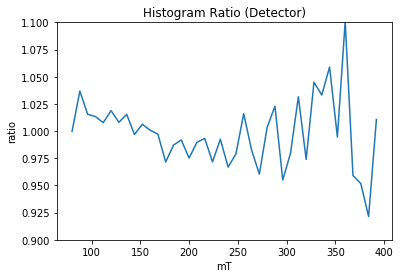

Truth Cor  0.9978076458103456
Det Cor  0.9997788954729562
theta:  172.5


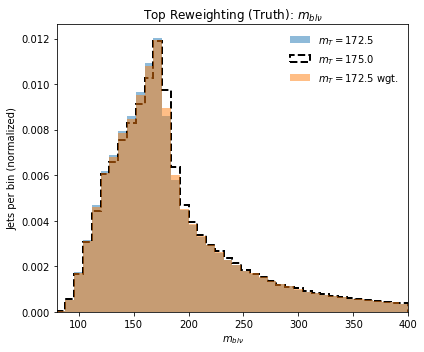

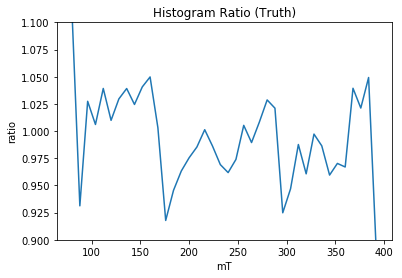

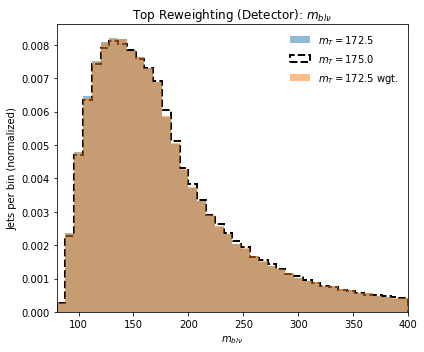

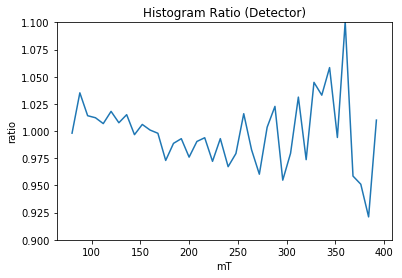

Truth Cor  0.9983017799376027
Det Cor  0.9997970461962341
theta:  173.0


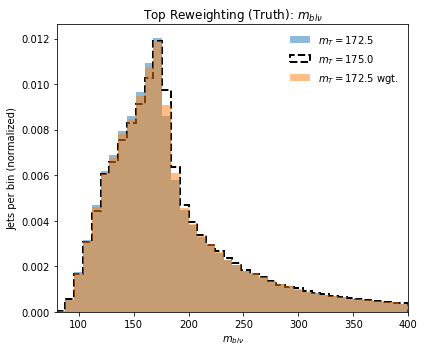

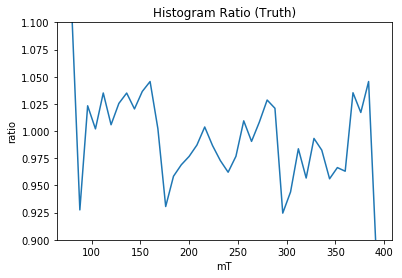

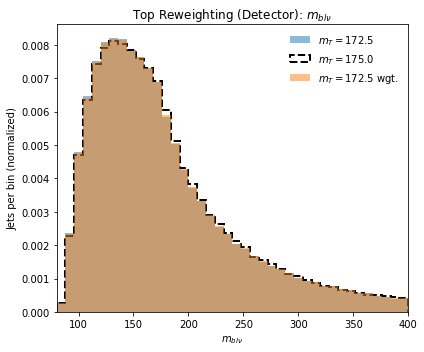

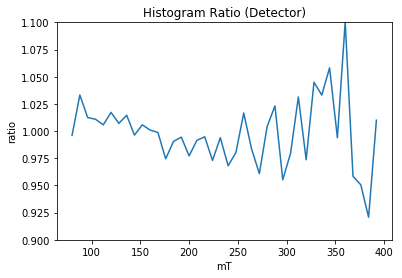

Truth Cor  0.9987418504181675
Det Cor  0.9998175733140791
theta:  173.5


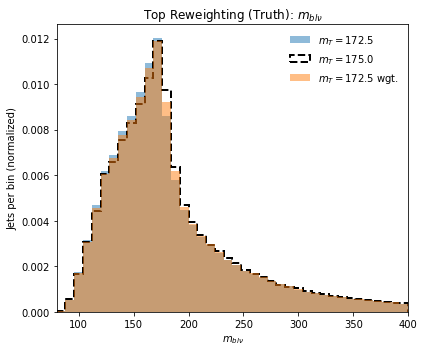

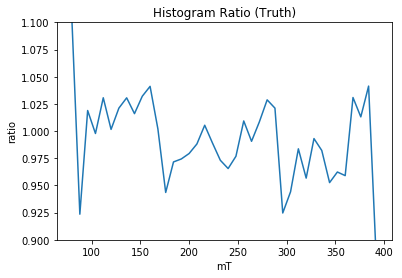

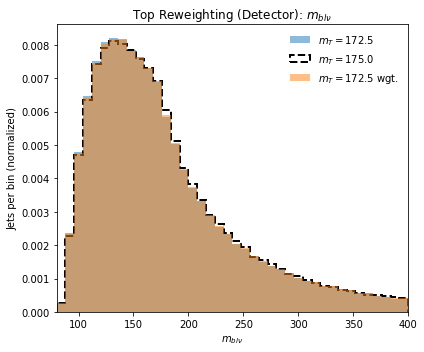

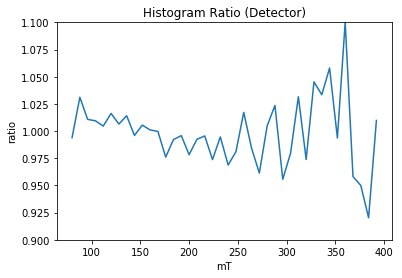

Truth Cor  0.9991179779967556
Det Cor  0.9998362919392834
theta:  174.0


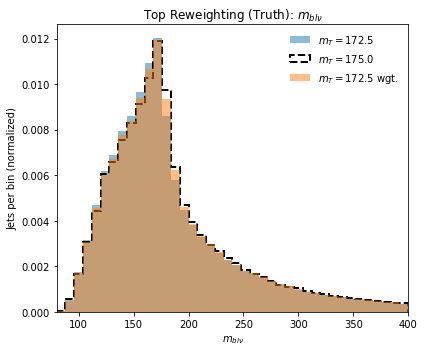

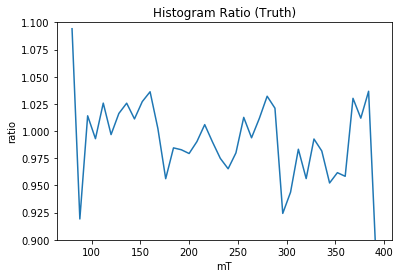

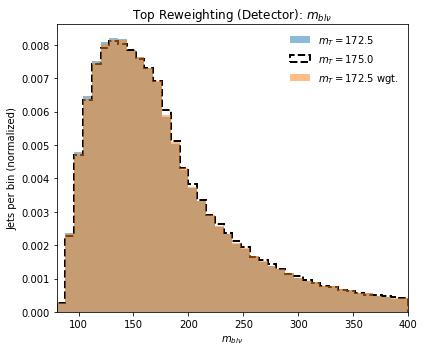

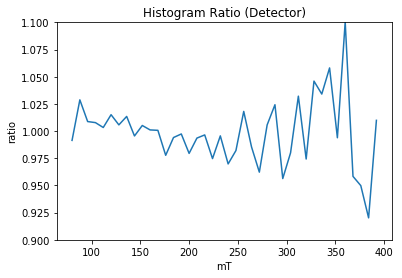

Truth Cor  0.9994230910927379
Det Cor  0.9998551089818954
theta:  174.5


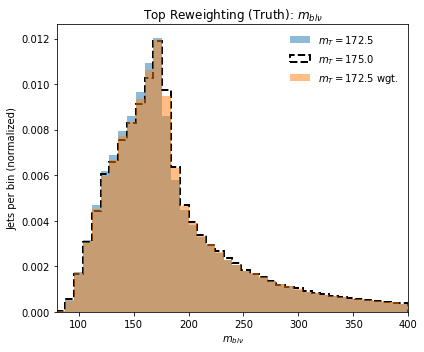

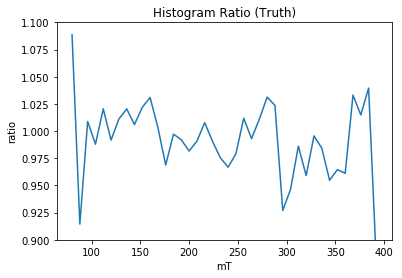

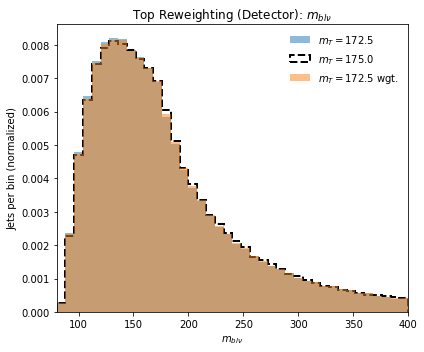

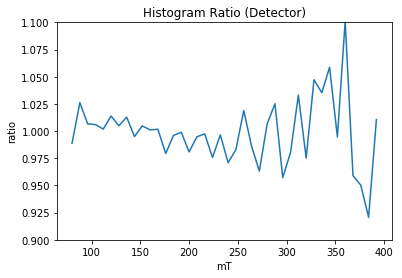

Truth Cor  0.9996536460716506
Det Cor  0.9998718970935292
theta:  175.0


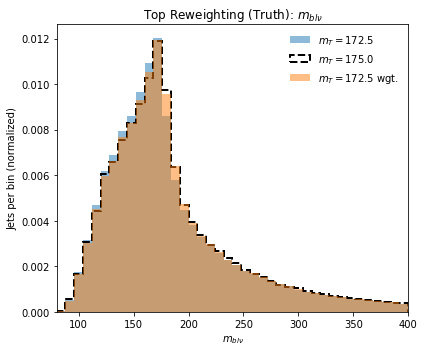

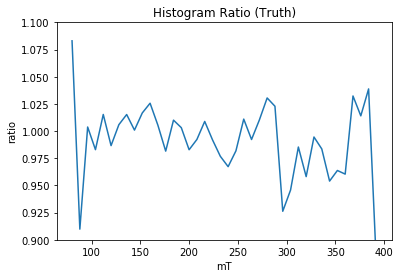

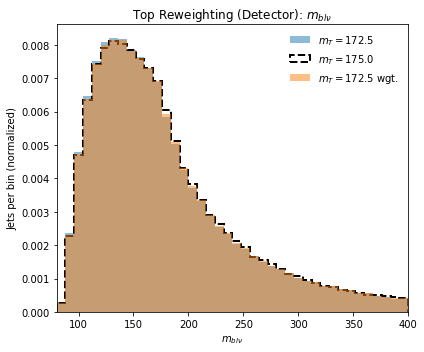

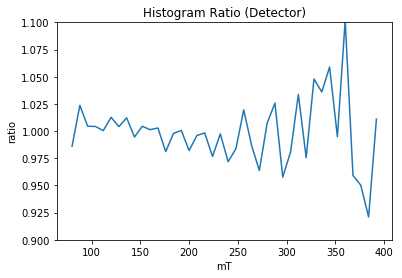

Truth Cor  0.9998008633007814
Det Cor  0.9998858776376499
theta:  175.5


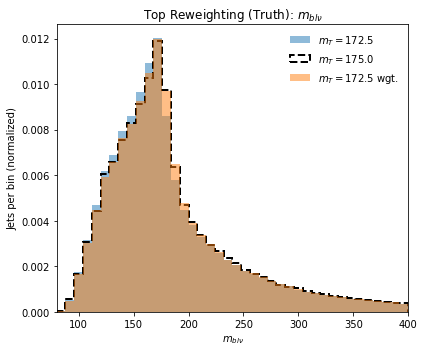

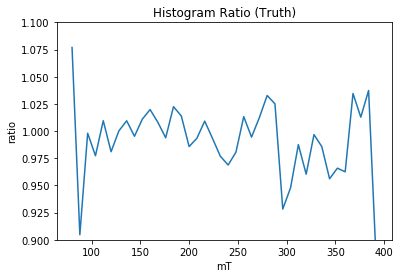

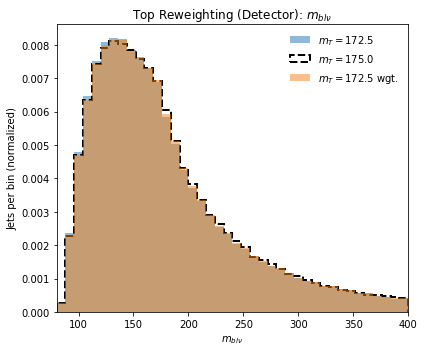

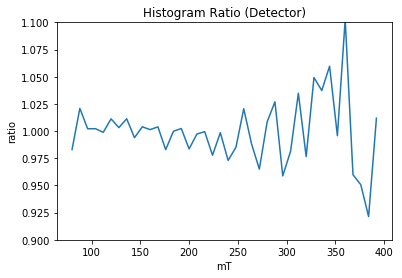

Truth Cor  0.9998584061317526
Det Cor  0.9998983764795164
theta:  176.0


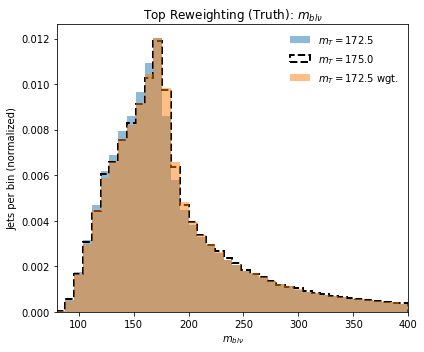

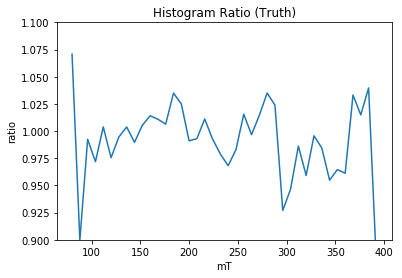

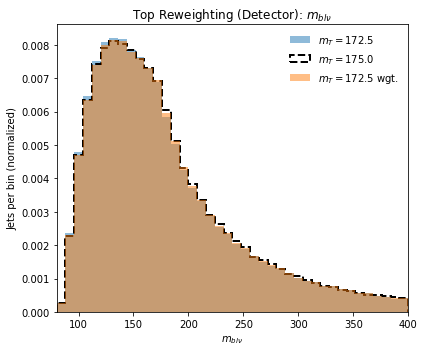

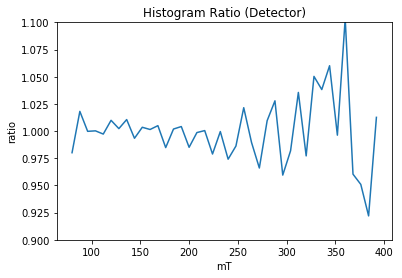

Truth Cor  0.999823375882495
Det Cor  0.9999073295504294
theta:  176.5


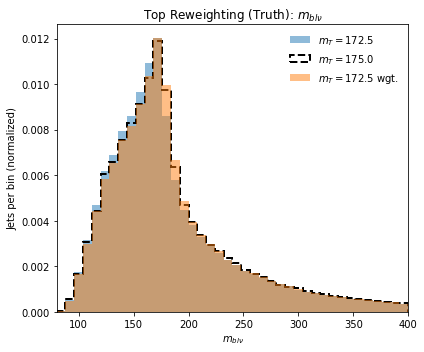

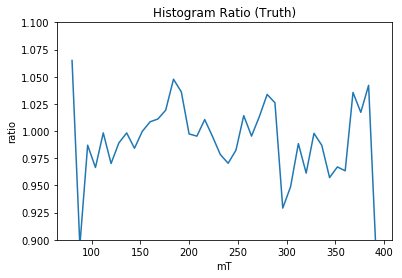

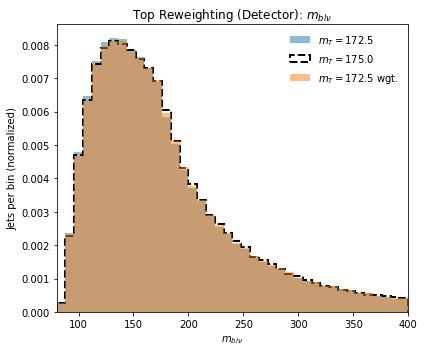

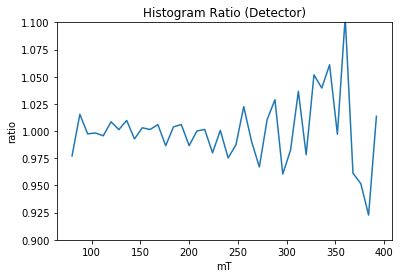

Truth Cor  0.9997016989591626
Det Cor  0.9999126481094389
theta:  177.0


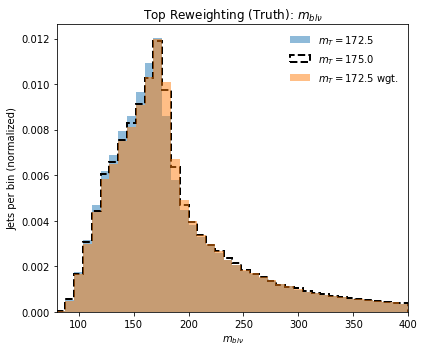

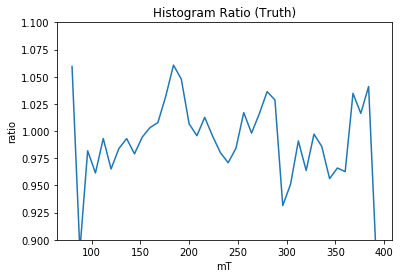

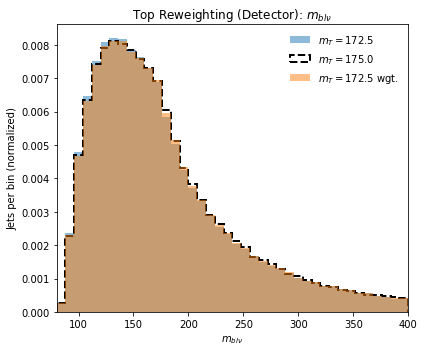

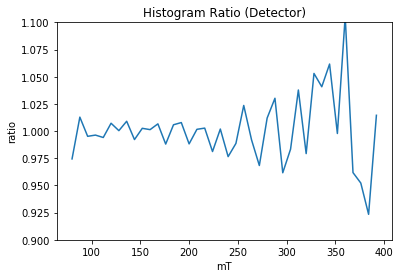

Truth Cor  0.9994918521533648
Det Cor  0.9999149343585657
theta:  177.5


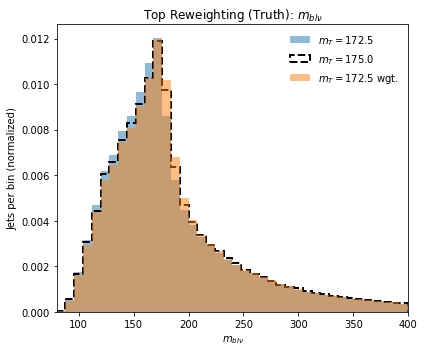

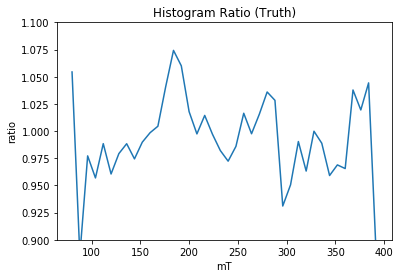

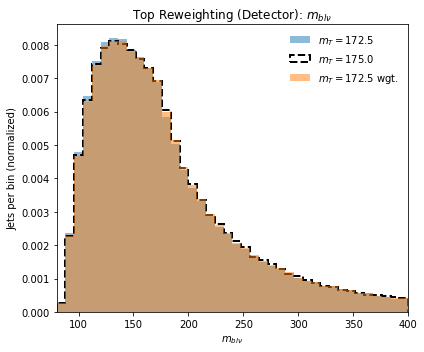

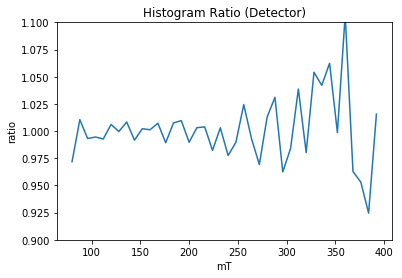

Truth Cor  0.9992232714771725
Det Cor  0.9999140514246415
theta:  178.0


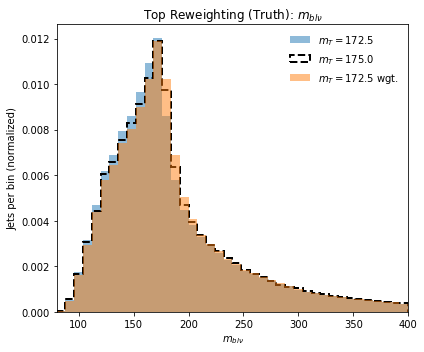

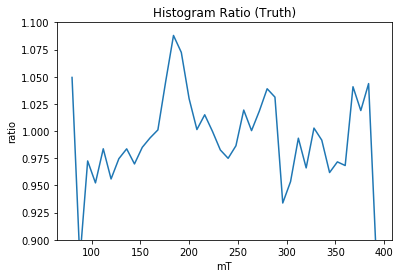

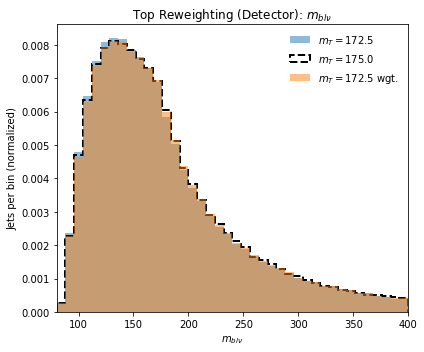

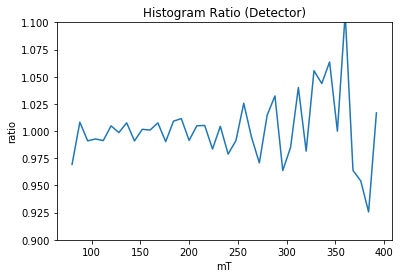

Truth Cor  0.9989172790858248
Det Cor  0.9999110087076496
theta:  178.5


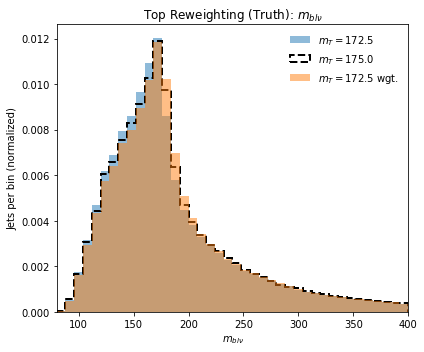

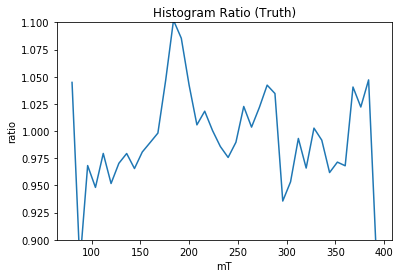

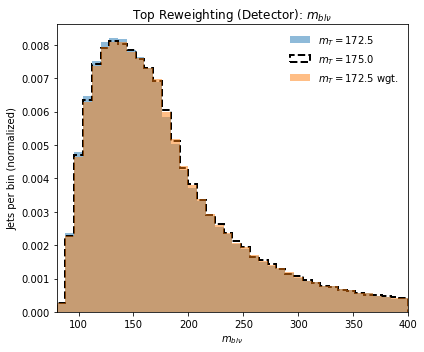

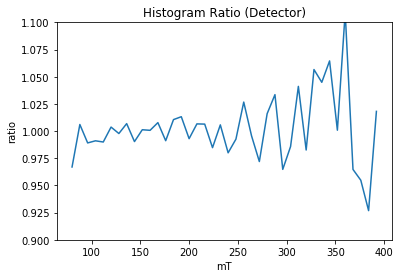

Truth Cor  0.9985911926984216
Det Cor  0.9999059728534943
theta:  179.0


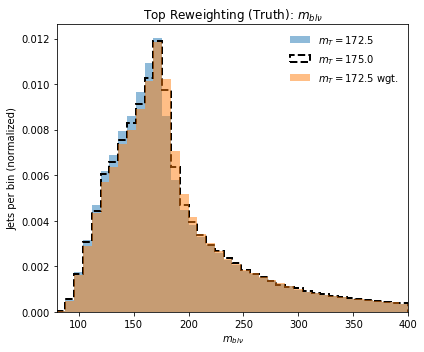

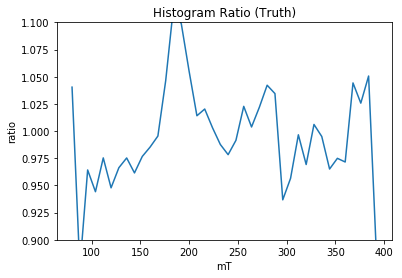

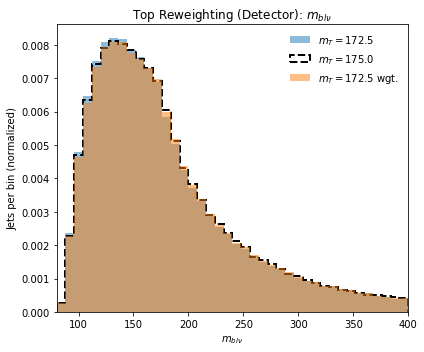

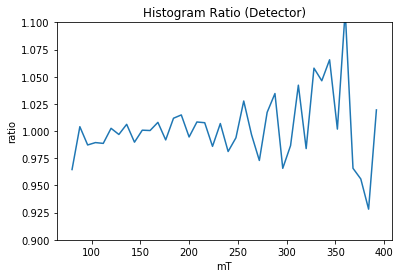

Truth Cor  0.9982531714603577
Det Cor  0.9998991665176165
theta:  179.5


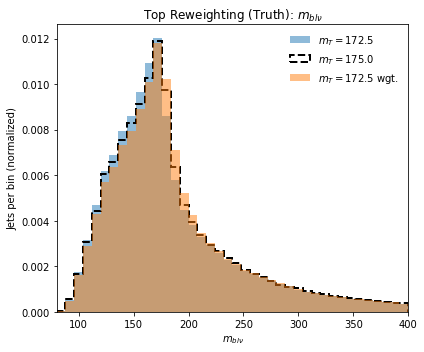

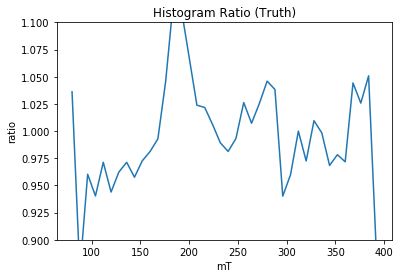

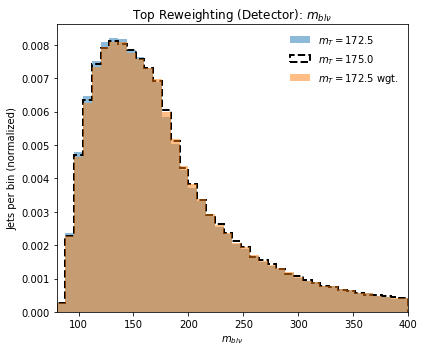

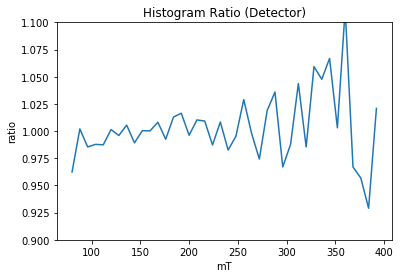

Truth Cor  0.9979264262482649
Det Cor  0.9998907831485799
theta:  180.0


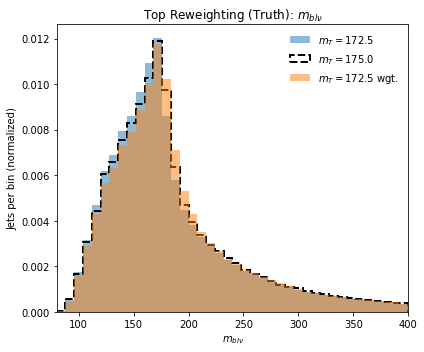

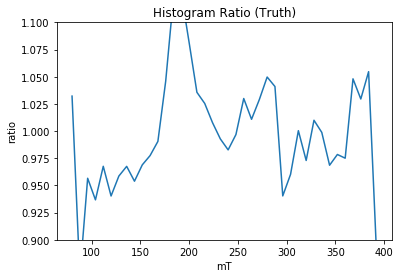

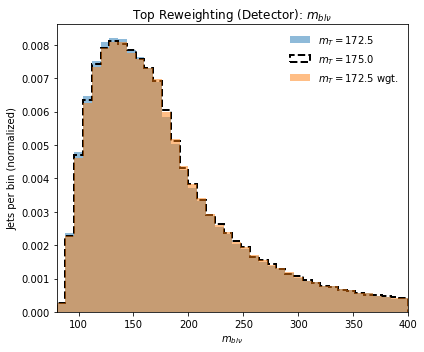

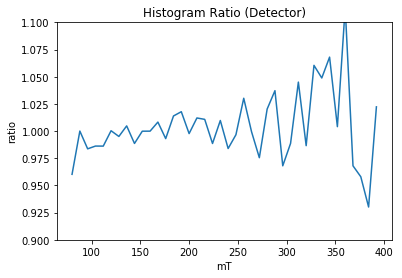

Truth Cor  0.9976181244738994
Det Cor  0.9998813621188946


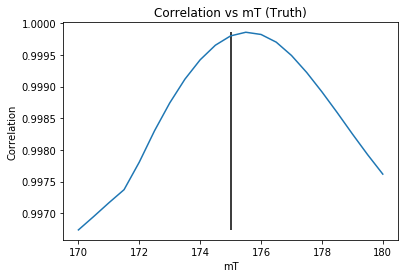

175.5


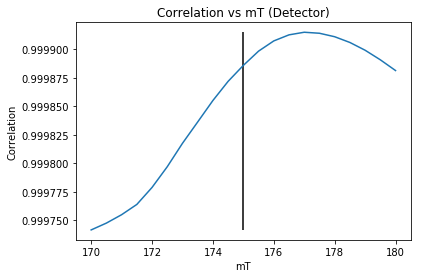

177.0
Weight Iteration:  5
theta:  170.0


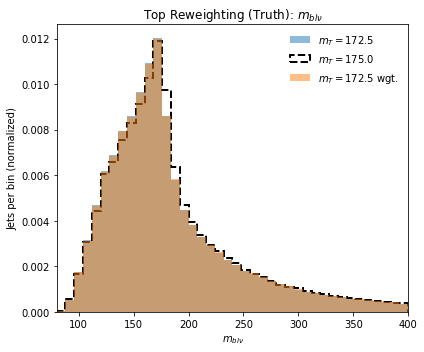

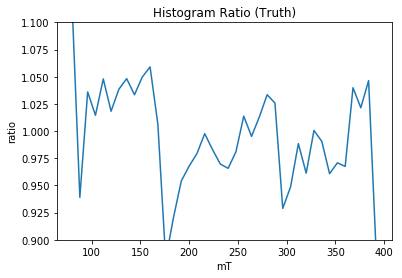

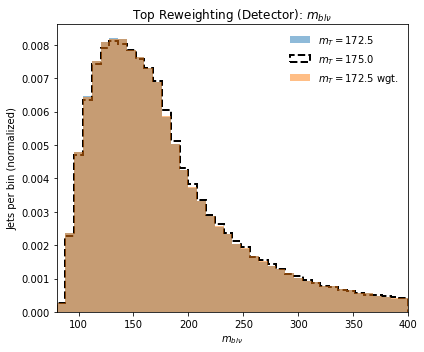

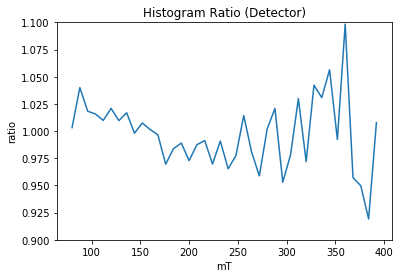

Truth Cor  0.9968982412111261
Det Cor  0.9997358919188469
theta:  170.5


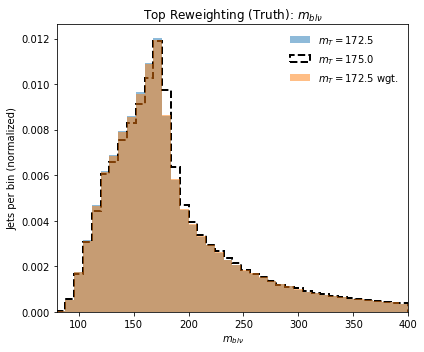

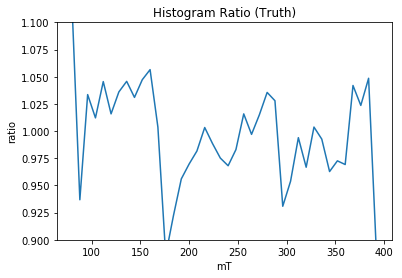

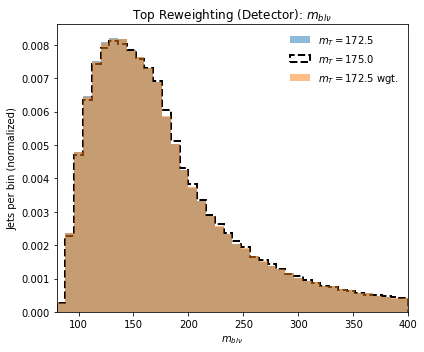

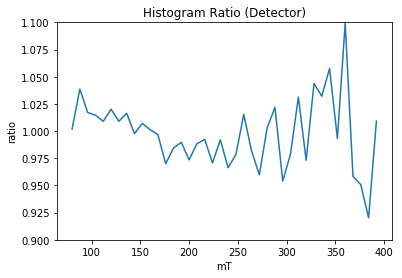

Truth Cor  0.9971242299797954
Det Cor  0.999750522785915
theta:  171.0


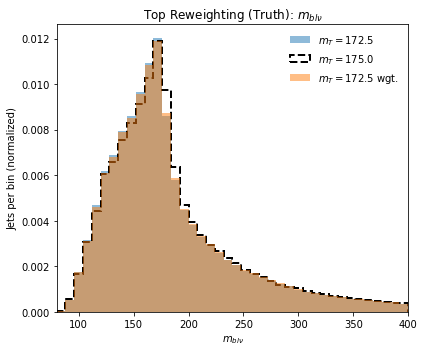

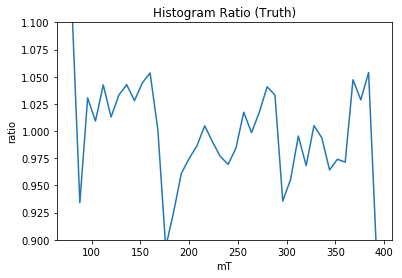

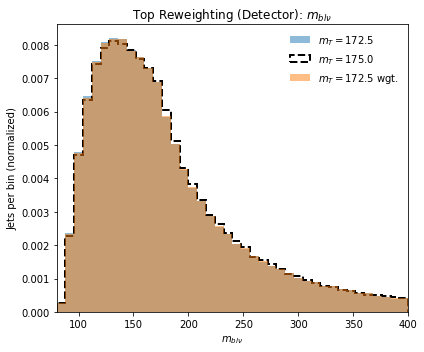

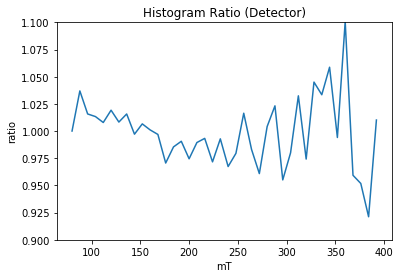

Truth Cor  0.997463382547871
Det Cor  0.9997684118285645
theta:  171.5


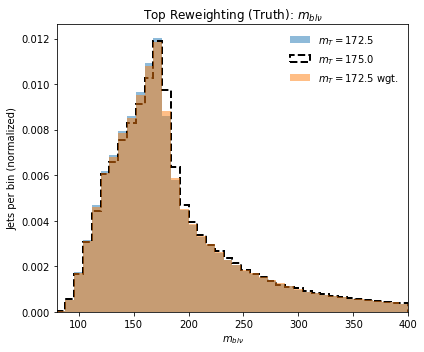

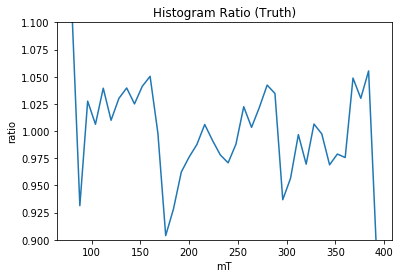

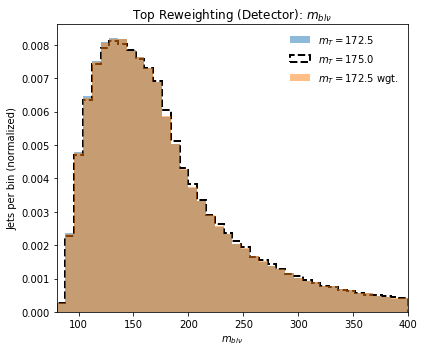

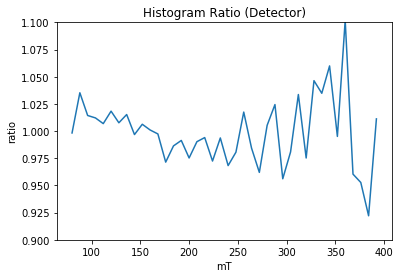

Truth Cor  0.9978538191558013
Det Cor  0.9997850252850145
theta:  172.0


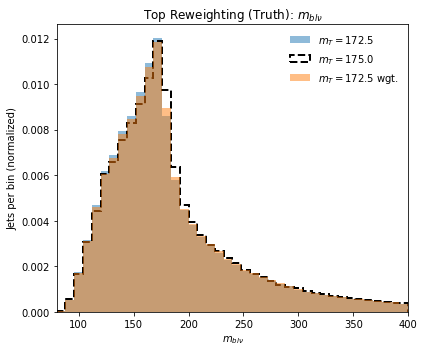

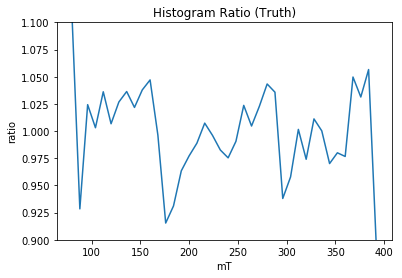

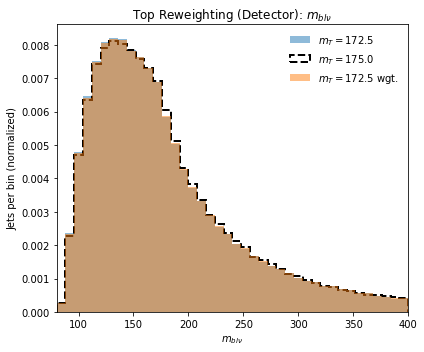

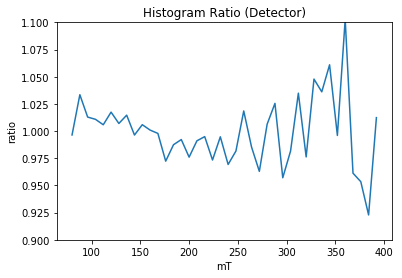

Truth Cor  0.998229073888566
Det Cor  0.9998015231167214
theta:  172.5


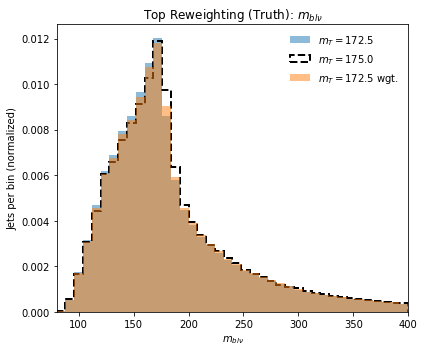

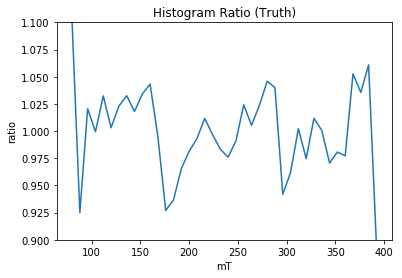

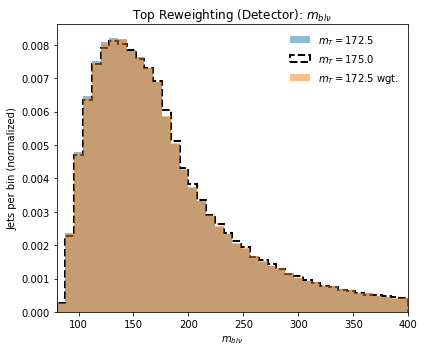

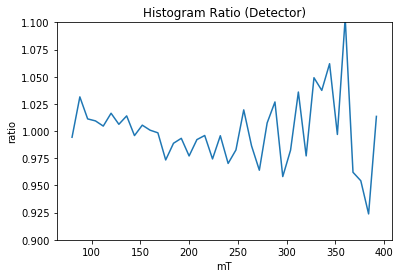

Truth Cor  0.9985987336651035
Det Cor  0.9998198444595423
theta:  173.0


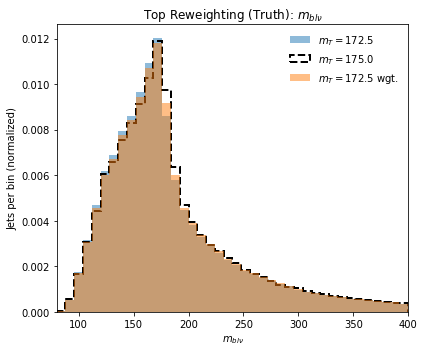

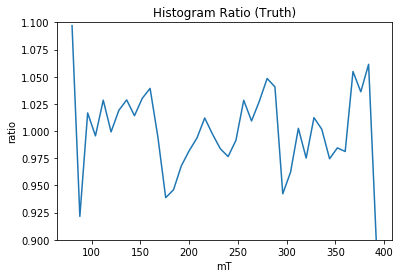

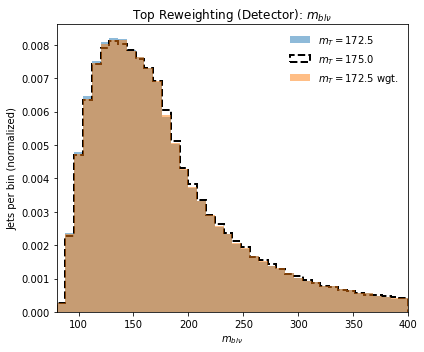

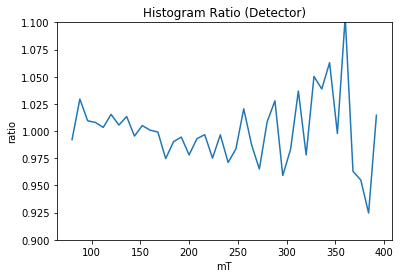

Truth Cor  0.9989465708643674
Det Cor  0.9998366761461885
theta:  173.5


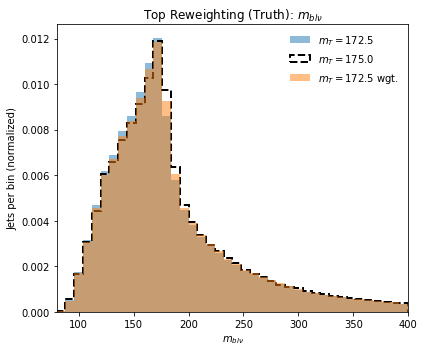

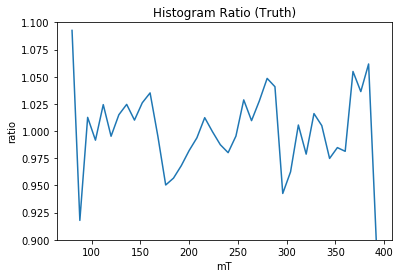

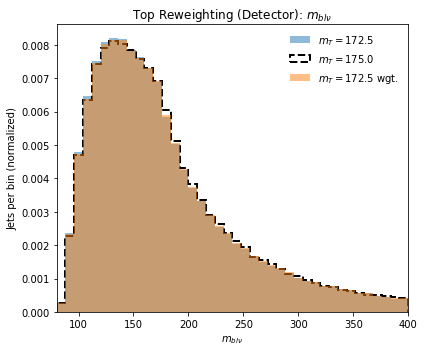

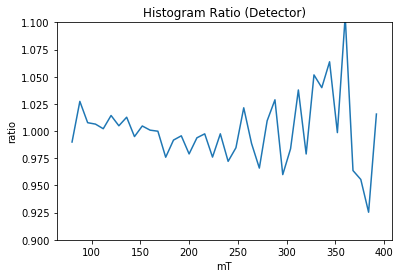

Truth Cor  0.9992487496024597
Det Cor  0.9998523147695534
theta:  174.0


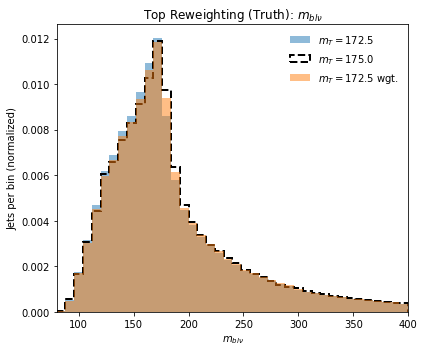

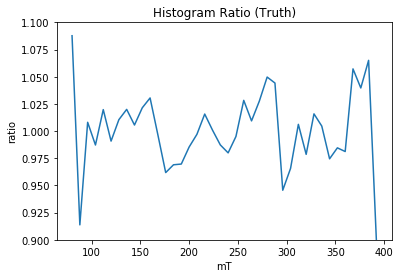

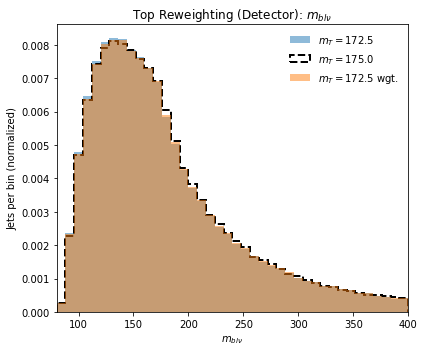

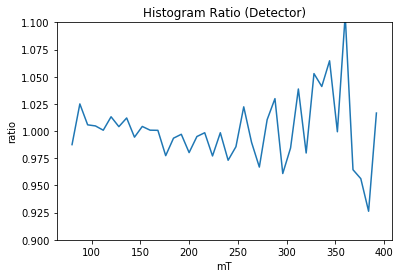

Truth Cor  0.9995043145536294
Det Cor  0.9998681508712962
theta:  174.5


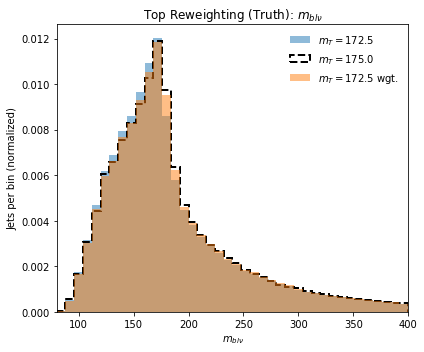

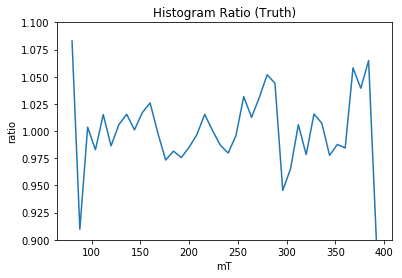

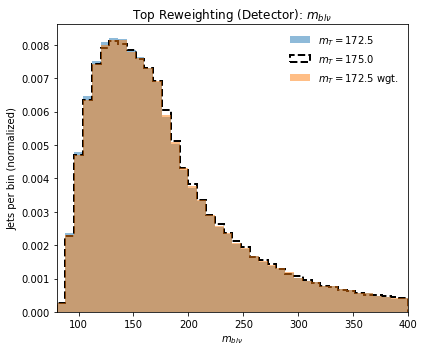

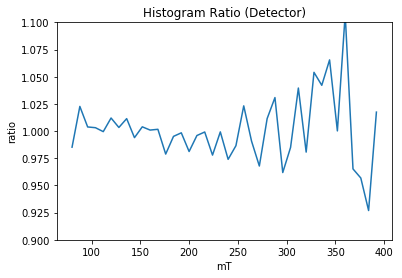

Truth Cor  0.9996966801573257
Det Cor  0.9998809050072919
theta:  175.0


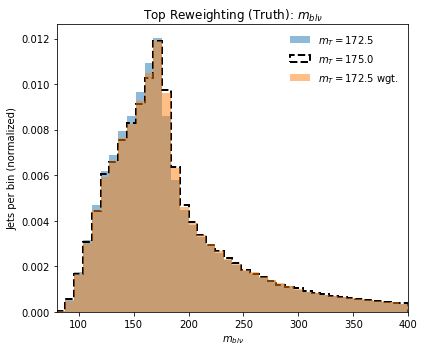

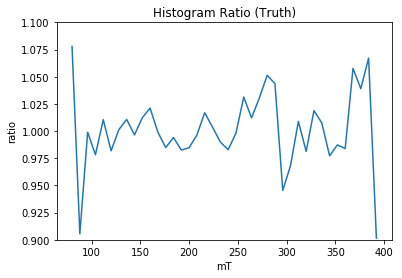

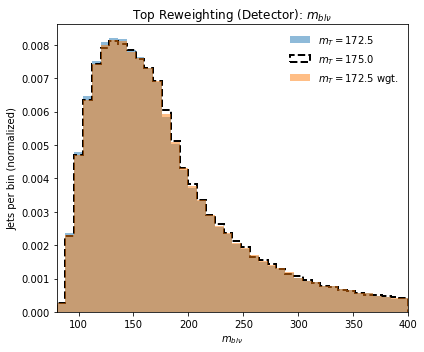

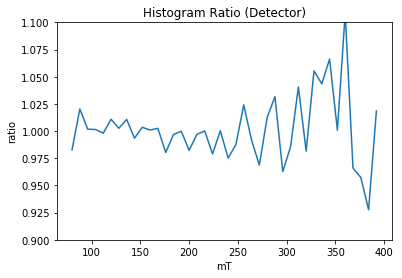

Truth Cor  0.9998227178574218
Det Cor  0.999892064155241
theta:  175.5


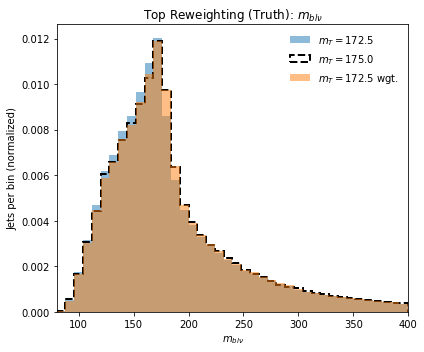

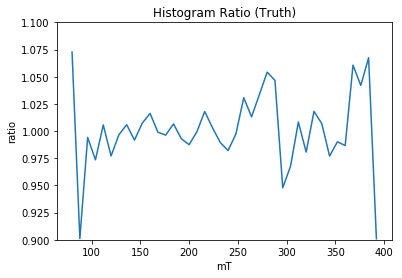

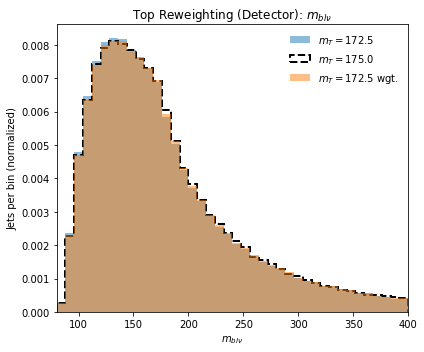

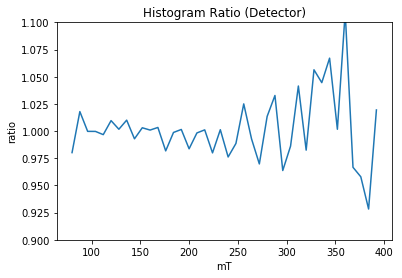

Truth Cor  0.9998775454724746
Det Cor  0.9999013062714139
theta:  176.0


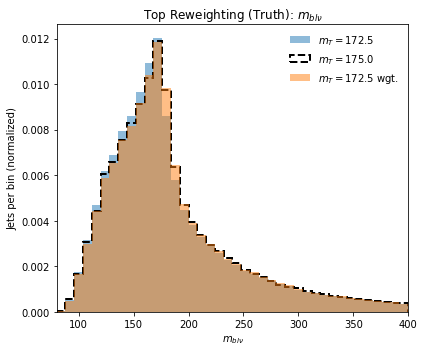

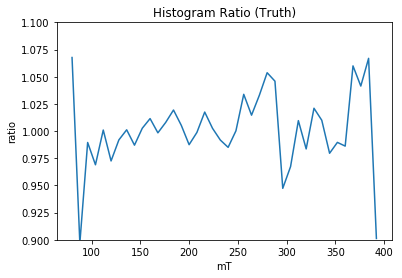

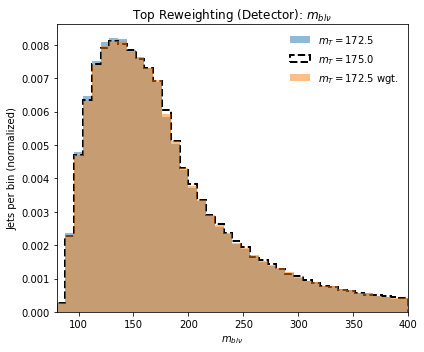

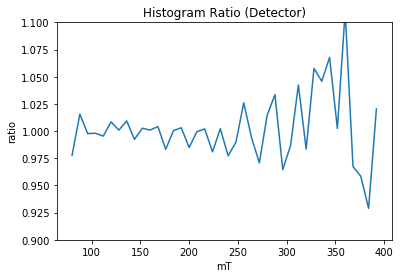

Truth Cor  0.9998555033885321
Det Cor  0.9999075743869108
theta:  176.5


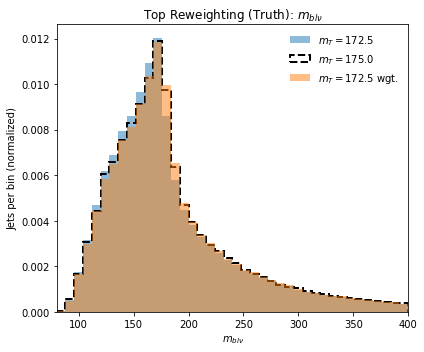

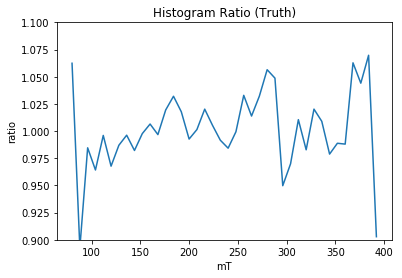

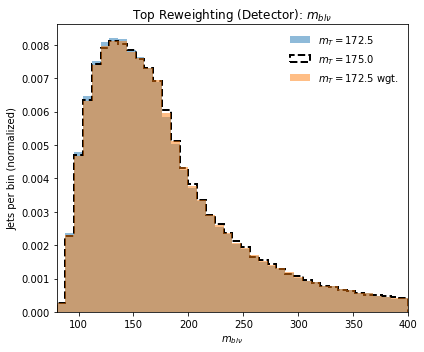

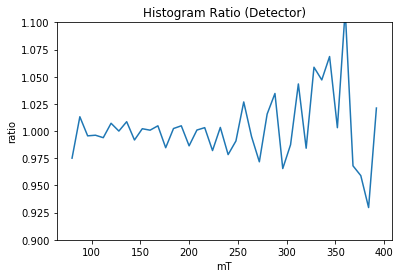

Truth Cor  0.9997522817458173
Det Cor  0.9999119801411934
theta:  177.0


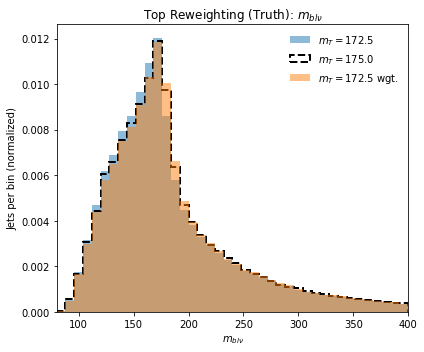

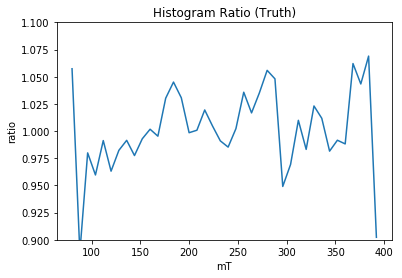

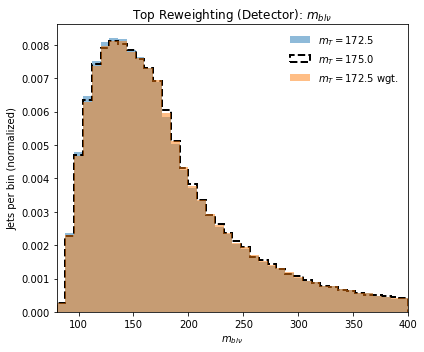

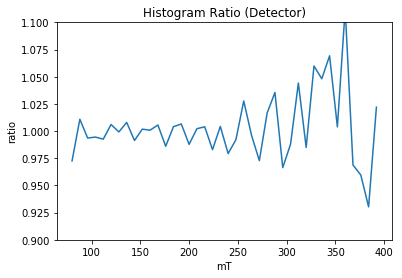

Truth Cor  0.9995732022389637
Det Cor  0.9999131984347056
theta:  177.5


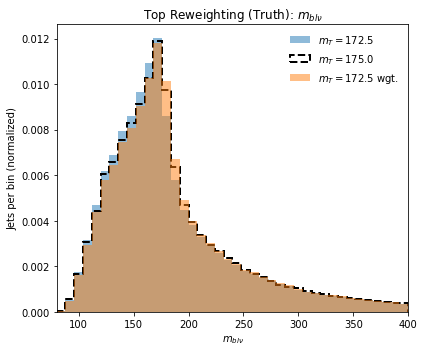

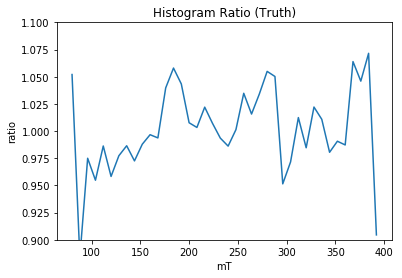

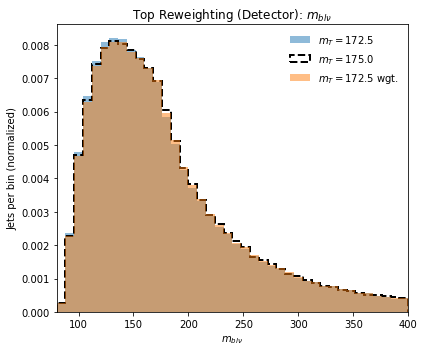

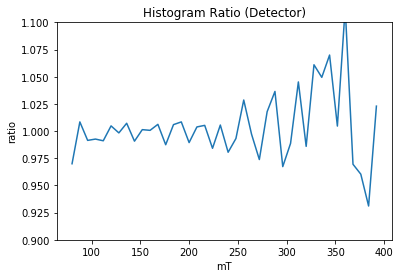

Truth Cor  0.9993243234676252
Det Cor  0.9999122627682939
theta:  178.0


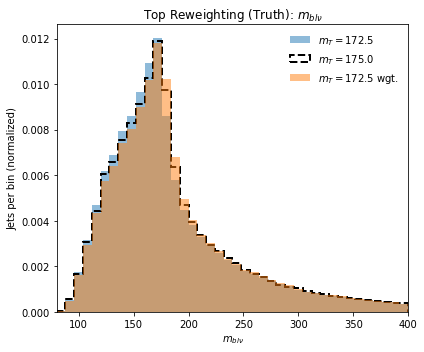

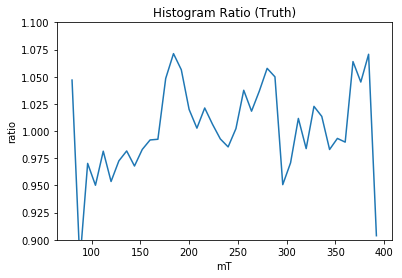

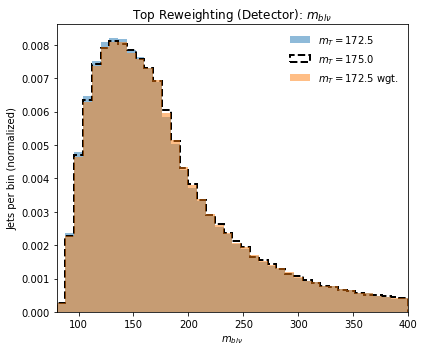

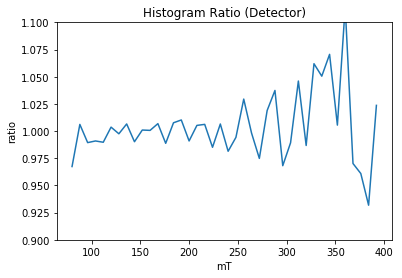

Truth Cor  0.999007050794107
Det Cor  0.9999084749032464
theta:  178.5


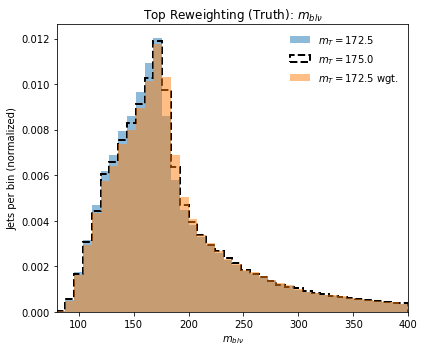

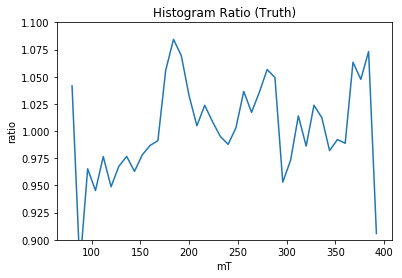

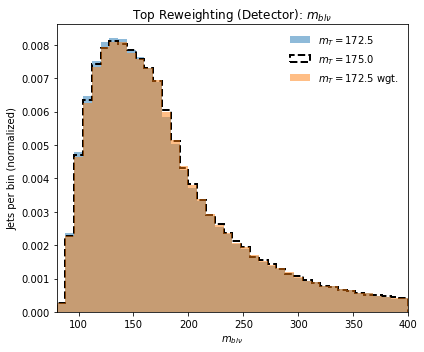

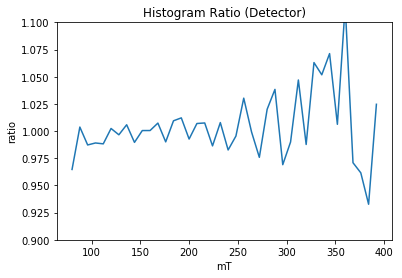

Truth Cor  0.998628282011334
Det Cor  0.9999020828816874
theta:  179.0


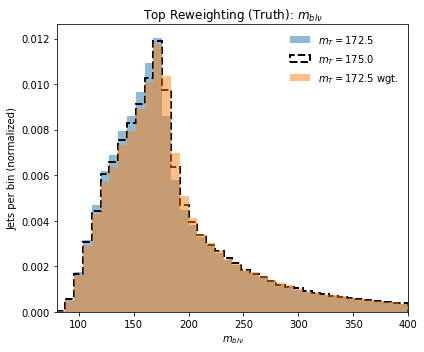

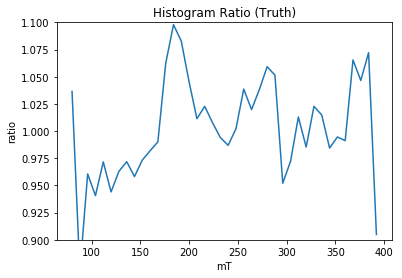

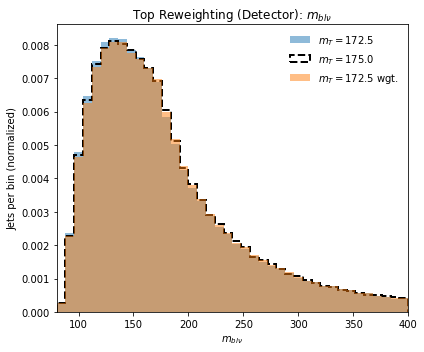

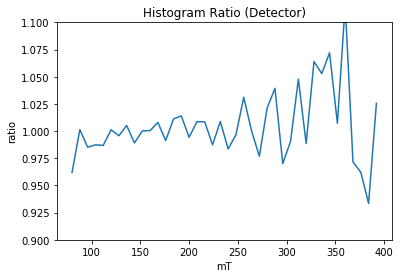

Truth Cor  0.9981896625801419
Det Cor  0.9998931470077921
theta:  179.5


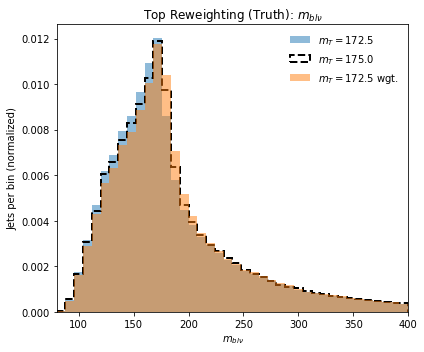

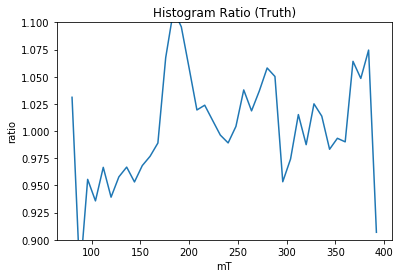

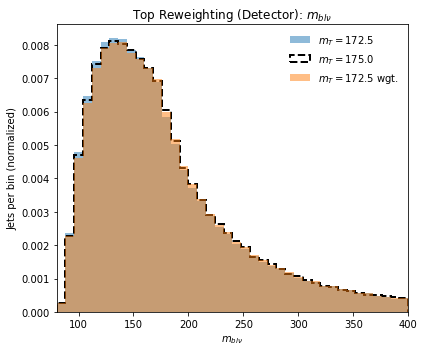

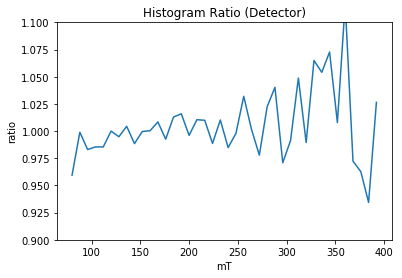

Truth Cor  0.9976967572333713
Det Cor  0.9998812419311589
theta:  180.0


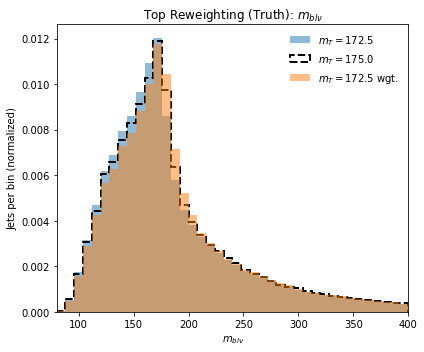

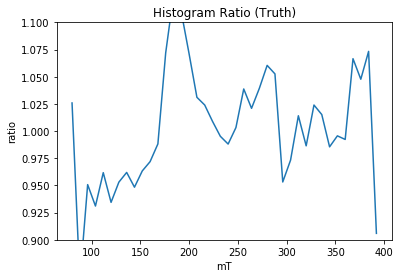

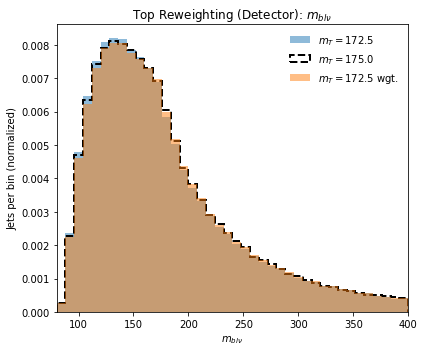

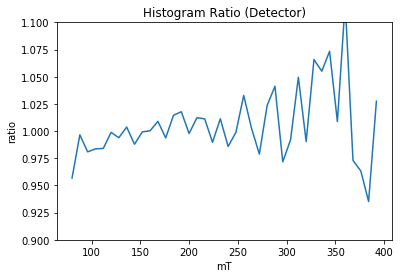

Truth Cor  0.9971435811225438
Det Cor  0.9998669143740275


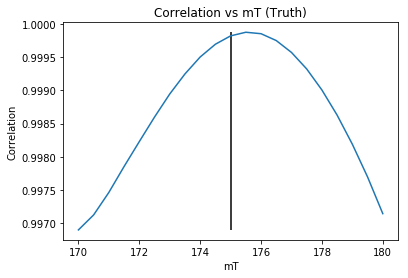

175.5


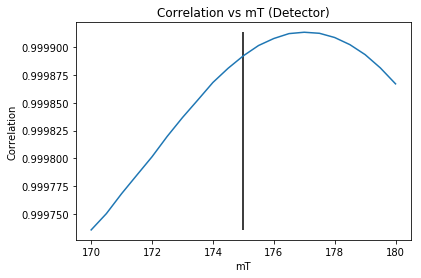

177.0
Weight Iteration:  6
theta:  170.0


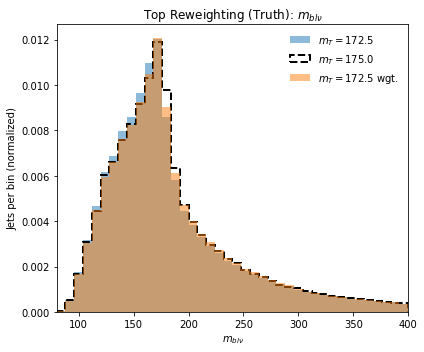

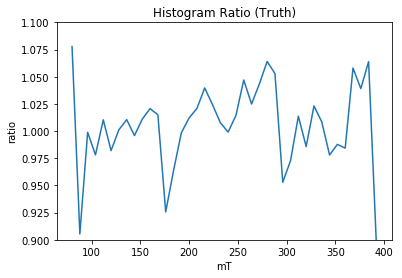

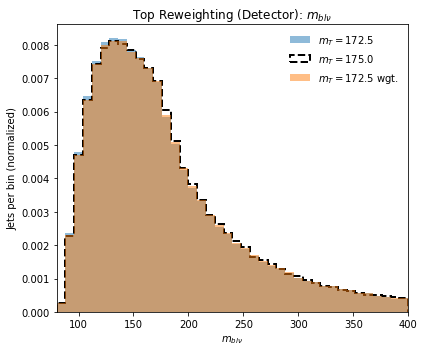

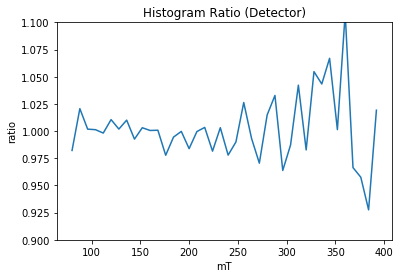

Truth Cor  0.9990861464534078
Det Cor  0.9998894490334409
theta:  170.5


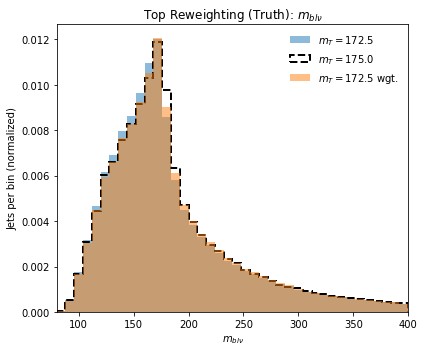

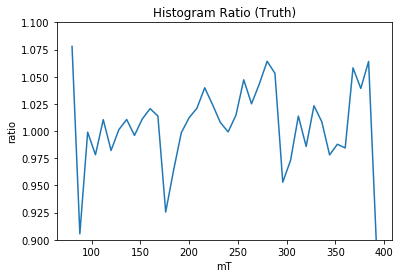

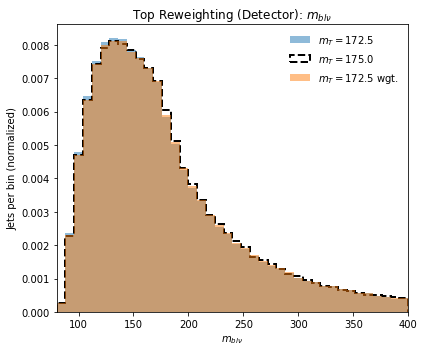

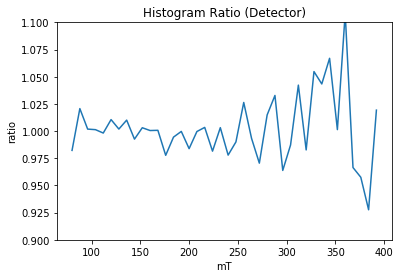

Truth Cor  0.999090295974197
Det Cor  0.999889210490641
theta:  171.0


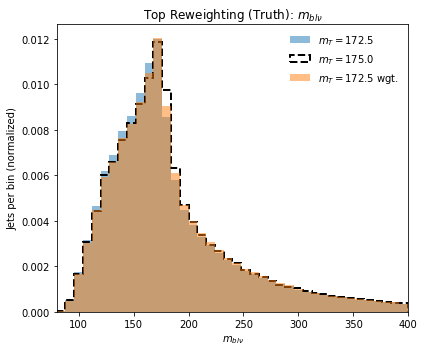

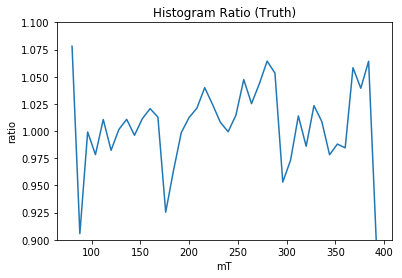

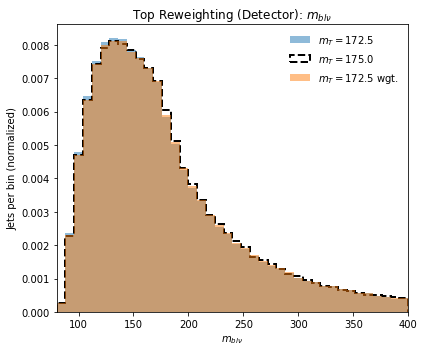

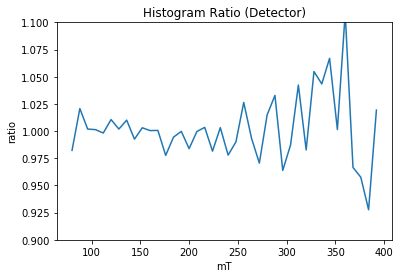

Truth Cor  0.999094193932477
Det Cor  0.9998889711632092
theta:  171.5


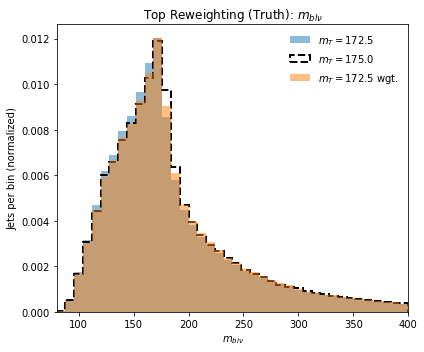

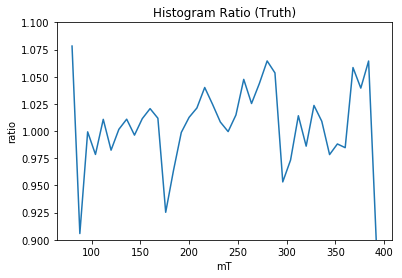

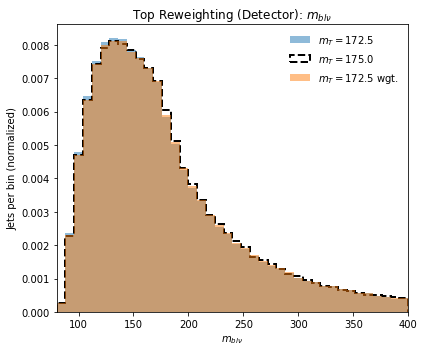

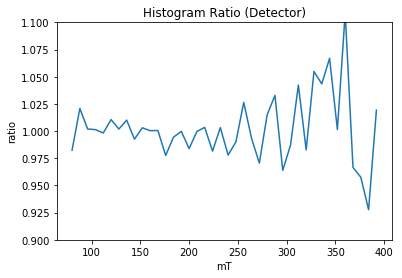

Truth Cor  0.9990976859458303
Det Cor  0.9998887101788133
theta:  172.0


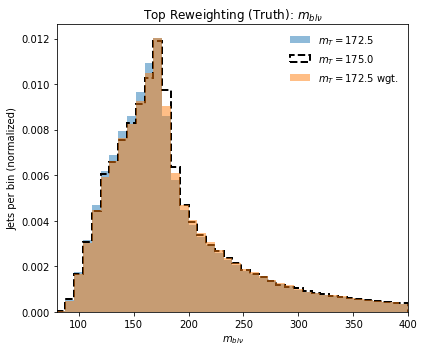

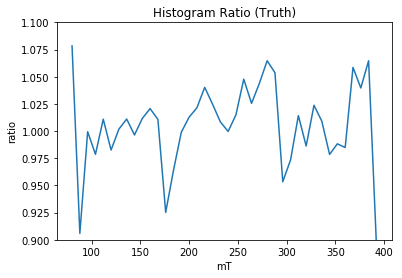

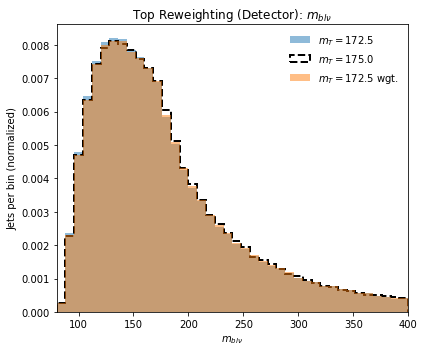

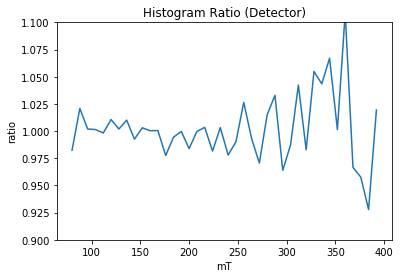

Truth Cor  0.9990998029261903
Det Cor  0.9998884863313401
theta:  172.5


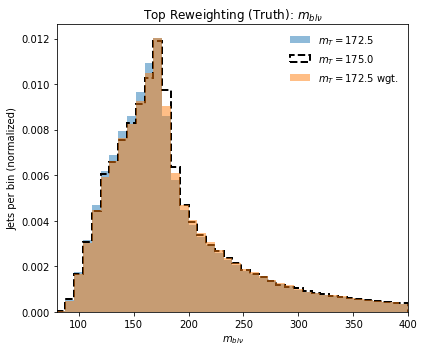

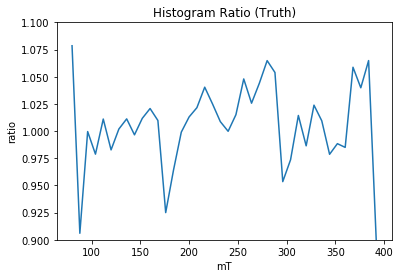

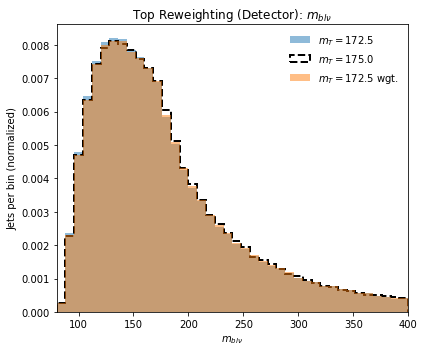

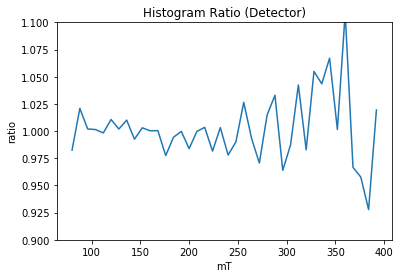

Truth Cor  0.9991012132879193
Det Cor  0.9998882445003101
theta:  173.0


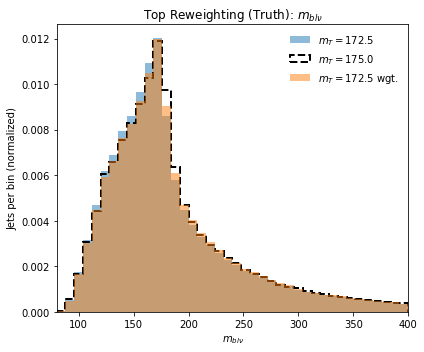

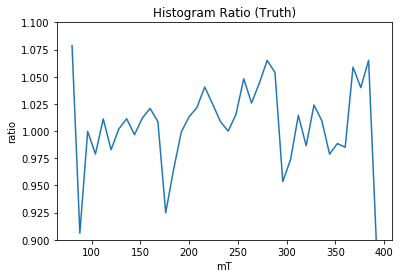

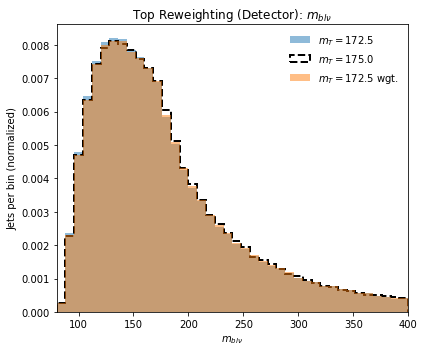

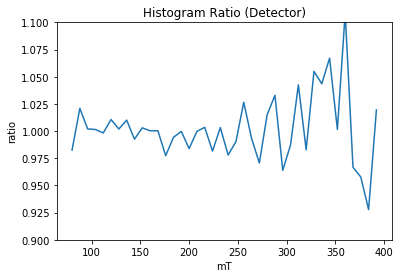

Truth Cor  0.9991020781124986
Det Cor  0.9998879257346002
theta:  173.5


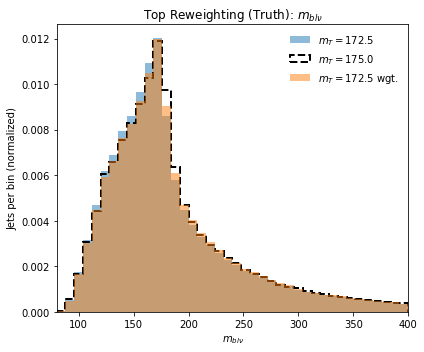

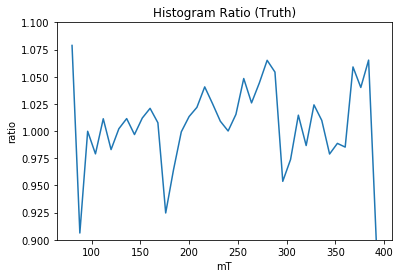

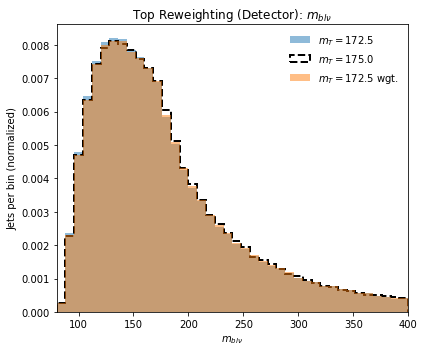

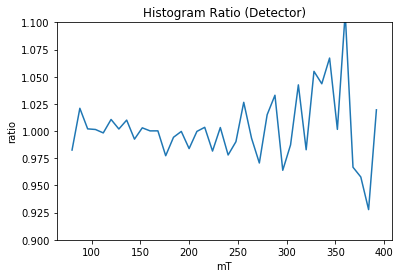

Truth Cor  0.9991022994681016
Det Cor  0.9998877020035818
theta:  174.0


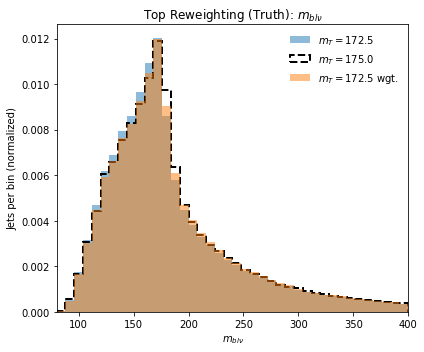

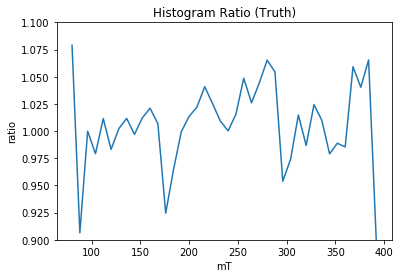

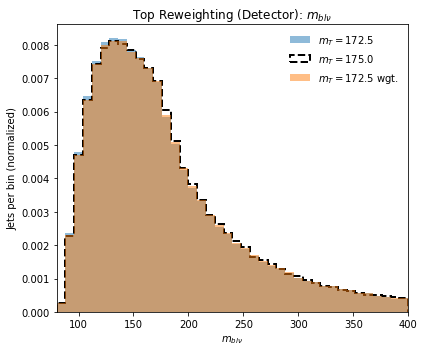

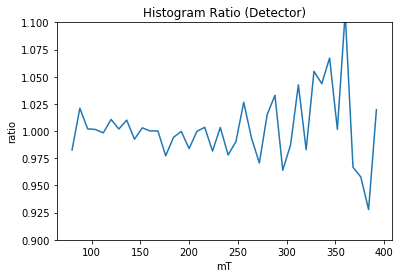

Truth Cor  0.9991009045987614
Det Cor  0.9998874140362326
theta:  174.5


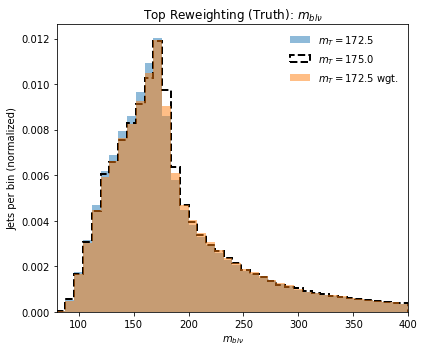

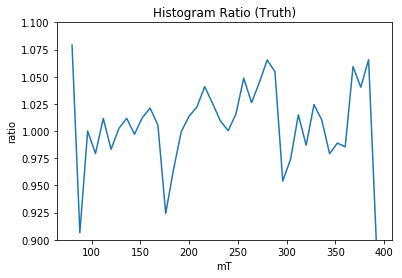

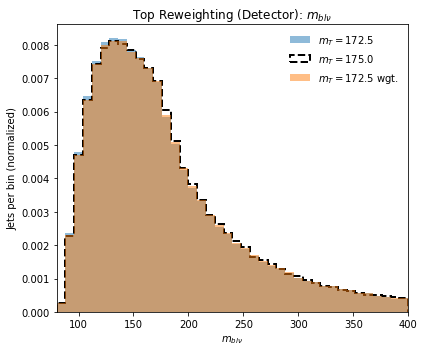

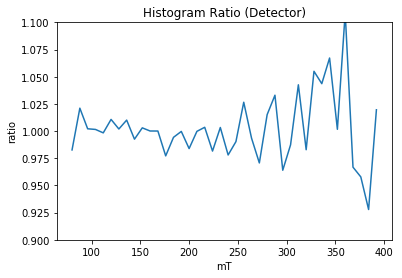

Truth Cor  0.9990992302916383
Det Cor  0.999887118193266
theta:  175.0


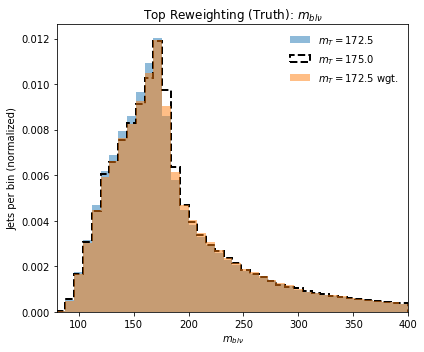

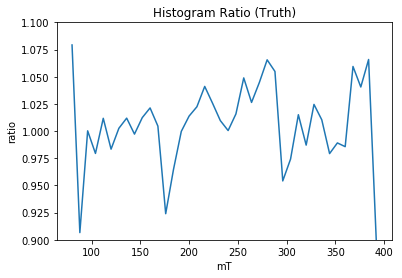

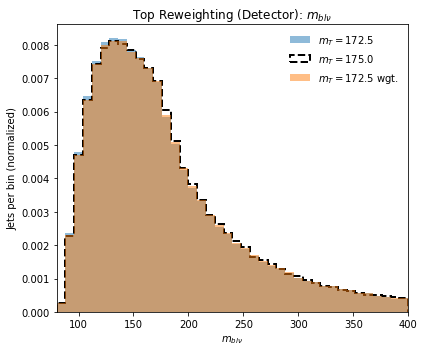

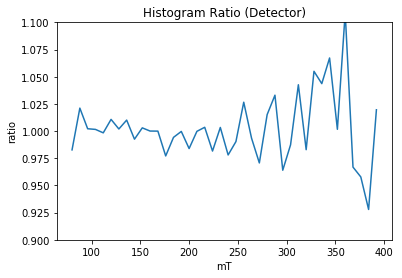

Truth Cor  0.9990972804838746
Det Cor  0.9998868578291589
theta:  175.5


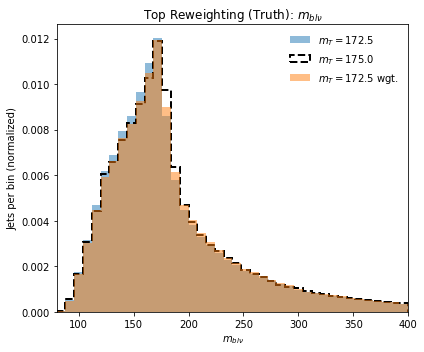

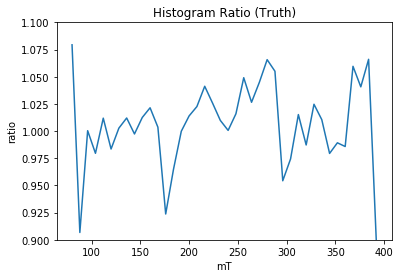

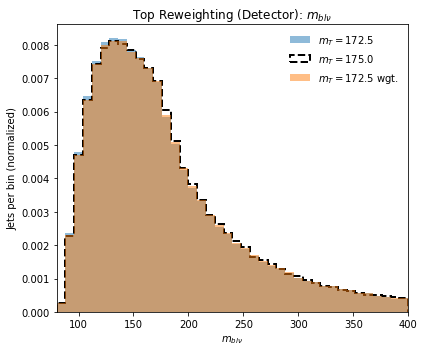

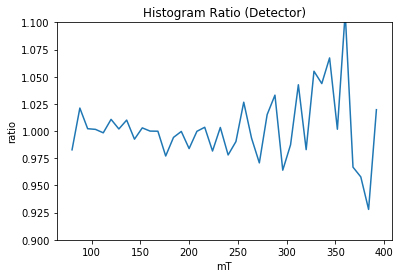

Truth Cor  0.9990939897572169
Det Cor  0.9998865861879407
theta:  176.0


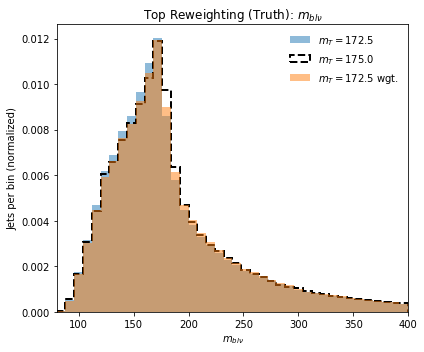

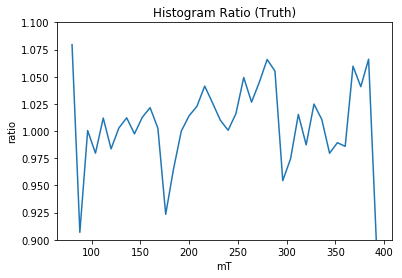

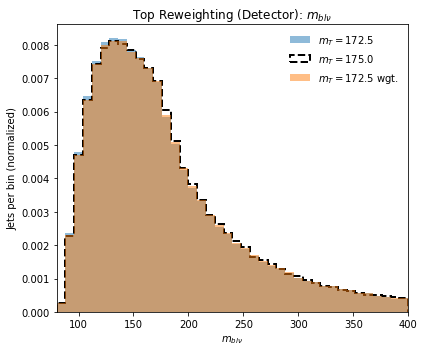

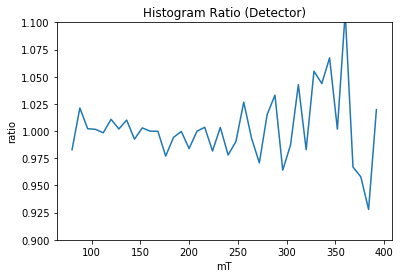

Truth Cor  0.9990899765457345
Det Cor  0.9998863043435439
theta:  176.5


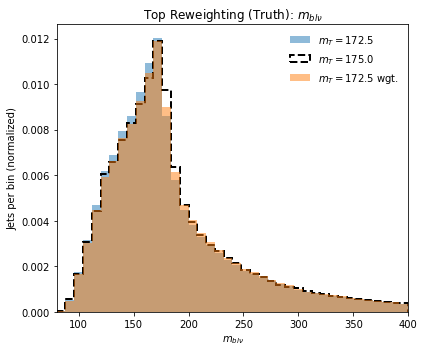

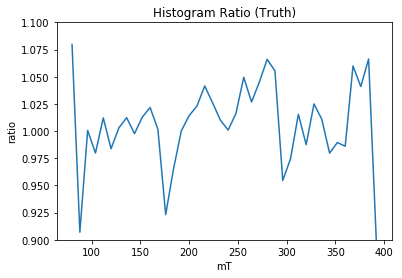

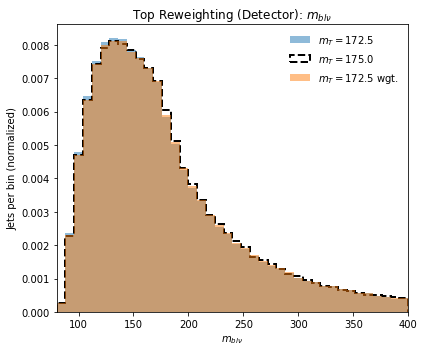

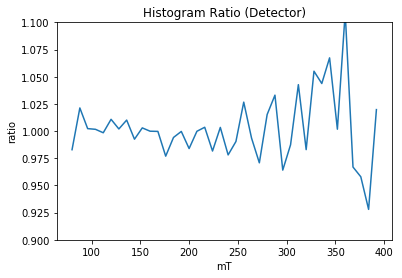

Truth Cor  0.9990857143433614
Det Cor  0.9998859667940181
theta:  177.0


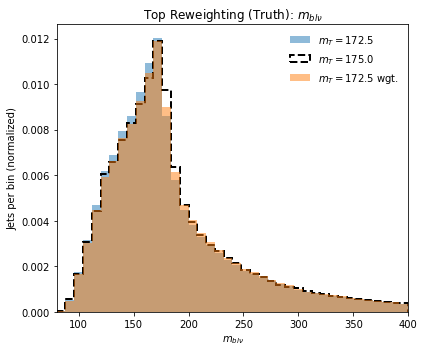

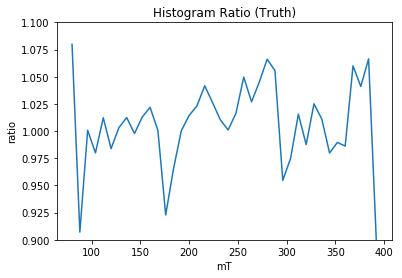

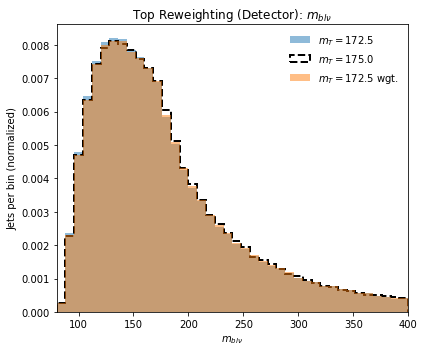

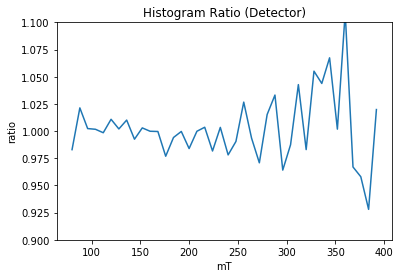

Truth Cor  0.9990804853923111
Det Cor  0.9998856650764563
theta:  177.5


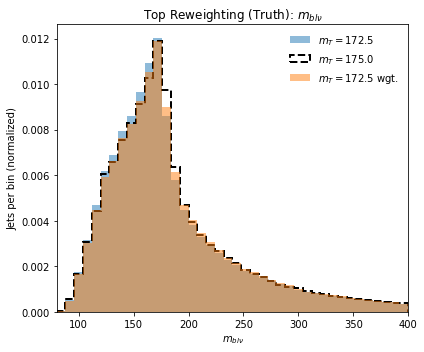

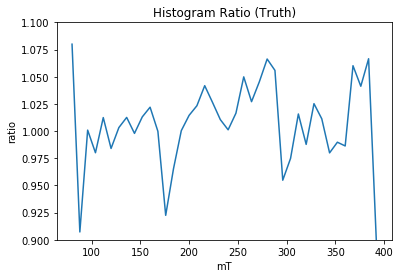

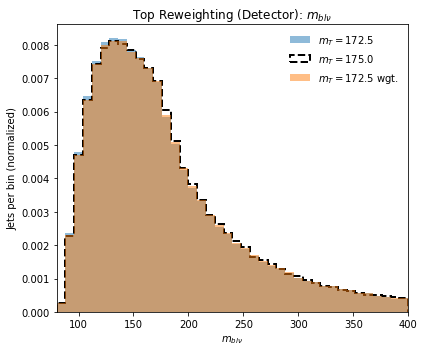

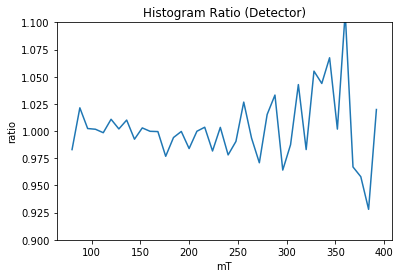

Truth Cor  0.9990743676688215
Det Cor  0.9998853748464532
theta:  178.0


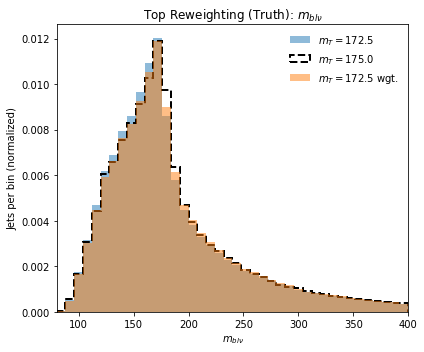

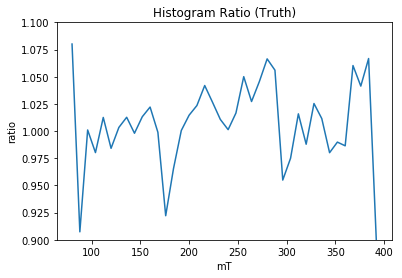

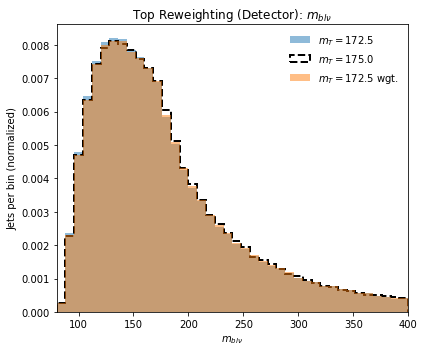

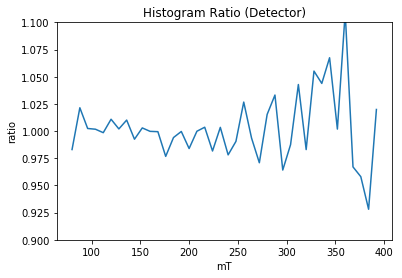

Truth Cor  0.9990679258175005
Det Cor  0.9998850655152208
theta:  178.5


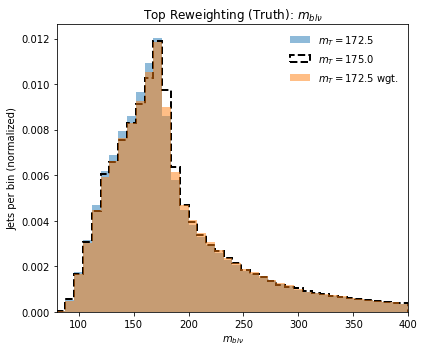

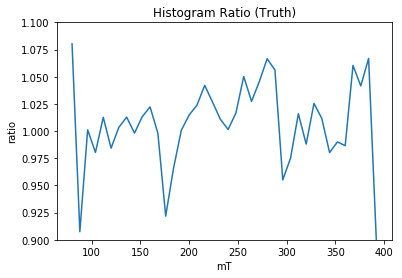

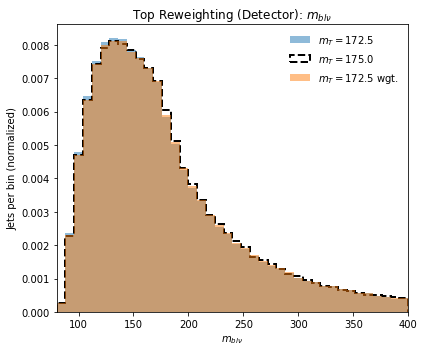

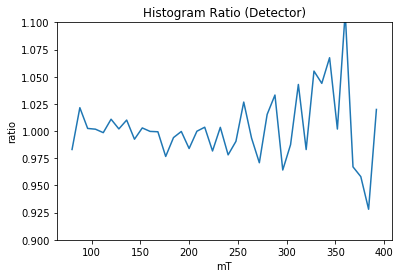

Truth Cor  0.9990612142358928
Det Cor  0.9998847379333119
theta:  179.0


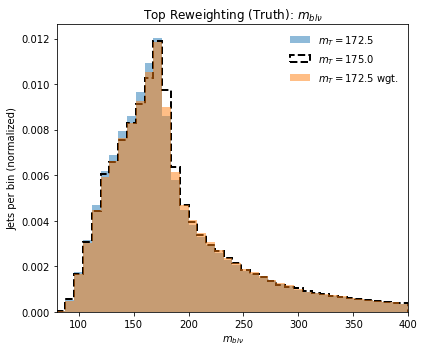

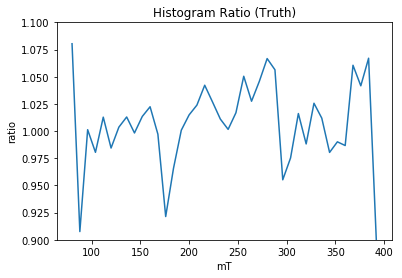

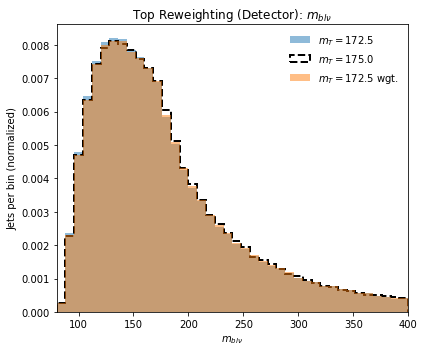

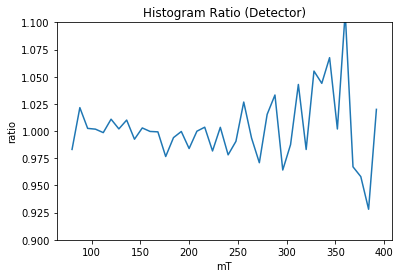

Truth Cor  0.9990529992672029
Det Cor  0.9998844367443056
theta:  179.5


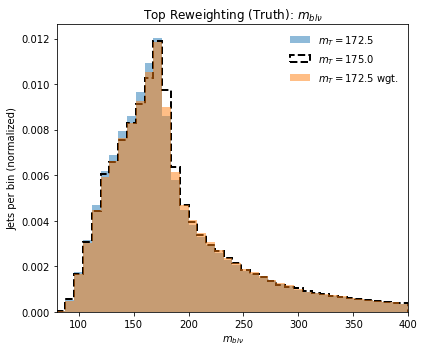

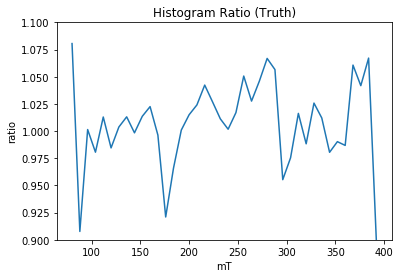

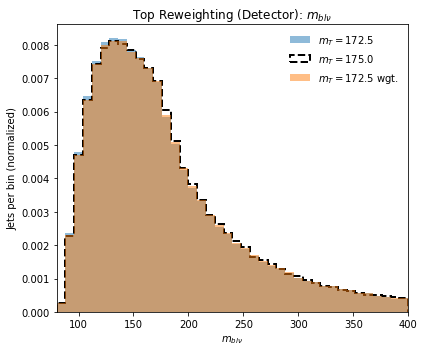

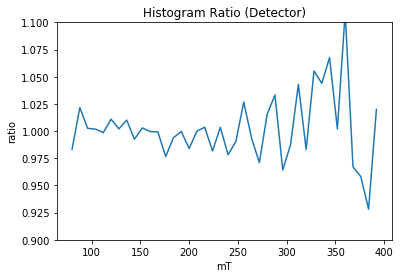

Truth Cor  0.9990446726817033
Det Cor  0.9998841068950249
theta:  180.0


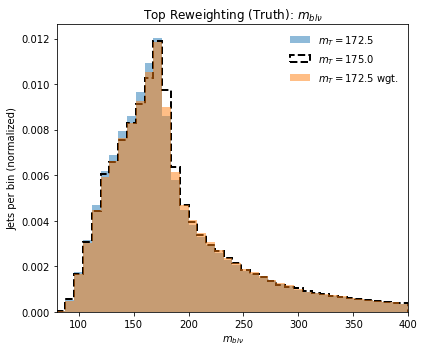

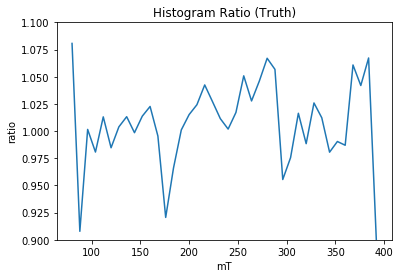

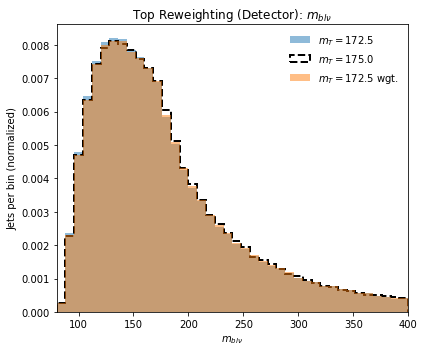

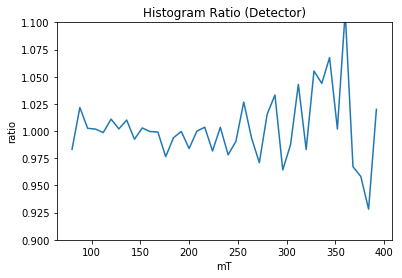

Truth Cor  0.9990361102324888
Det Cor  0.999883774934767


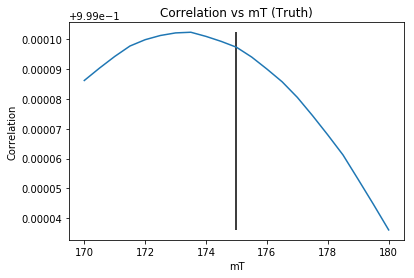

173.5


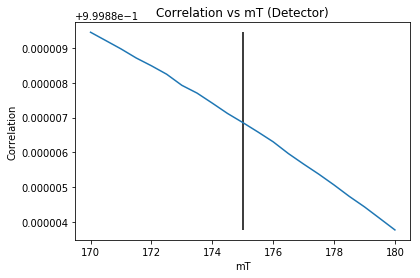

170.0
Weight Iteration:  7
theta:  170.0


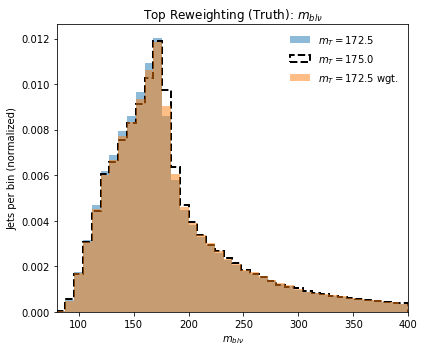

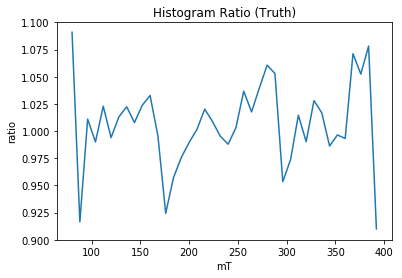

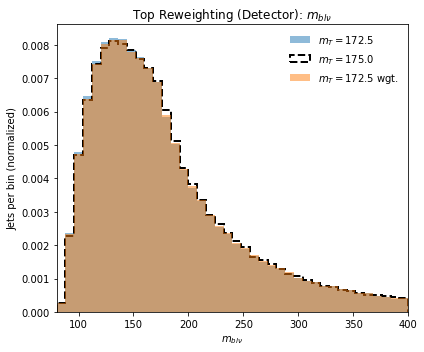

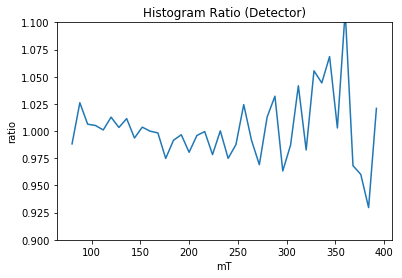

Truth Cor  0.9989215457448948
Det Cor  0.99985995712407
theta:  170.5


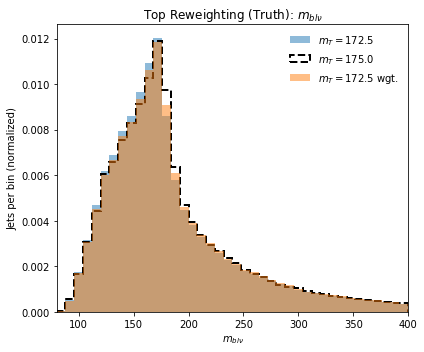

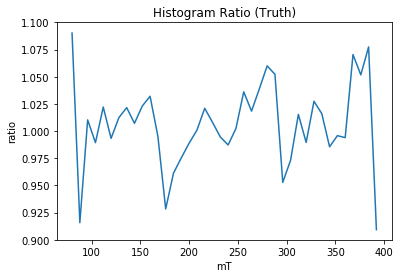

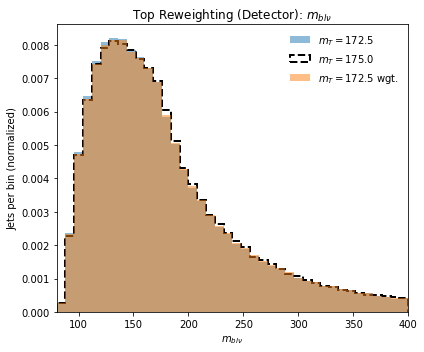

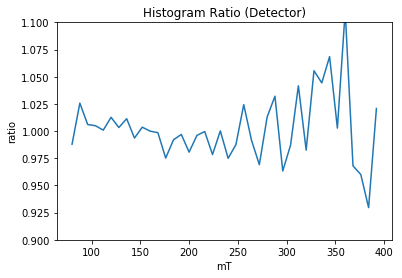

Truth Cor  0.9990202226089736
Det Cor  0.9998625056537619
theta:  171.0


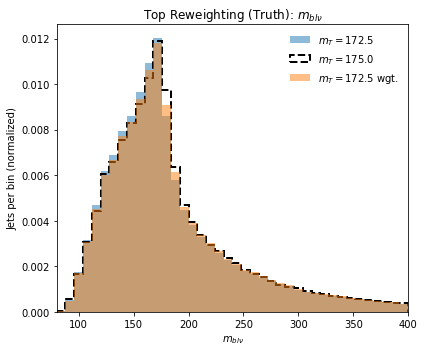

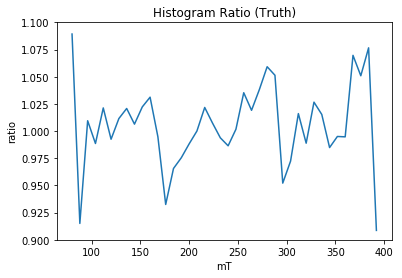

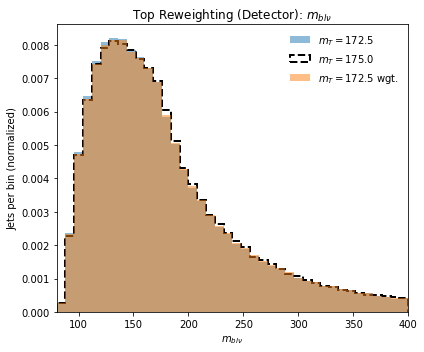

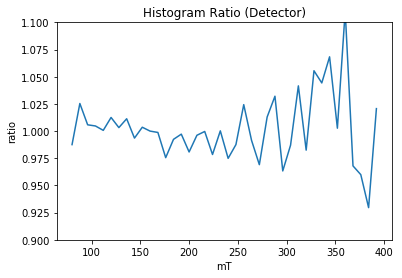

Truth Cor  0.9991165309932165
Det Cor  0.9998652493517534
theta:  171.5


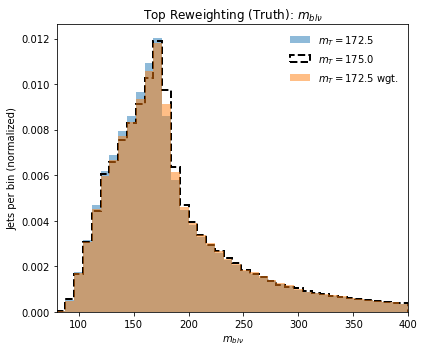

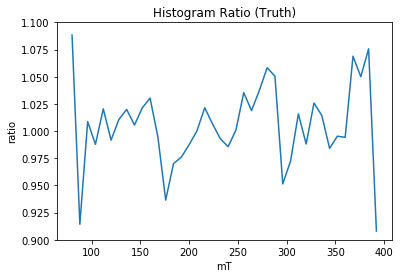

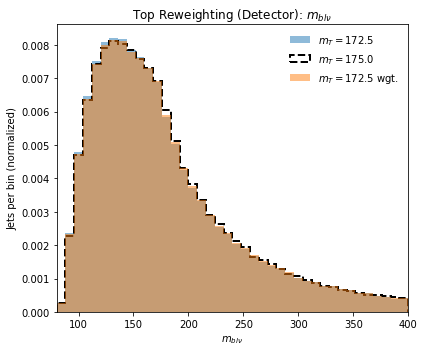

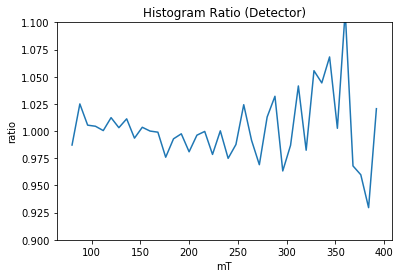

Truth Cor  0.999207688077443
Det Cor  0.999868152151355
theta:  172.0


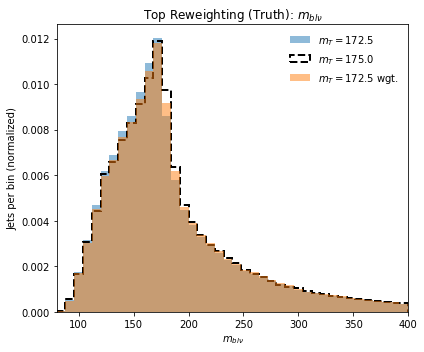

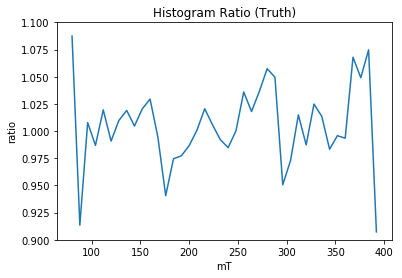

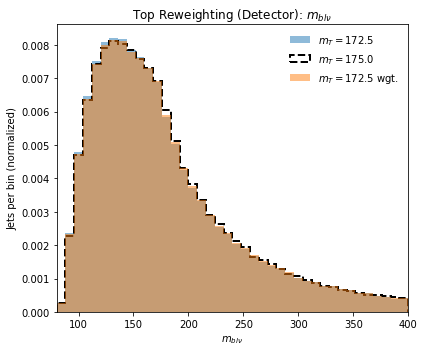

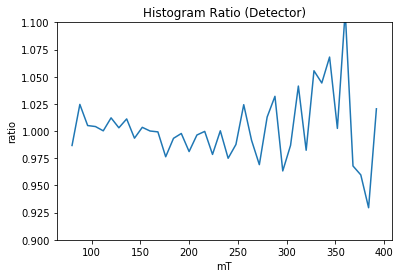

Truth Cor  0.9992947472054958
Det Cor  0.9998712275905624
theta:  172.5


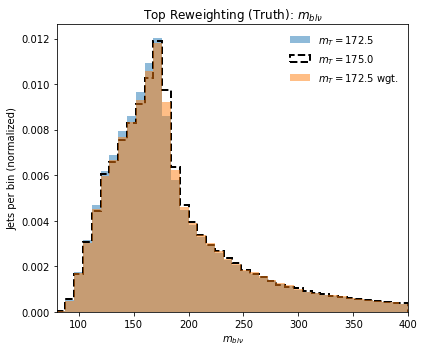

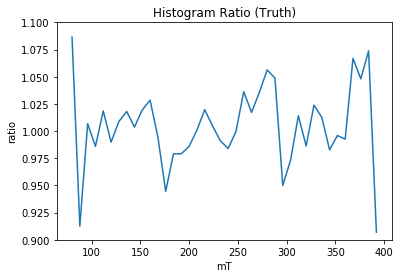

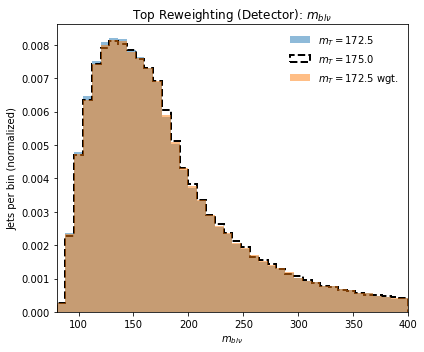

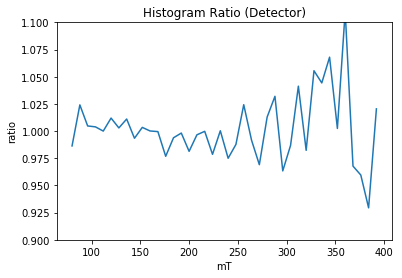

Truth Cor  0.9993763773938665
Det Cor  0.9998743604258397
theta:  173.0


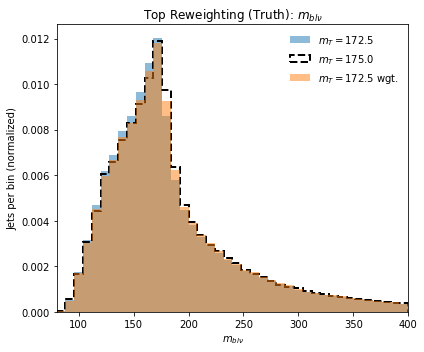

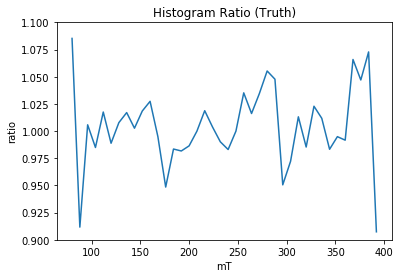

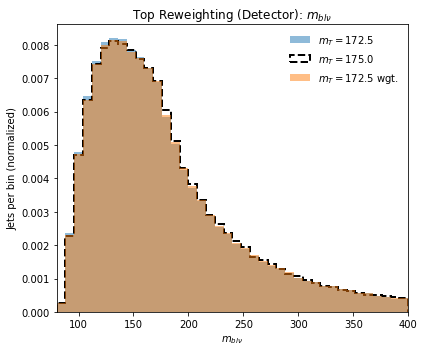

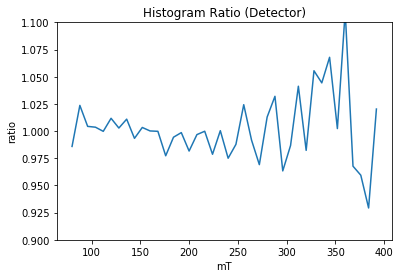

Truth Cor  0.999453284621712
Det Cor  0.9998775707043206
theta:  173.5


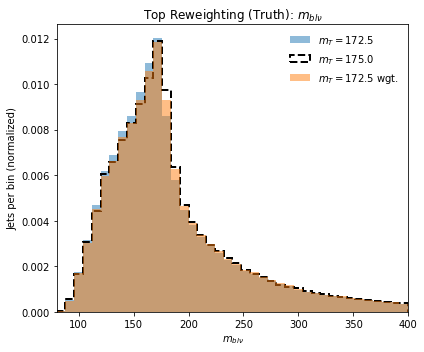

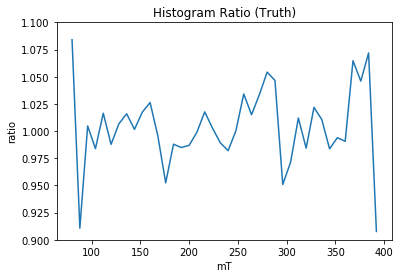

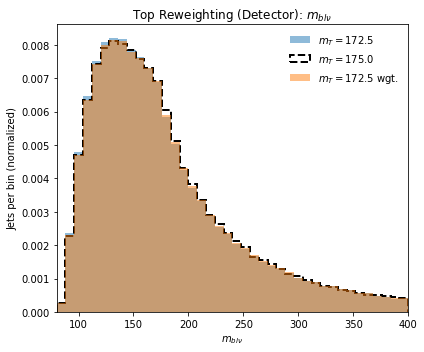

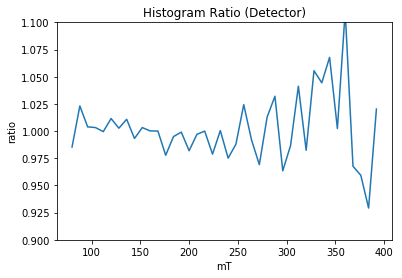

Truth Cor  0.9995241628013608
Det Cor  0.9998807983152604
theta:  174.0


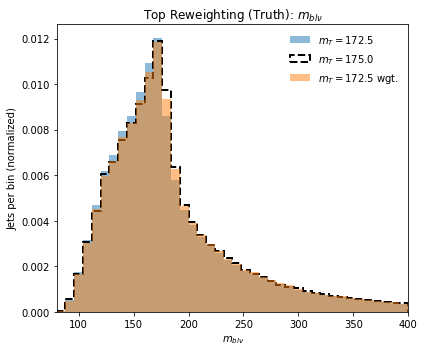

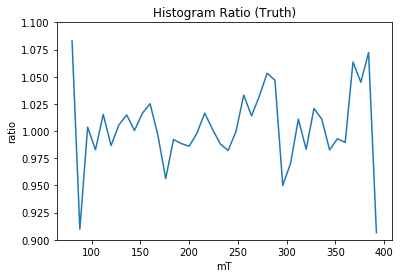

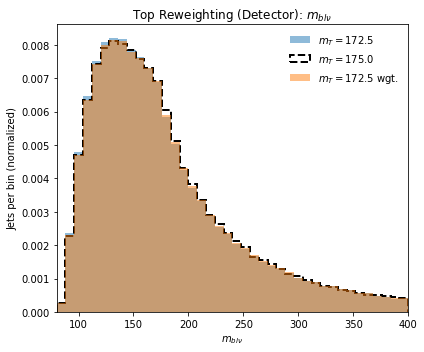

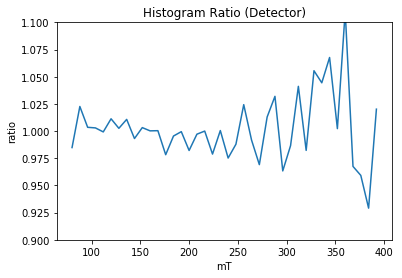

Truth Cor  0.9995878532775723
Det Cor  0.9998837952311099
theta:  174.5


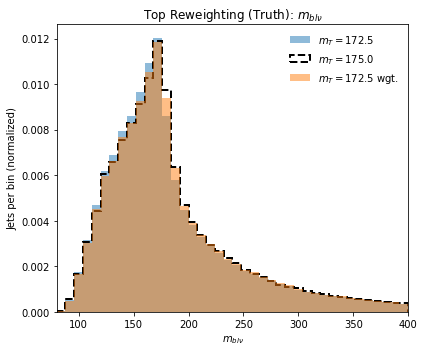

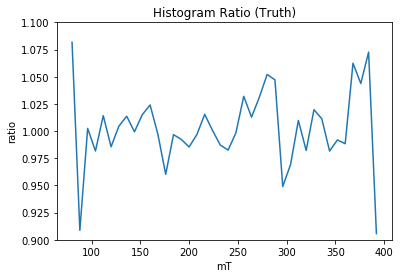

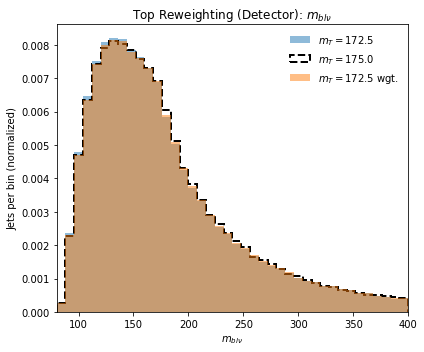

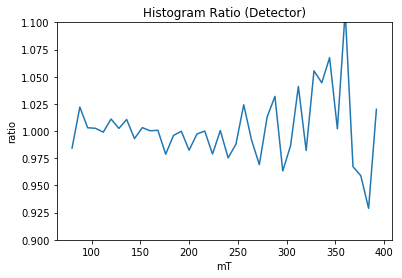

Truth Cor  0.99964435878394
Det Cor  0.9998866579031455
theta:  175.0


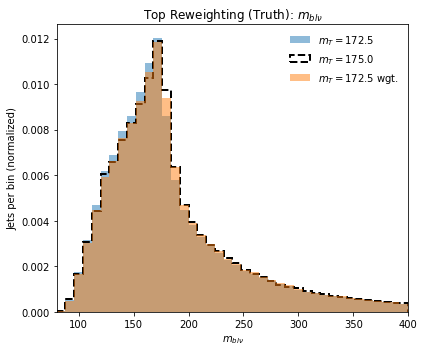

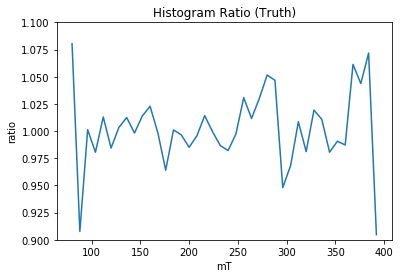

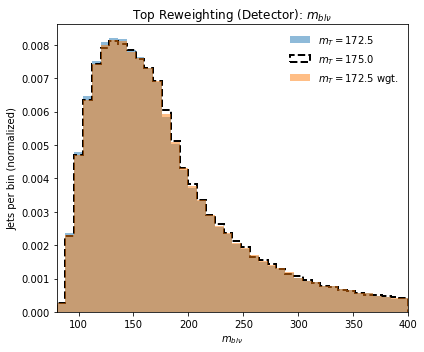

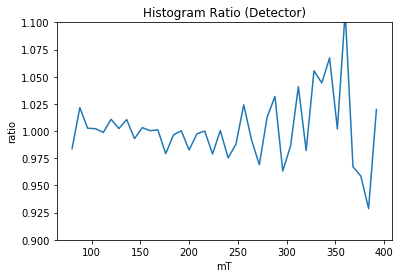

Truth Cor  0.9996932999848478
Det Cor  0.9998895134217715
theta:  175.5


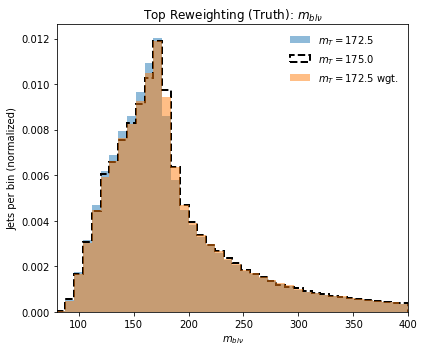

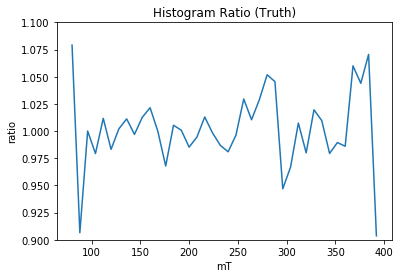

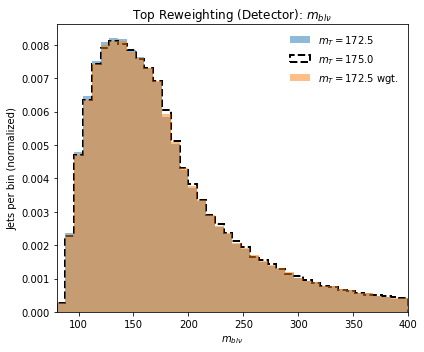

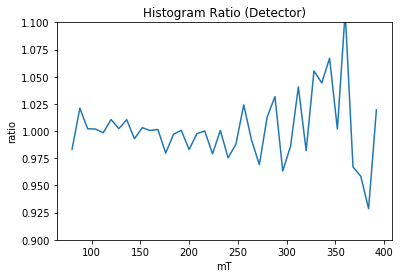

Truth Cor  0.9997348404914073
Det Cor  0.9998923420220351
theta:  176.0


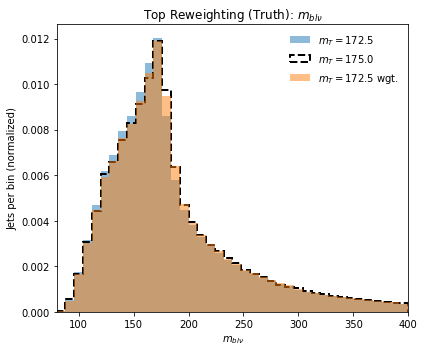

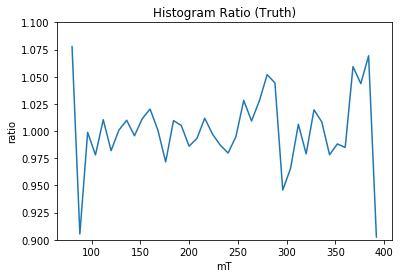

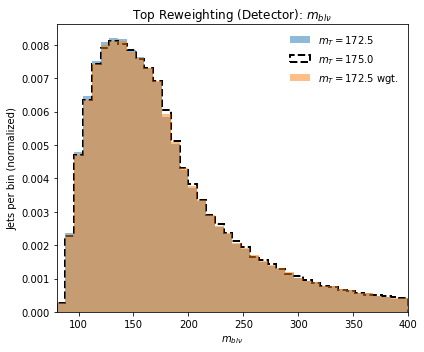

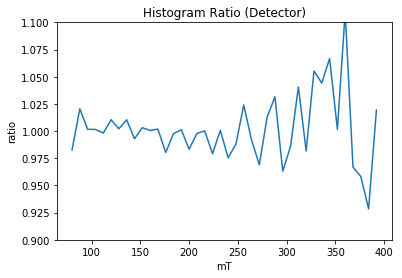

Truth Cor  0.9997682839422438
Det Cor  0.9998949347435032
theta:  176.5


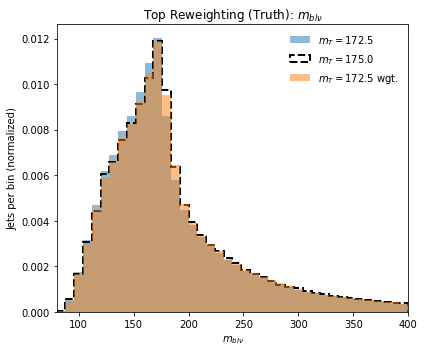

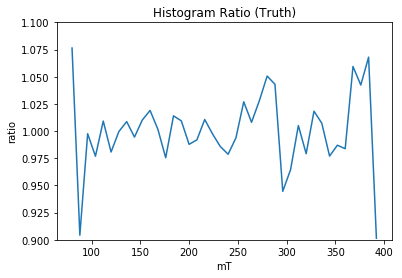

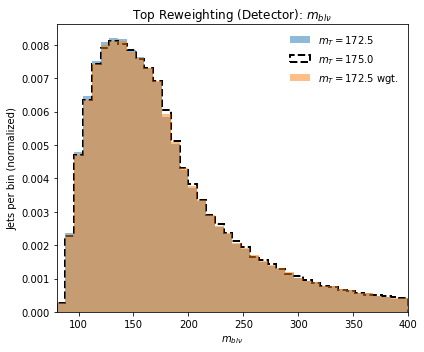

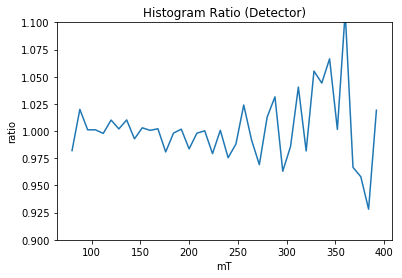

Truth Cor  0.9997939439712752
Det Cor  0.9998974839134646
theta:  177.0


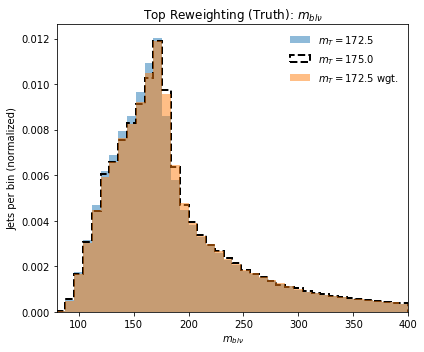

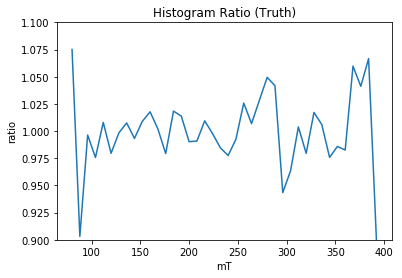

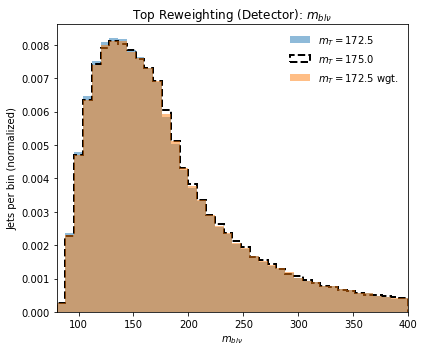

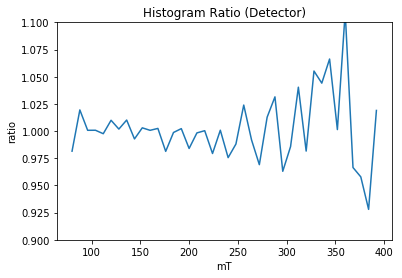

Truth Cor  0.9998117691827261
Det Cor  0.999899769285181
theta:  177.5


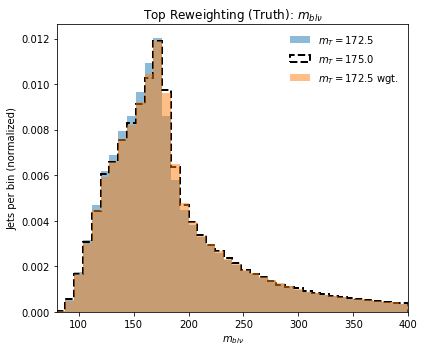

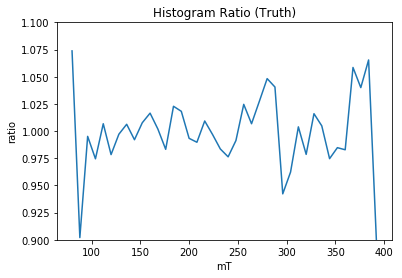

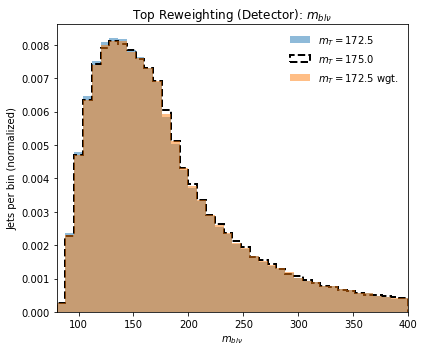

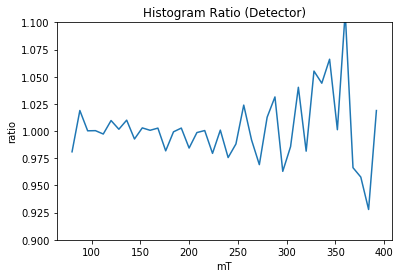

Truth Cor  0.9998214462982379
Det Cor  0.9999018867974213
theta:  178.0


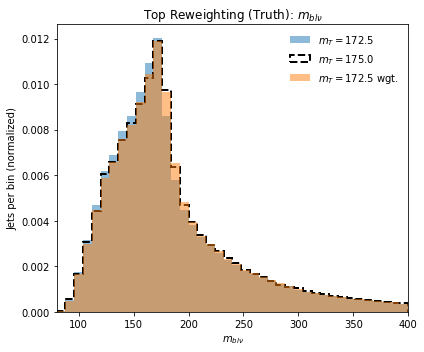

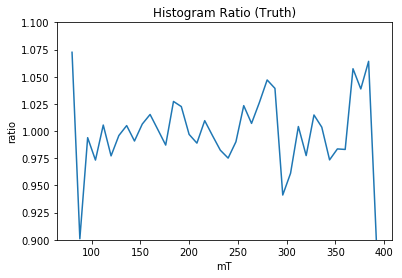

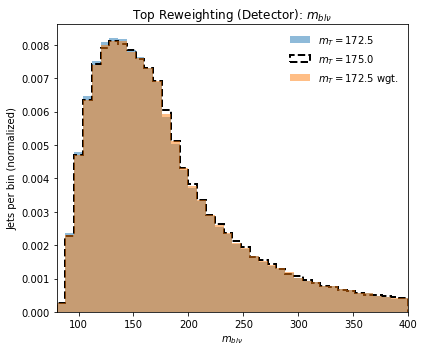

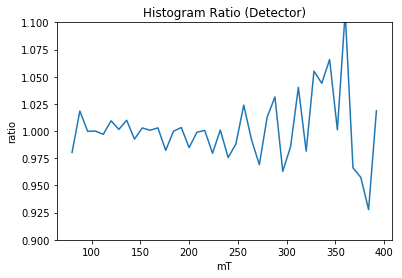

Truth Cor  0.9998227405608985
Det Cor  0.9999037905497428
theta:  178.5


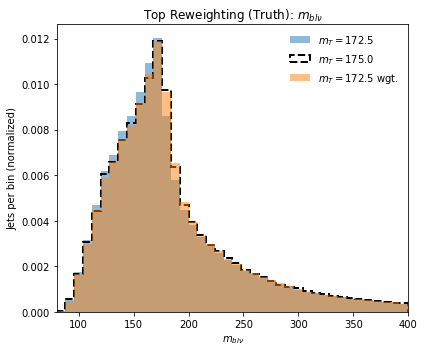

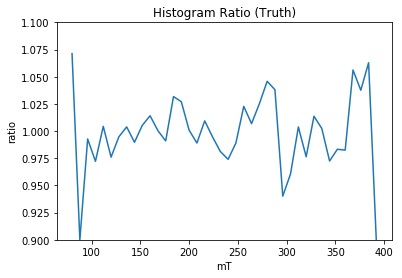

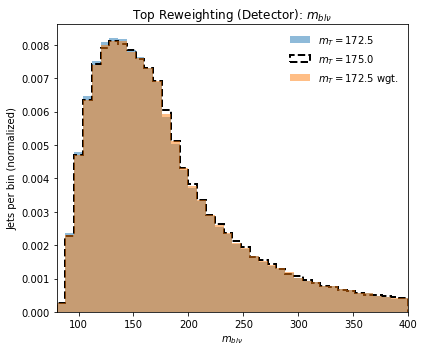

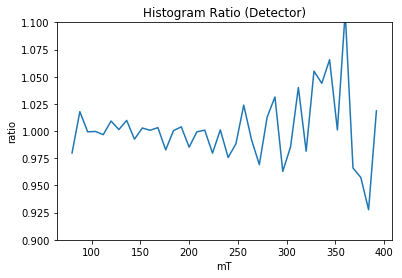

Truth Cor  0.9998150132247233
Det Cor  0.9999055551198592
theta:  179.0


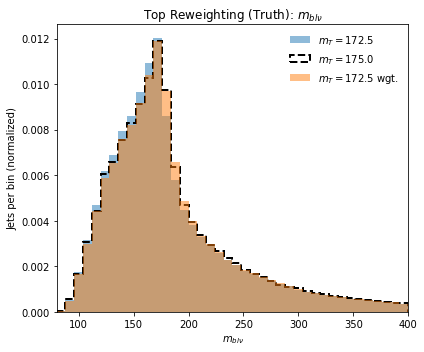

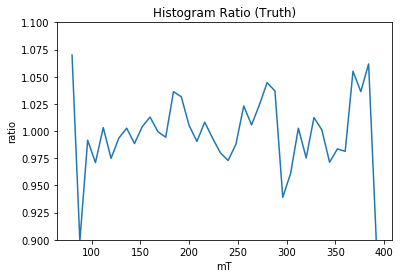

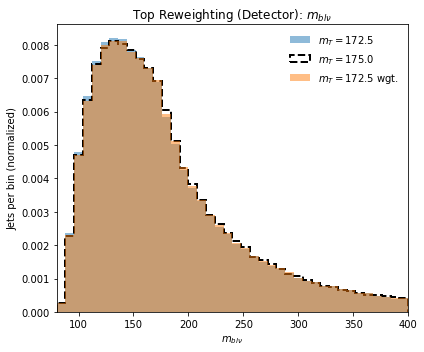

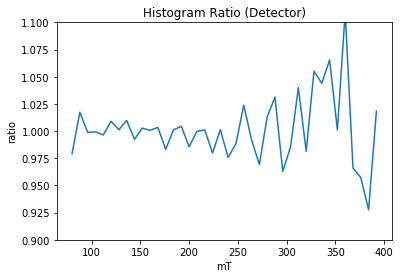

Truth Cor  0.9997979872969057
Det Cor  0.9999071737955876
theta:  179.5


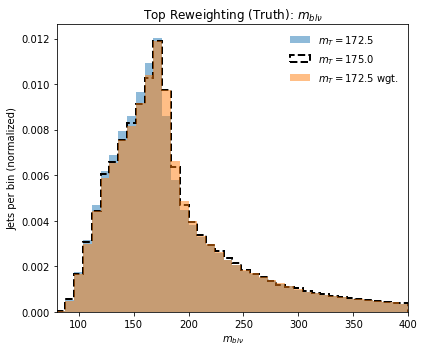

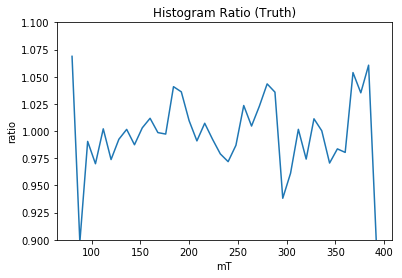

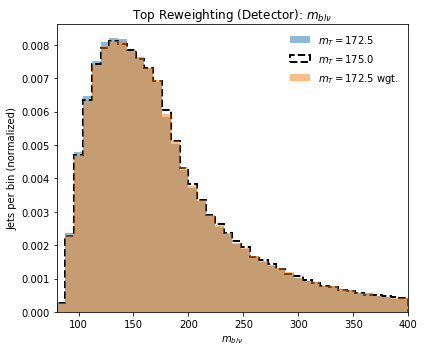

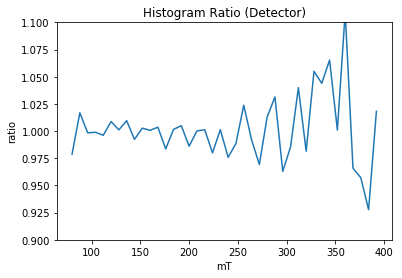

Truth Cor  0.9997718037526708
Det Cor  0.9999084691857371
theta:  180.0


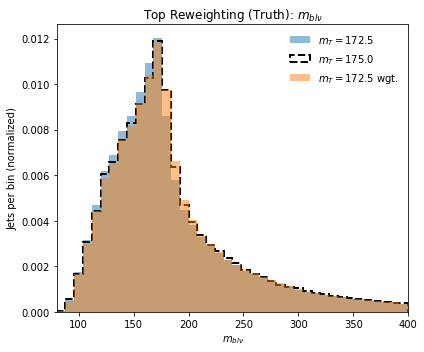

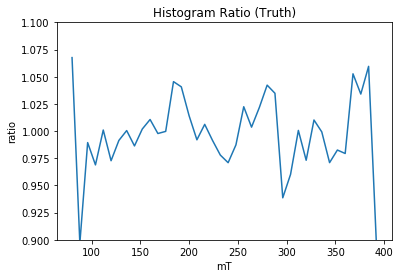

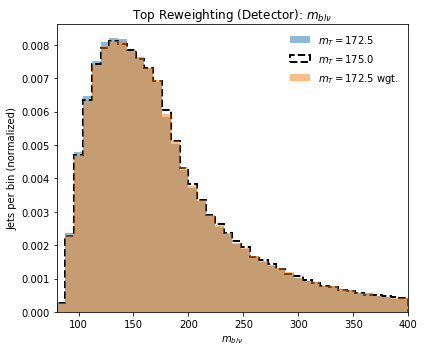

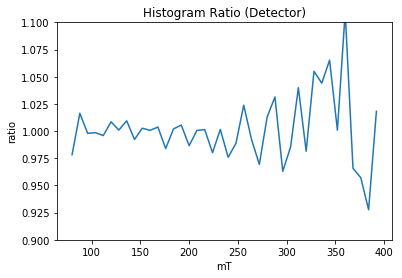

Truth Cor  0.9997382982516986
Det Cor  0.9999096180087151


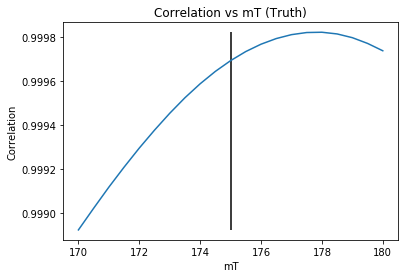

178.0


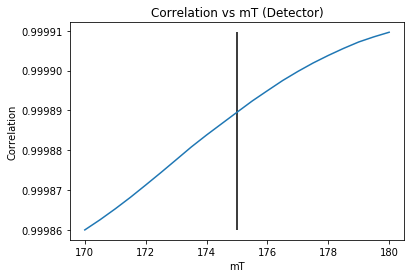

180.0
Weight Iteration:  8
theta:  170.0


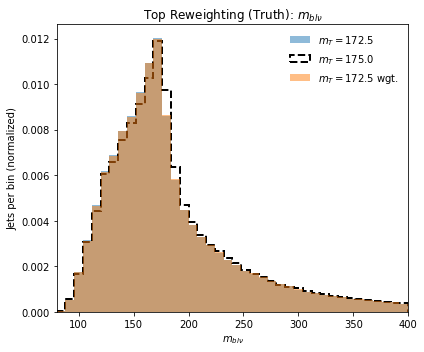

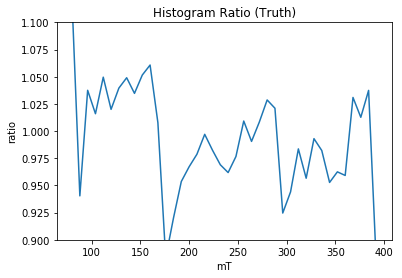

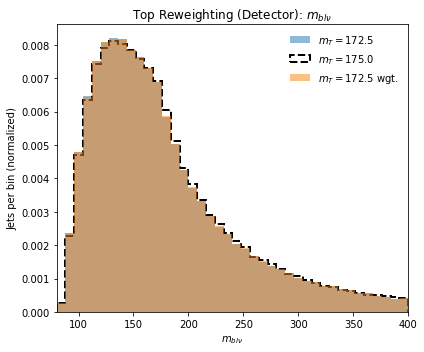

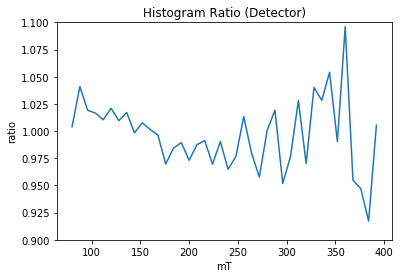

Truth Cor  0.9968873598394591
Det Cor  0.9997342781577243
theta:  170.5


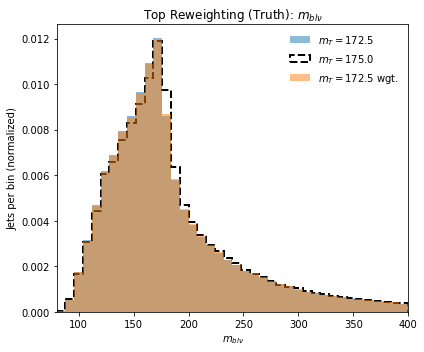

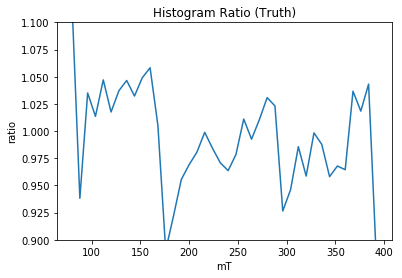

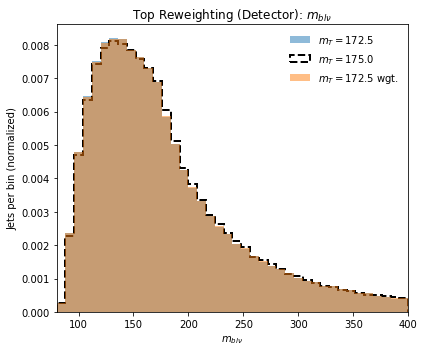

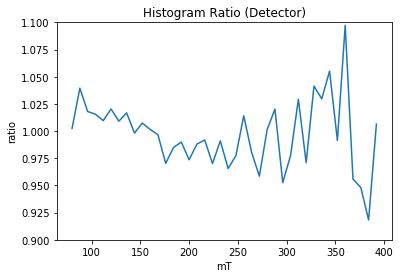

Truth Cor  0.9971937634293991
Det Cor  0.9997484739167201
theta:  171.0


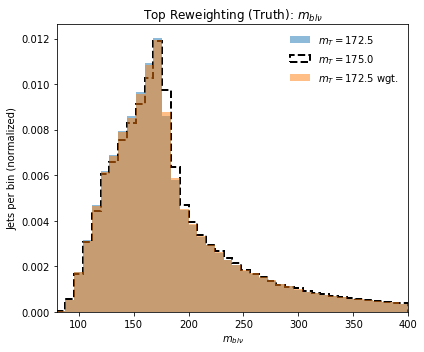

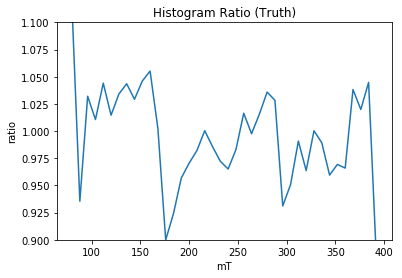

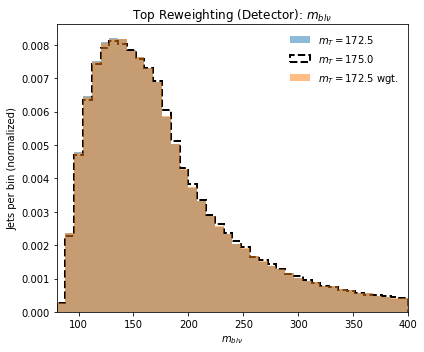

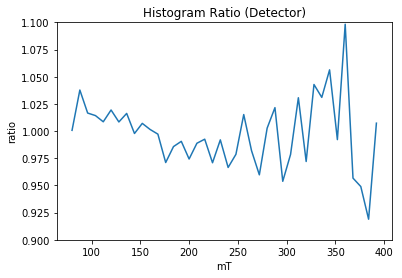

Truth Cor  0.997563890280234
Det Cor  0.9997657985262567
theta:  171.5


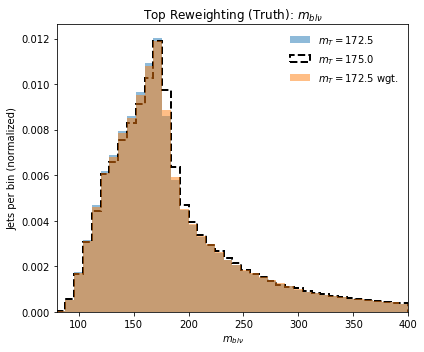

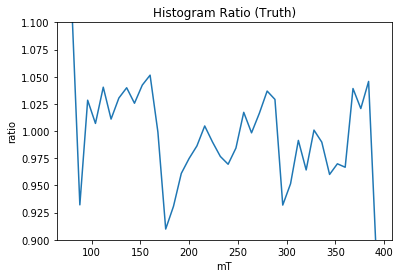

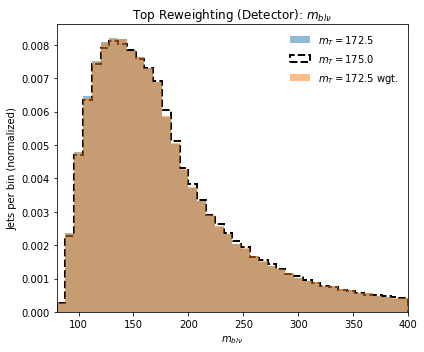

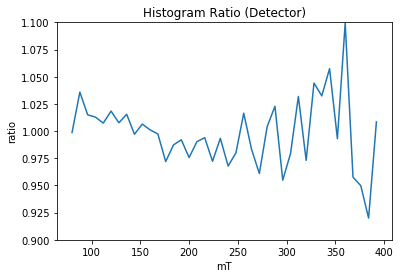

Truth Cor  0.9979836259010759
Det Cor  0.9997871024797237
theta:  172.0


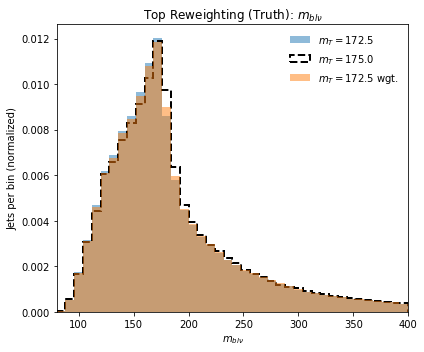

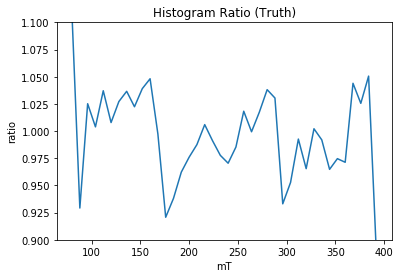

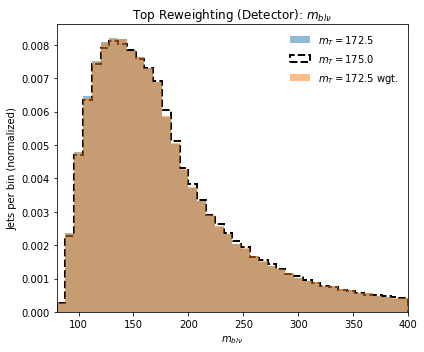

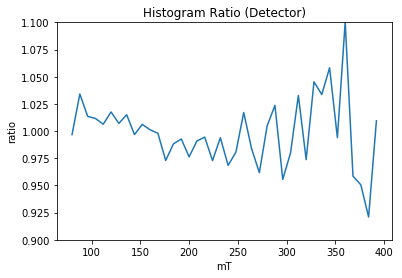

Truth Cor  0.9983579789866172
Det Cor  0.9998027975098801
theta:  172.5


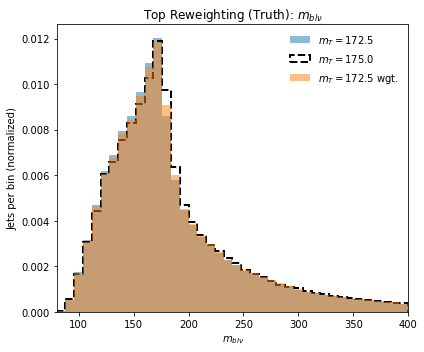

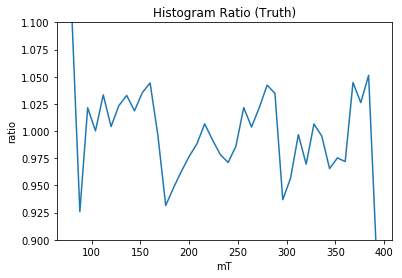

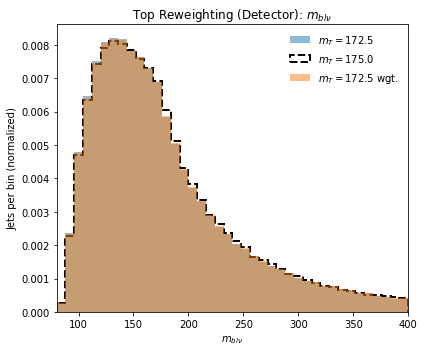

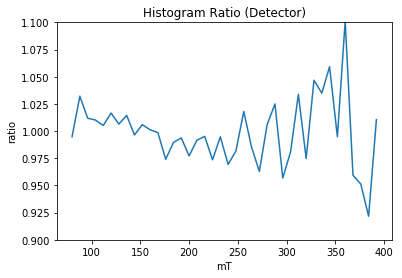

Truth Cor  0.9987130550977559
Det Cor  0.9998202691210353
theta:  173.0


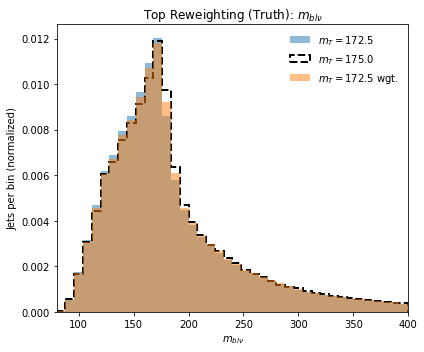

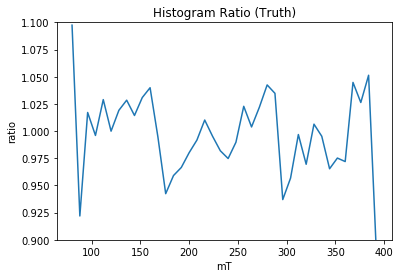

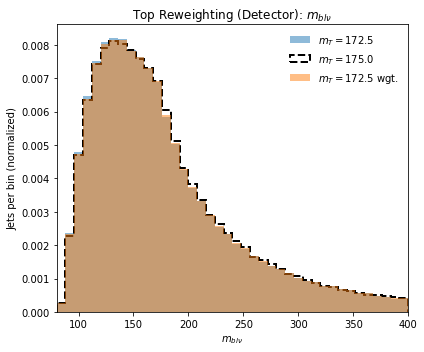

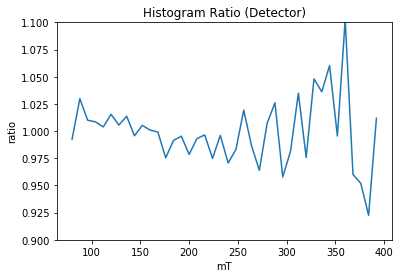

Truth Cor  0.9990540750433116
Det Cor  0.9998402516651838
theta:  173.5


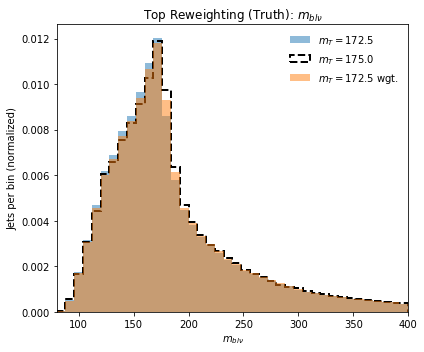

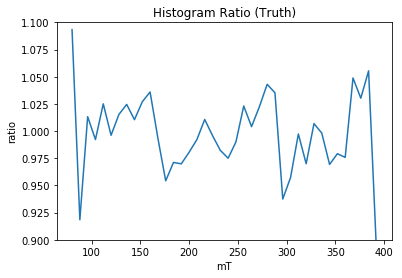

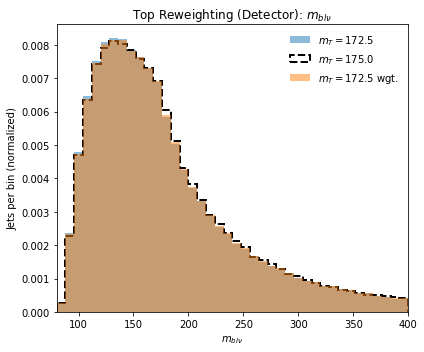

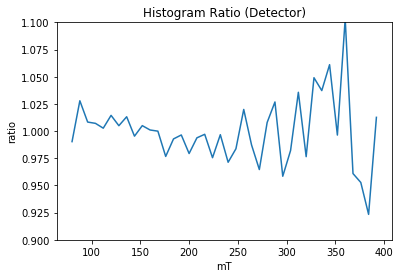

Truth Cor  0.9993336671021539
Det Cor  0.9998544182841046
theta:  174.0


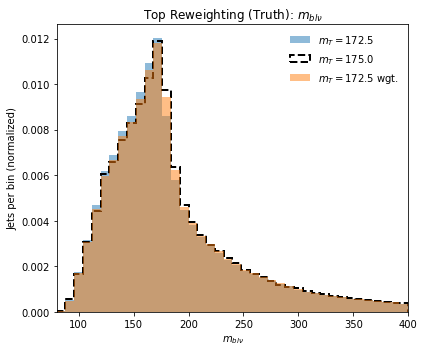

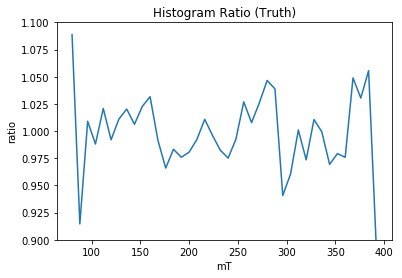

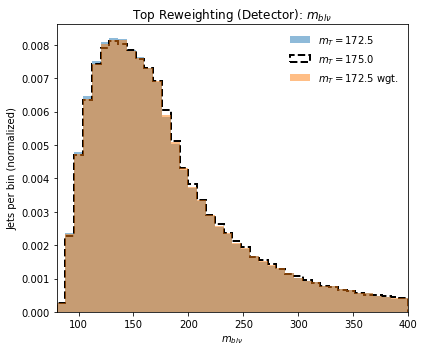

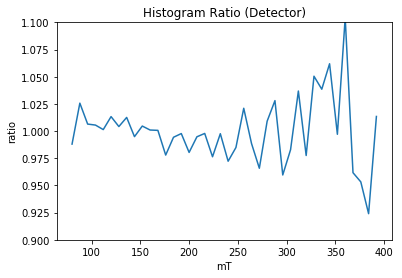

Truth Cor  0.9995549499224585
Det Cor  0.9998687285058031
theta:  174.5


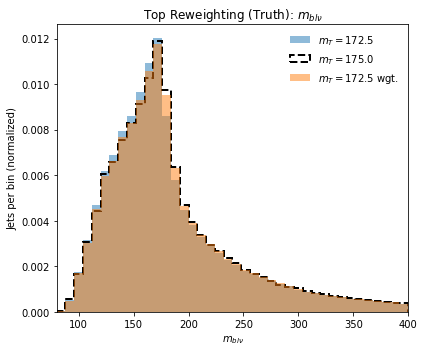

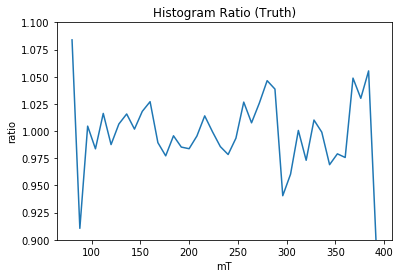

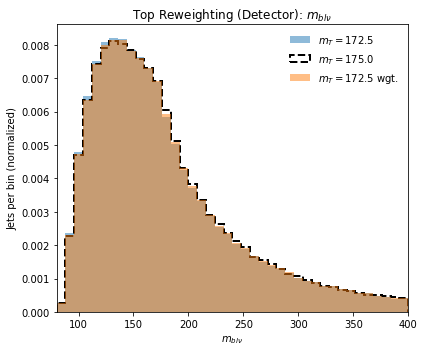

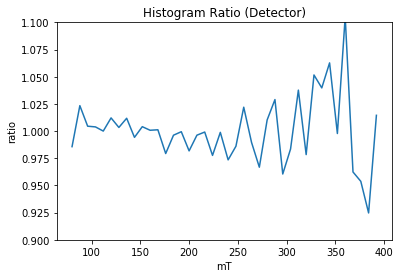

Truth Cor  0.9997157710142929
Det Cor  0.9998827895549924
theta:  175.0


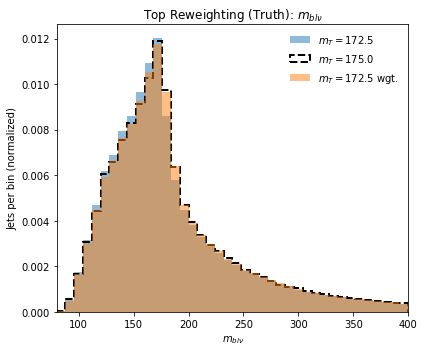

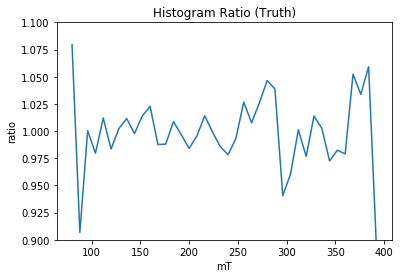

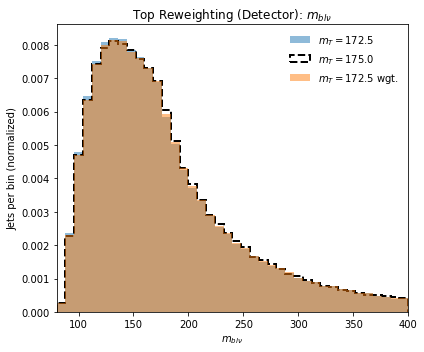

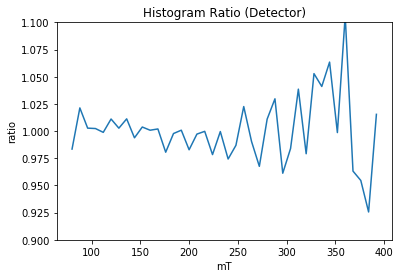

Truth Cor  0.9998008187758766
Det Cor  0.9998924252351696
theta:  175.5


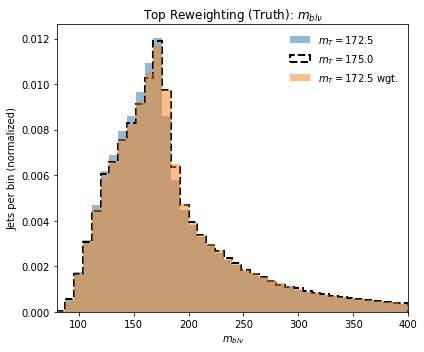

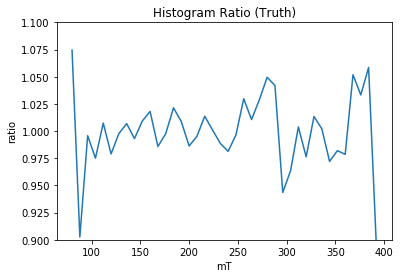

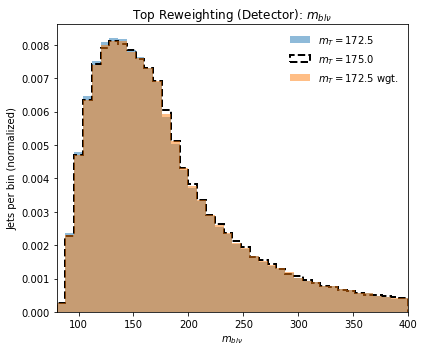

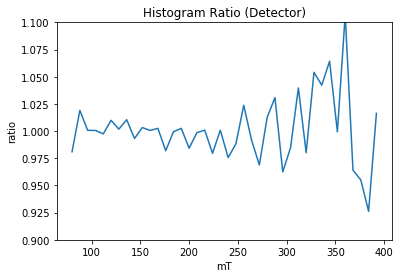

Truth Cor  0.999817665186689
Det Cor  0.9999019592629573
theta:  176.0


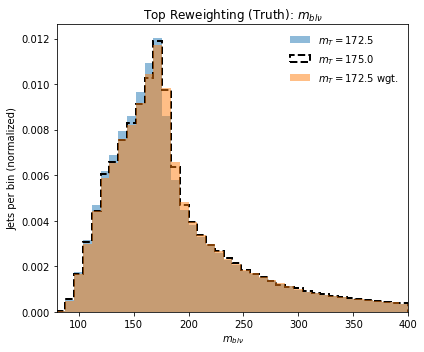

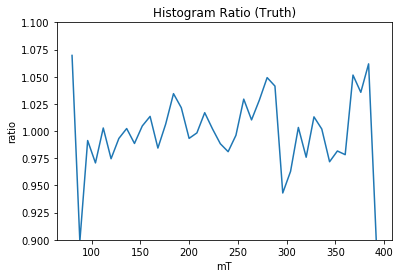

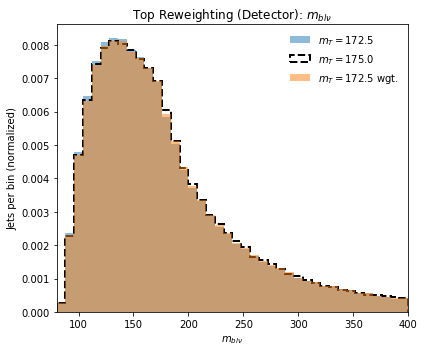

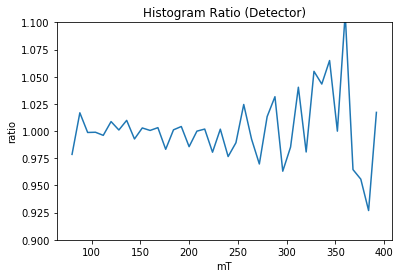

Truth Cor  0.9997689639028435
Det Cor  0.9999086037703891
theta:  176.5


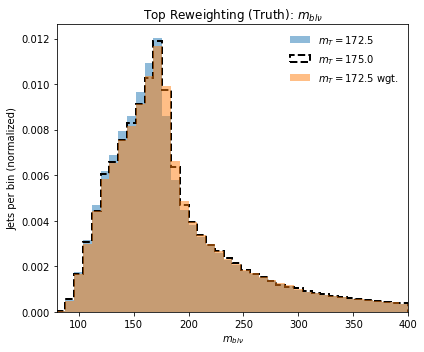

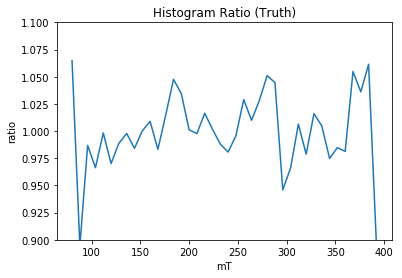

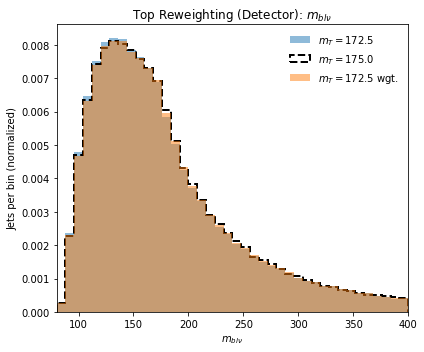

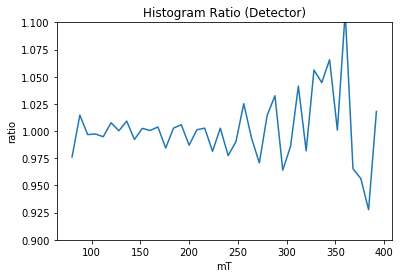

Truth Cor  0.9996568974865666
Det Cor  0.9999124852992809
theta:  177.0


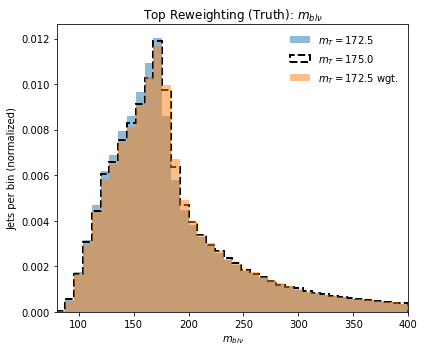

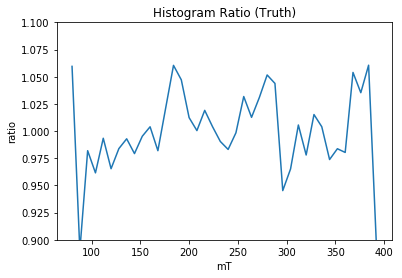

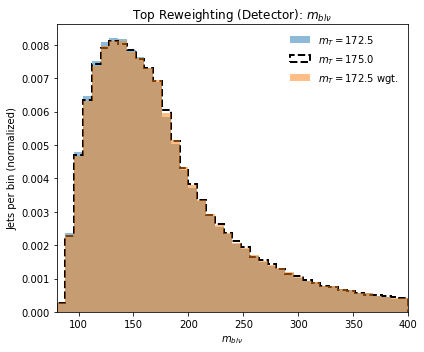

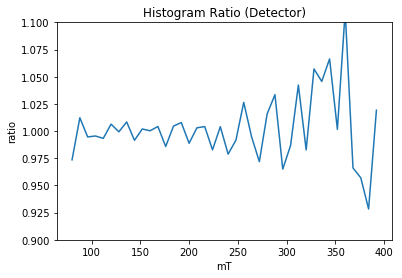

Truth Cor  0.9994819610796385
Det Cor  0.999915006480966
theta:  177.5


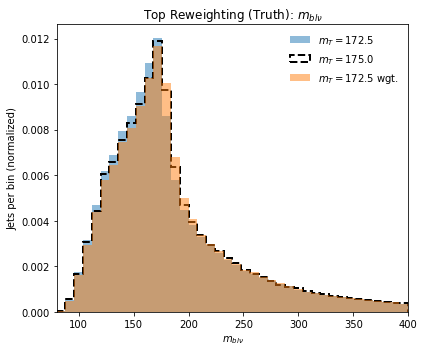

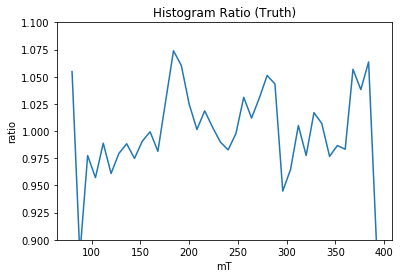

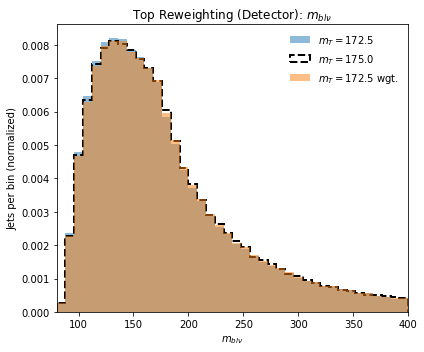

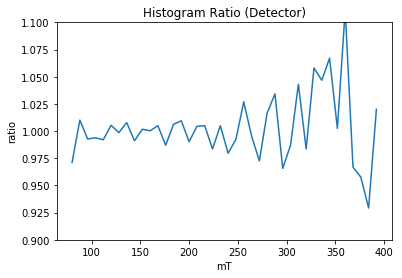

Truth Cor  0.9992463491827726
Det Cor  0.9999140847185377
theta:  178.0


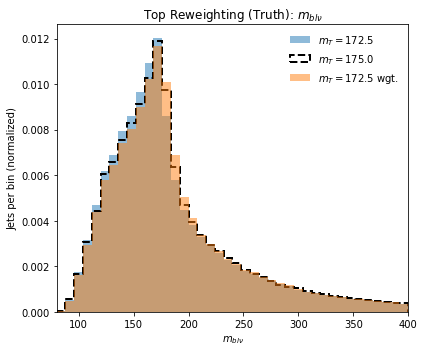

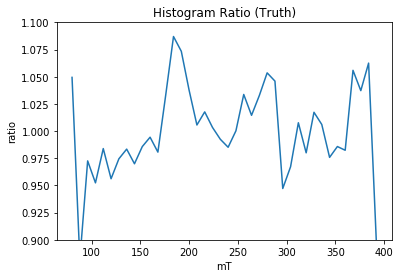

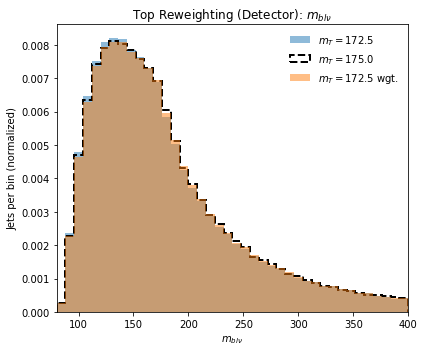

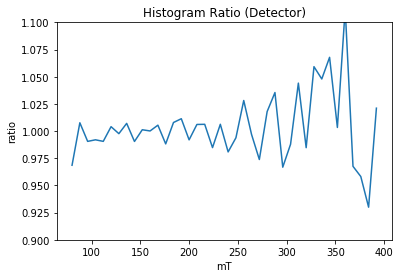

Truth Cor  0.9989517704051801
Det Cor  0.999911113056736
theta:  178.5


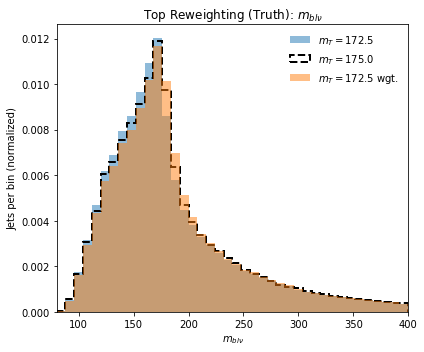

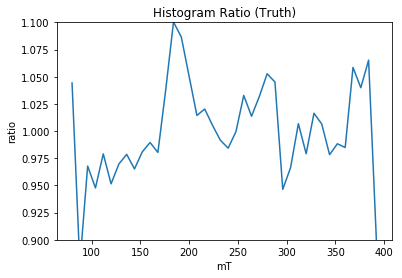

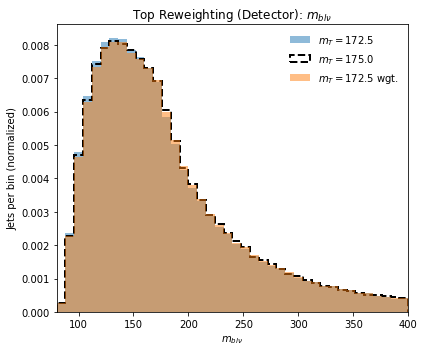

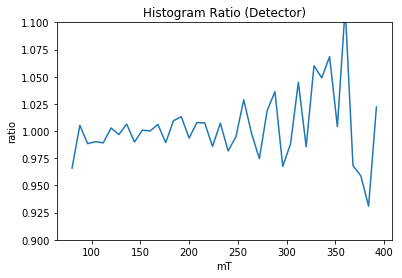

Truth Cor  0.9985958270605195
Det Cor  0.9999053688385869
theta:  179.0


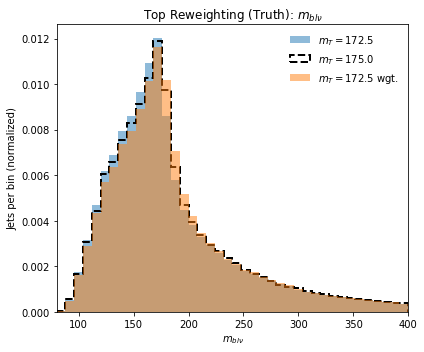

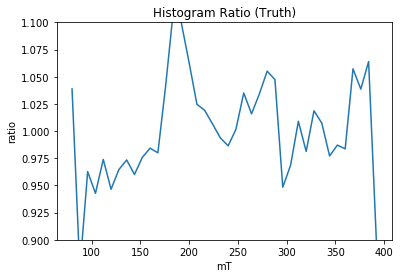

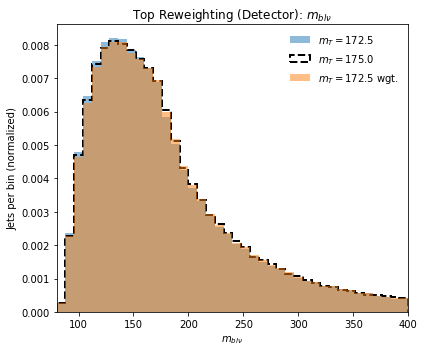

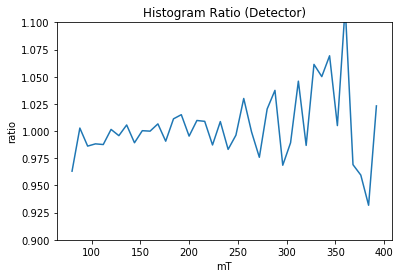

Truth Cor  0.9981865234778372
Det Cor  0.9998967144038399
theta:  179.5


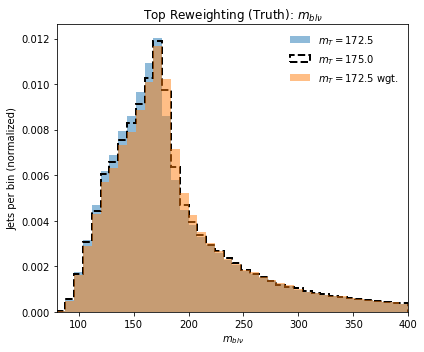

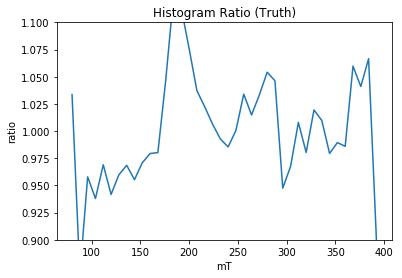

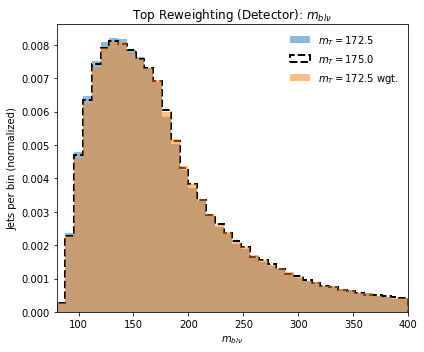

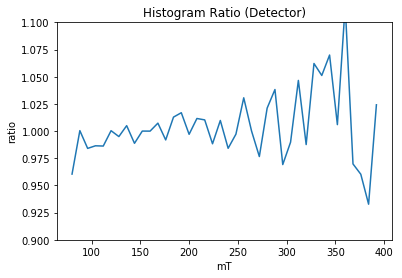

Truth Cor  0.9977198145050792
Det Cor  0.9998855797024843
theta:  180.0


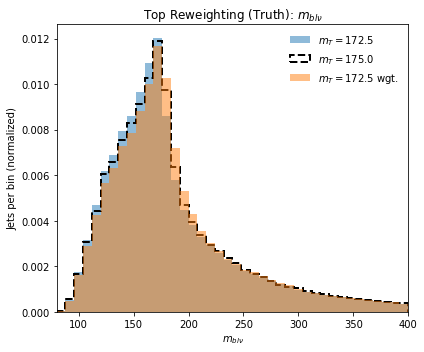

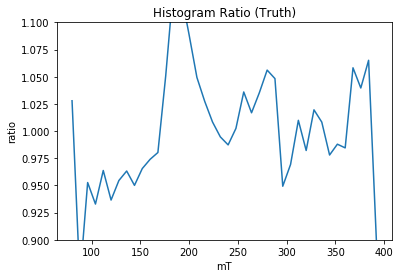

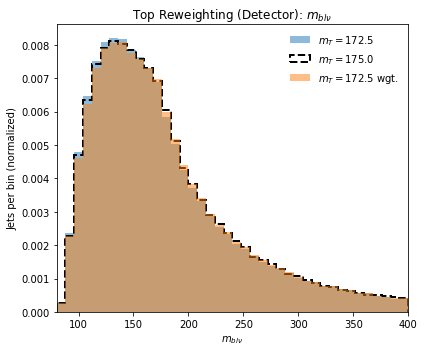

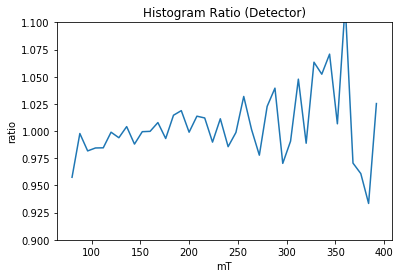

Truth Cor  0.9972003680865941
Det Cor  0.9998705298286408


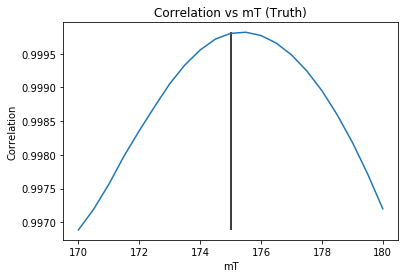

175.5


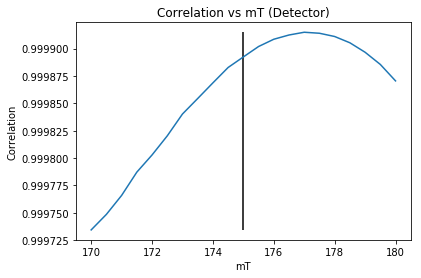

177.0
Weight Iteration:  9
theta:  170.0


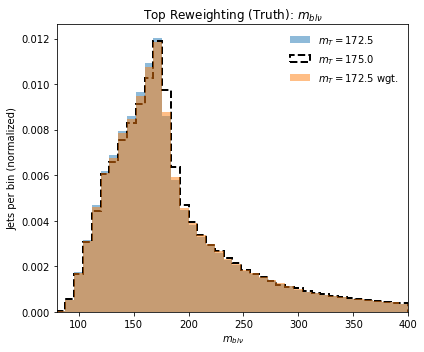

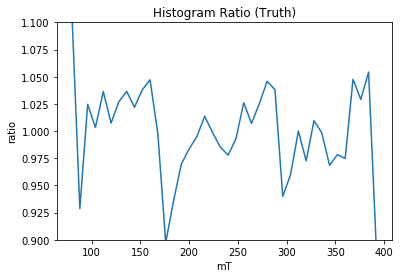

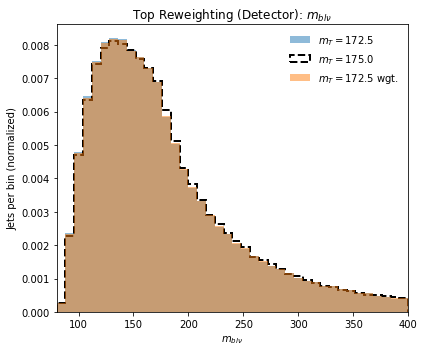

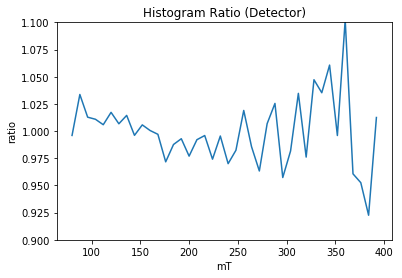

Truth Cor  0.9978658054038607
Det Cor  0.9998027826985655
theta:  170.5


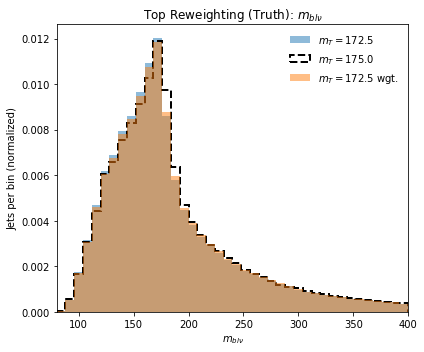

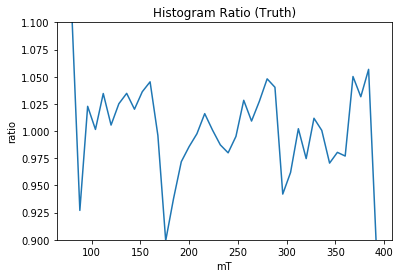

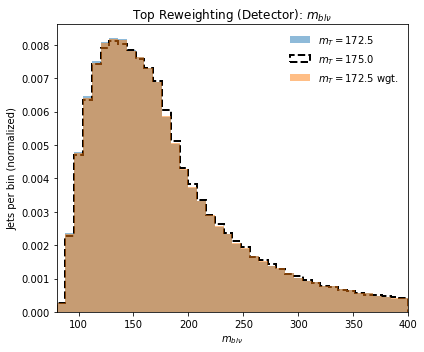

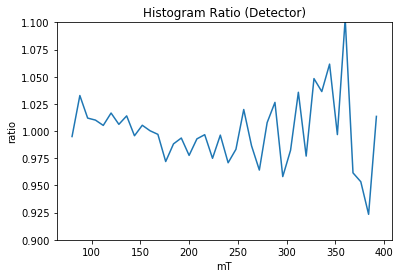

Truth Cor  0.9979814781026981
Det Cor  0.9998117290934624
theta:  171.0


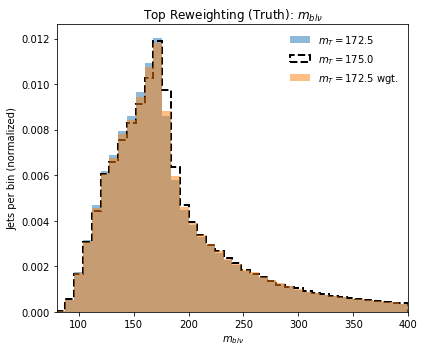

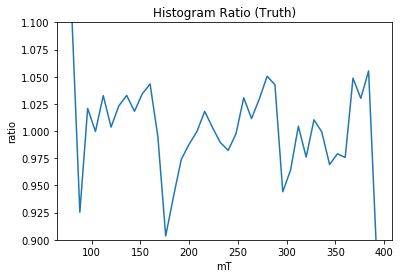

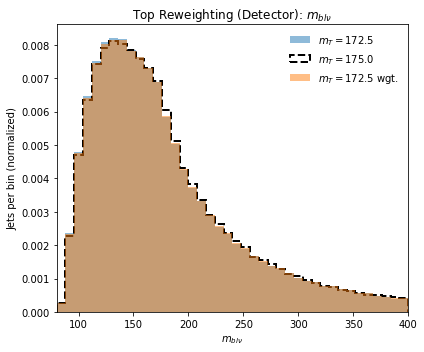

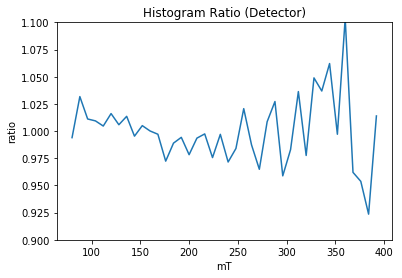

Truth Cor  0.9981541019384705
Det Cor  0.9998202663932345
theta:  171.5


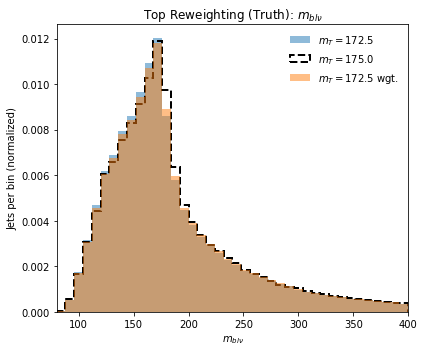

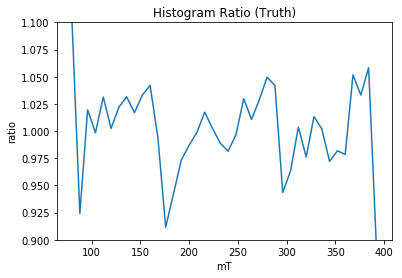

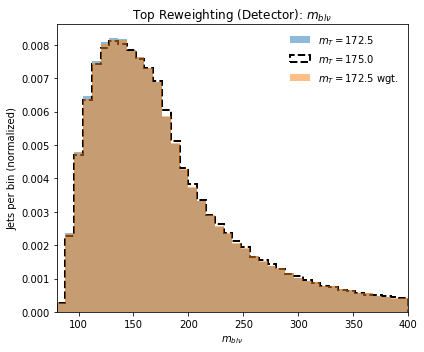

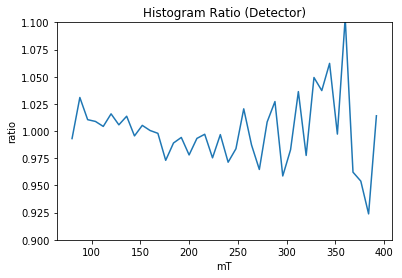

Truth Cor  0.9983784392389509
Det Cor  0.9998253140319937
theta:  172.0


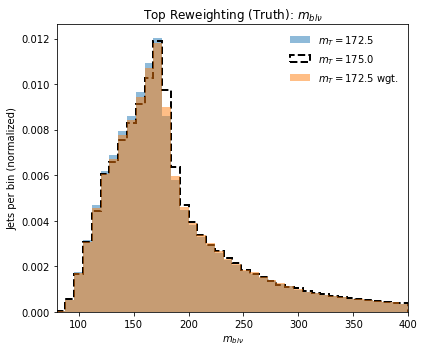

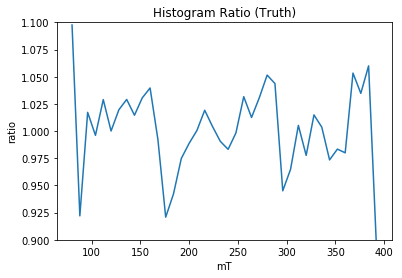

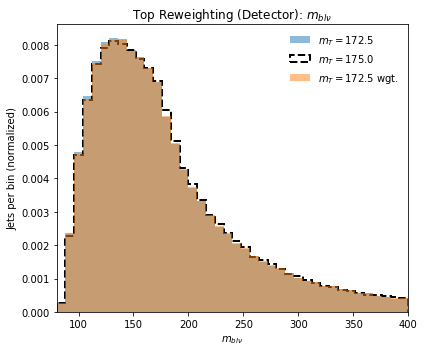

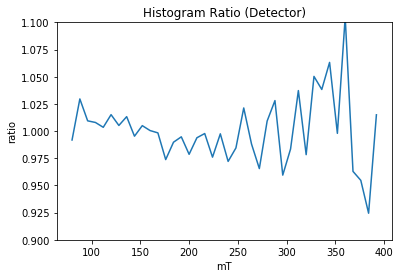

Truth Cor  0.9986220489279916
Det Cor  0.9998358417369838
theta:  172.5


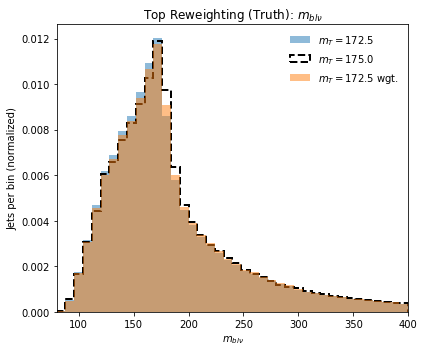

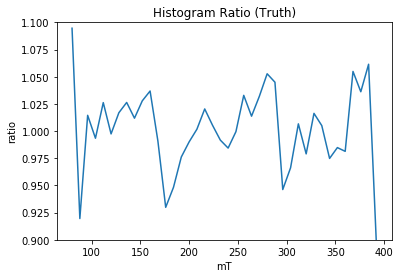

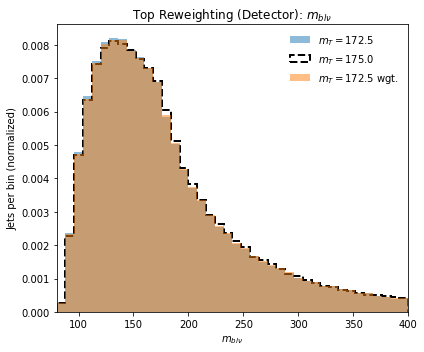

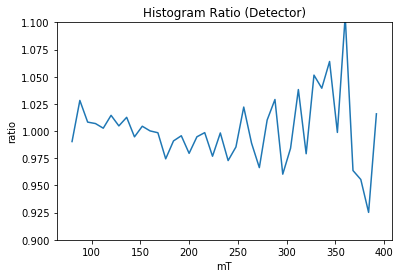

Truth Cor  0.9988786684666314
Det Cor  0.9998464602208523
theta:  173.0


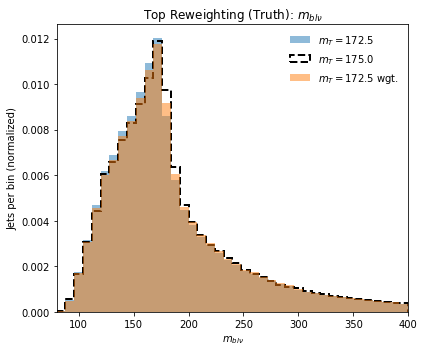

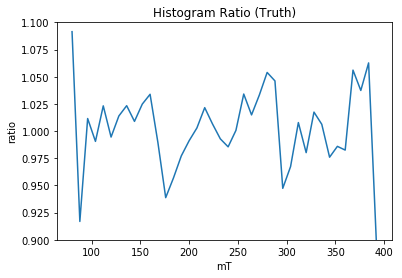

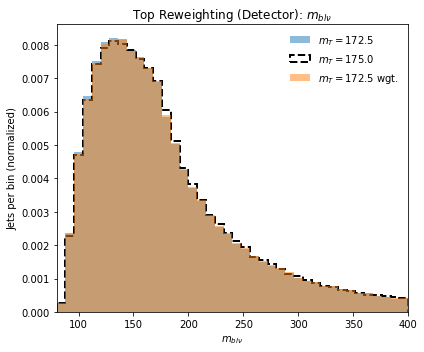

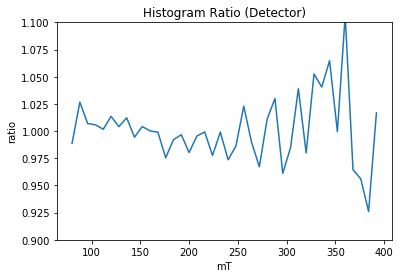

Truth Cor  0.9991182373108038
Det Cor  0.9998581260512092
theta:  173.5


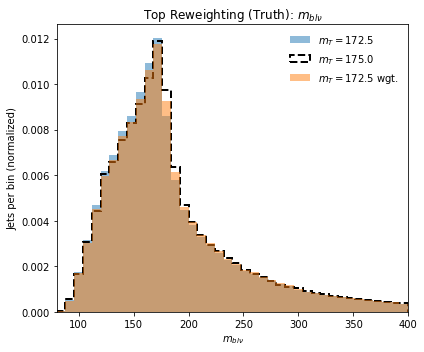

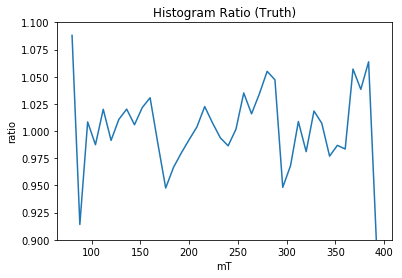

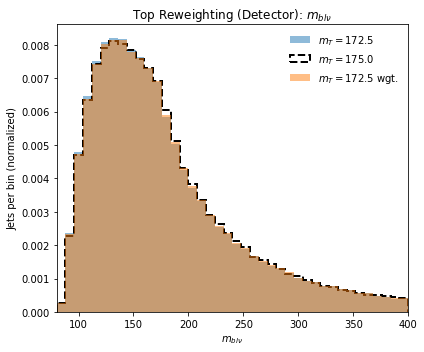

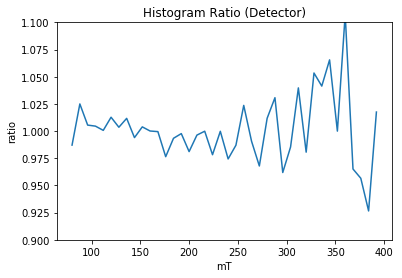

Truth Cor  0.9993312286472799
Det Cor  0.9998690084604679
theta:  174.0


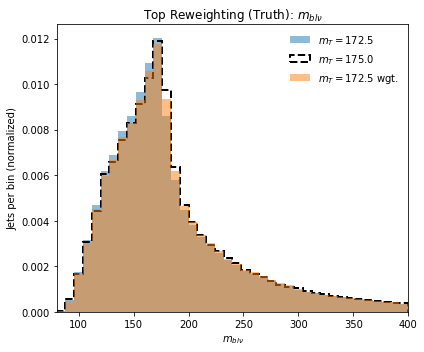

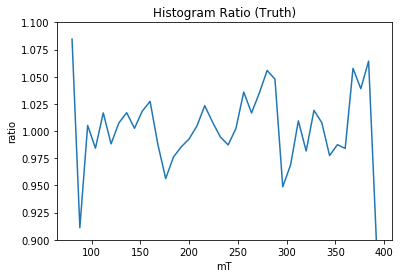

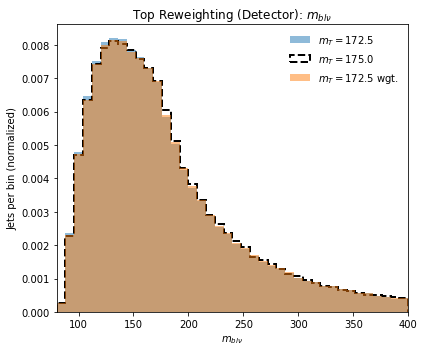

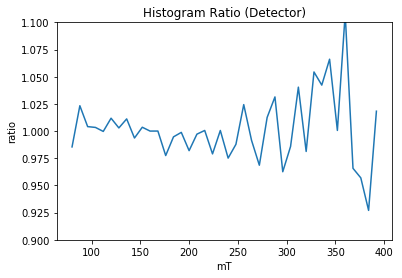

Truth Cor  0.9995096743229835
Det Cor  0.9998791470079709
theta:  174.5


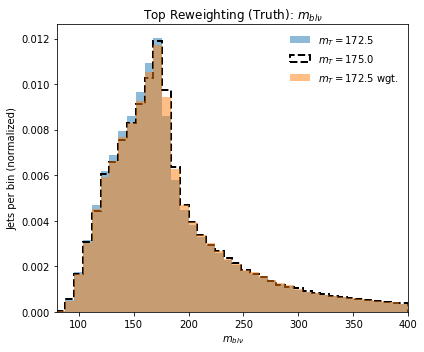

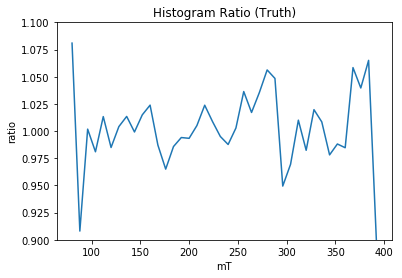

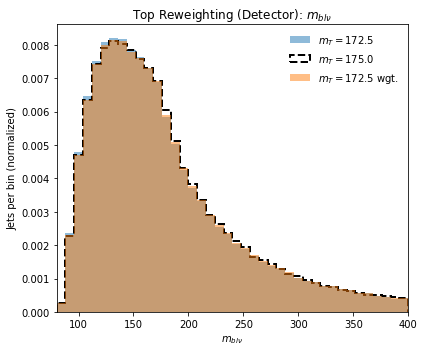

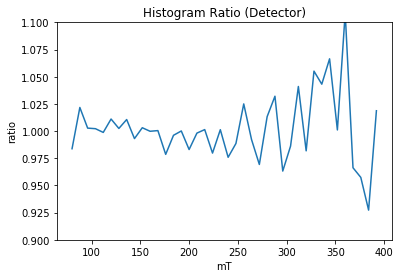

Truth Cor  0.9996519346270238
Det Cor  0.9998880031941566
theta:  175.0


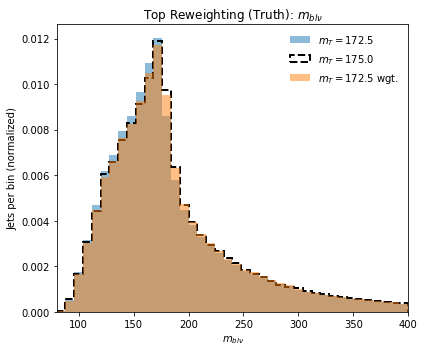

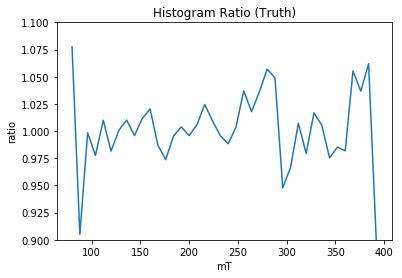

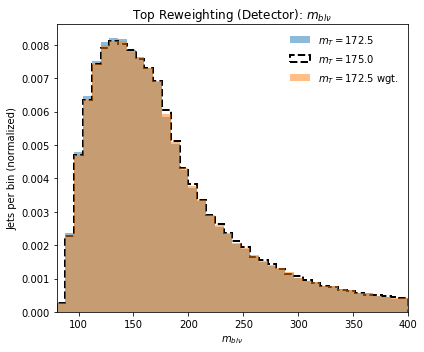

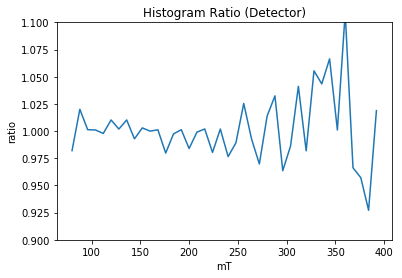

Truth Cor  0.9997521870282874
Det Cor  0.9998958770169738
theta:  175.5


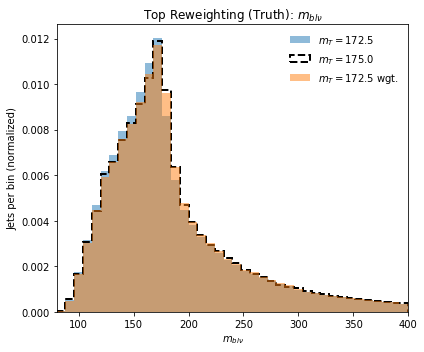

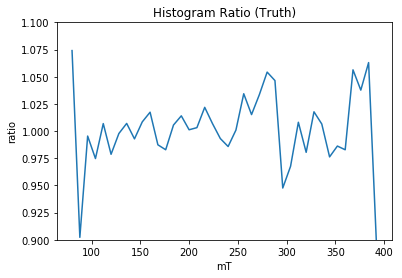

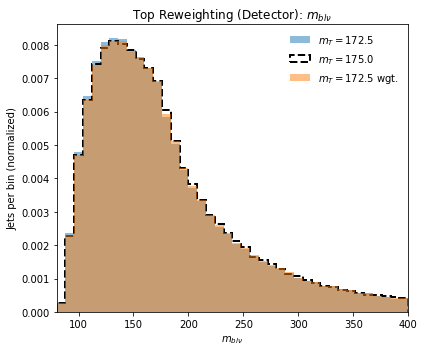

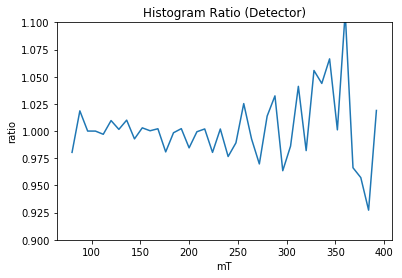

Truth Cor  0.9998133498123482
Det Cor  0.9999005555071048
theta:  176.0


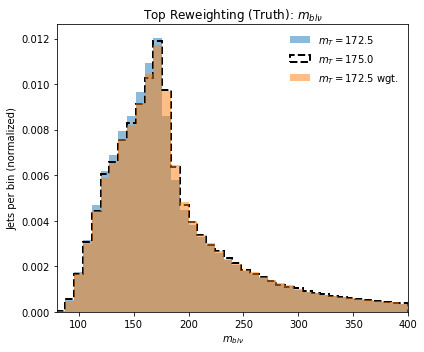

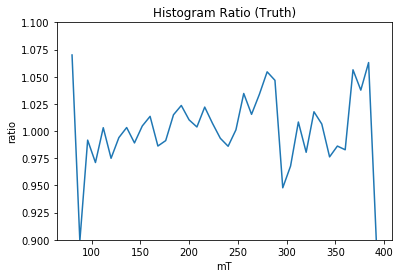

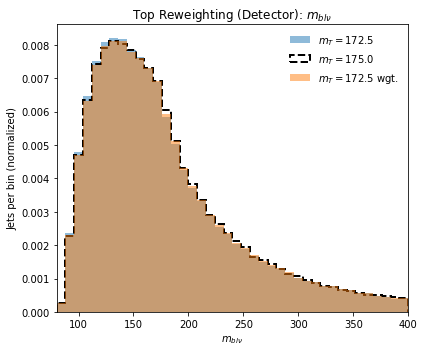

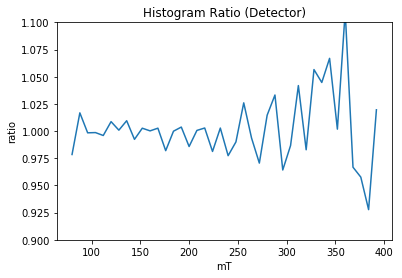

Truth Cor  0.9998197551127671
Det Cor  0.9999064245483505
theta:  176.5


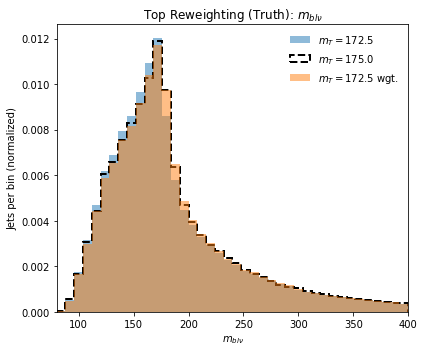

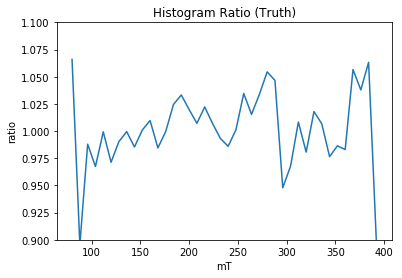

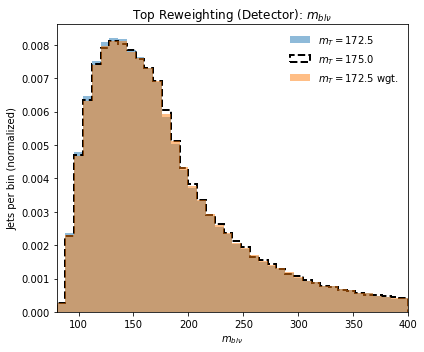

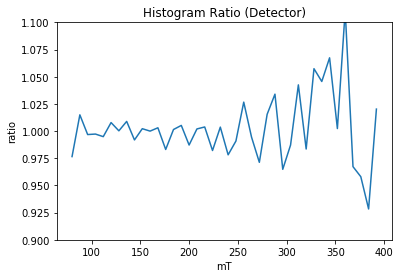

Truth Cor  0.999773695605597
Det Cor  0.999910544496639
theta:  177.0


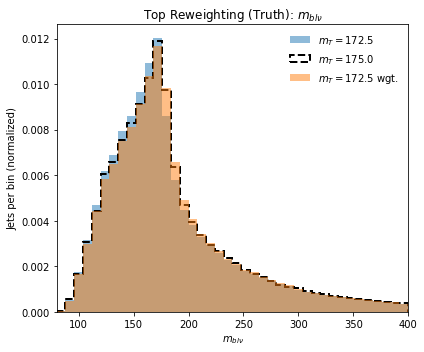

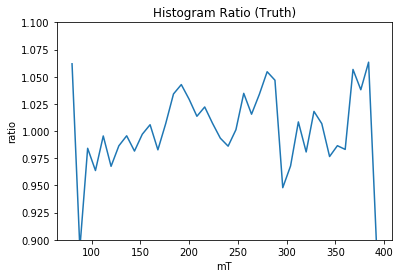

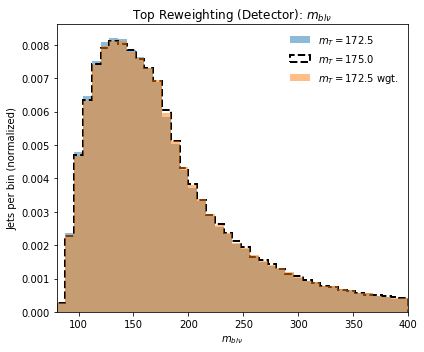

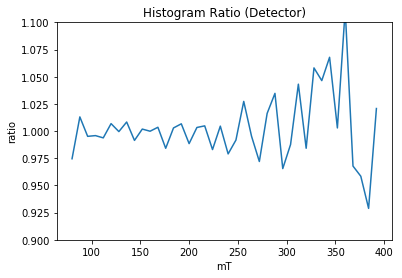

Truth Cor  0.9996784782769347
Det Cor  0.9999130613914244
theta:  177.5


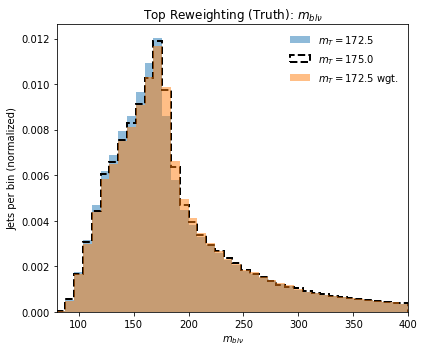

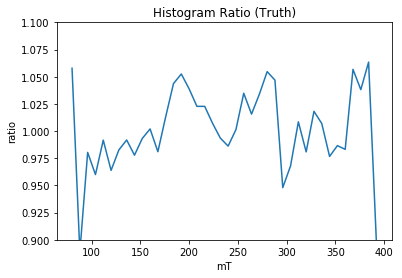

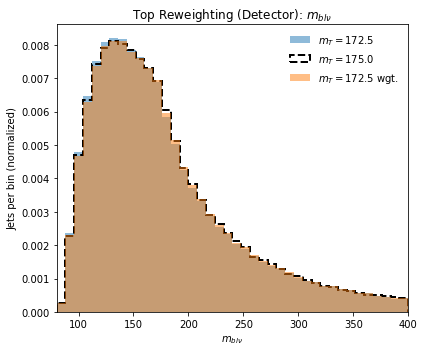

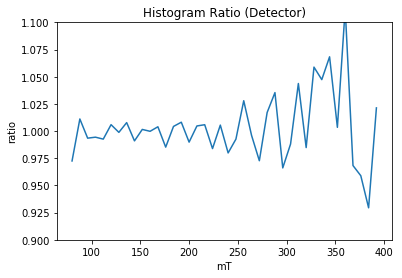

Truth Cor  0.9995371945019438
Det Cor  0.9999138656589538
theta:  178.0


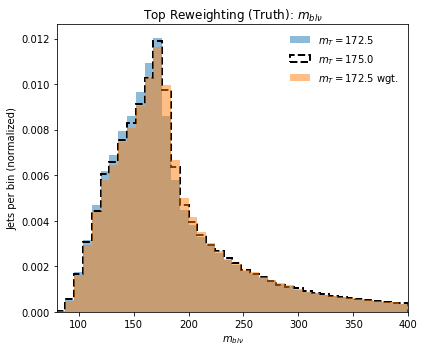

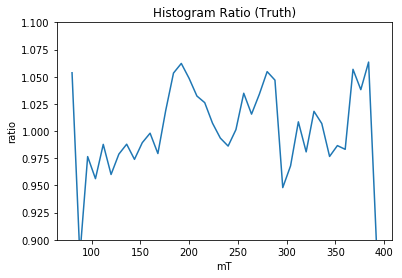

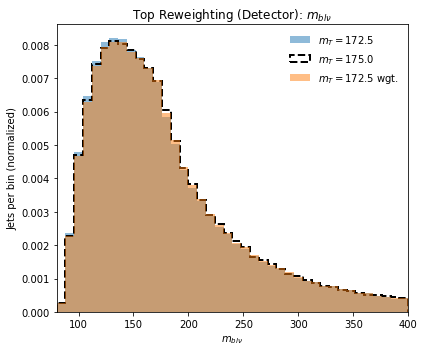

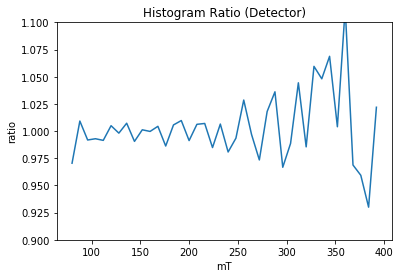

Truth Cor  0.9993512517972238
Det Cor  0.9999128700816338
theta:  178.5


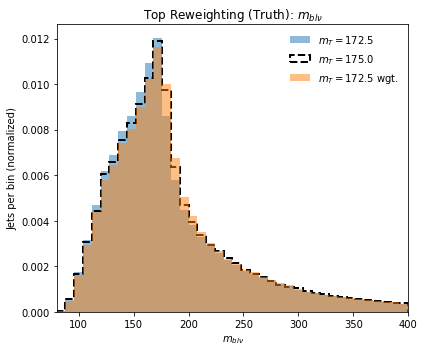

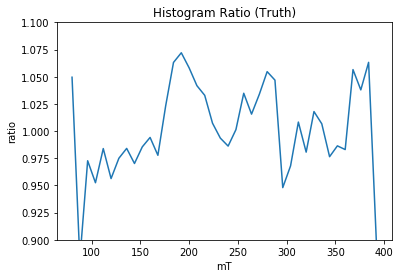

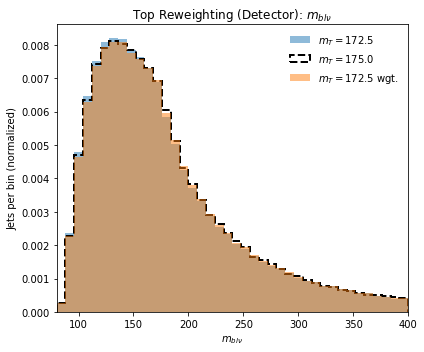

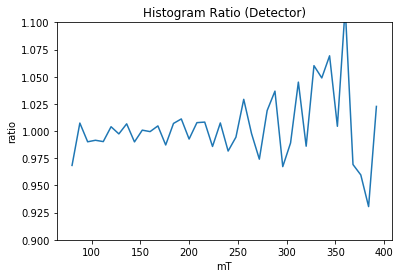

Truth Cor  0.9991254163863386
Det Cor  0.9999102061147767
theta:  179.0


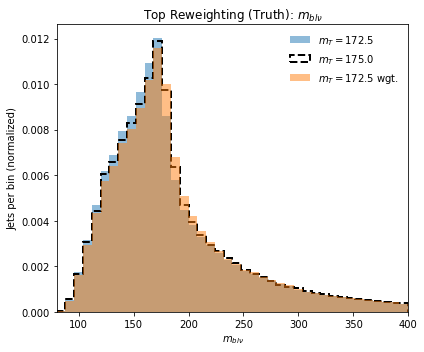

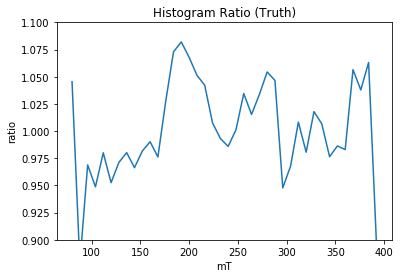

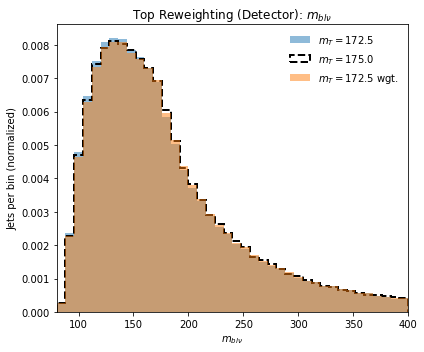

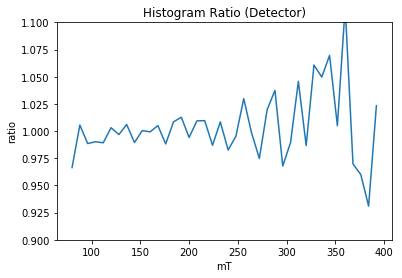

Truth Cor  0.9988583971648776
Det Cor  0.999905892596602
theta:  179.5


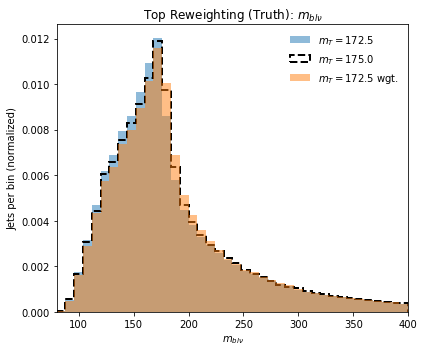

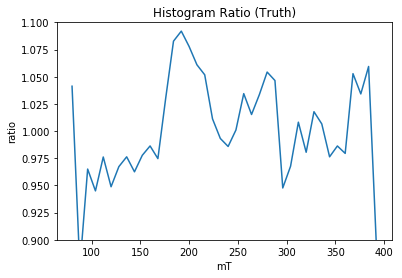

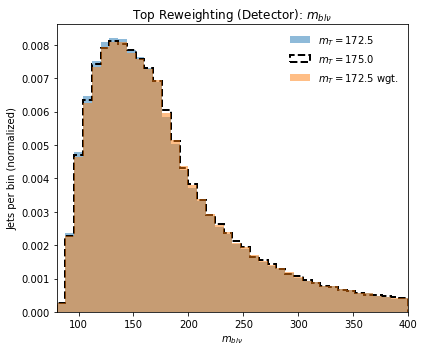

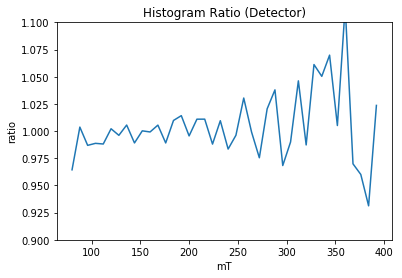

Truth Cor  0.9985540937564632
Det Cor  0.9998997716741452
theta:  180.0


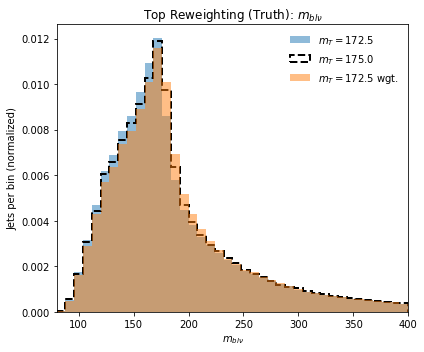

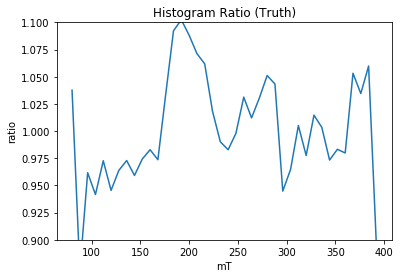

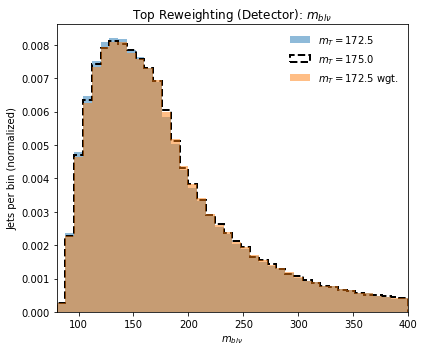

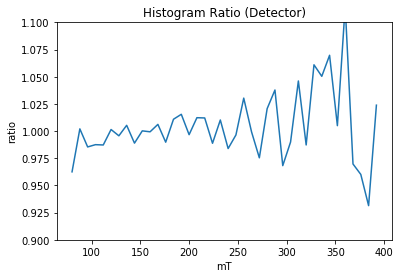

Truth Cor  0.9982138093448055
Det Cor  0.999892665550249


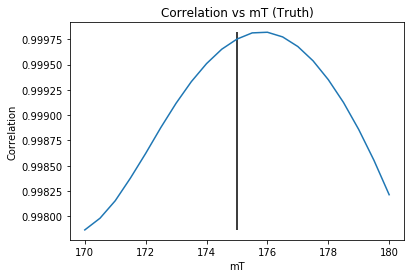

176.0


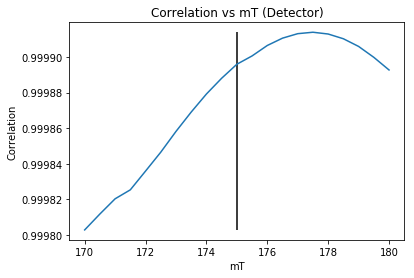

177.5
Weight Iteration:  10
theta:  170.0


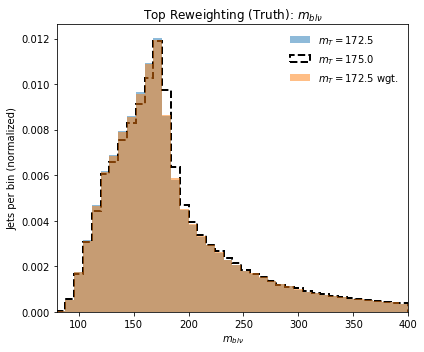

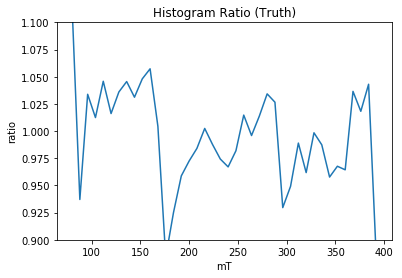

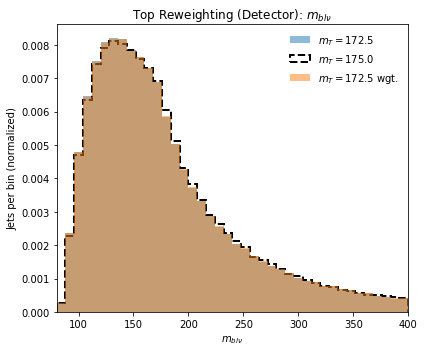

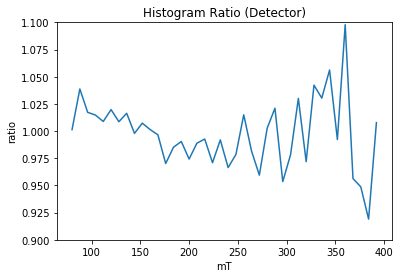

Truth Cor  0.9970905500619157
Det Cor  0.9997566752765363
theta:  170.5


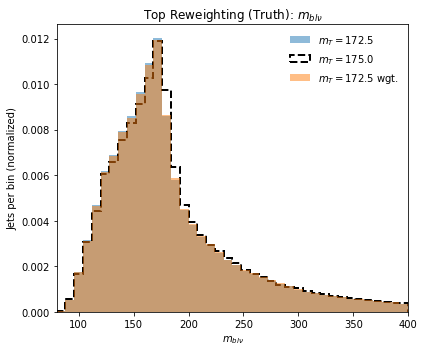

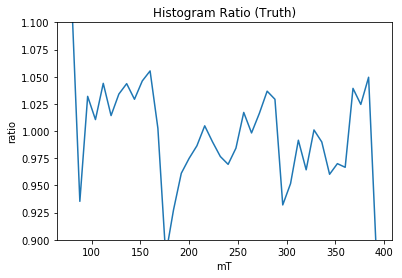

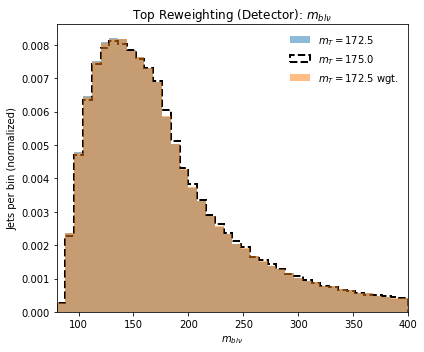

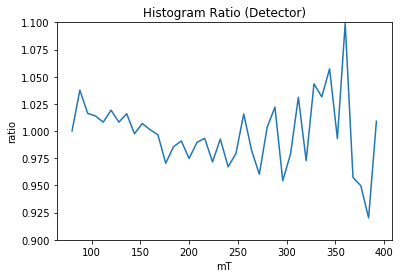

Truth Cor  0.9972307818996129
Det Cor  0.9997664991659161
theta:  171.0


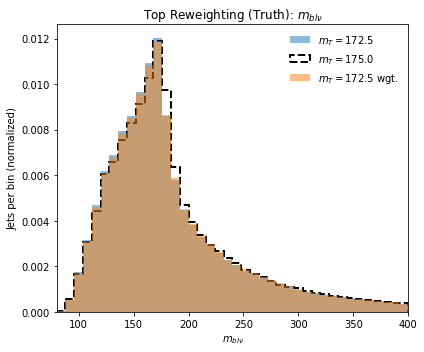

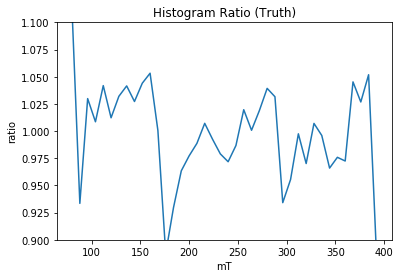

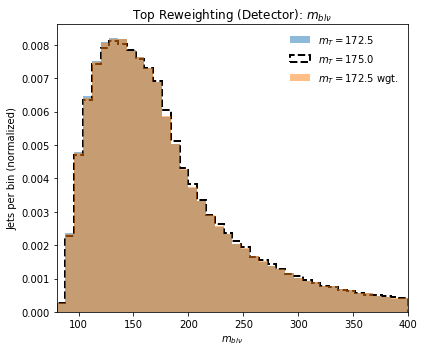

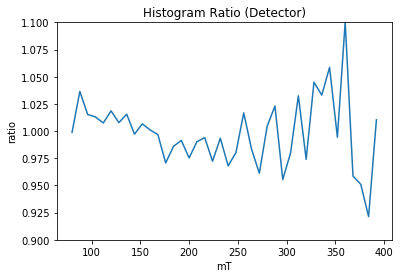

Truth Cor  0.9973723247450383
Det Cor  0.9997768139013434
theta:  171.5


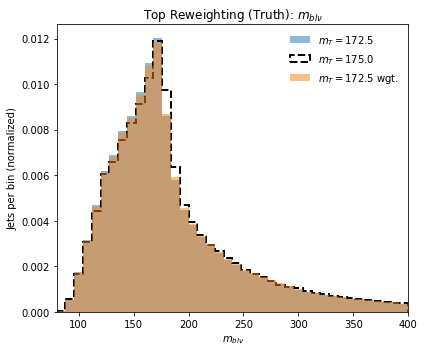

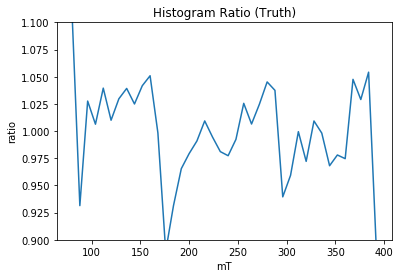

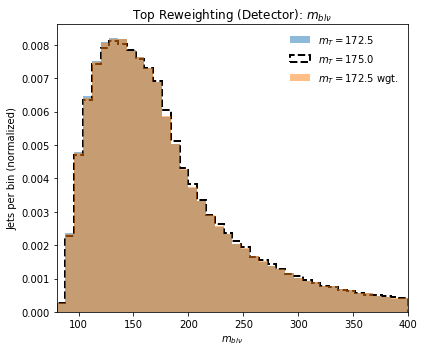

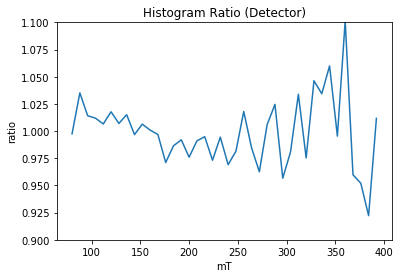

Truth Cor  0.9975187817803869
Det Cor  0.9997894791069062
theta:  172.0


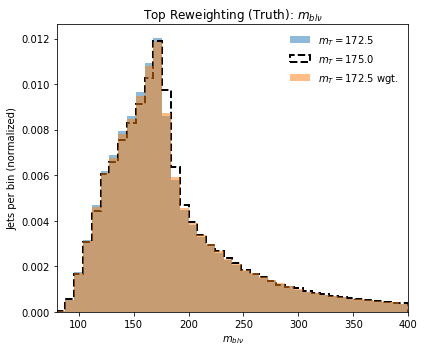

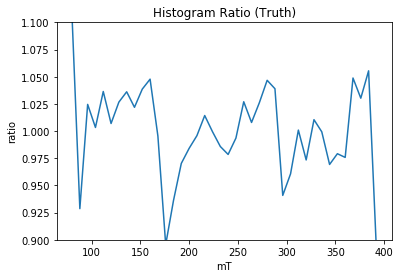

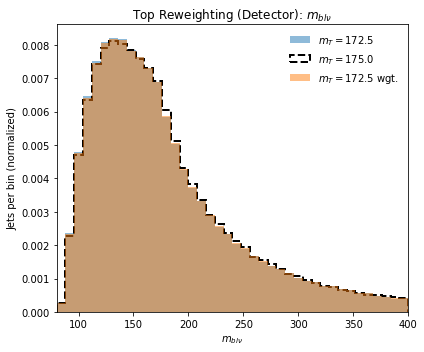

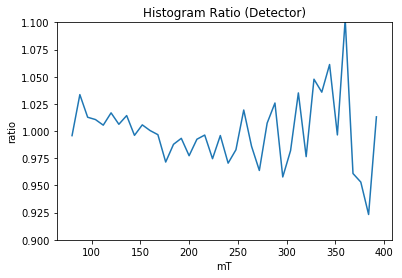

Truth Cor  0.997814022270726
Det Cor  0.999805886608463
theta:  172.5


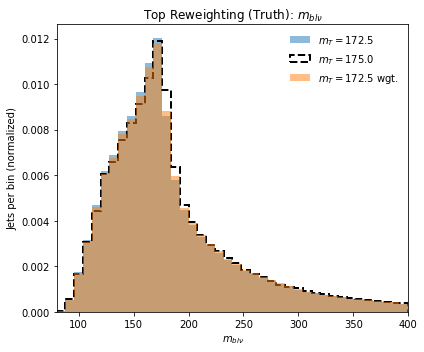

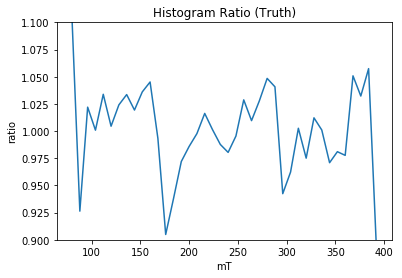

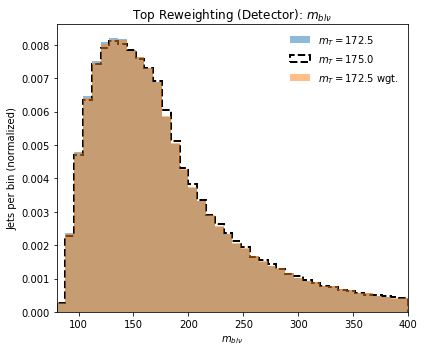

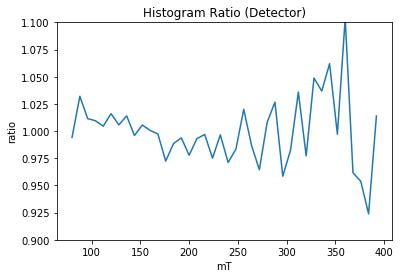

Truth Cor  0.9981232280616107
Det Cor  0.9998185155417736
theta:  173.0


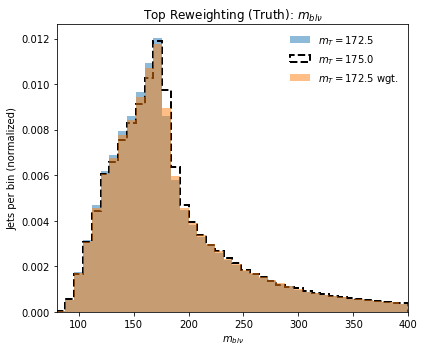

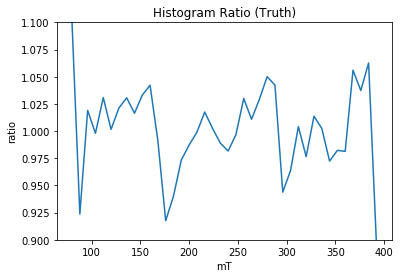

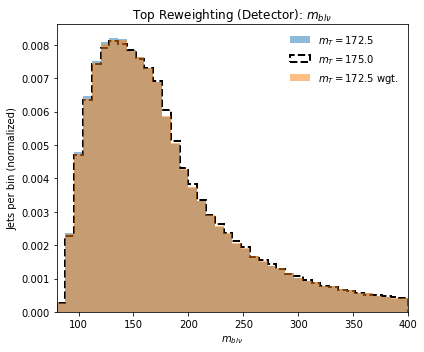

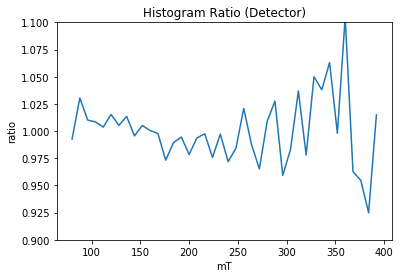

Truth Cor  0.9984837685388663
Det Cor  0.9998308660284255
theta:  173.5


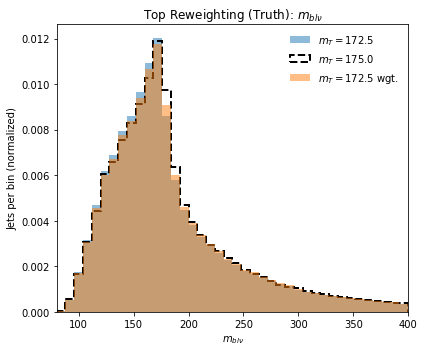

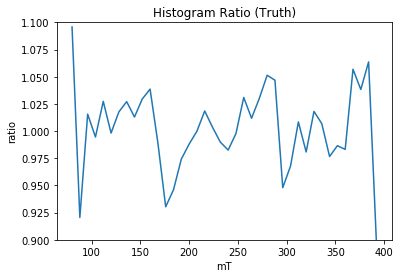

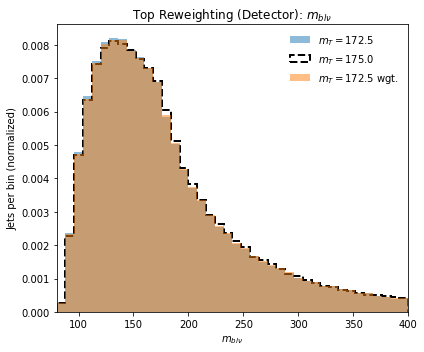

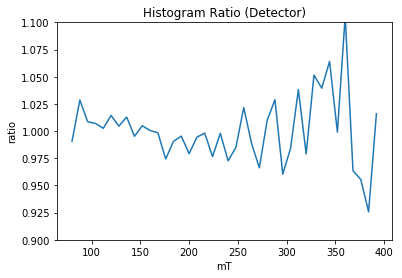

Truth Cor  0.9988325289668879
Det Cor  0.9998449344970842
theta:  174.0


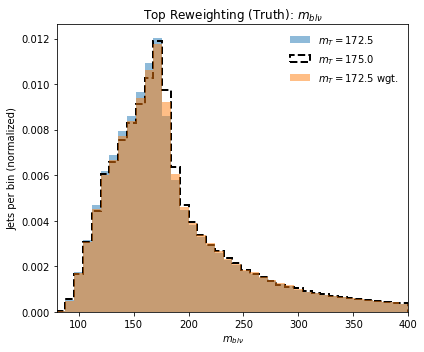

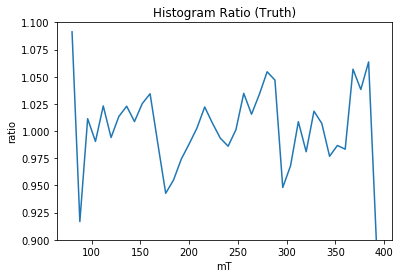

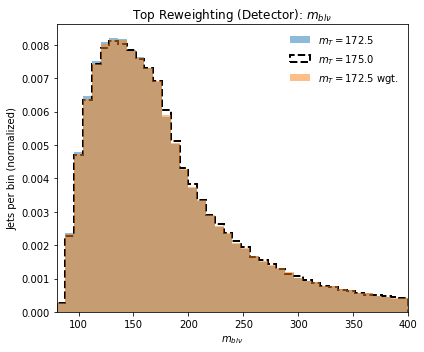

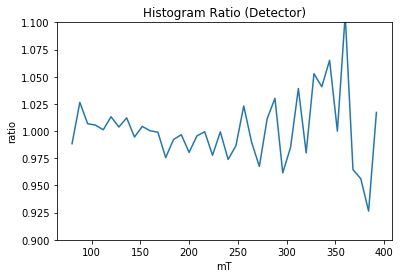

Truth Cor  0.9991492107844109
Det Cor  0.9998609468942347
theta:  174.5


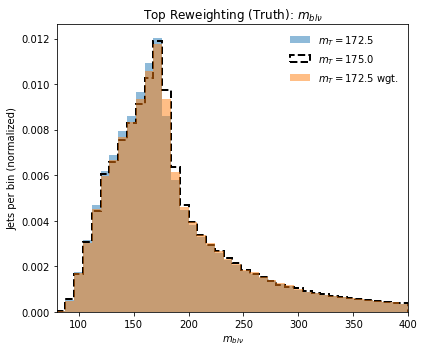

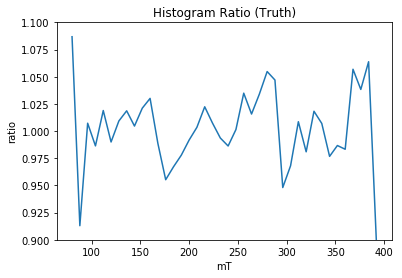

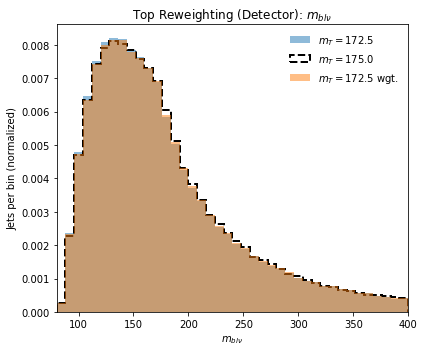

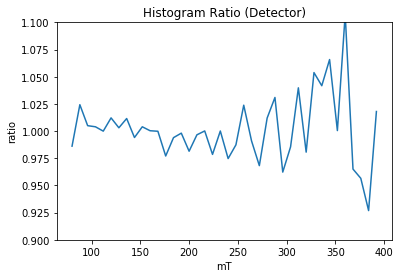

Truth Cor  0.9994310770929522
Det Cor  0.999874848160141
theta:  175.0


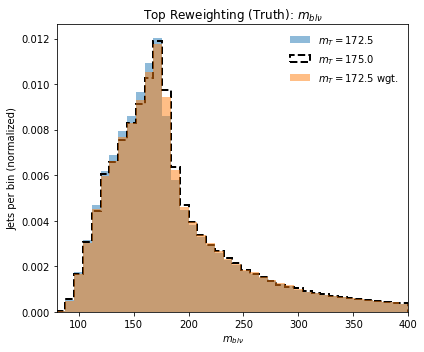

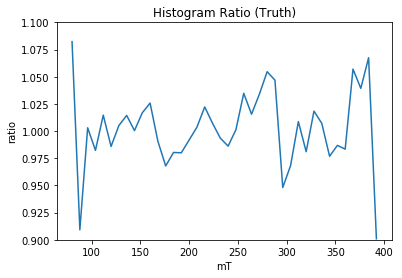

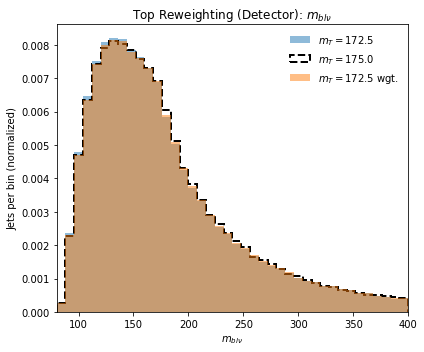

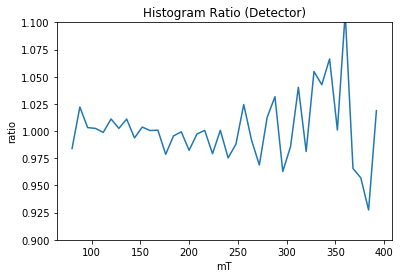

Truth Cor  0.9996484275221914
Det Cor  0.9998861236579102
theta:  175.5


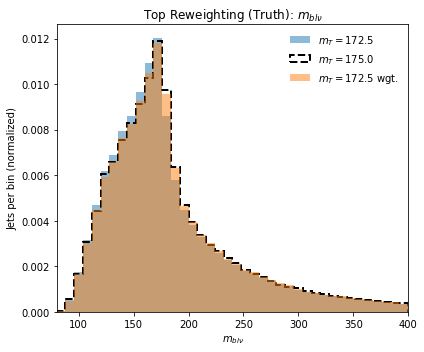

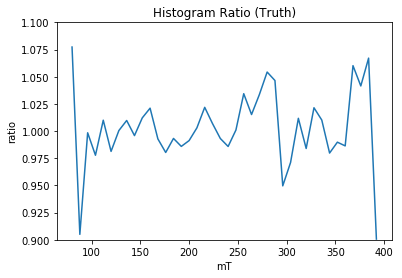

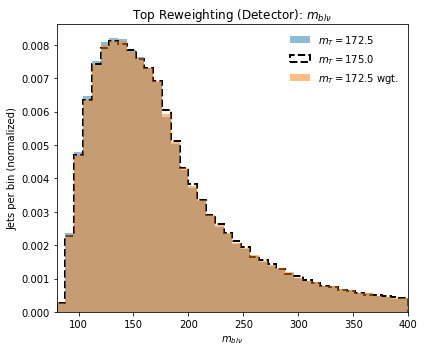

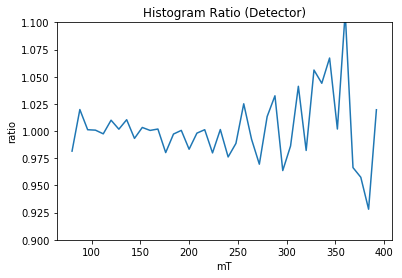

Truth Cor  0.9997963912480251
Det Cor  0.9998961401360992
theta:  176.0


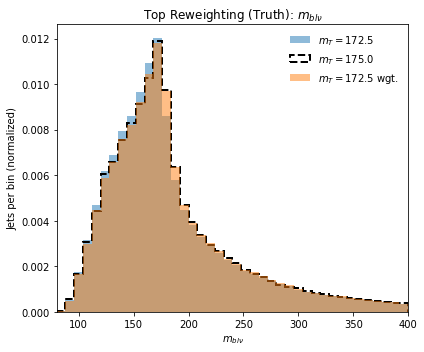

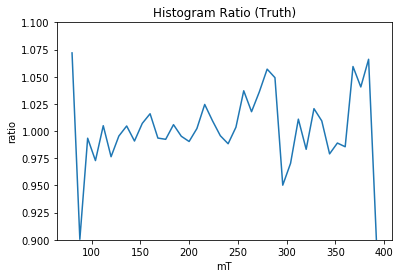

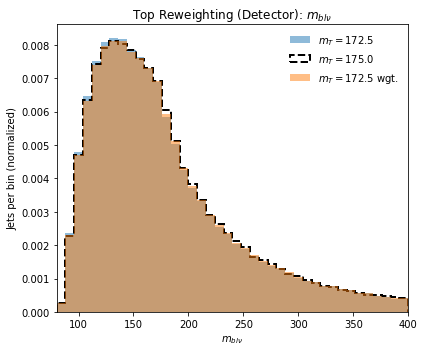

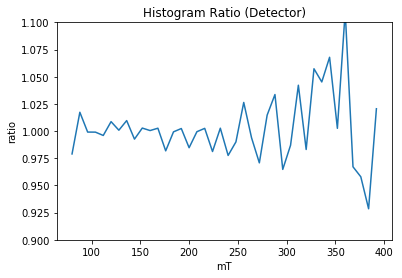

Truth Cor  0.9998609893260505
Det Cor  0.9999053600469242
theta:  176.5


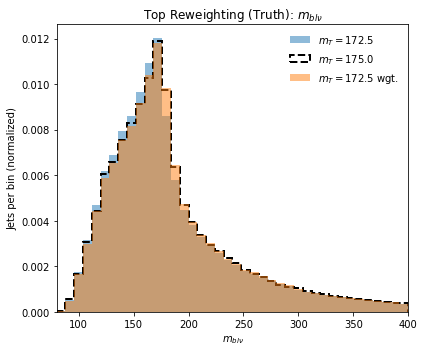

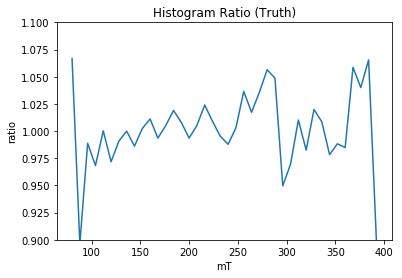

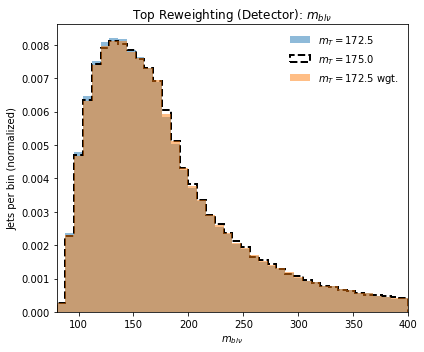

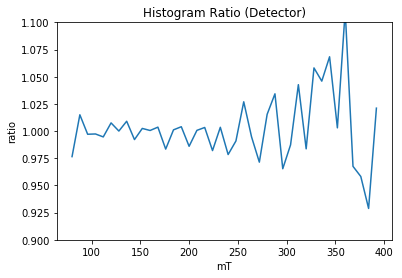

Truth Cor  0.9998454183295351
Det Cor  0.9999109733419398
theta:  177.0


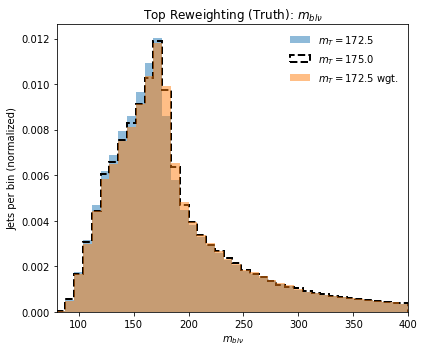

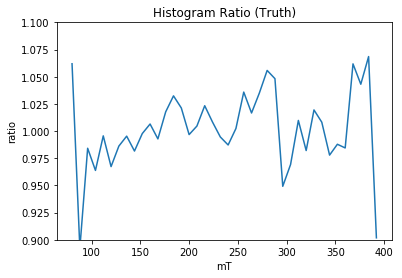

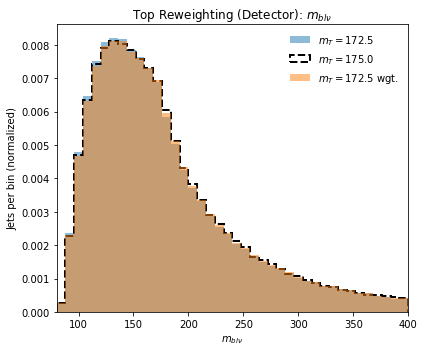

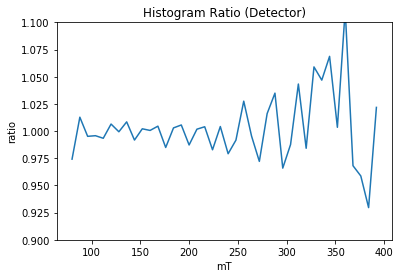

Truth Cor  0.9997408831387506
Det Cor  0.9999137204026852
theta:  177.5


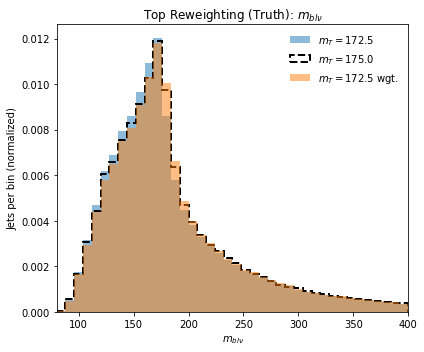

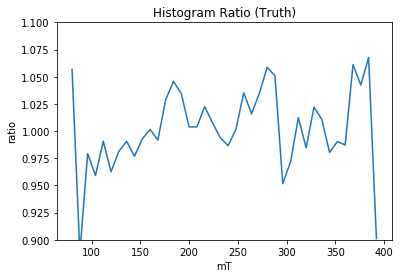

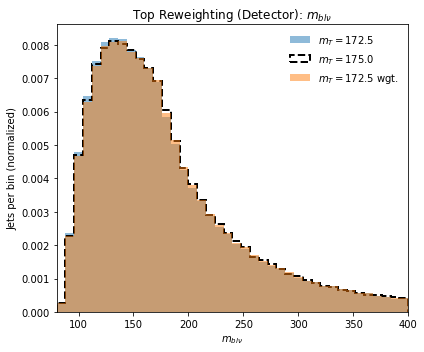

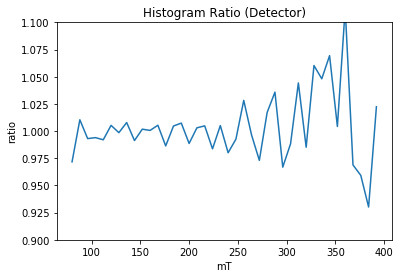

Truth Cor  0.9995550576933778
Det Cor  0.9999140741899346
theta:  178.0


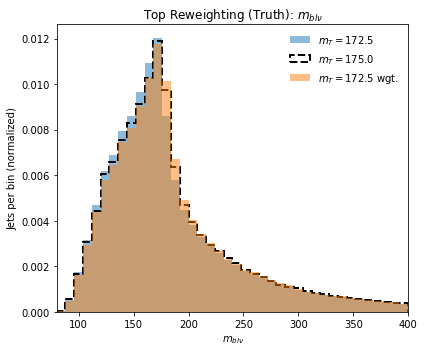

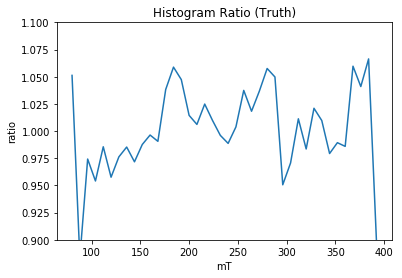

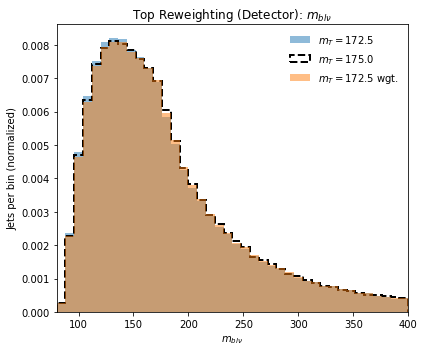

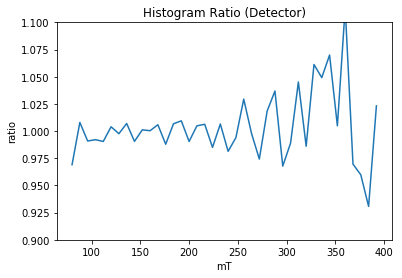

Truth Cor  0.9992948807988709
Det Cor  0.9999123188110952
theta:  178.5


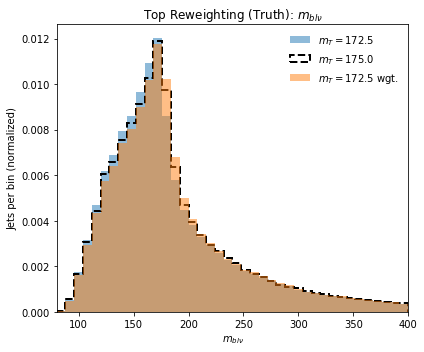

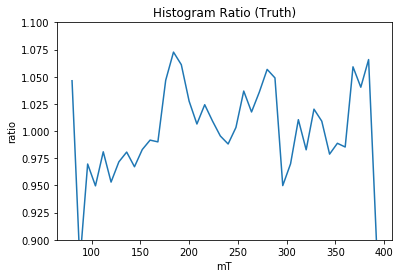

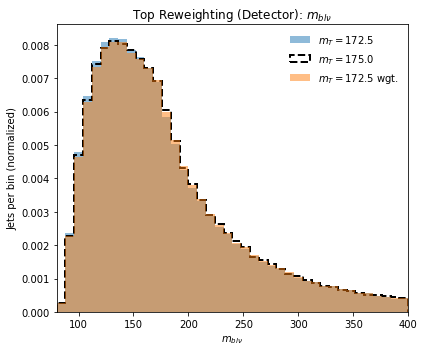

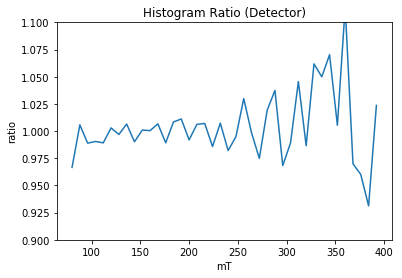

Truth Cor  0.9989727033241368
Det Cor  0.9999074145798692
theta:  179.0


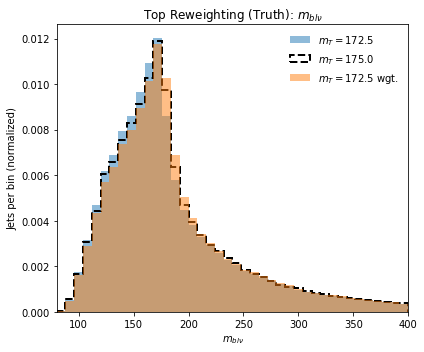

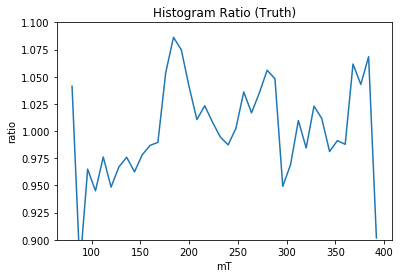

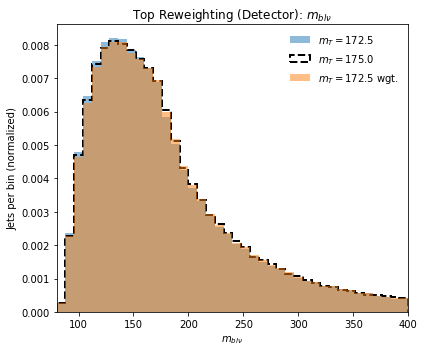

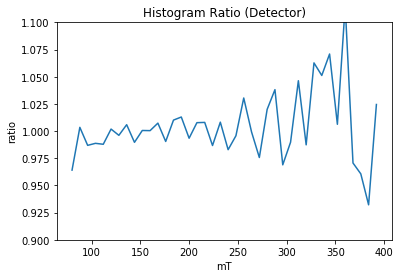

Truth Cor  0.9985923375836614
Det Cor  0.9999001524048722
theta:  179.5


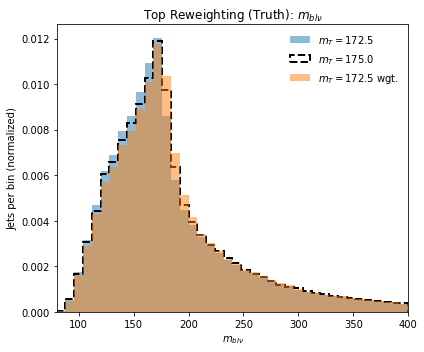

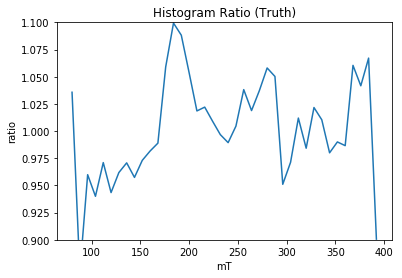

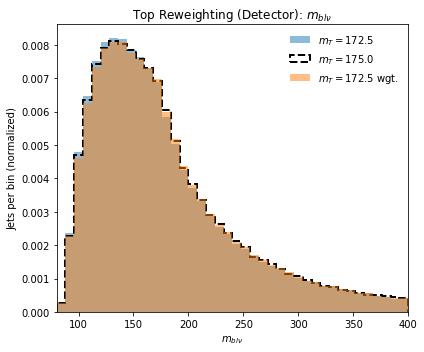

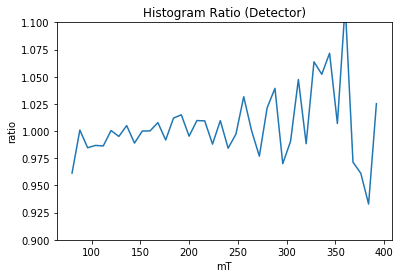

Truth Cor  0.9981528352919571
Det Cor  0.9998898097048009
theta:  180.0


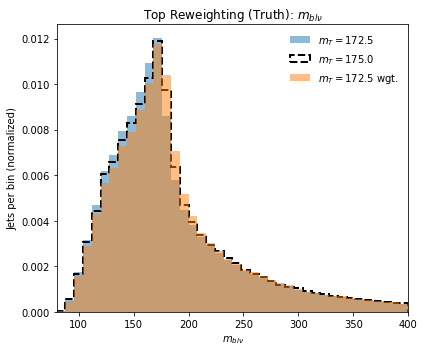

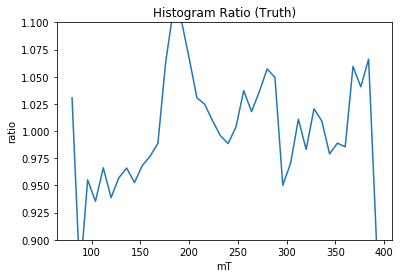

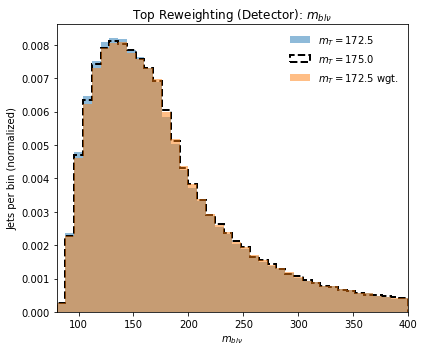

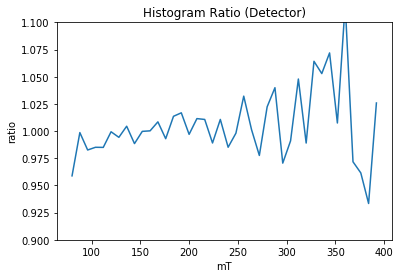

Truth Cor  0.9976611338054603
Det Cor  0.9998770460514865


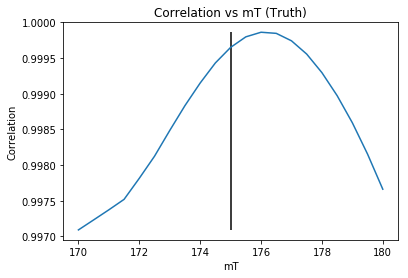

176.0


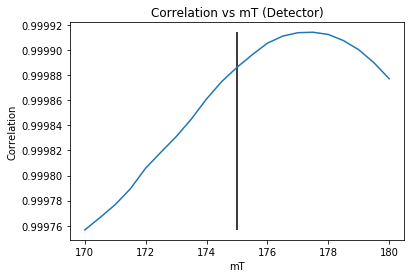

177.5
Weight Iteration:  11
theta:  170.0


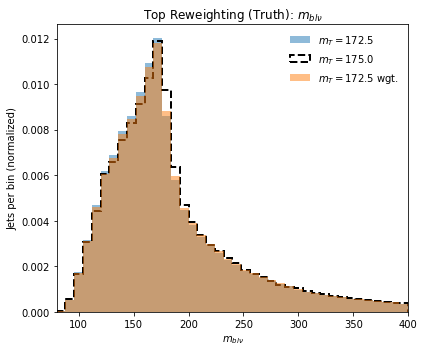

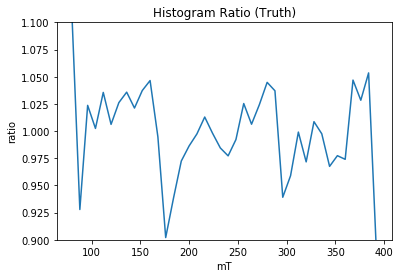

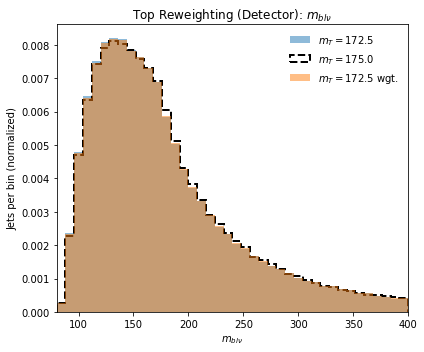

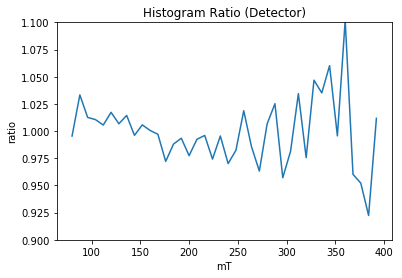

Truth Cor  0.9980203607646924
Det Cor  0.9998068216136515
theta:  170.5


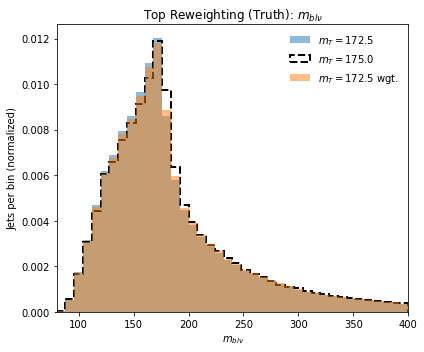

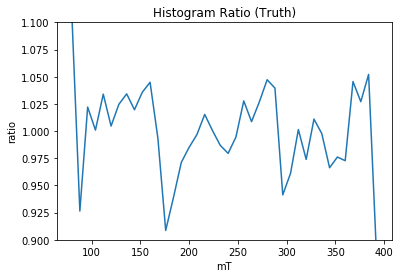

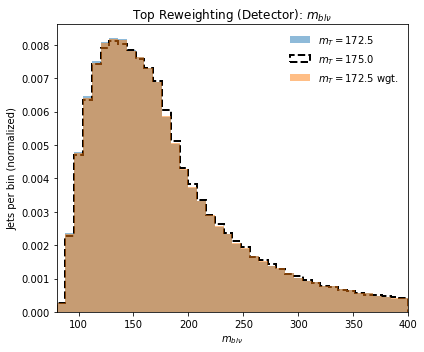

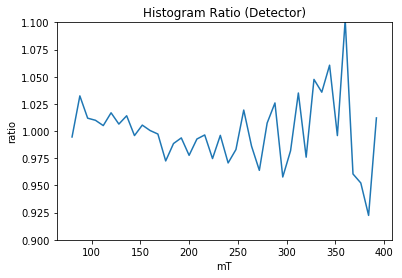

Truth Cor  0.9982126408151845
Det Cor  0.9998142425452974
theta:  171.0


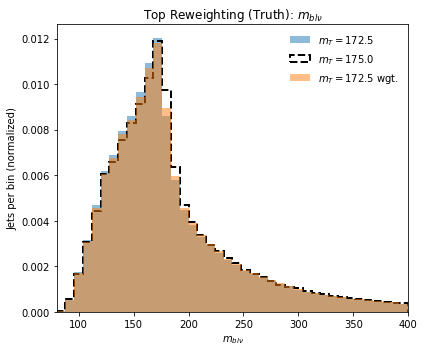

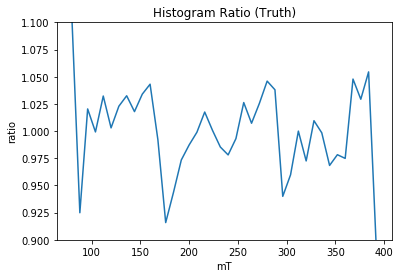

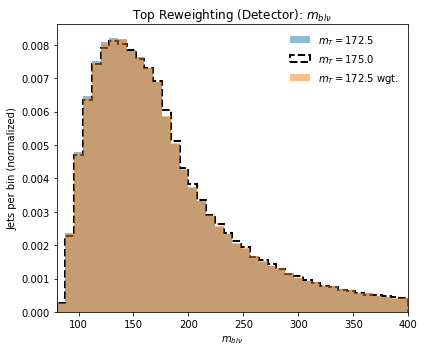

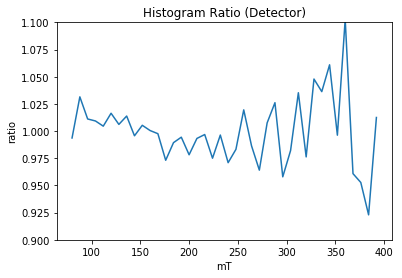

Truth Cor  0.998441061692445
Det Cor  0.9998226136098651
theta:  171.5


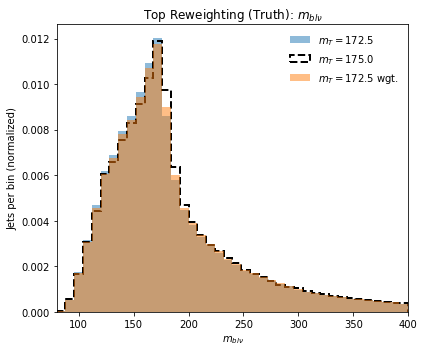

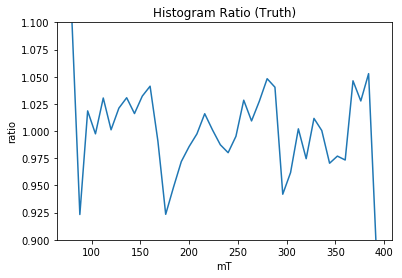

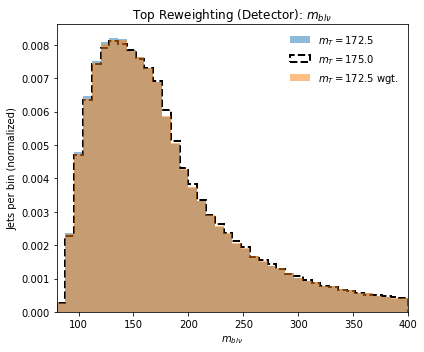

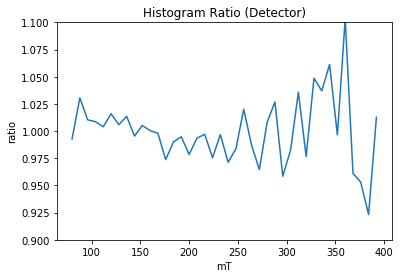

Truth Cor  0.9986542067623698
Det Cor  0.9998301691414331
theta:  172.0


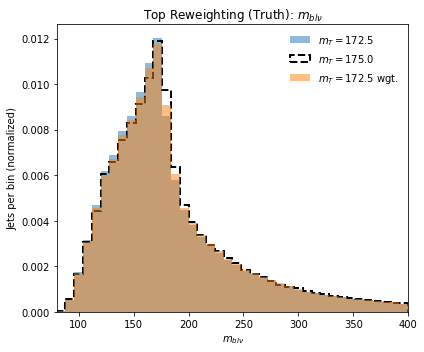

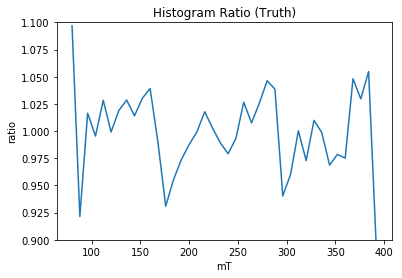

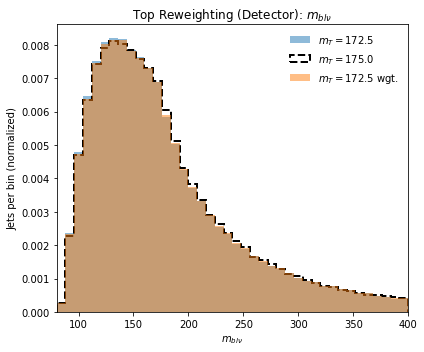

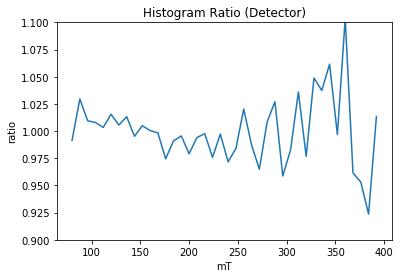

Truth Cor  0.9988718518565776
Det Cor  0.9998395444564189
theta:  172.5


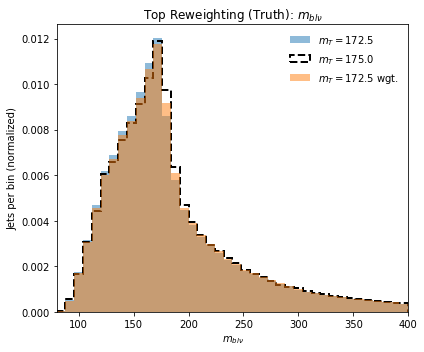

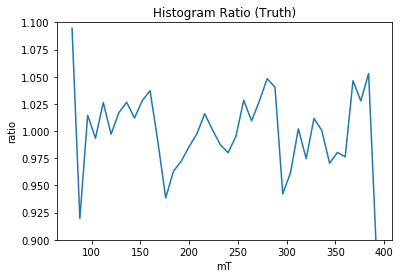

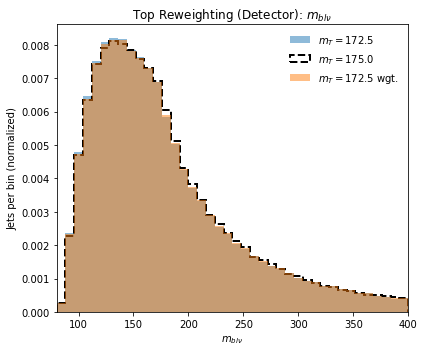

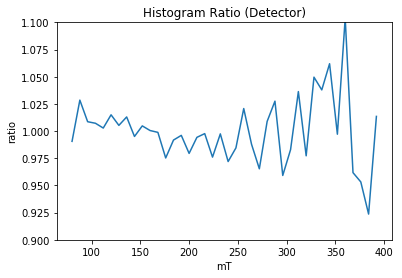

Truth Cor  0.999067941578267
Det Cor  0.9998472117460684
theta:  173.0


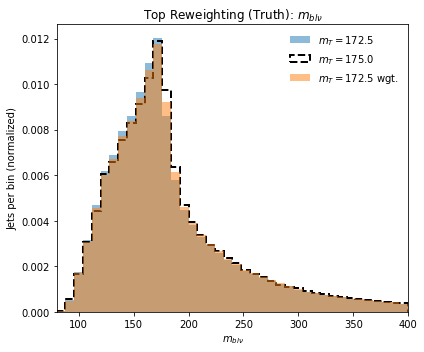

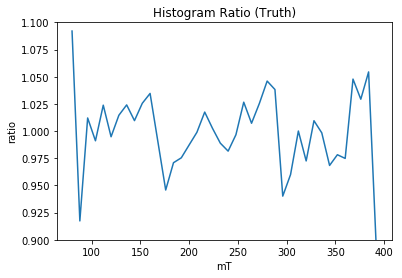

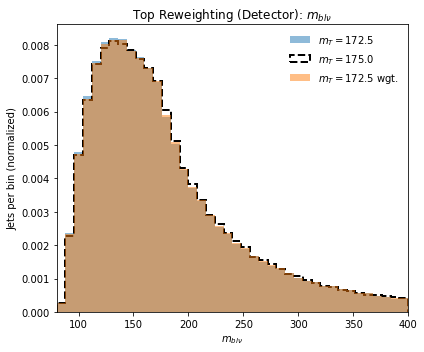

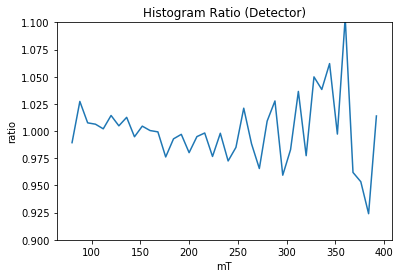

Truth Cor  0.9992527408960673
Det Cor  0.9998570650078653
theta:  173.5


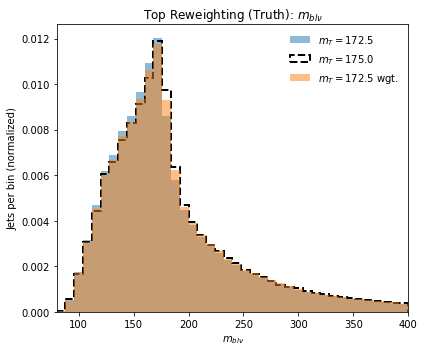

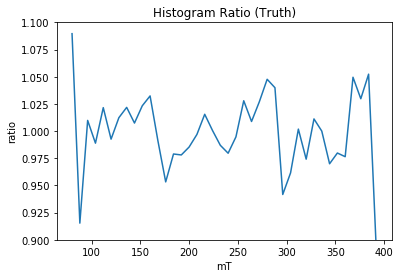

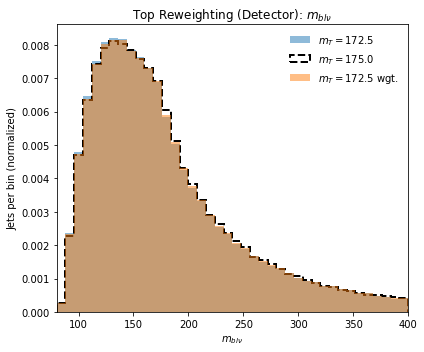

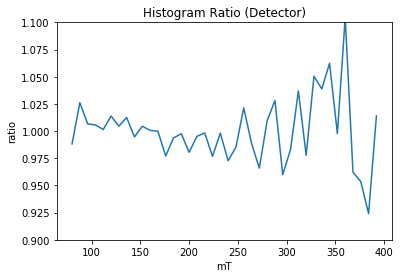

Truth Cor  0.9994110549065676
Det Cor  0.999864181768554
theta:  174.0


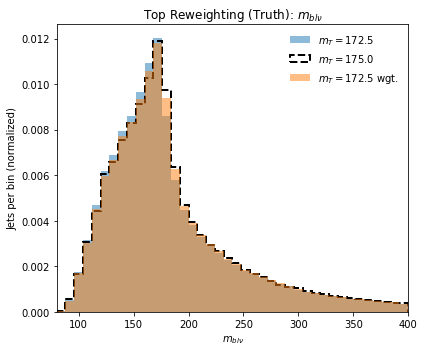

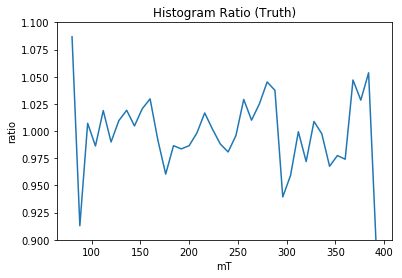

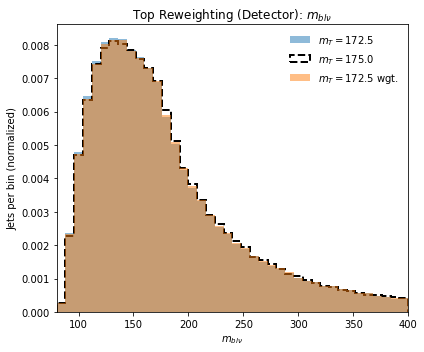

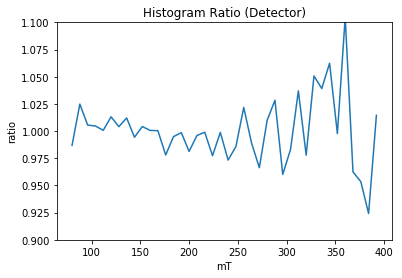

Truth Cor  0.9995514112656432
Det Cor  0.999873479013368
theta:  174.5


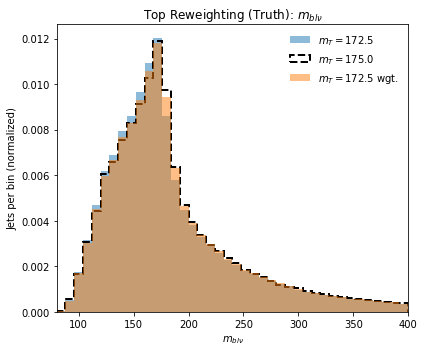

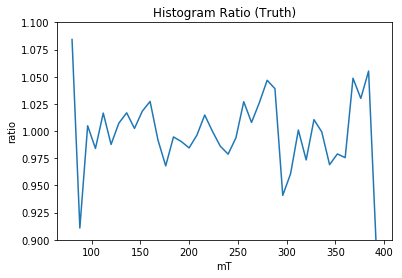

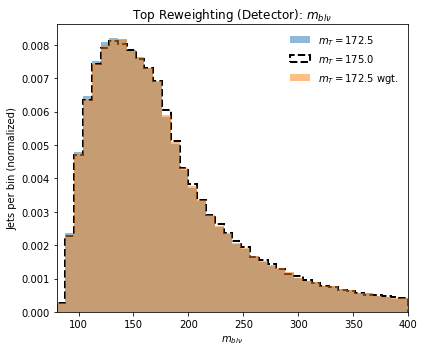

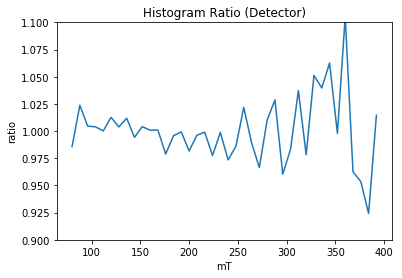

Truth Cor  0.9996622709481977
Det Cor  0.999879516072612
theta:  175.0


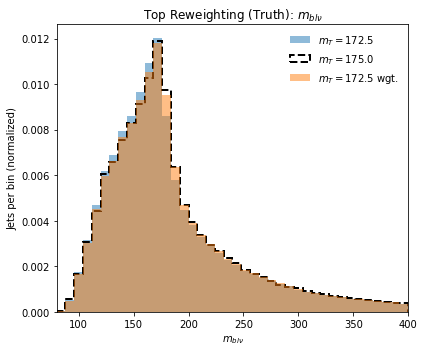

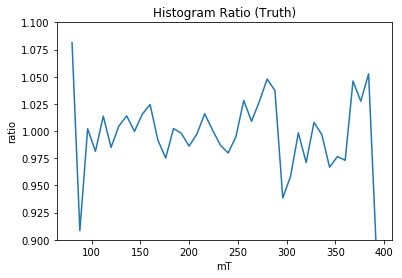

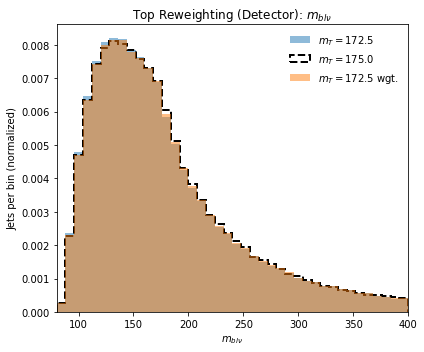

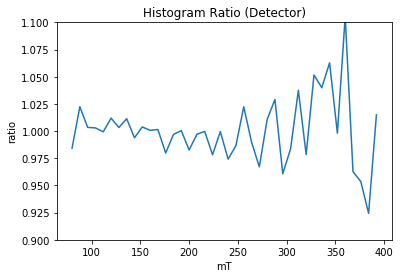

Truth Cor  0.9997459637590559
Det Cor  0.9998875324476536
theta:  175.5


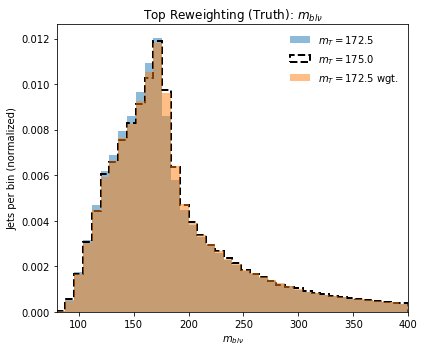

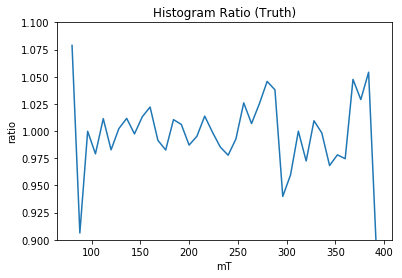

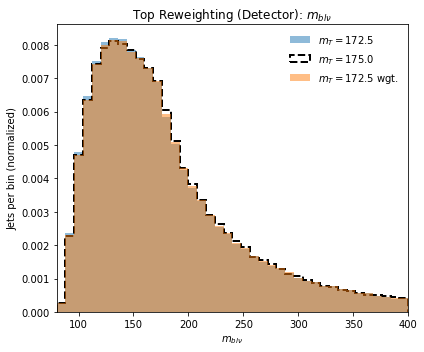

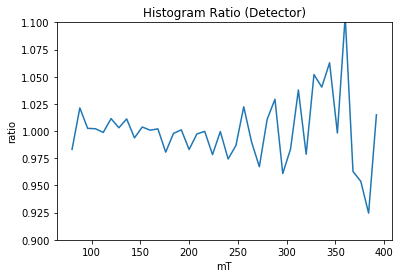

Truth Cor  0.9998008276120487
Det Cor  0.9998921561379263
theta:  176.0


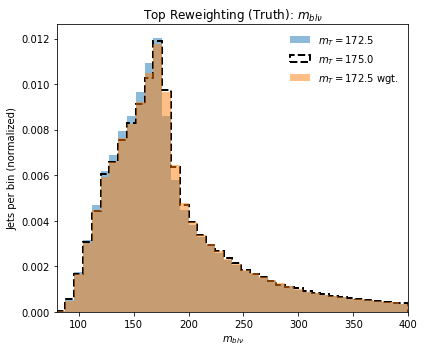

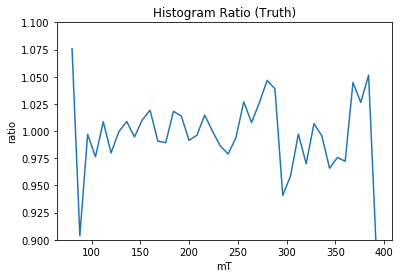

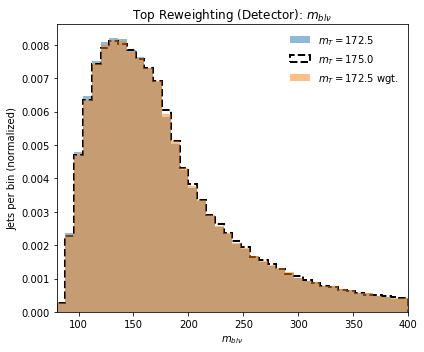

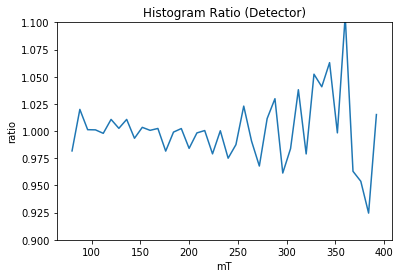

Truth Cor  0.9998259688858004
Det Cor  0.9998986447845486
theta:  176.5


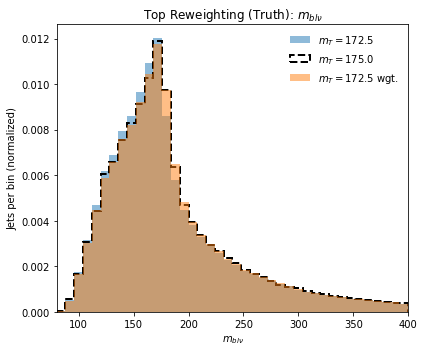

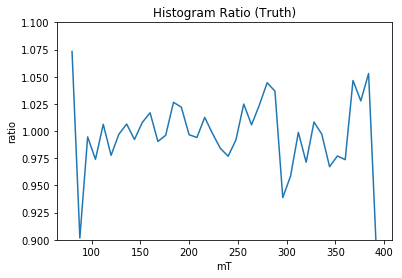

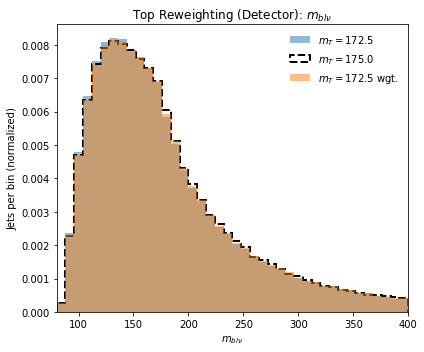

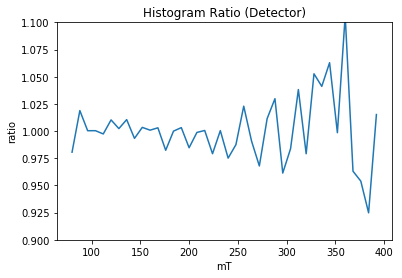

Truth Cor  0.9998225917070288
Det Cor  0.9999019872728818
theta:  177.0


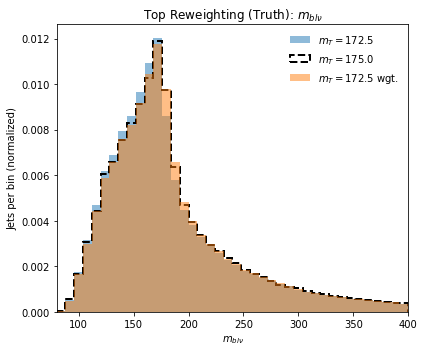

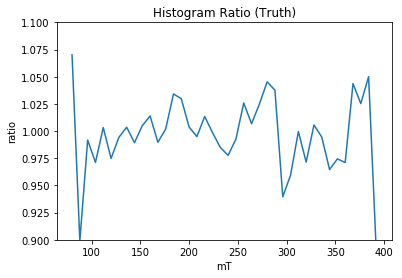

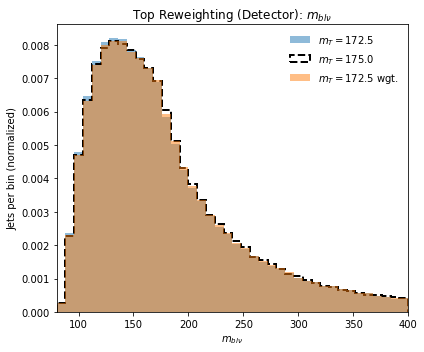

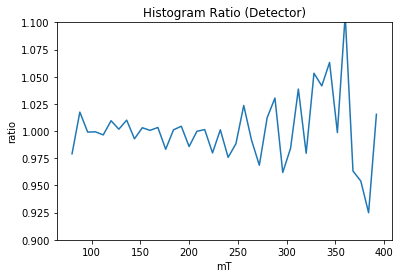

Truth Cor  0.999790872852475
Det Cor  0.9999068104441784
theta:  177.5


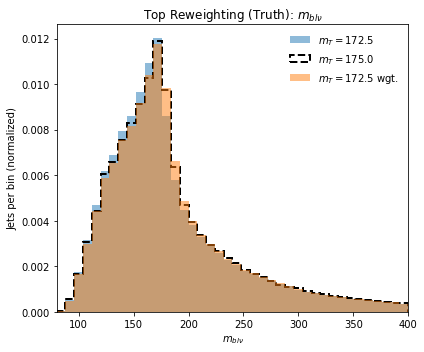

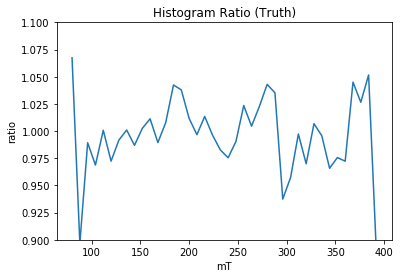

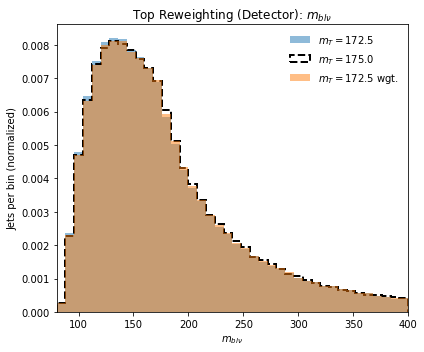

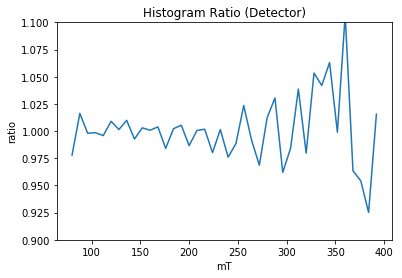

Truth Cor  0.9997314881412465
Det Cor  0.9999093030356463
theta:  178.0


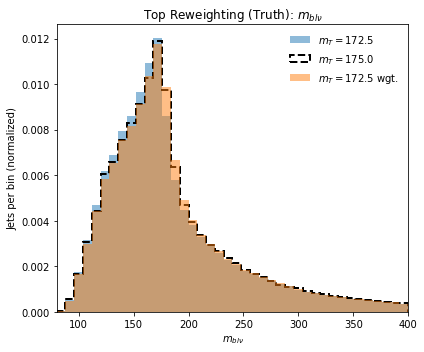

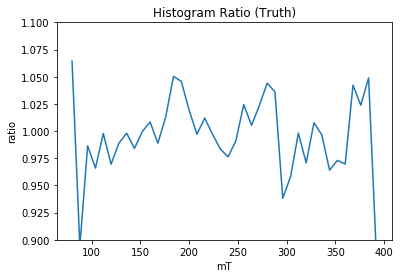

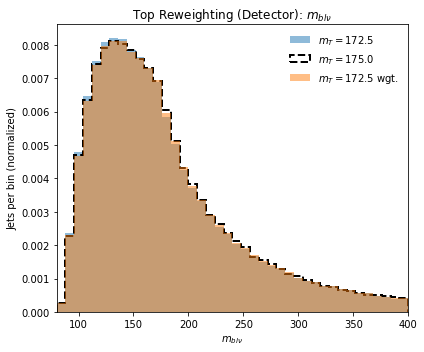

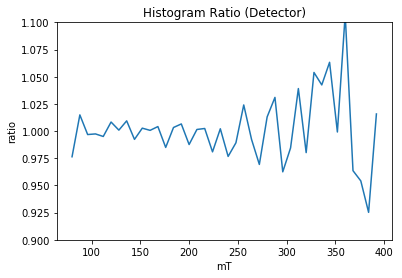

Truth Cor  0.9996463326125757
Det Cor  0.9999119962178131
theta:  178.5


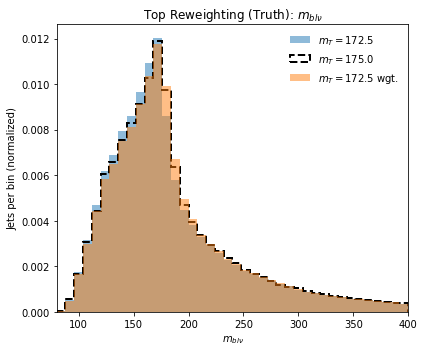

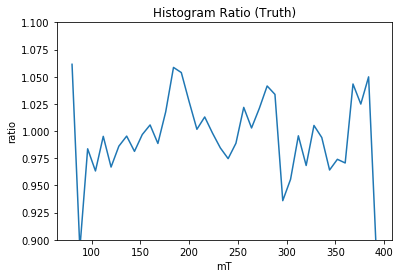

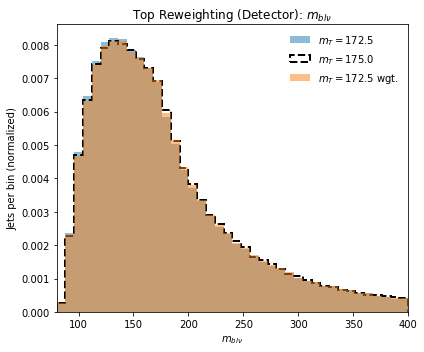

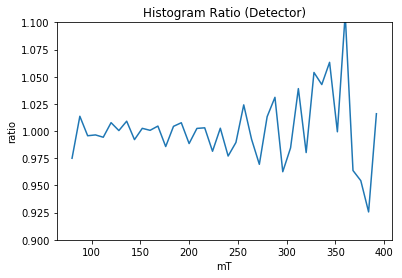

Truth Cor  0.9995356692266452
Det Cor  0.9999132738520705
theta:  179.0


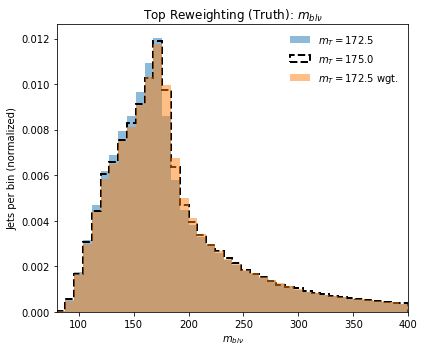

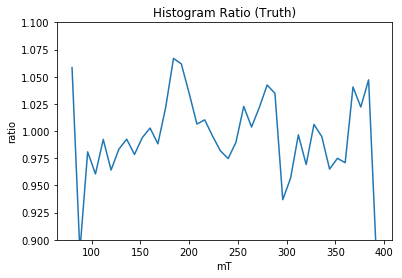

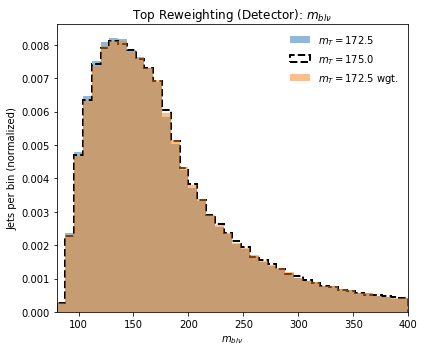

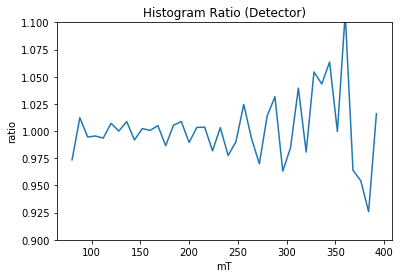

Truth Cor  0.999399675083652
Det Cor  0.9999137846557956
theta:  179.5


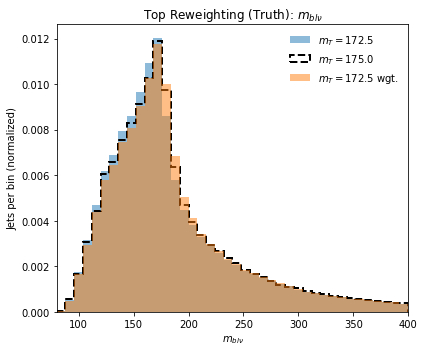

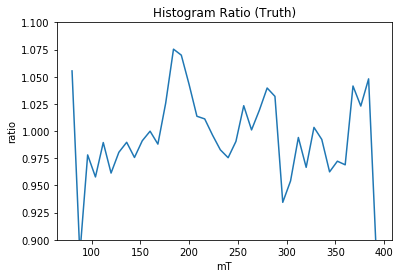

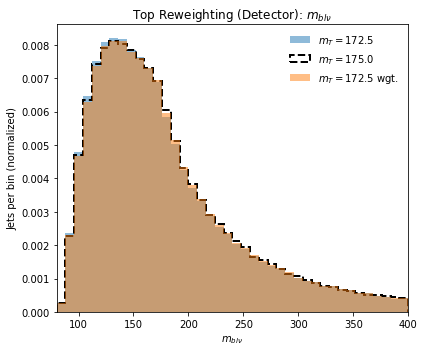

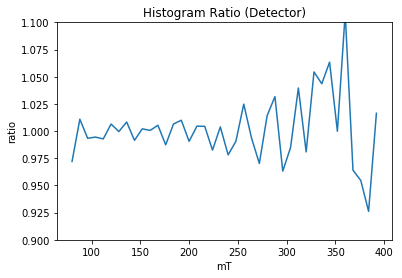

Truth Cor  0.9992379979687547
Det Cor  0.9999135597229861
theta:  180.0


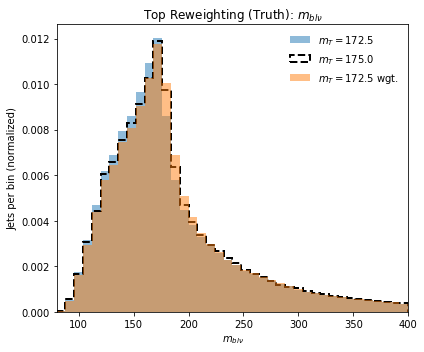

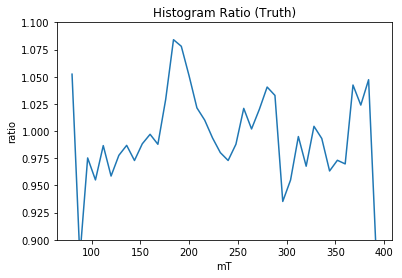

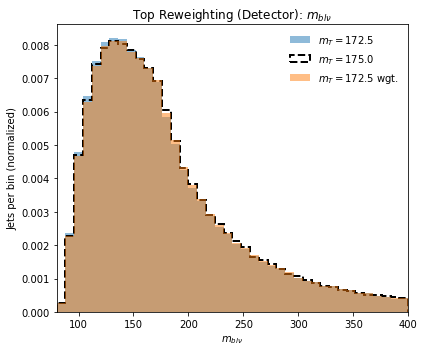

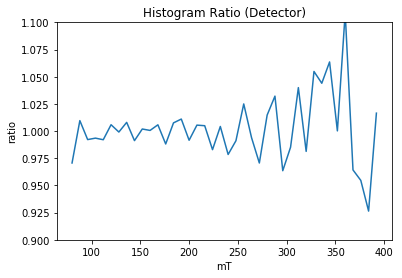

Truth Cor  0.9990494334247113
Det Cor  0.999912208847


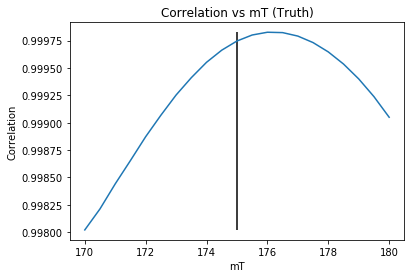

176.0


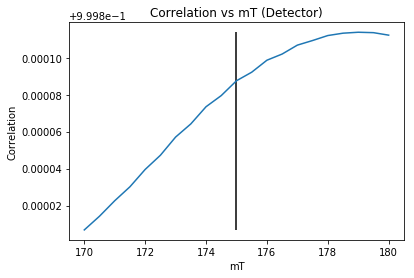

179.0
Weight Iteration:  12
theta:  170.0


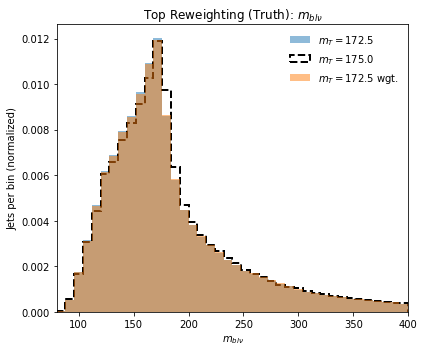

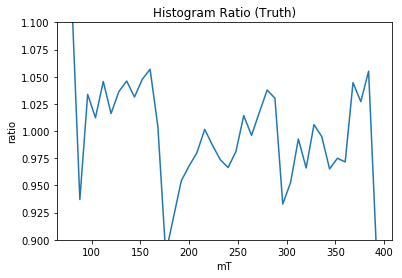

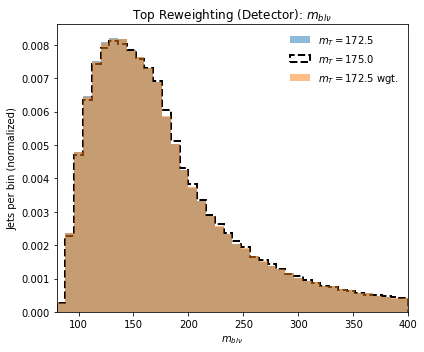

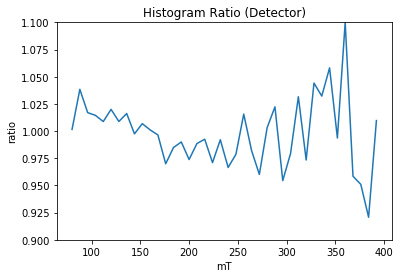

Truth Cor  0.997122458110654
Det Cor  0.999753479106388
theta:  170.5


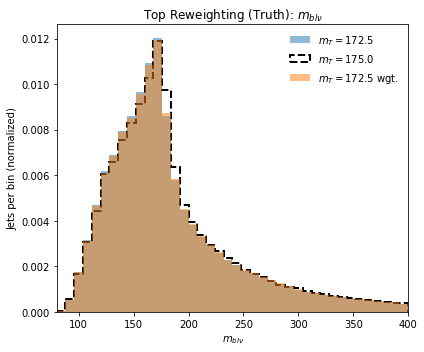

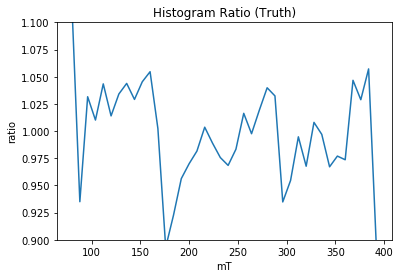

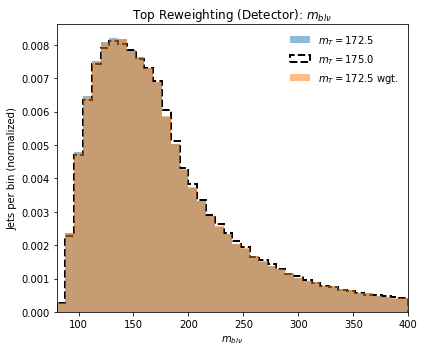

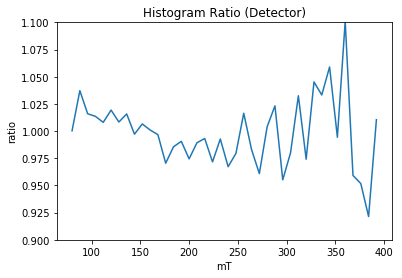

Truth Cor  0.9973875019146755
Det Cor  0.9997662255213697
theta:  171.0


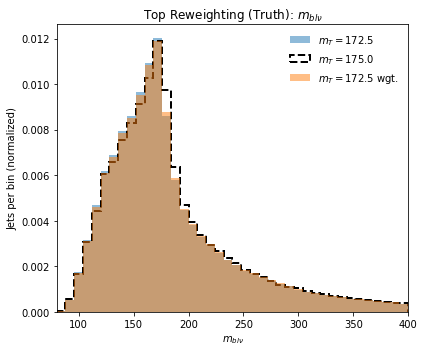

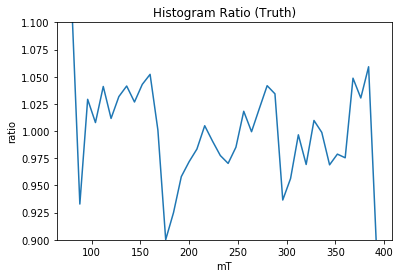

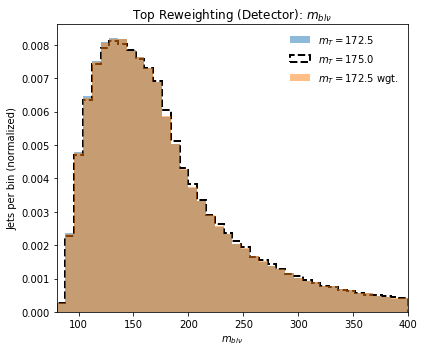

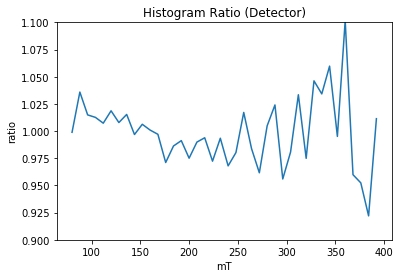

Truth Cor  0.9976699601317827
Det Cor  0.9997792977298489
theta:  171.5


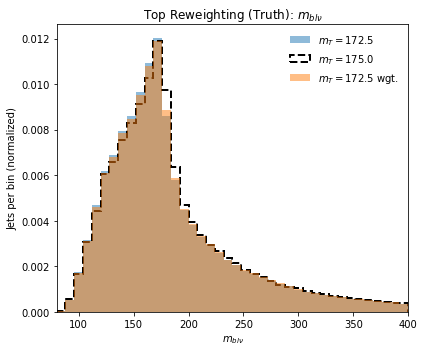

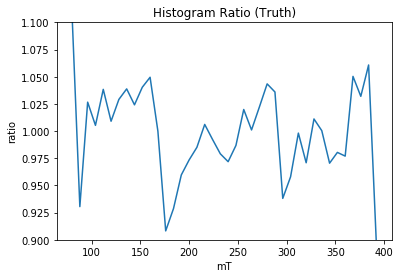

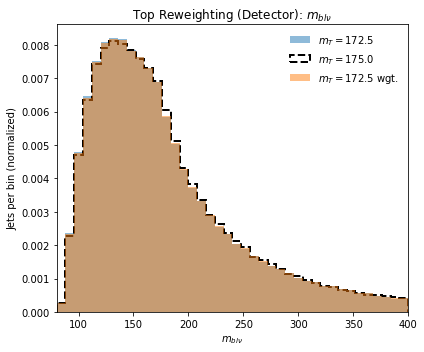

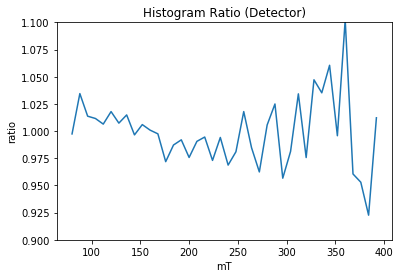

Truth Cor  0.9979775200960873
Det Cor  0.9997933347017488
theta:  172.0


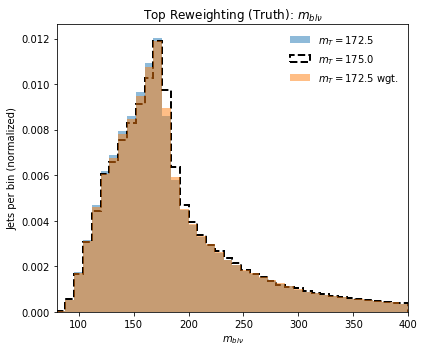

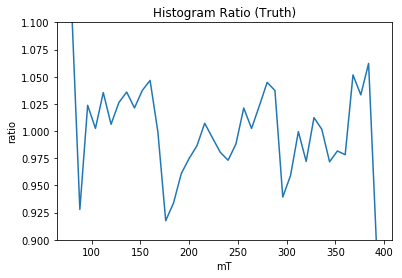

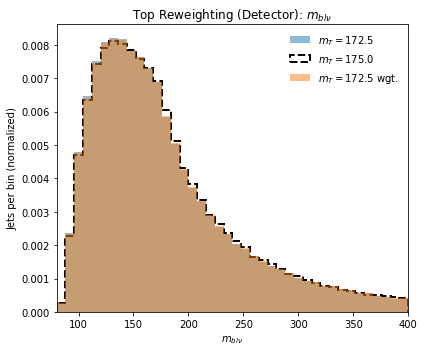

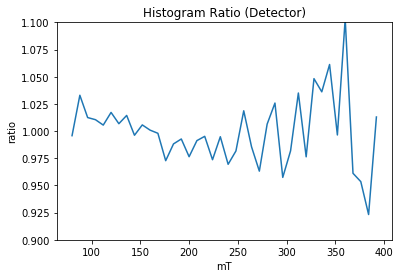

Truth Cor  0.9983029093695427
Det Cor  0.9998077086234085
theta:  172.5


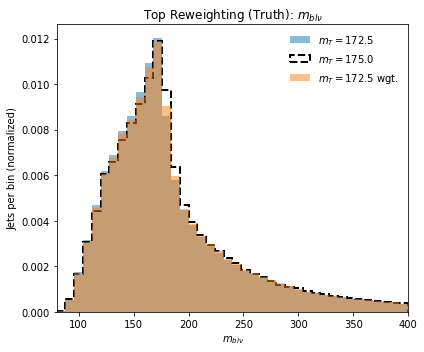

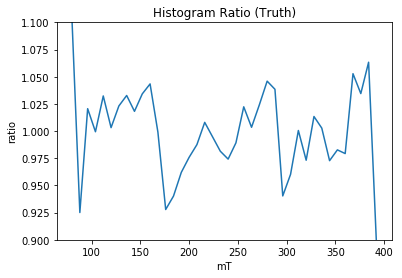

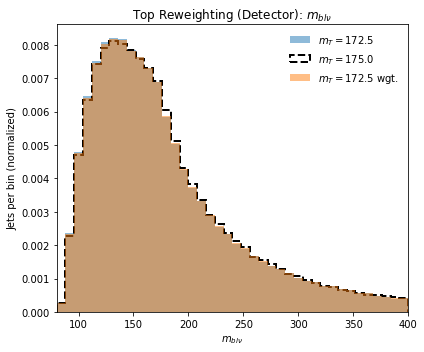

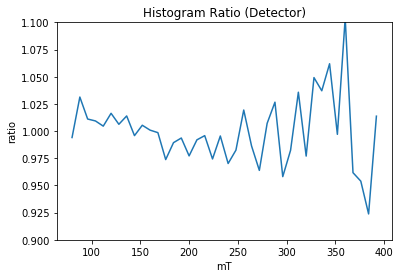

Truth Cor  0.9986297029153971
Det Cor  0.9998223668541585
theta:  173.0


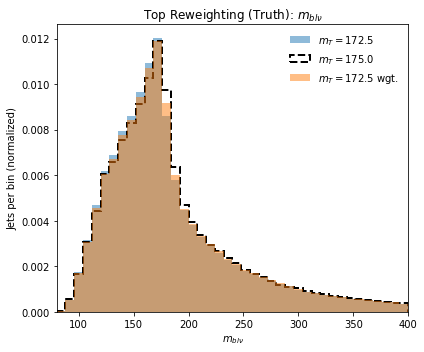

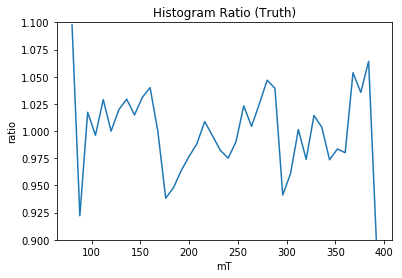

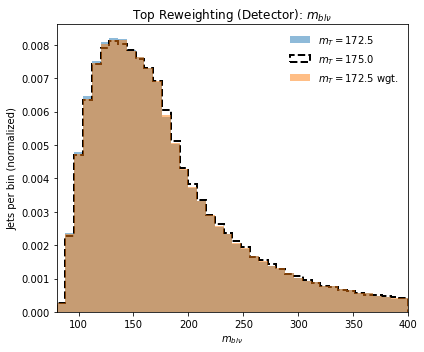

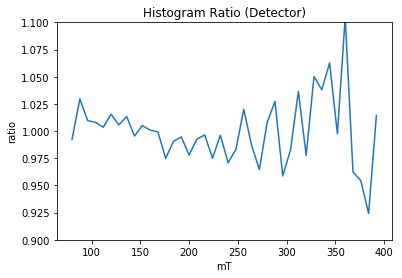

Truth Cor  0.9989333323822074
Det Cor  0.9998367185641767
theta:  173.5


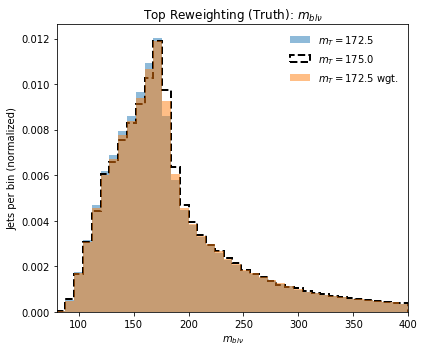

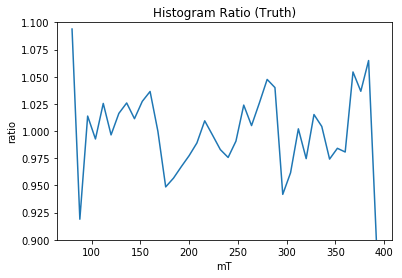

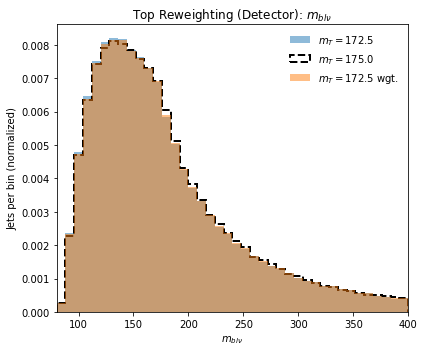

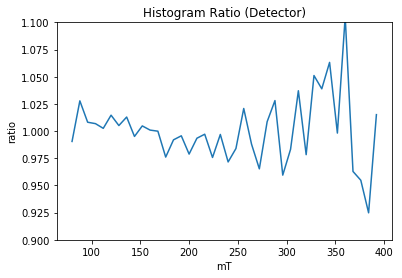

Truth Cor  0.9992044332231115
Det Cor  0.9998505278047402
theta:  174.0


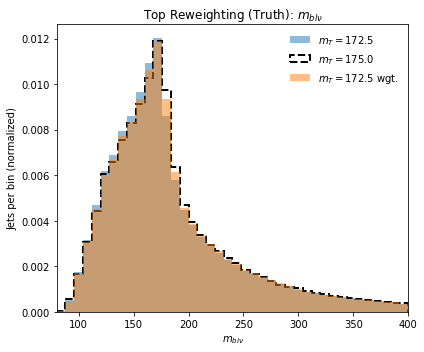

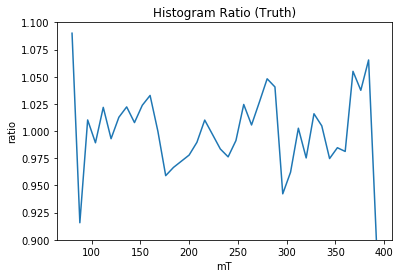

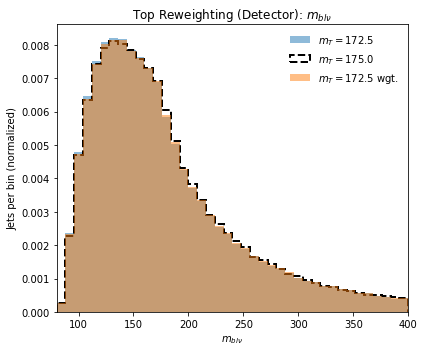

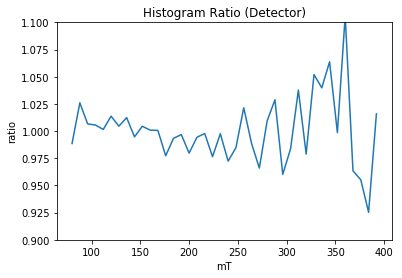

Truth Cor  0.9994371026361215
Det Cor  0.9998633497022799
theta:  174.5


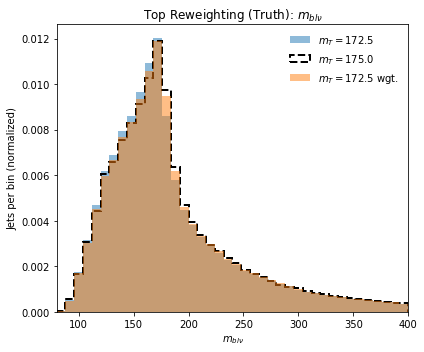

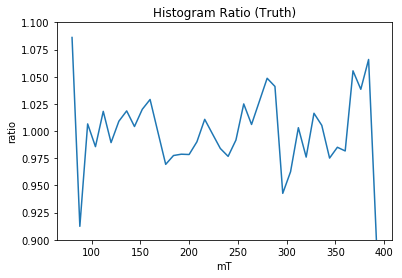

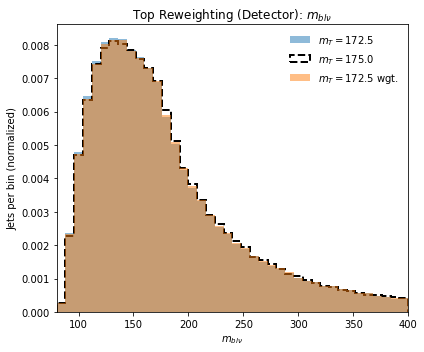

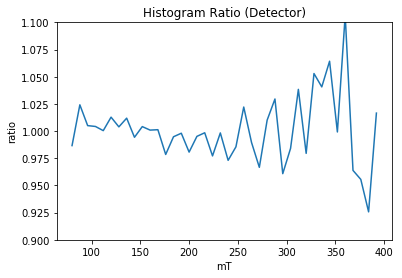

Truth Cor  0.9996250826708301
Det Cor  0.9998748323740967
theta:  175.0


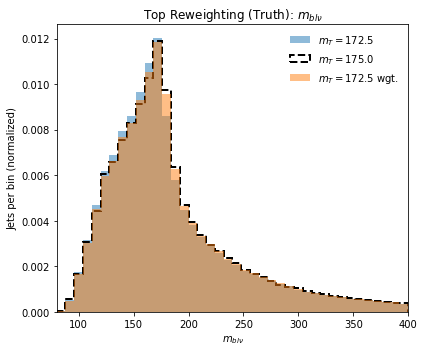

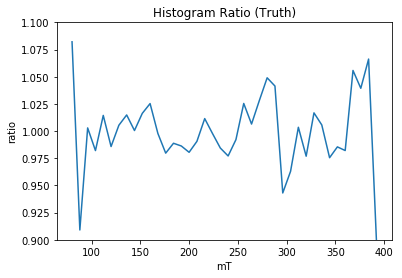

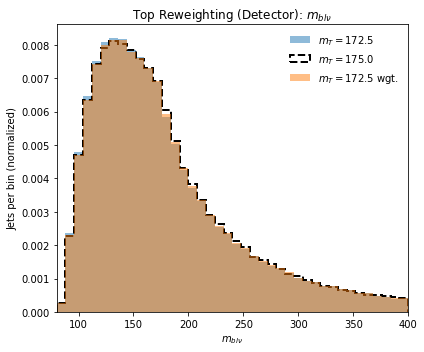

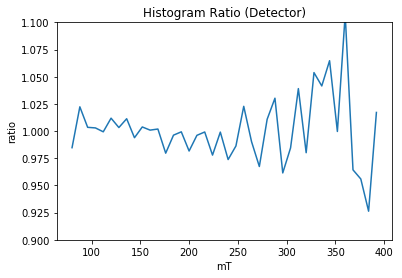

Truth Cor  0.9997618937398303
Det Cor  0.999885004204923
theta:  175.5


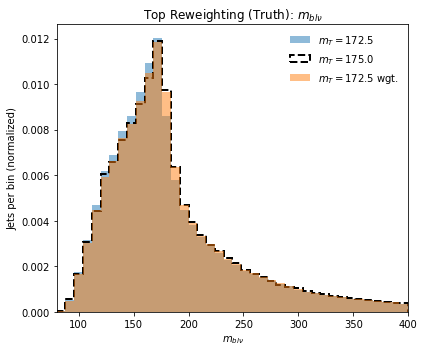

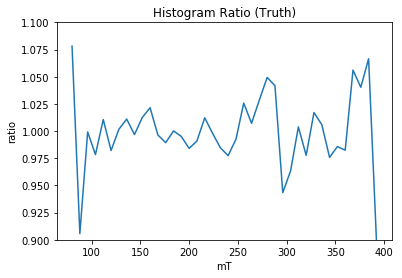

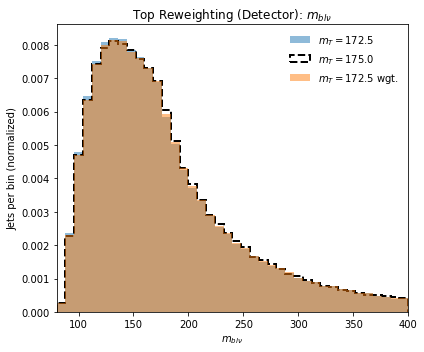

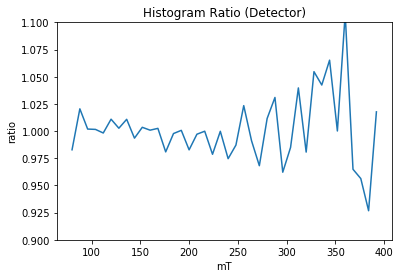

Truth Cor  0.9998431528020026
Det Cor  0.9998937524562725
theta:  176.0


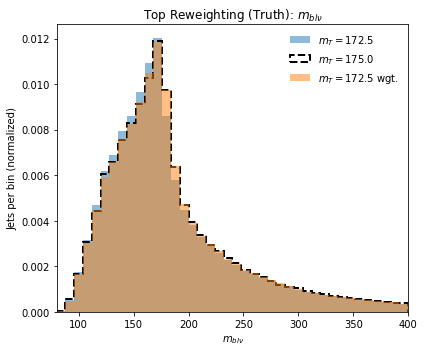

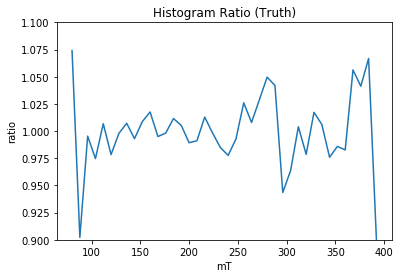

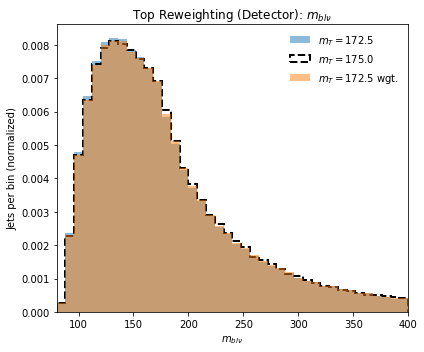

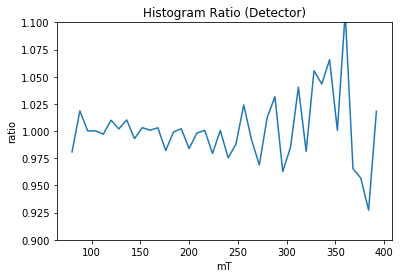

Truth Cor  0.9998704858333554
Det Cor  0.9999010415266645
theta:  176.5


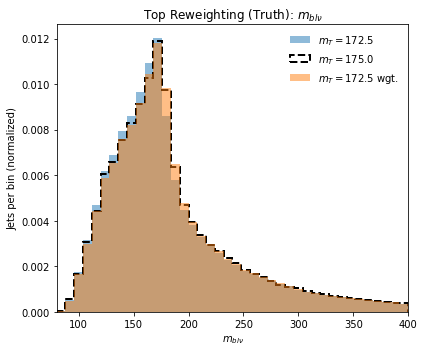

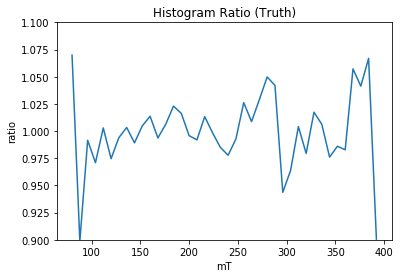

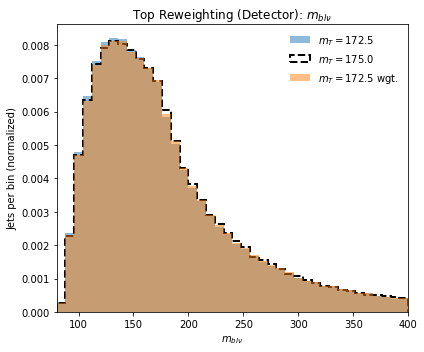

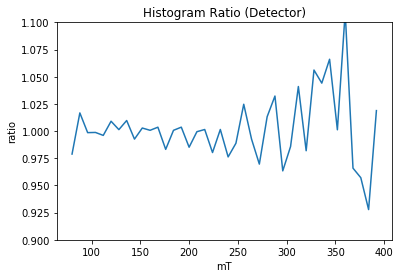

Truth Cor  0.9998453594632851
Det Cor  0.9999067572275867
theta:  177.0


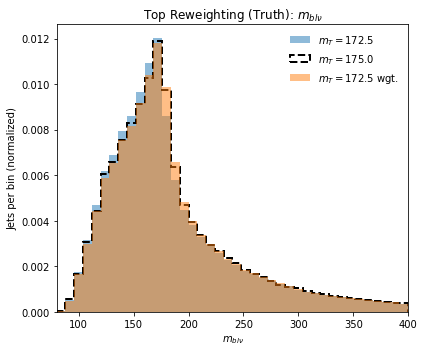

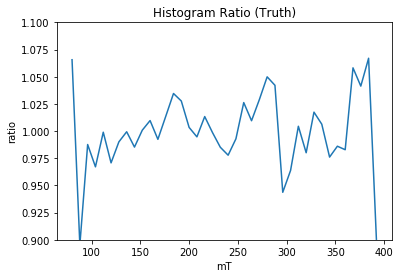

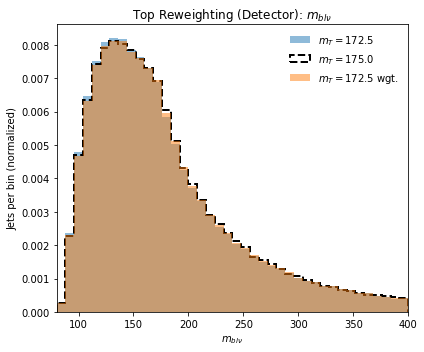

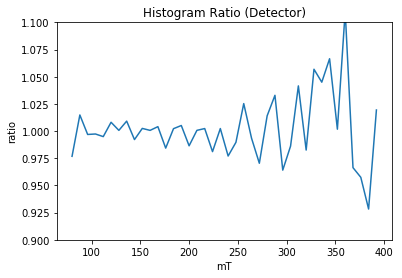

Truth Cor  0.9997696079901304
Det Cor  0.9999108740636959
theta:  177.5


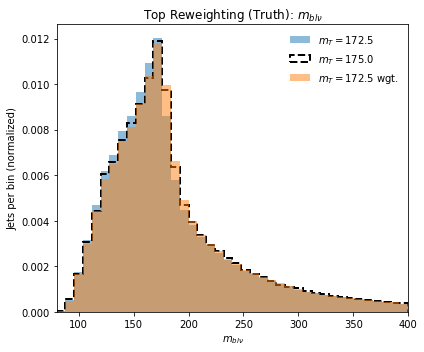

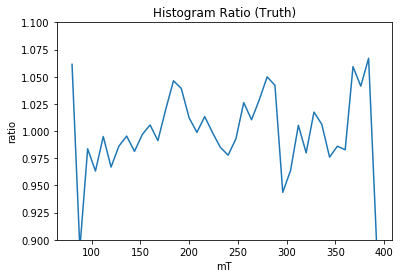

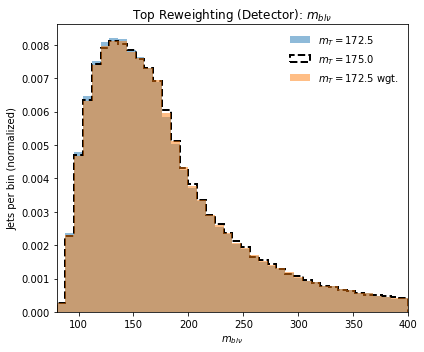

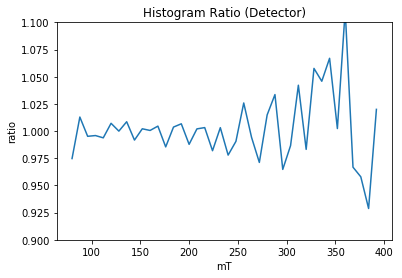

Truth Cor  0.9996451077785309
Det Cor  0.9999132038336638
theta:  178.0


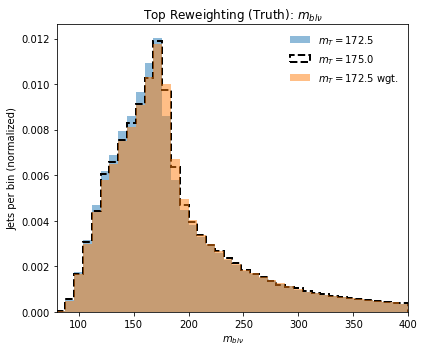

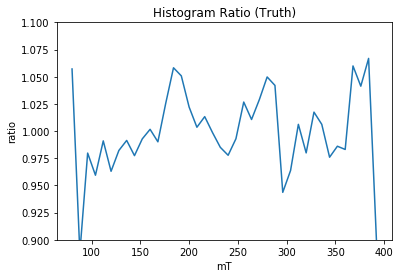

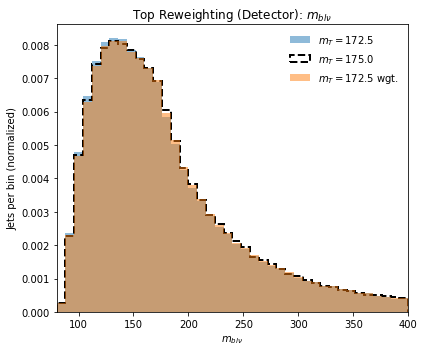

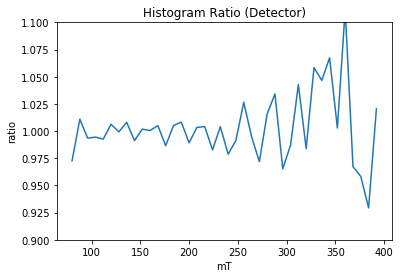

Truth Cor  0.9994724321719819
Det Cor  0.9999136655527706
theta:  178.5


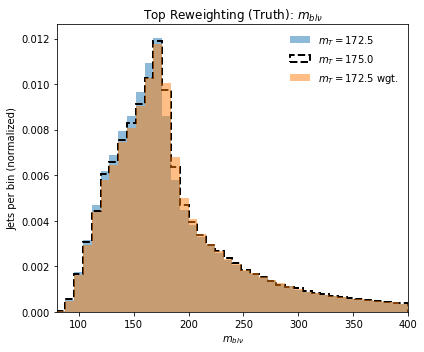

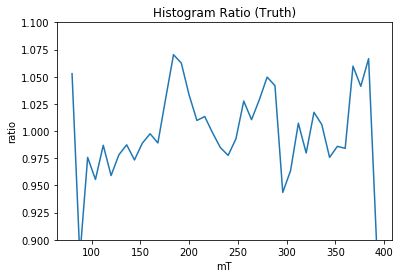

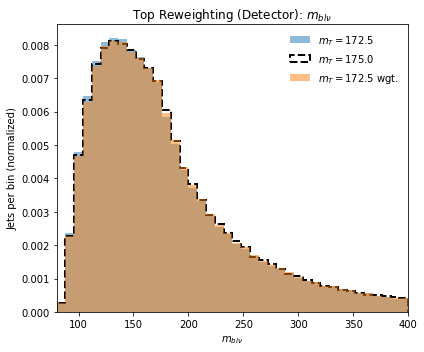

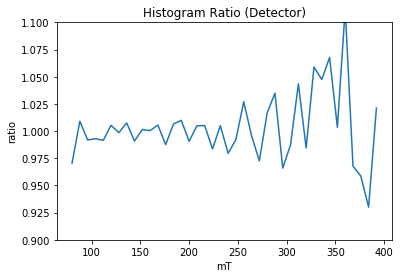

Truth Cor  0.9992526093994633
Det Cor  0.9999123781614733
theta:  179.0


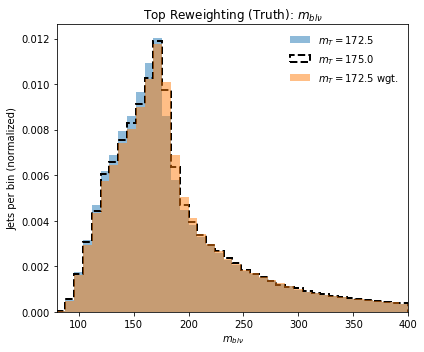

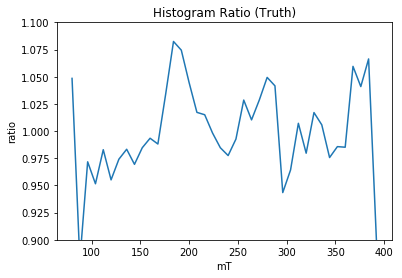

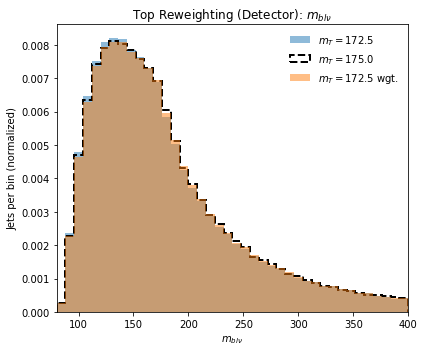

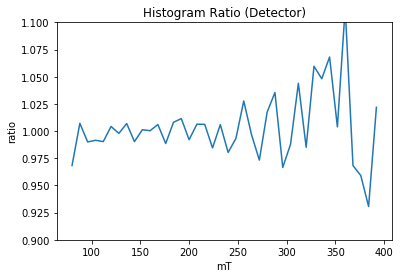

Truth Cor  0.9989848679811891
Det Cor  0.9999092082082337
theta:  179.5


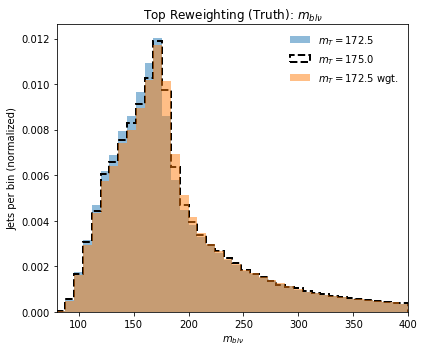

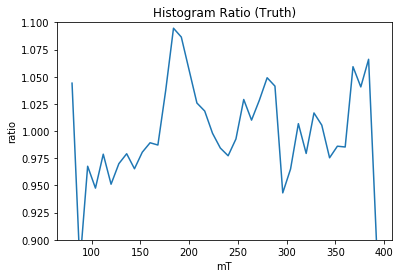

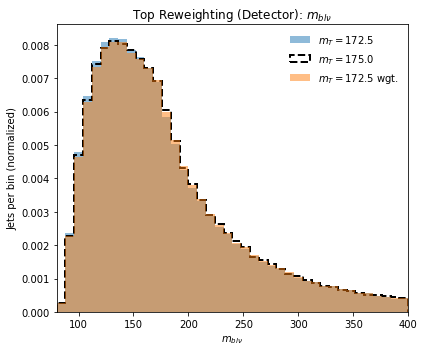

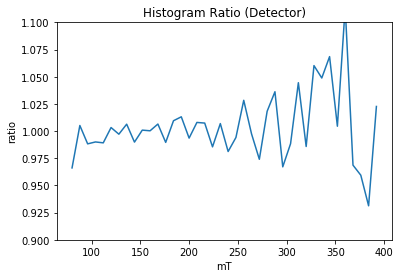

Truth Cor  0.9986706217499504
Det Cor  0.9999042250194866
theta:  180.0


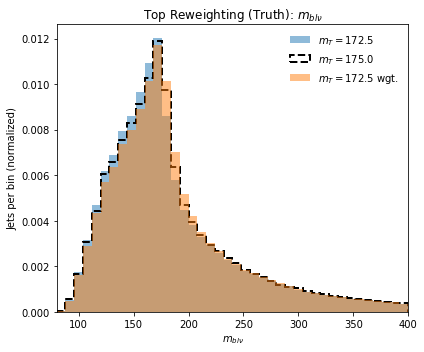

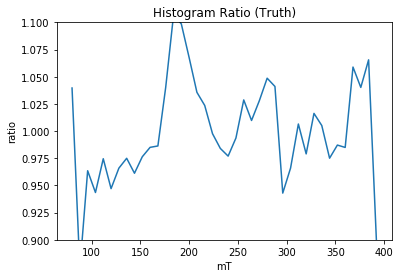

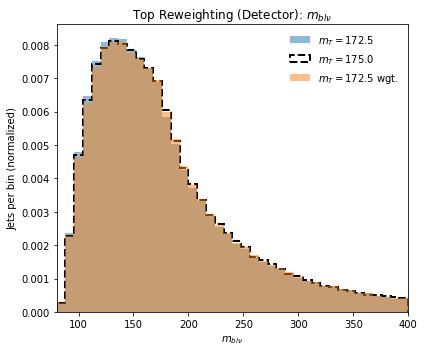

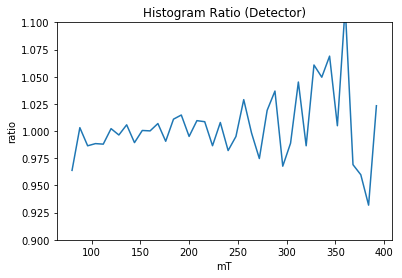

Truth Cor  0.998309763389421
Det Cor  0.9998972506092341


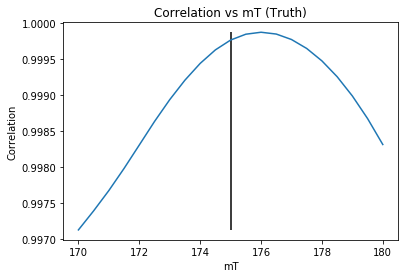

176.0


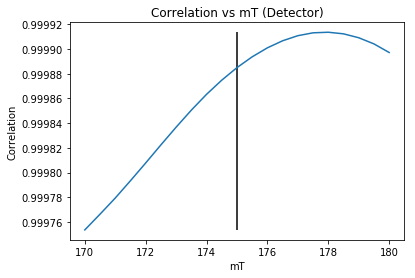

178.0
Weight Iteration:  13
theta:  170.0


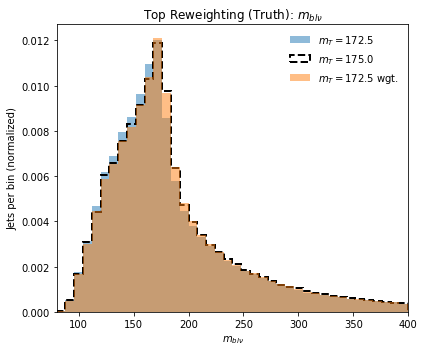

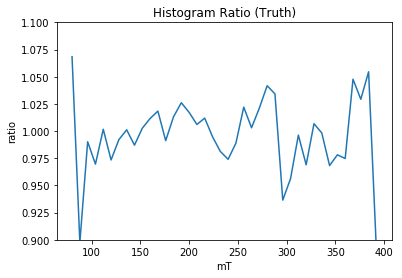

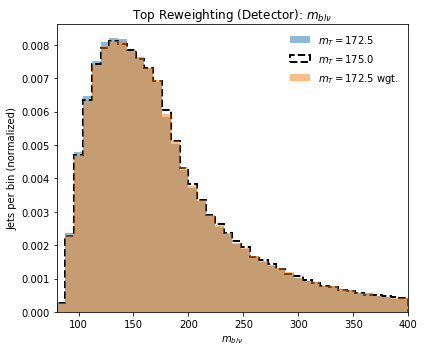

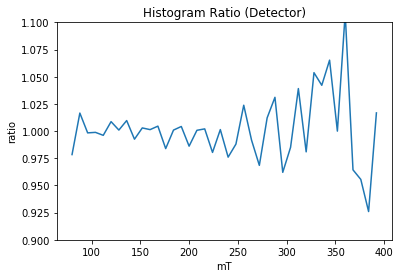

Truth Cor  0.9998030256294482
Det Cor  0.9999091583718769
theta:  170.5


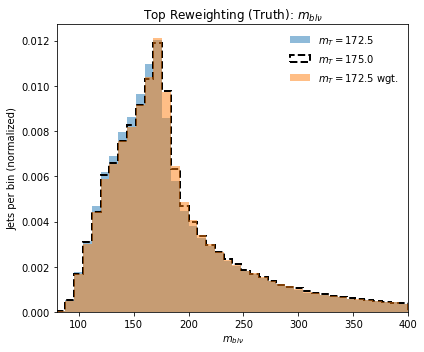

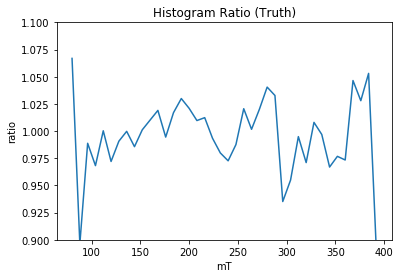

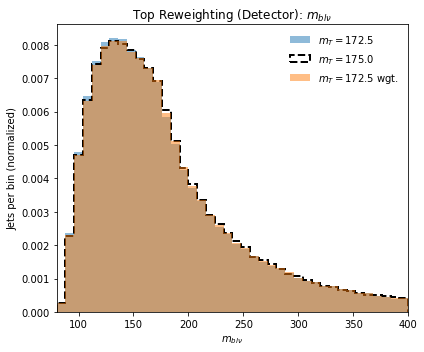

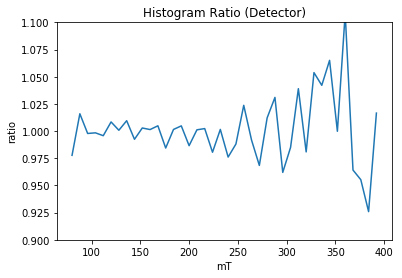

Truth Cor  0.9997855970286278
Det Cor  0.9999104784486891
theta:  171.0


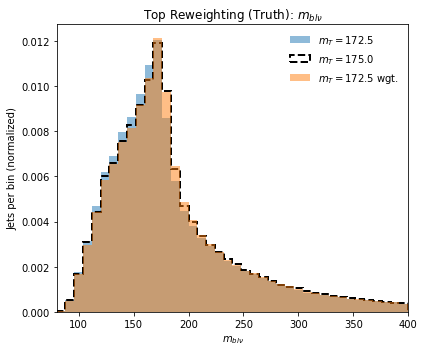

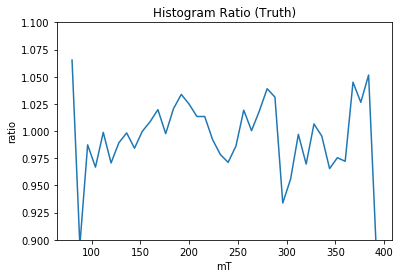

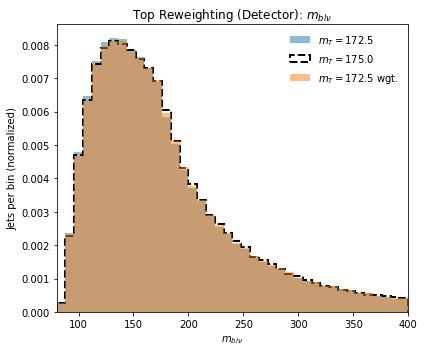

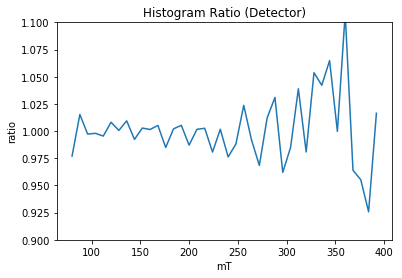

Truth Cor  0.9997598394376402
Det Cor  0.9999116242743205
theta:  171.5


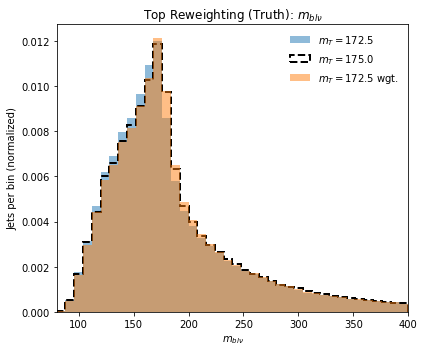

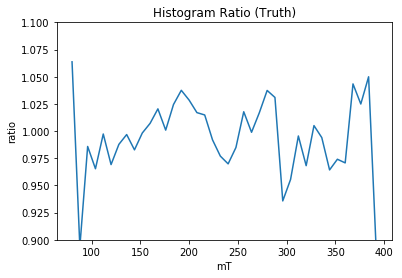

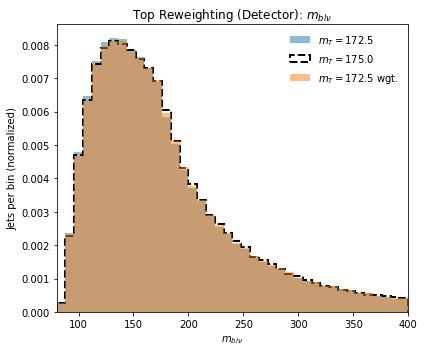

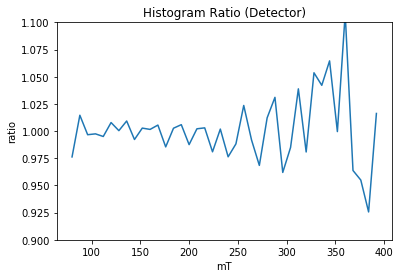

Truth Cor  0.9997258305650484
Det Cor  0.999912542903017
theta:  172.0


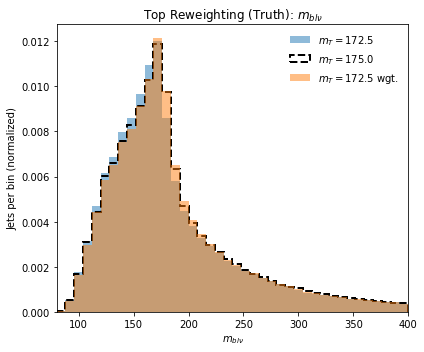

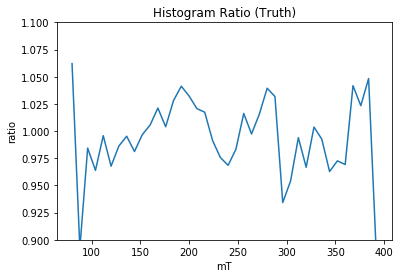

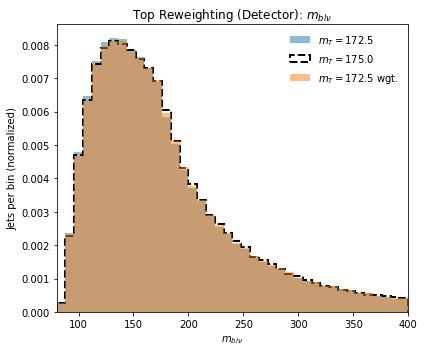

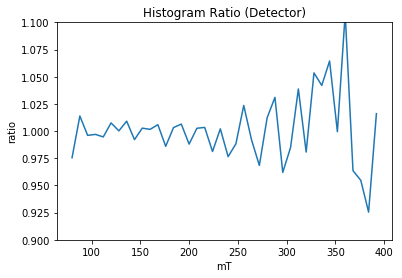

Truth Cor  0.9996819311694489
Det Cor  0.999913300767797
theta:  172.5


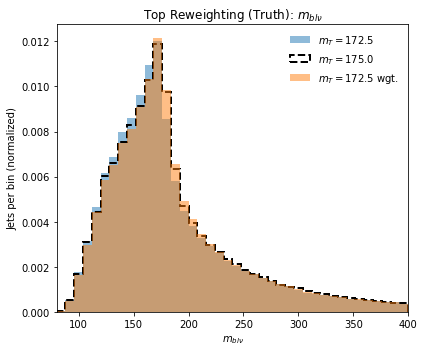

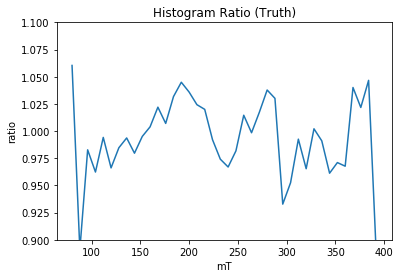

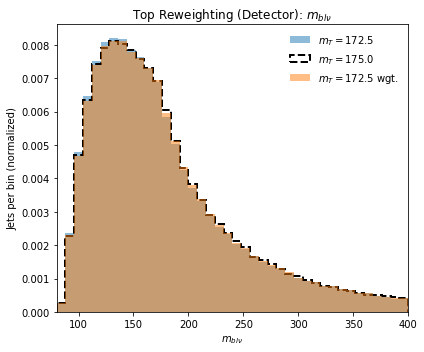

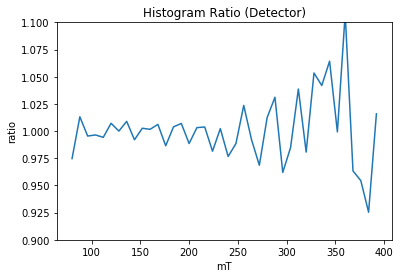

Truth Cor  0.999629705682142
Det Cor  0.999913809360462
theta:  173.0


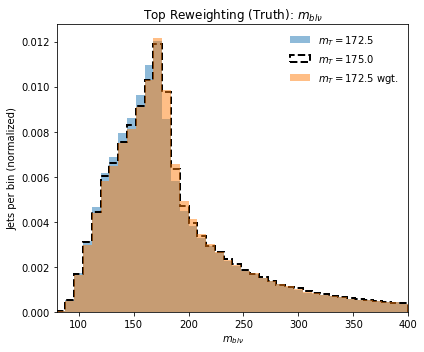

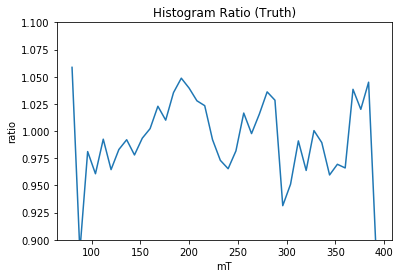

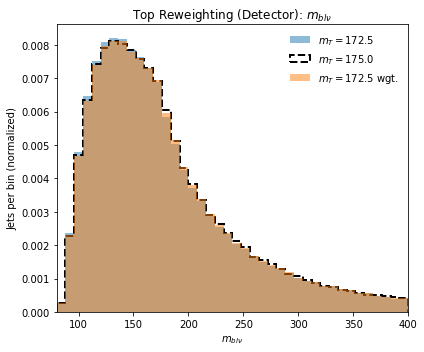

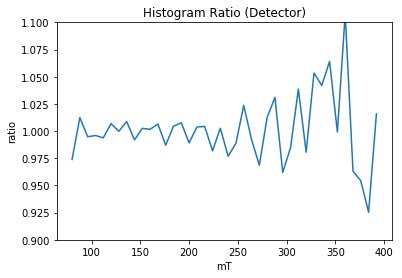

Truth Cor  0.9995683203688729
Det Cor  0.999914171287921
theta:  173.5


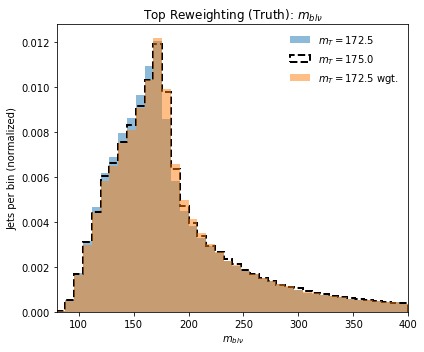

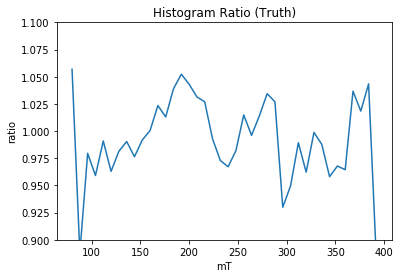

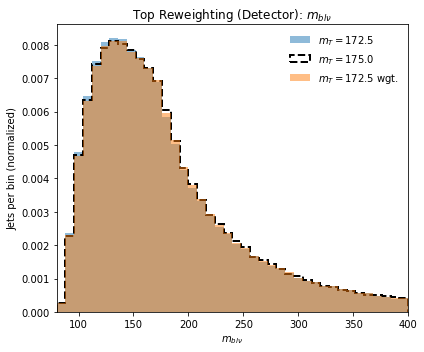

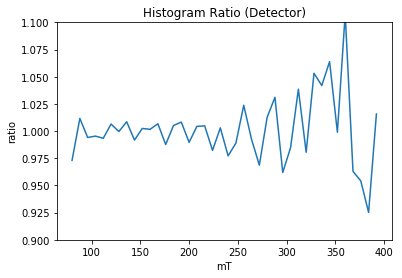

Truth Cor  0.9995020172661256
Det Cor  0.9999142923120633
theta:  174.0


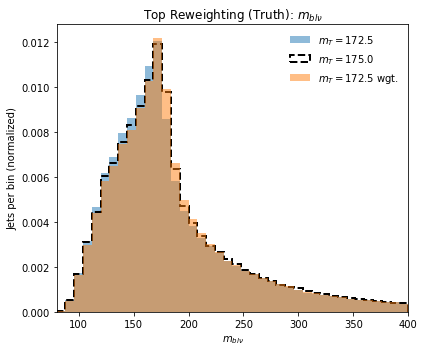

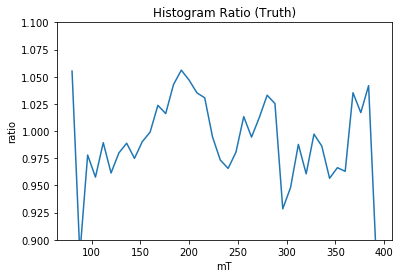

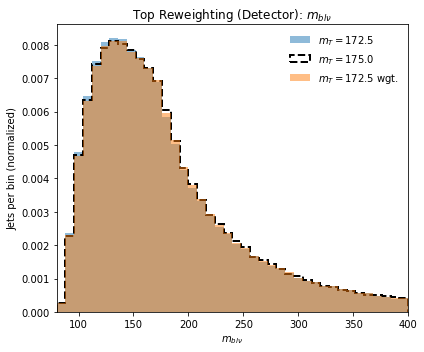

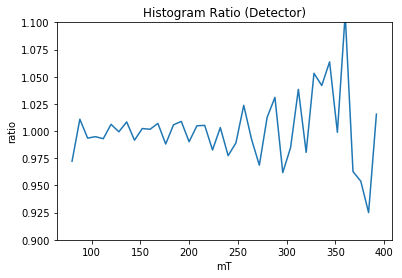

Truth Cor  0.9994296105851381
Det Cor  0.9999139413514686
theta:  174.5


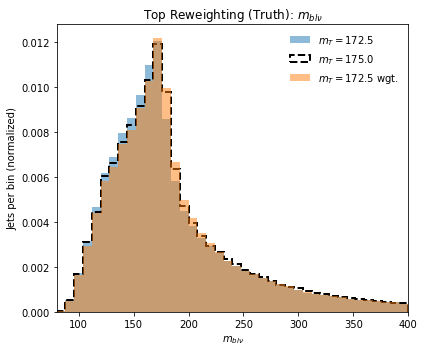

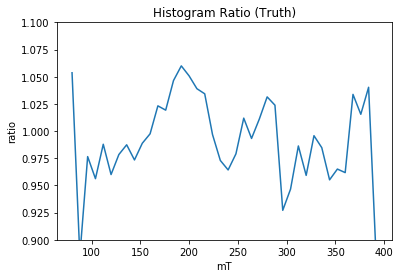

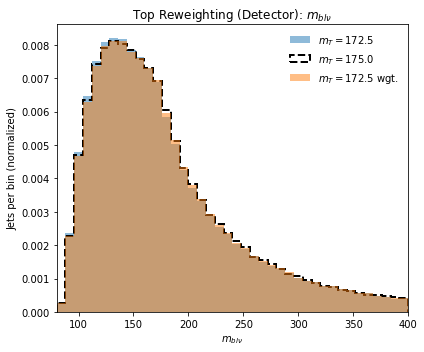

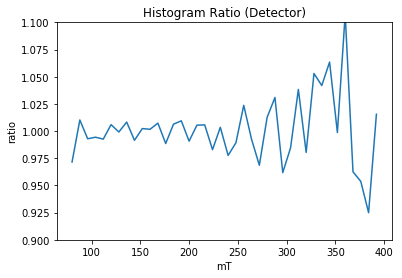

Truth Cor  0.9993540817156144
Det Cor  0.9999133445333904
theta:  175.0


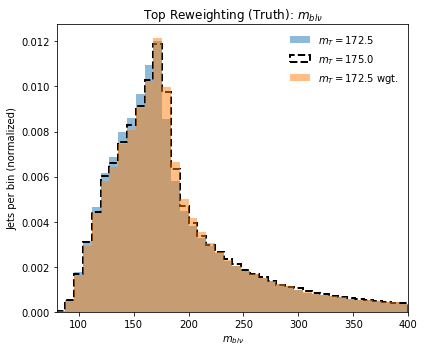

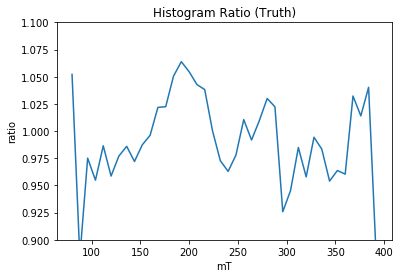

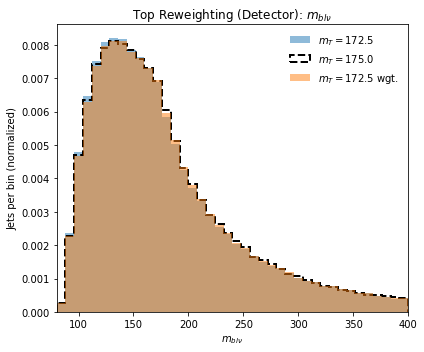

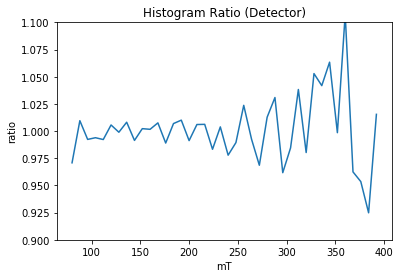

Truth Cor  0.9992752786728509
Det Cor  0.9999125427292608
theta:  175.5


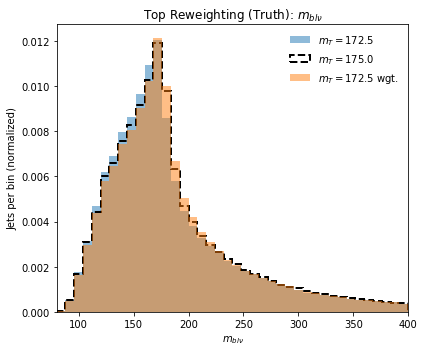

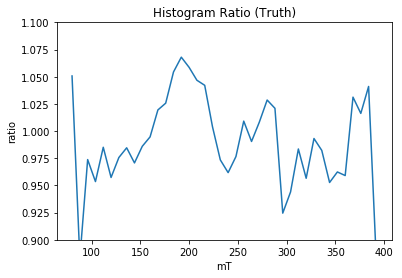

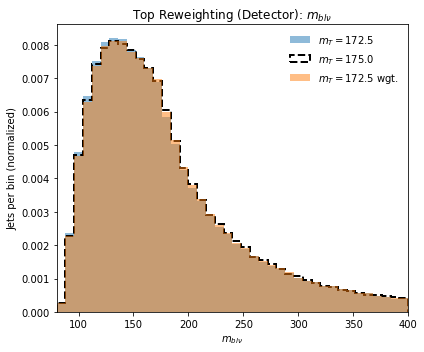

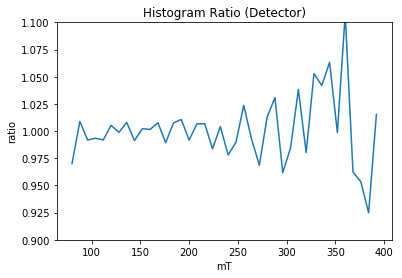

Truth Cor  0.9991930044568137
Det Cor  0.9999116400836215
theta:  176.0


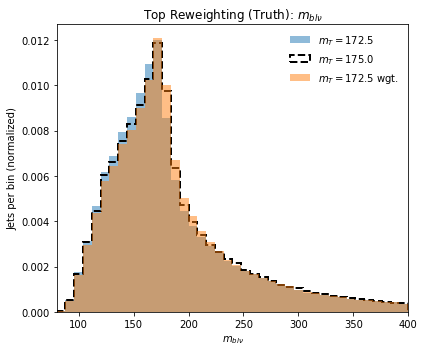

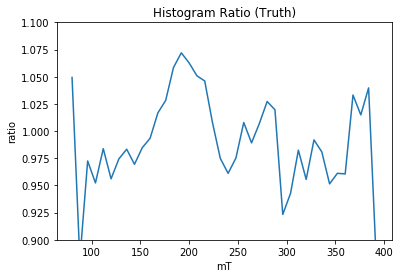

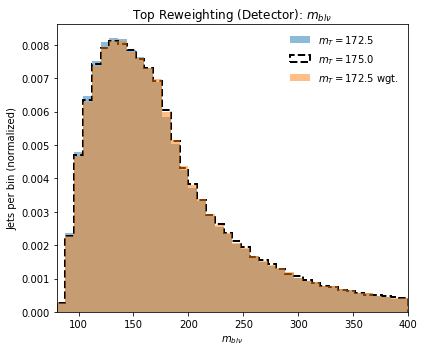

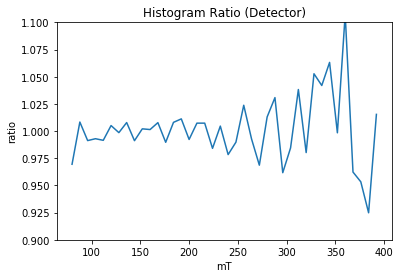

Truth Cor  0.9991061914742658
Det Cor  0.9999105547288677
theta:  176.5


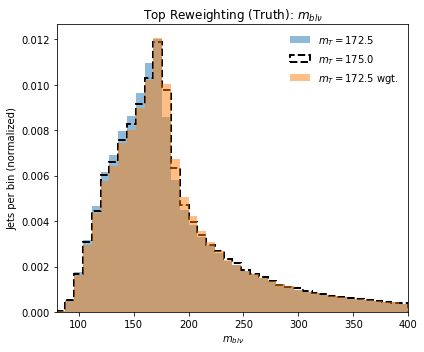

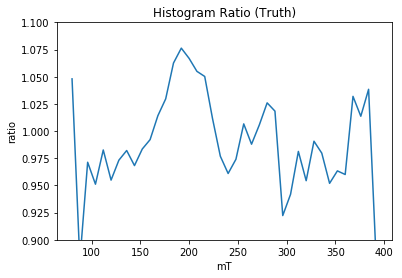

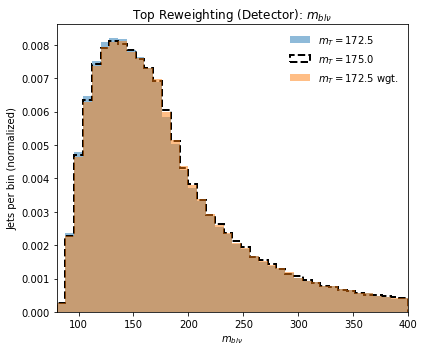

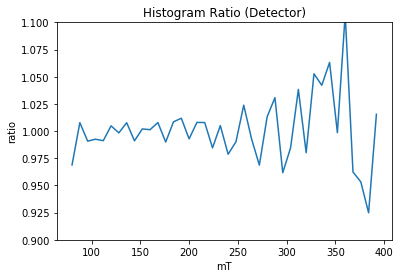

Truth Cor  0.9990179224919202
Det Cor  0.9999093072439895
theta:  177.0


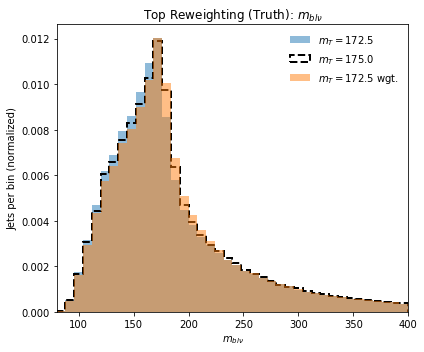

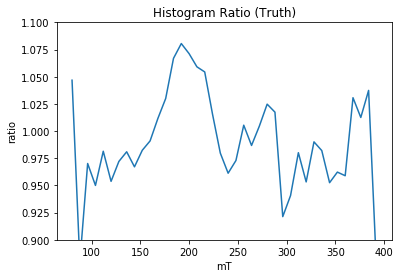

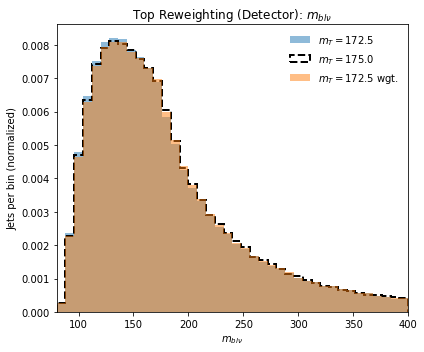

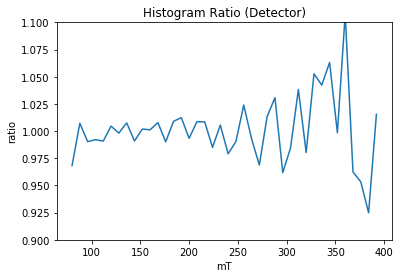

Truth Cor  0.998927398940999
Det Cor  0.9999080041765377
theta:  177.5


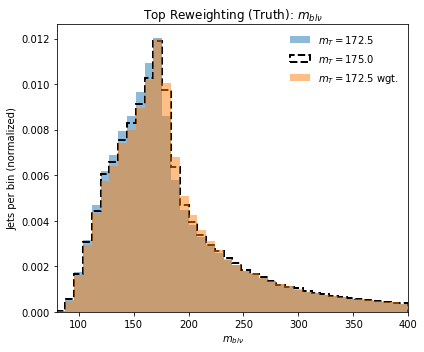

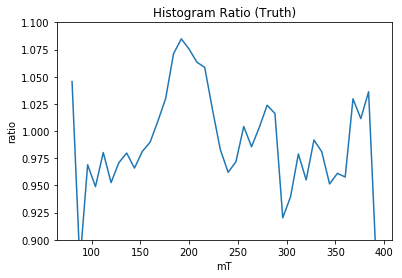

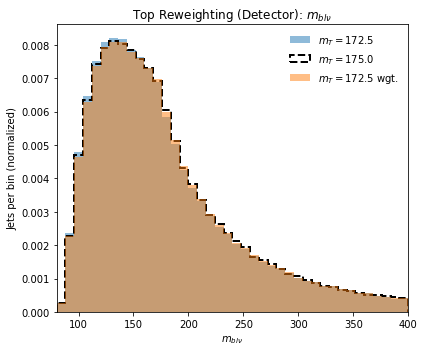

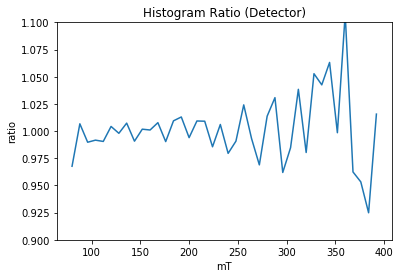

Truth Cor  0.9988313102771297
Det Cor  0.9999065223174336
theta:  178.0


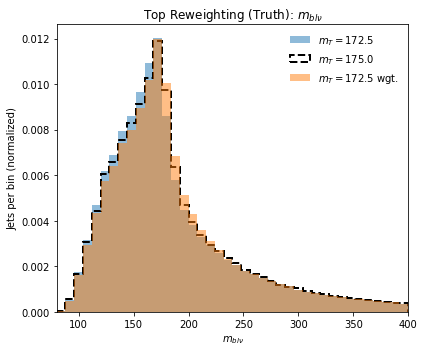

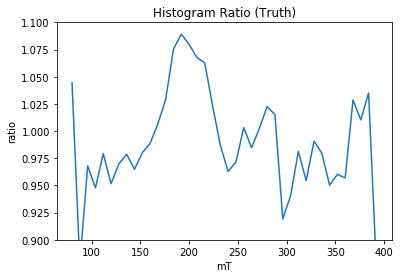

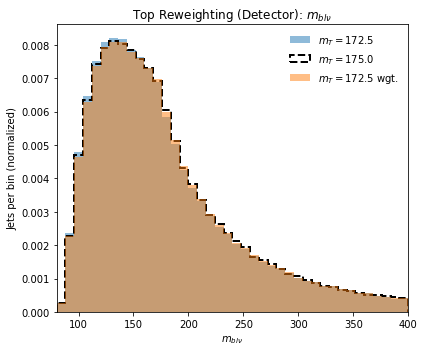

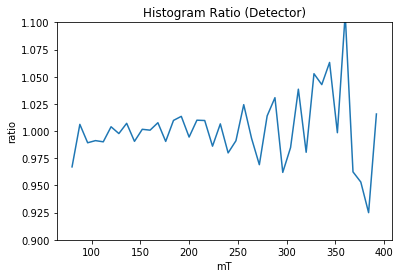

Truth Cor  0.9987341733194196
Det Cor  0.9999049636024813
theta:  178.5


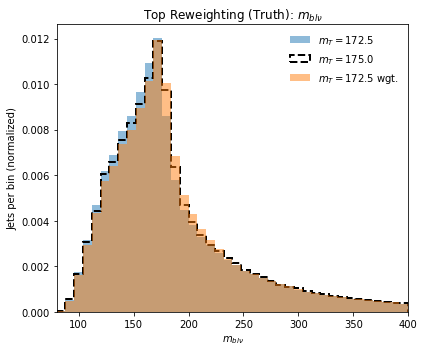

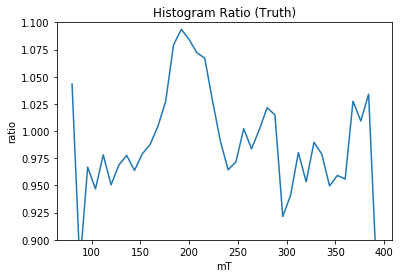

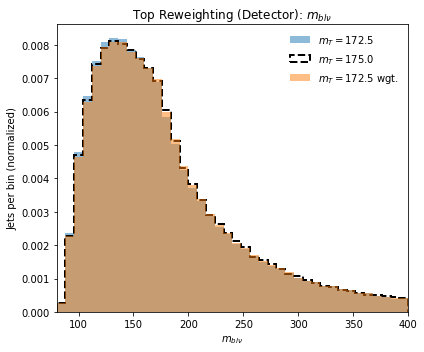

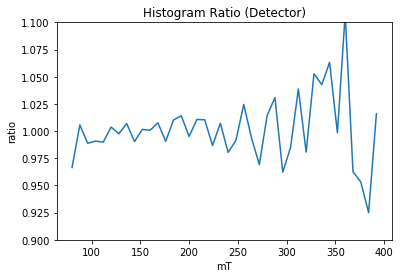

Truth Cor  0.9986405183398085
Det Cor  0.9999032183829126
theta:  179.0


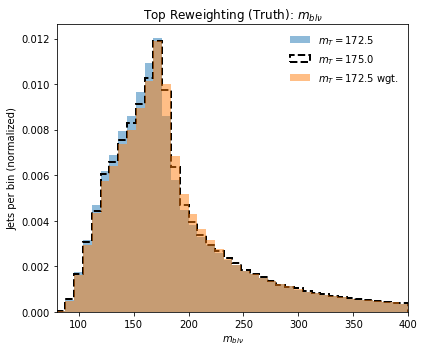

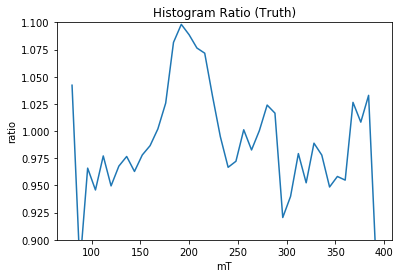

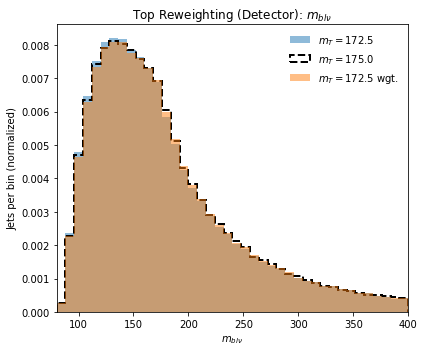

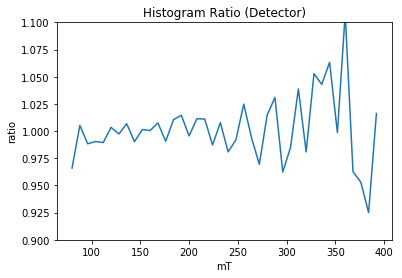

Truth Cor  0.9985489472502572
Det Cor  0.9999015275850839
theta:  179.5


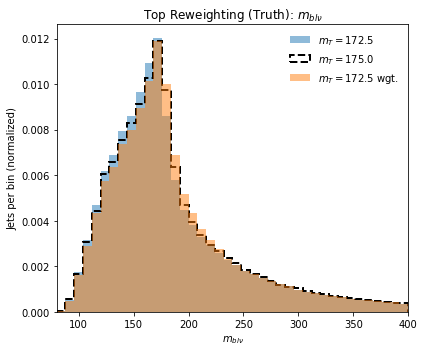

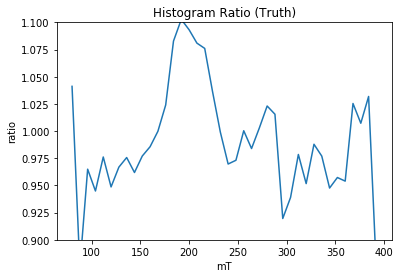

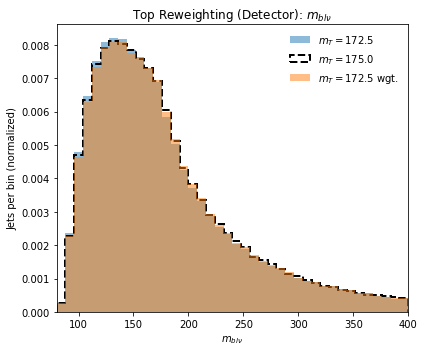

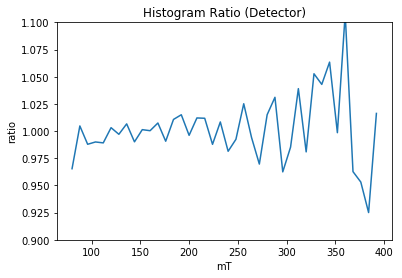

Truth Cor  0.9984619149034089
Det Cor  0.9998996804314817
theta:  180.0


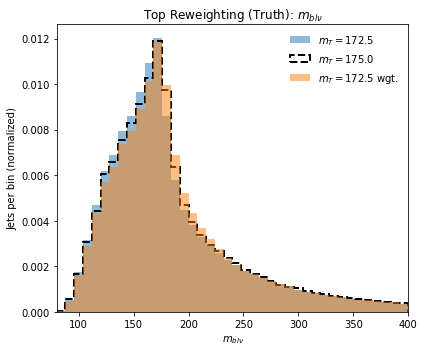

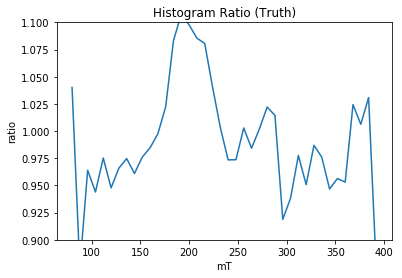

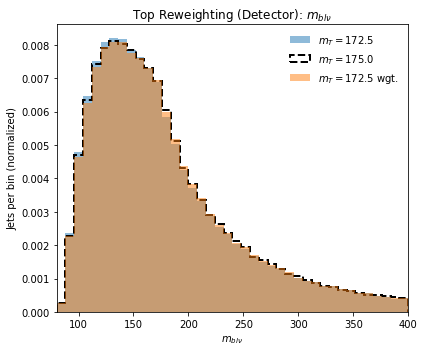

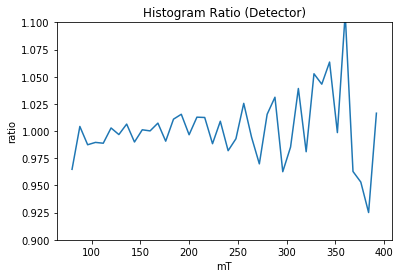

Truth Cor  0.9983740544579388
Det Cor  0.9998978160102461


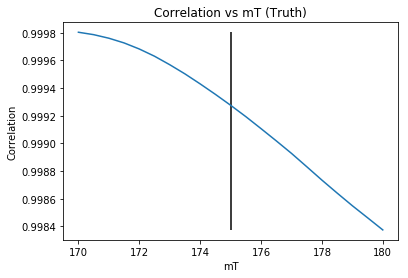

170.0


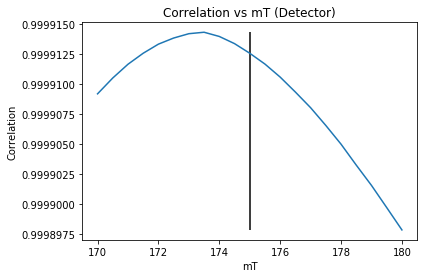

173.5


In [140]:
thetas = np.linspace(170, 180, 21)
cor_total = []
cor_det_total = []
for i in range(len(dctr_weights)):
    print("Weight Iteration: ", i)
    K.clear_session()
    # DCTR architecture 
    inputs = Input((2, ))
    hidden_layer_1 = Dense(50, activation='relu')(inputs)
    hidden_layer_2 = Dense(50, activation='relu')(hidden_layer_1)
    hidden_layer_3 = Dense(50, activation='relu')(hidden_layer_2)

    outputs = Dense(2, activation='softmax')(hidden_layer_3)

    dctr = Model(inputs=inputs, outputs=outputs)
    dctr.compile(loss='categorical_crossentropy', optimizer='Adam')
    
    dctr.set_weights(dctr_weights[i])
    
    cor = []
    cor_det = []
    weights_thetas = []

    # weights[6] weird

    for theta in thetas:
        print("theta: ", theta)
        weights = reweight(default_dataset=tf.convert_to_tensor(
        (test_dataset_0_obs / 1000), dtype=tf.float32),
                         mT=(theta / 1000.))

        weights = K.eval(weights)

        weights_thetas += [weights]

        bins = np.linspace(80, 400, 41)
        plt.figure(figsize=(6, 5))
        plt.title(r"Top Reweighting (Truth): $m_{bl\nu}$")
        bins = np.linspace(80, 400, 41)
        hist0_mlbv = plt.hist(test_dataset_0_obs,
                            bins=bins,
                            label=label_0,
                            **plot_style_1)
        hist1_mlbv = plt.hist(test_dataset_1_obs,
                            bins=bins,
                            label=label_1,
                            **plot_style_0)
        hist2_mlbv = plt.hist(test_dataset_0_obs,
                            bins=bins,
                            label=label_0 + ' wgt.',
                            weights=weights,
                            **plot_style_1)

        plt.xlabel(r'$m_{bl\nu}$')
        plt.ylabel('Jets per bin (normalized)')
        plt.xlim([80, 400])
        make_legend()
        plt.show()

        ratio = hist2_mlbv[0]/hist1_mlbv[0]

        plt.figure()
        plt.title("Histogram Ratio (Truth)")
        plt.plot(hist2_mlbv[1][:40], ratio)
        plt.xlabel("mT")
        plt.ylabel("ratio")
        plt.ylim([0.9, 1.1])
        plt.show()

        plt.figure(figsize=(6, 5))
        plt.title(r"Top Reweighting (Detector): $m_{bl\nu}$")
        bins = np.linspace(80, 400, 41)
        hist0_mlbv_det = plt.hist(test_dataset_0_obs_det[:, 0],
                              bins=bins,
                              label=label_0,
                              **plot_style_1)
        hist1_mlbv_det = plt.hist(test_dataset_1_obs_det[:, 0],
                              bins=bins,
                              label=label_1,
                              **plot_style_0)
        hist2_mlbv_det = plt.hist(test_dataset_0_obs_det[:, 0],
                              bins=bins,
                              label=label_0 + ' wgt.',
                              weights=weights,
                              **plot_style_1)
        plt.xlabel(r'$m_{bl\nu}$')
        plt.ylabel('Jets per bin (normalized)')
        plt.xlim([80, 400])
        make_legend()
        plt.show()

        ratio_det = hist2_mlbv_det[0]/hist1_mlbv_det[0]

        plt.figure()
        plt.title("Histogram Ratio (Detector)")
        plt.plot(hist2_mlbv_det[1][:40], ratio_det)
        plt.xlabel("mT")
        plt.ylabel("ratio")
        plt.ylim([0.9, 1.1])
        plt.show()


        correlation = cv2.compareHist(plt_hist_to_cv(hist1_mlbv),
                              plt_hist_to_cv(hist2_mlbv),
                              method=0)
        cor += [correlation]
        print("Truth Cor ", correlation)

        correlation = cv2.compareHist(plt_hist_to_cv(hist1_mlbv_det),
                                  plt_hist_to_cv(hist2_mlbv_det),
                                  method=0)
        cor_det += [correlation]
        print("Det Cor ", correlation)
        
    cor_total += [cor]
    cor_det_total += [cor_det]
        
    plt.title("Correlation vs mT (Truth)")
    plt.xlabel("mT")
    plt.ylabel("Correlation")
    plt.plot(thetas, cor)
    plt.vlines(175, min(cor), max(cor), label = 'Truth')
    plt.legend
    plt.show()

    print(thetas[np.argmax(cor)])
    
    plt.title("Correlation vs mT (Detector)")
    plt.xlabel("mT")
    plt.ylabel("Correlation")
    plt.plot(thetas, cor_det)
    plt.vlines(175, min(cor_det), max(cor_det), label = 'Truth')
    plt.legend
    plt.show()

    print(thetas[np.argmax(cor_det)])

Weight Iteration:  0


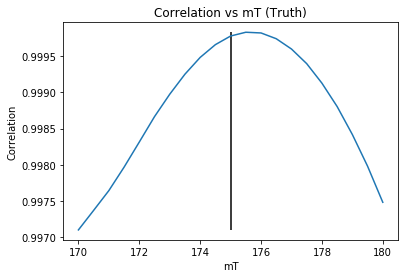

Truth Max:  175.5


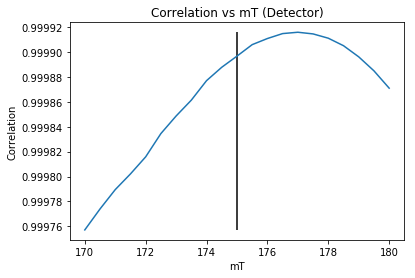

Detector Max:  177.0


Weight Iteration:  1


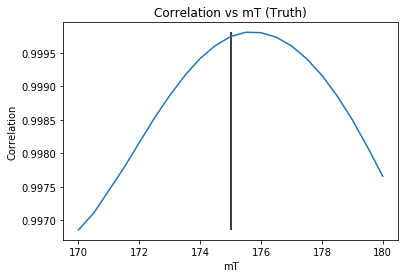

Truth Max:  175.5


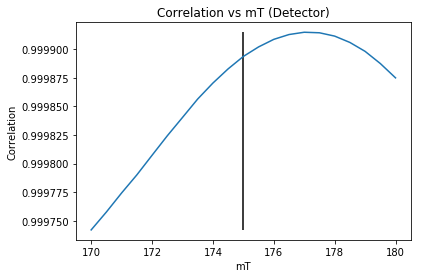

Detector Max:  177.0


Weight Iteration:  2


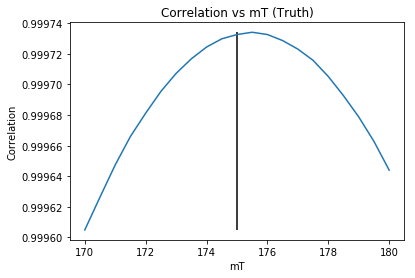

Truth Max:  175.5


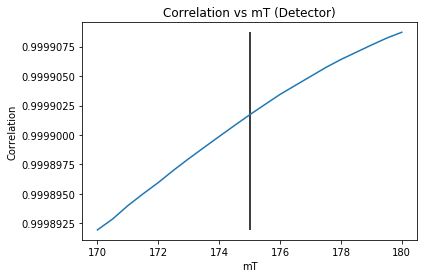

Detector Max:  180.0


Weight Iteration:  3


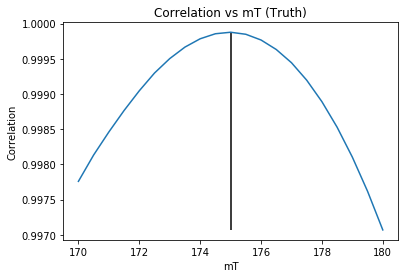

Truth Max:  175.0


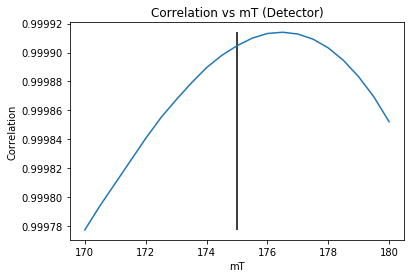

Detector Max:  176.5


Weight Iteration:  4


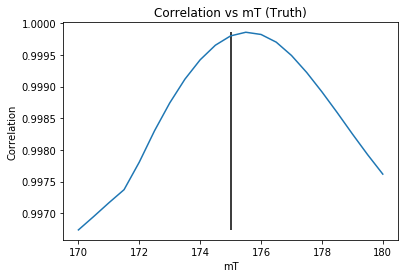

Truth Max:  175.5


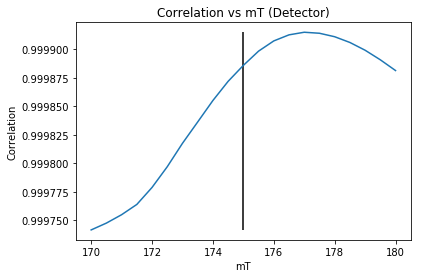

Detector Max:  177.0


Weight Iteration:  5


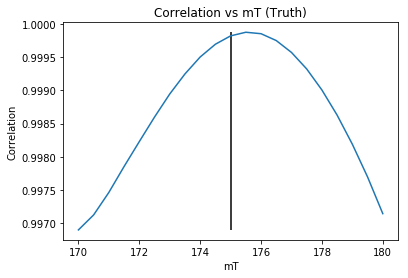

Truth Max:  175.5


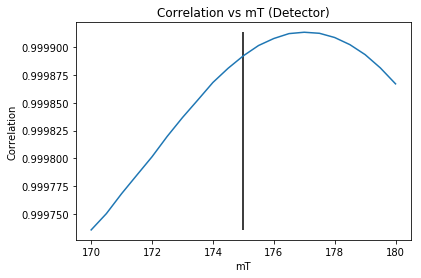

Detector Max:  177.0


Weight Iteration:  6


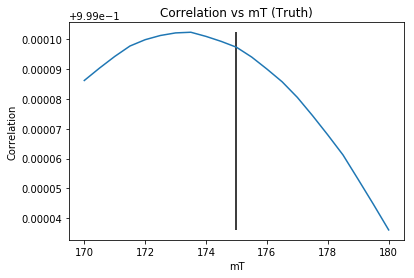

Truth Max:  173.5


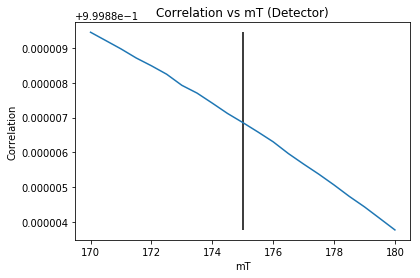

Detector Max:  170.0


Weight Iteration:  7


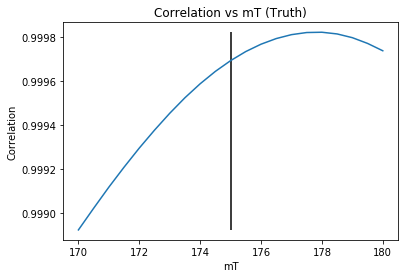

Truth Max:  178.0


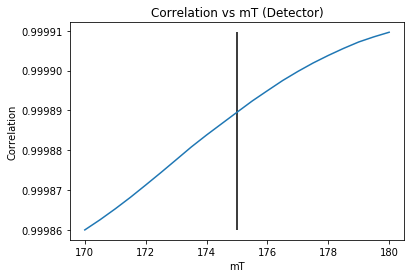

Detector Max:  180.0


Weight Iteration:  8


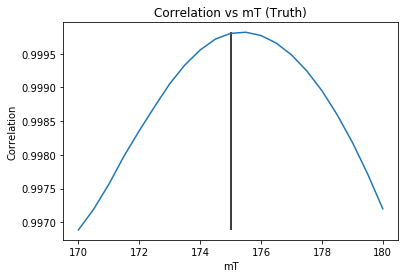

Truth Max:  175.5


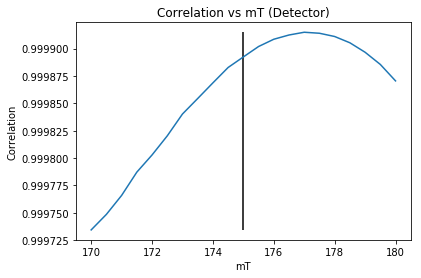

Detector Max:  177.0


Weight Iteration:  9


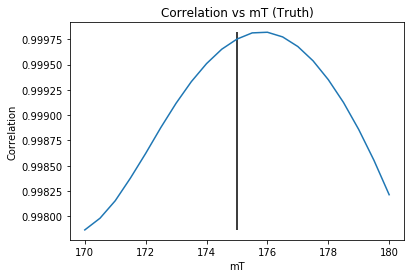

Truth Max:  176.0


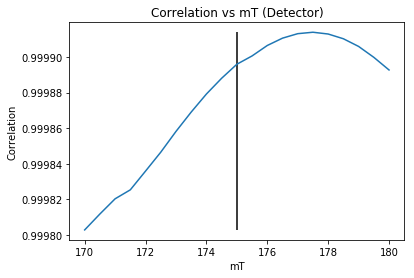

Detector Max:  177.5


Weight Iteration:  10


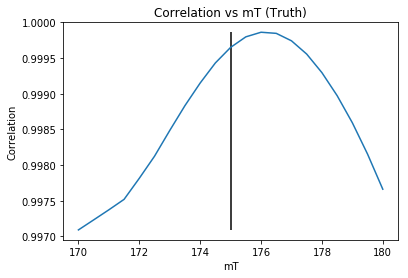

Truth Max:  176.0


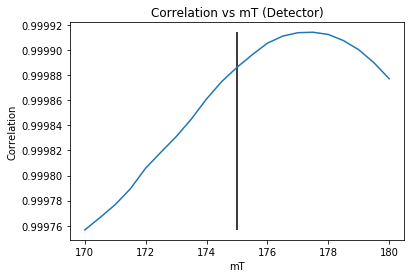

Detector Max:  177.5


Weight Iteration:  11


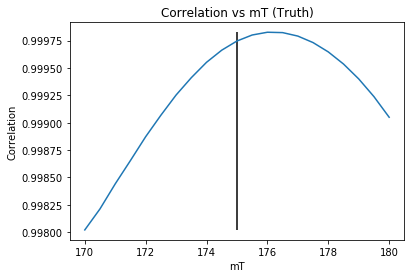

Truth Max:  176.0


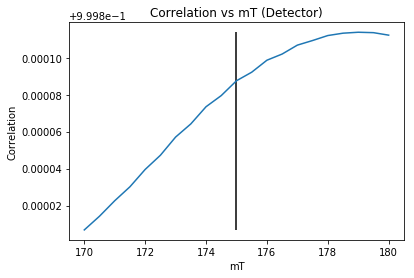

Detector Max:  179.0


Weight Iteration:  12


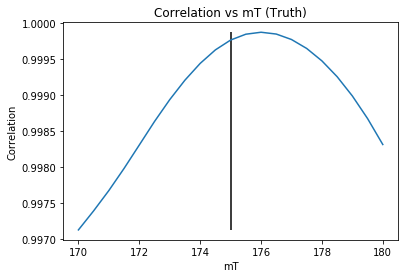

Truth Max:  176.0


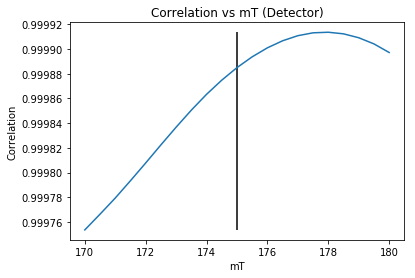

Detector Max:  178.0


Weight Iteration:  13


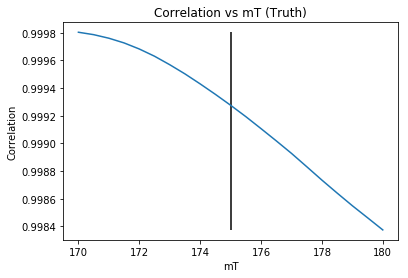

Truth Max:  170.0


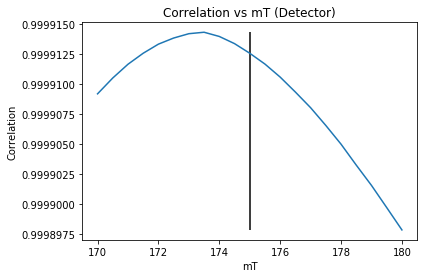

Detector Max:  173.5




In [145]:
for i in range(len(dctr_weights)):
    print("Weight Iteration: ", i)
    
    plt.title("Correlation vs mT (Truth)")
    plt.xlabel("mT")
    plt.ylabel("Correlation")
    plt.plot(thetas, cor_total[i])
    plt.vlines(175, min(cor_total[i]), max(cor_total[i]), label = 'Truth')
    plt.legend
    plt.show()

    print("Truth Max: ", thetas[np.argmax(cor_total[i])])
    
    plt.title("Correlation vs mT (Detector)")
    plt.xlabel("mT")
    plt.ylabel("Correlation")
    plt.plot(thetas, cor_det_total[i])
    plt.vlines(175, min(cor_det_total[i]), max(cor_det_total[i]), label = 'Truth')
    plt.legend
    plt.show()

    print("Detector Max: ", thetas[np.argmax(cor_det_total[i])])
    print("\n")